Bibliotecas externas ao código

In [1]:
import sys
import os
import csv
import json

import math
import statistics as st
import matplotlib.pyplot as plt


## Parâmetros

In [2]:
data_path = "./DataSet"
json_keys = ("Null", "id", "genre", "age", "weight_kg", "walking_aids")
header_file = ('Sample', 'Id', 'Gender', 'Age', 'Mass', 'Walking Aids', 'Total Time', 'Steps', \
               'Mean Stepping Time', 'Mean Speed', 'Mean Force', 'Distance', 'Mean Power', 'Mean Inclination', \
               'MainDirXX', 'MainDirYY', 'MainDirZZ', 'Sleeping Time/h', 'DisCode', 'DisName', )
number_samples = 208

output_file_name = "results.csv"
error_file_name = "ilegible.csv"
#output_file_name = "test.csv"
gravity_acceleration = 9.806
Dict_Diseases = {}

  "genre" : "Male",
  "id" : 1,
  "age" : 78,
  "weight_kg" : 68,
  "height_cm" : 167,
  "region" : "Silvares",
  "country" : "Portugal",

  "physical_status" : "Normal",
  "specific_diet" : false,
  "water_liters_day" : 3,
  "fruit_vegetables_number_day" : 5,
  "sweets_times_week" : 0,
  "alcoholic_beverages" : false,
  "smoking_habits" : false,
  "diseases" : [ "Depressive Syndrome; Left Ventricular Hypertrophy; Diabetes; Arterial hypertension" ],
  "covid_19_vaccinated" : true,
  "sleeping_time_hours" : 8,

  "sports_practice" : false,
  "gym_practice" : false,
  "gym_frequency_times_week" : 0,
  "physical_activity_frequency_days_week" : 7,
  "physical_activity_duration_hours_session" : 0.5,

  "device" : "Xiaomi POCO X3 Pro",
  "number_of_sensors" : 3,
  "sensors" : {
    "vendor" : [ "AKM", "STMicro", "AKM" ],
    "name" : [ "Accelerometer", "Magnetometer", "Gyroscope" ],
    "model" : [ "lsm6dso", "ak0991x", "lsm6dso" ],
    "resolution" : [ 0.002, 0.15, 0.001 ]
    "number_of_axis" : [ 3, 3, 3 ],
    "frequency_hz" : [ 204, 197, 204 ],
    "duration_ms" : [ 21835, 21874, 21624 ],
    "power_mA" : [ 0.17, 0.15, 0.55 ],
    "max_range" : [ 78.453, 4911.994, 17.453 ],
  },

  "interest" : 3,

  "exercise_type" : "Walk",
  "walking_aids" : false,
  "time" : "Morning",
  "start_time" : "2022-09-12 11:13:04"
  "duration" : 21874,


## Internal Functions

### User Mathematical Functions

In [3]:
def vect_length(vector):
    """
        Length of an euclidean vector of 2 and 3 dimensions
        Input:
            vector is an list 
    """

    return math.sqrt(sum([math.pow(component, 2) for component in vector]))

def orientation(vector):
    """
        Unit vector of an euclidean vector of 2 and 3 dimensions
        Input:
            vector is an list
    """

    vector_len = vect_length(vector)

    return [component/vector_len for component in vector]

def Euler(dt, dx):
    """
        Euler's method:
            Fisrt Order Differentional Equation Resolution
            Stating nul vector as initial condition
        Input:
            dt - non-fix time steps list
            dx - x derivative in order of t
    """

    xx = [[0.0, 0.0, 0.0]]

    for ii in range(1,len(dt)):
        xx = xx + [[xx[-1][0] + dt[ii] * dx[ii - 1][0], \
                  xx[-1][1] + dt[ii] * dx[ii - 1][1], \
                  xx[-1][2] + dt[ii] * dx[ii - 1][2]]]

    return xx

def Esc_Prod(list01, list02):
    """
        Escalar Product between two euclidean vectors of 2 and 3 dimensions
        Input:
            list01 is an list of a list
            list02 is an list of a list
    """

    return [sum([comp01*comp02 for comp01,comp02 in zip(vect01,vect02)]) for vect01,vect02 in zip(list01, list02)]

def RoundFloat(List):
    
    for ii in range(len(List)):
        if isinstance(List[ii], float):
            List[ii] = float(f'{(List[ii] + 0.0005):.4f}')
        elif isinstance(List[ii], list):
            list01 = [float(f'{(element + 0.0005):.4f}') for element in List[ii] if isinstance(List[ii], float)]
            if len(list01) > 0:
                List[ii] = list01
            
    return List


### Application Functions

In [4]:
def accelerometer(exp_data):

    ### Acelerometer

    Acelerometer_data = exp_data['accelerometer']

    Meter_Time = [data[0] for data in Acelerometer_data]; Exp_Acceleration = [data[1] for data in Acelerometer_data]
    
    # Time variables
    Experiment_Tt_Time = (Meter_Time[-1] - Meter_Time[0])*1.0e-3
    Experiment_Time = [(Meter_Time[ii] - Meter_Time[0])*1e-3 for ii in range(len(Meter_Time))]
    Time_Interv = [0.0] + [(Meter_Time[ii] - Meter_Time[ii-1])*1e-3 for ii in range(1,len(Meter_Time))]

    # Correction of the acceleration: Remove the accelaration of gravity
    
    Orient_ot_acceleration = [orientation(line) for line in Exp_Acceleration]

    Corrected_Accel =[]
    for component, grav_comp in zip(Exp_Acceleration, Orient_ot_acceleration):
        Corrected_Accel = Corrected_Accel + [[line1 - gravity_acceleration * line2 for line1, line2 in zip(component, grav_comp)]]
    
    #Velocity
    Velocity = Euler(Time_Interv, Corrected_Accel)

    # Position
    Position = Euler(Time_Interv, Velocity)
    
    # Filter the first ten seconds
    Experiment_Tt_Time = (Meter_Time[-1] - Meter_Time[0])*1.0e-3
    if Experiment_Tt_Time > 10.0:
        Meter_Time = [Instant for Instant in Meter_Time if ((Instant - Meter_Time[0])*1.0e-3) > 10.0]
        First_Ten_Sec = len(Exp_Acceleration) - len(Meter_Time)
        Experiment_Time[:First_Ten_Sec] = []
        Corrected_Accel[:First_Ten_Sec] = []
        Velocity[:First_Ten_Sec] = []
        Position[:First_Ten_Sec] = []

    Corrected_Accel_Int = [vect_length(line) for line in Corrected_Accel]
    
    Peeks_Loc = [Time_ind for Time_ind in range(1,len(Corrected_Accel_Int)-1) \
                   if (((Corrected_Accel_Int[Time_ind] - Corrected_Accel_Int[Time_ind - 1]) > 0) & \
                       ((Corrected_Accel_Int[Time_ind + 1] - Corrected_Accel_Int[Time_ind]) < 0) & \
                       (Corrected_Accel_Int[Time_ind] > (st.fmean([component for component in Corrected_Accel_Int]) + \
                                                         st.stdev([component for component in Corrected_Accel_Int])/3)))]
    
    Num_Steps = len(Peeks_Loc)
    #Plot data
    fig, axs = plt.subplots(2,1,figsize=(16,16), gridspec_kw={'height_ratios': [1, 1]})
    axs[0].plot(Experiment_Time, Corrected_Accel_Int)
    axs[0].scatter([Experiment_Time[j] for j in Peeks_Loc], [Corrected_Accel_Int[j] for j in Peeks_Loc])
    try:
        Mean_Step_Time = st.fmean([((Meter_Time[Peeks_Loc[ii]] - Meter_Time[Peeks_Loc[ii-1]])*1.0e-3) for ii in range(1, Num_Steps)])
        STD_Step_Time = st.stdev([((Meter_Time[Peeks_Loc[ii]] - Meter_Time[Peeks_Loc[ii-1]])*1.0e-3) for ii in range(1, Num_Steps)], Mean_Step_Time)
        step = 1; lower_limit = Peeks_Loc[0]
        while ((lower_limit - step) >= 0) & (Experiment_Time[lower_limit] - Experiment_Time[lower_limit - step] < Mean_Step_Time/2):
            Peeks_Loc = [Peeks_Loc[0] - 1] + Peeks_Loc
            step = step +1
        step = 1; higher_limit = Peeks_Loc[-1]
        while ((higher_limit + step) < (len(Experiment_Time) - 1)) & ((Experiment_Time[higher_limit + step] - Experiment_Time[higher_limit]) < Mean_Step_Time/2):
            Peeks_Loc = Peeks_Loc + [Peeks_Loc[-1] + 1]
            step = step +1
        Study_Interval = [Meter_Time[Peeks_Loc[0]], Meter_Time[Peeks_Loc[-1]]]
    except st.StatisticsError:
        return [Experiment_Tt_Time, Num_Steps, '#N/A', '#N/A', '#N/A', '#N/A', '#N/A', '#N/A', ['#N/A', '#N/A']]
   
    axs[0].scatter([Experiment_Time[j] for j in [Peeks_Loc[0], Peeks_Loc[-1]]], [Corrected_Accel_Int[j] for j in [Peeks_Loc[0], Peeks_Loc[-1]]], cmap='red')

    Acceleration = [vect_length(line) for line in Corrected_Accel]
    Speed = [vect_length(line) for line in Velocity[Peeks_Loc[0]:Peeks_Loc[-1]+1]]
    axs[1].plot(Experiment_Time[Peeks_Loc[0]:Peeks_Loc[-1]+1], Speed)
    plt.show()

    Mean_Acceleration = st.mean(Speed)
    Mean_Speed = st.mean(Speed)

    Displacement = [[0.0,0.0,0.0]]

    for ii in range(1,len(Position)):
        Displacement = Displacement + [[Position[ii][0] - Position[ii-1][0], \
                                        Position[ii][1] - Position[ii-1][1], \
                                        Position[ii][2] - Position[ii-1][2]]]
    Distance = [vect_length(line) for line in Displacement[Peeks_Loc[0]:Peeks_Loc[-1]+1]]

    Experiment_Tt_Time = (Meter_Time[Peeks_Loc[-1]] - Meter_Time[Peeks_Loc[0]])*1.0e-3

    Mean_Power = st.fsum(Esc_Prod(Corrected_Accel[Peeks_Loc[0]:Peeks_Loc[-1]+1],Velocity[Peeks_Loc[0]:Peeks_Loc[-1]+1]))

    return RoundFloat([Experiment_Tt_Time, Num_Steps, Mean_Step_Time, STD_Step_Time, Mean_Acceleration, Mean_Speed, st.fsum(Distance), Mean_Power, Study_Interval])


def gyroscope(data, std_interval):

    ### Giroscope

    Gyro_data = data['gyroscope']

    Meter_Time = [data[0] for data in Gyro_data]; AngVel = [data[1] for data in Gyro_data]
    
    # Time variables    
    Experiment_Tt_Time = (Meter_Time[-1] - Meter_Time[0])*1.0e-3
    Experiment_Time = [(Meter_Time[ii] - Meter_Time[0])*1e-3 for ii in range(len(Meter_Time))]
    Time_Interv = [0.0] + [(Meter_Time[ii] - Meter_Time[ii-1])*1e-3 for ii in range(1,len(Meter_Time))]

    # Rotating Angle
    Ang = Euler(Time_Interv, AngVel)
    
    # Filtrar os dez primeiros segundos
    if Experiment_Tt_Time > 10.0:
        Meter_Time = [Instant for Instant in Meter_Time if ((Instant - Meter_Time[0])*1.0e-3) > 10.0]
        First_Ten_Sec = len(AngVel) - len(Meter_Time)
        AngVel[:First_Ten_Sec] = []
        Ang[:First_Ten_Sec] = []

    Experiment_Tt_Time = (Meter_Time[-1] - Meter_Time[0])*1.0e-3
    Experiment_Time = [(Meter_Time[ii] - Meter_Time[0])*1e-3 for ii in range(len(Meter_Time))]
    
    # Extract the study interval period

    try:
        low_limit = 0
        high_limit = len(Meter_Time) - 1
        time_inst_index = 0
        while time_inst_index < (len(Meter_Time)/2 + 1):
            if Meter_Time[low_limit] < std_interval[0]:
                low_limit = low_limit + 1
            if Meter_Time[high_limit] > std_interval[1]:
                high_limit = high_limit - 1
            time_inst_index = time_inst_index + 1

        Meter_Time = Meter_Time[low_limit: high_limit + 1]
        Experiment_Tt_Time = (Meter_Time[-1] - Meter_Time[0])*1.0e-3
        Experiment_Time = [(Meter_Time[ii] - Meter_Time[0])*1e-3 for ii in range(len(Meter_Time))]

        AngVel = AngVel[low_limit: high_limit + 1]
        Ang = Ang[low_limit: high_limit + 1]        

        AngVel_dir_n = [orientation(line) for line in AngVel]

        Mean_Ang =[st.fmean([Ang[ii][0] for ii in range(len(Ang))]), \
                   st.fmean([Ang[ii][1] for ii in range(len(Ang))]), \
                   st.fmean([Ang[ii][2] for ii in range(len(Ang))])]
        
        #return [vect_length(Mean_Ang)]
        return RoundFloat([vect_length(Ang[-1])])

    except st.StatisticsError:
        return ['#N/A']
    except IndexError:
        return ['#N/A']
        
def magnetometer(data, std_interval):

    ### Magnetómetro

    MagF_data = data['magnetometer']

    Meter_Time = [data[0] for data in MagF_data]; MagFld = [data[1] for data in MagF_data]
    
    # Time variables    
    Experiment_Tt_Time = (Meter_Time[-1] - Meter_Time[0])*1.0e-3
    Experiment_Time = [(Meter_Time[ii] - Meter_Time[0])*1e-3 for ii in range(len(Meter_Time))]
    Time_Interv = [0.0] + [(Meter_Time[ii] - Meter_Time[ii-1])*1e-3 for ii in range(1,len(Meter_Time))]

    # Filtrar os dez primeiros segundos
    #print("Tempo do movimento: " + str(Experiment_Tt_Time) + " s")
    if Experiment_Tt_Time > 10.0:
        Meter_Time = [Instant for Instant in Meter_Time if ((Instant - Meter_Time[0])*1.0e-3) > 10.0]
        First_Ten_Sec = len(MagFld) - len(Meter_Time)
        Experiment_Time[:First_Ten_Sec] = []
        MagFld[:First_Ten_Sec] = []

    Experiment_Tt_Time = (Meter_Time[-1] - Meter_Time[0])*1.0e-3
    Experiment_Time = [(Meter_Time[ii] - Meter_Time[0])*1e-3 for ii in range(len(Meter_Time))]
    
    # Extract the study interval period

    
    low_limit = 0
    high_limit = len(Meter_Time) - 1
    time_inst_index = 0
    while time_inst_index <= (len(Meter_Time)/2 + 1):
        if Meter_Time[low_limit] < std_interval[0]:
            low_limit = low_limit + 1
        if Meter_Time[high_limit] > std_interval[1]:
            high_limit = high_limit - 1
        time_inst_index = time_inst_index + 1
    
    Meter_Time = Meter_Time[low_limit: high_limit + 1]
    Experiment_Tt_Time = (Meter_Time[-1] - Meter_Time[0])*1.0e-3
    Experiment_Time = [(Meter_Time[ii] - Meter_Time[0])*1e-3 for ii in range(len(Meter_Time))]
    
    MagFld = MagFld[low_limit:high_limit + 1]

    MagFld_dir_n = [orientation(line) for line in MagFld]
    
    try:
        Mean_MagFld =[st.fmean([(MagFld_dir_n[ii][0]-MagFld_dir_n[0][0]) for ii in range(1,len(MagFld_dir_n))]), \
                      st.fmean([(MagFld_dir_n[ii][1]-MagFld_dir_n[0][1]) for ii in range(1,len(MagFld_dir_n))]), \
                      st.fmean([(MagFld_dir_n[ii][2]-MagFld_dir_n[0][2]) for ii in range(1,len(MagFld_dir_n))])]
        
        #return [Mean_MagFld]
        return RoundFloat([MagFld_dir_n[-1][0]-MagFld_dir_n[0][0], MagFld_dir_n[-1][1]-MagFld_dir_n[0][1], MagFld_dir_n[-1][2]-MagFld_dir_n[0][2]])
    
    except st.StatisticsError:
        return ['#N/A', '#N/A', '#N/A']


## Main function

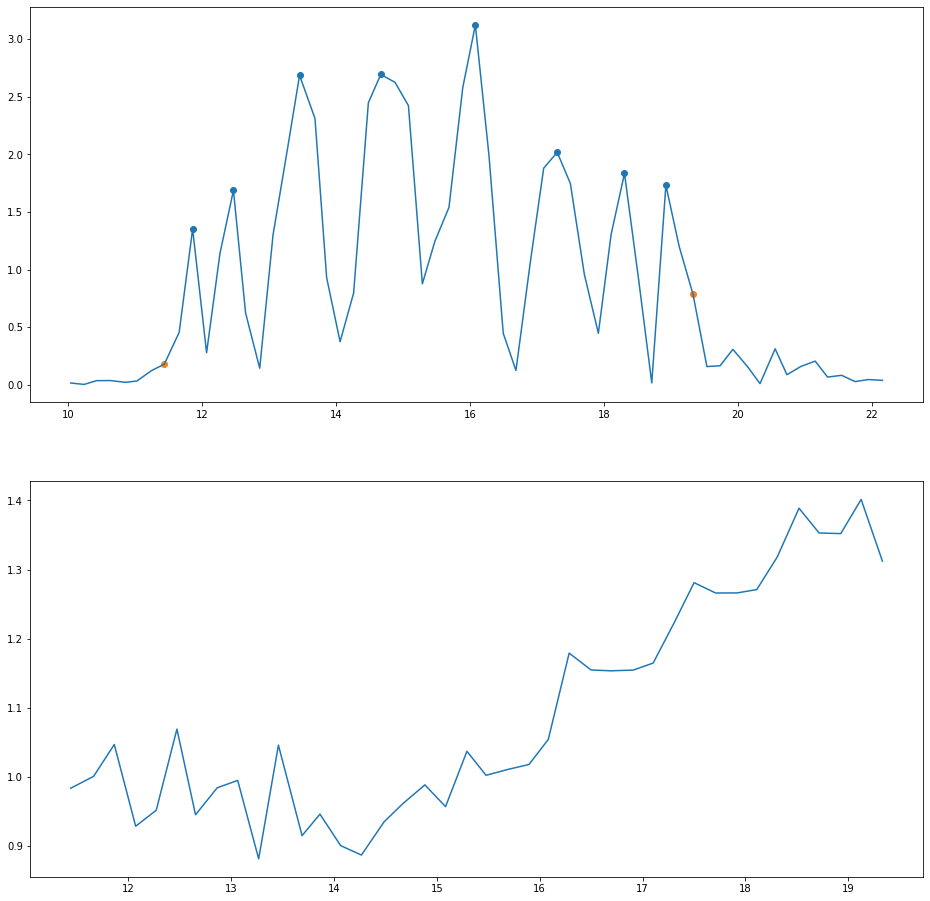

('1', 1, 'Male', 78, 68, False, 7.8925, 8, 1.0096, 74.3036, 1.0927, 8.7705, -544.7883)
('1', 1, 'Male', 78, 68, False, 7.8925, 8, 1.0096, 74.3036, 1.0927, 8.7705, -544.7883, 0.4755)
('1', 1, 'Male', 78, 68, False, 7.8925, 8, 1.0096, 74.3036, 1.0927, 8.7705, -544.7883, 0.4755, 0.0246, 0.0262, -0.0968, 8, 101, 'Depressive Syndrome')
('1', 1, 'Male', 78, 68, False, 7.8925, 8, 1.0096, 74.3036, 1.0927, 8.7705, -544.7883, 0.4755, 0.0246, 0.0262, -0.0968, 8, 102, 'Left Ventricular Hypertrophy')
('1', 1, 'Male', 78, 68, False, 7.8925, 8, 1.0096, 74.3036, 1.0927, 8.7705, -544.7883, 0.4755, 0.0246, 0.0262, -0.0968, 8, 103, 'Diabetes')
('1', 1, 'Male', 78, 68, False, 7.8925, 8, 1.0096, 74.3036, 1.0927, 8.7705, -544.7883, 0.4755, 0.0246, 0.0262, -0.0968, 8, 104, 'Arterial Hypertension')


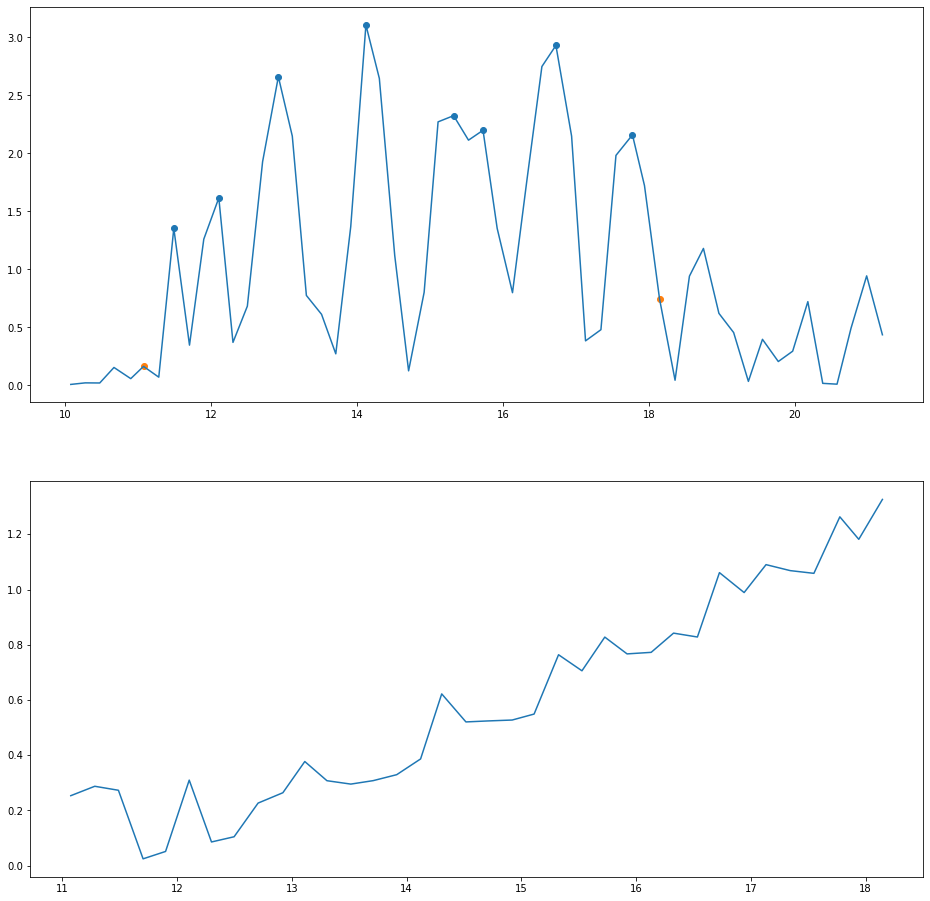

('2', 1, 'Male', 78, 68, False, 7.0725, 8, 0.8985, 40.038399999999996, 0.5888, 4.0464, -441.7479)
('2', 1, 'Male', 78, 68, False, 7.0725, 8, 0.8985, 40.038399999999996, 0.5888, 4.0464, -441.7479, 0.0728)
('2', 1, 'Male', 78, 68, False, 7.0725, 8, 0.8985, 40.038399999999996, 0.5888, 4.0464, -441.7479, 0.0728, 0.0477, 0.182, 0.1578, 8, 101, 'Depressive Syndrome')
('2', 1, 'Male', 78, 68, False, 7.0725, 8, 0.8985, 40.038399999999996, 0.5888, 4.0464, -441.7479, 0.0728, 0.0477, 0.182, 0.1578, 8, 102, 'Left Ventricular Hypertrophy')
('2', 1, 'Male', 78, 68, False, 7.0725, 8, 0.8985, 40.038399999999996, 0.5888, 4.0464, -441.7479, 0.0728, 0.0477, 0.182, 0.1578, 8, 103, 'Diabetes')
('2', 1, 'Male', 78, 68, False, 7.0725, 8, 0.8985, 40.038399999999996, 0.5888, 4.0464, -441.7479, 0.0728, 0.0477, 0.182, 0.1578, 8, 104, 'Arterial Hypertension')


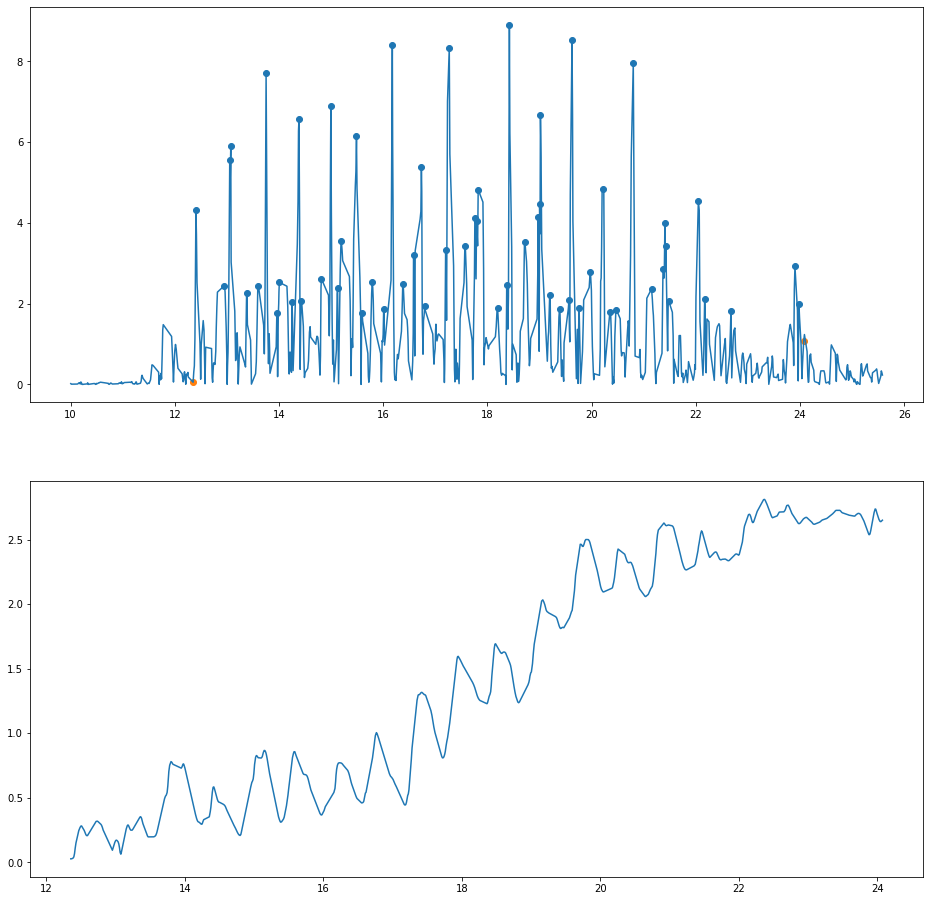

('3', 2, 'Male', 60, 122, False, 11.7205, 58, 0.2036, 175.5824, 1.4392, 16.915, 22850.7835)
('3', 2, 'Male', 60, 122, False, 11.7205, 58, 0.2036, 175.5824, 1.4392, 16.915, 22850.7835, 0.2041)
('3', 2, 'Male', 60, 122, False, 11.7205, 58, 0.2036, 175.5824, 1.4392, 16.915, 22850.7835, 0.2041, -0.0276, 0.0188, -0.1066, 9, 105, 'Schizophrenia')
('3', 2, 'Male', 60, 122, False, 11.7205, 58, 0.2036, 175.5824, 1.4392, 16.915, 22850.7835, 0.2041, -0.0276, 0.0188, -0.1066, 9, 106, 'Dyslipidemia')
('3', 2, 'Male', 60, 122, False, 11.7205, 58, 0.2036, 175.5824, 1.4392, 16.915, 22850.7835, 0.2041, -0.0276, 0.0188, -0.1066, 9, 103, 'Diabetes')
('3', 2, 'Male', 60, 122, False, 11.7205, 58, 0.2036, 175.5824, 1.4392, 16.915, 22850.7835, 0.2041, -0.0276, 0.0188, -0.1066, 9, 107, 'Chronic Venous Insufficiency')
('3', 2, 'Male', 60, 122, False, 11.7205, 58, 0.2036, 175.5824, 1.4392, 16.915, 22850.7835, 0.2041, -0.0276, 0.0188, -0.1066, 9, 108, 'Obstructive Sleep Apnea Syndrome')
('3', 2, 'Male', 60, 122,

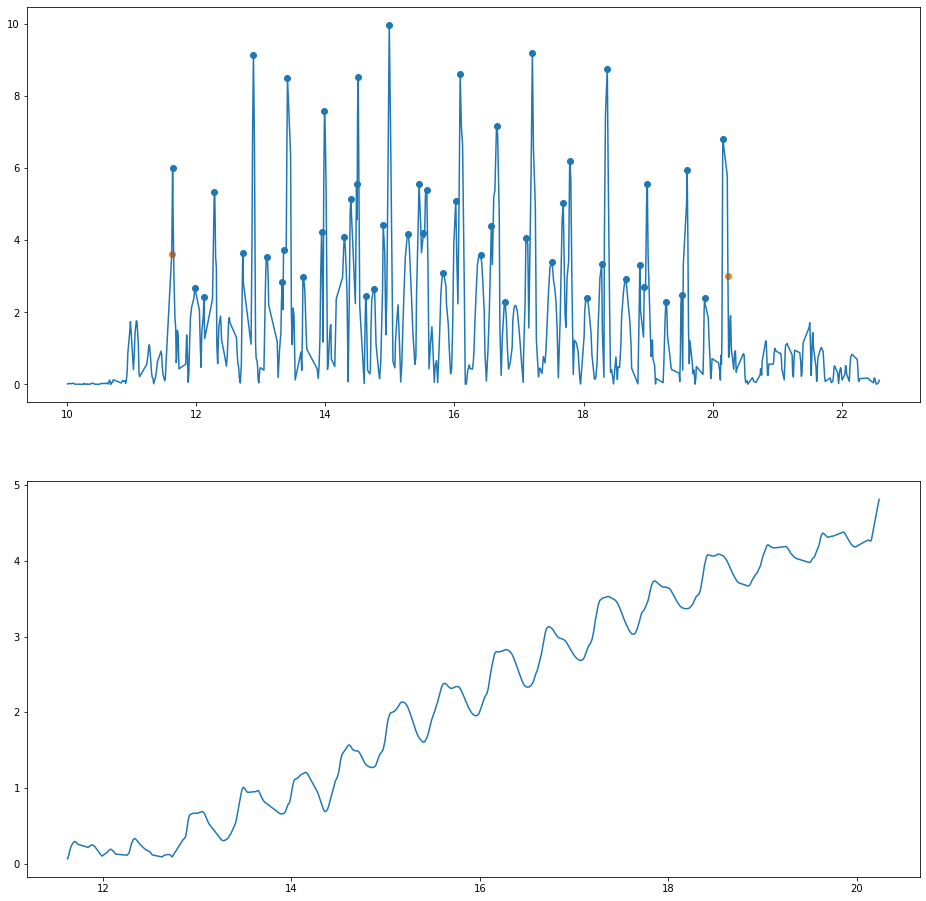

('4', 2, 'Male', 60, 122, False, 8.6125, 49, 0.178, 268.7172, 2.2026, 19.1242, 60597.6933)
('4', 2, 'Male', 60, 122, False, 8.6125, 49, 0.178, 268.7172, 2.2026, 19.1242, 60597.6933, 0.2553)
('4', 2, 'Male', 60, 122, False, 8.6125, 49, 0.178, 268.7172, 2.2026, 19.1242, 60597.6933, 0.2553, 0.072, 0.1451, -0.0253, 9, 105, 'Schizophrenia')
('4', 2, 'Male', 60, 122, False, 8.6125, 49, 0.178, 268.7172, 2.2026, 19.1242, 60597.6933, 0.2553, 0.072, 0.1451, -0.0253, 9, 106, 'Dyslipidemia')
('4', 2, 'Male', 60, 122, False, 8.6125, 49, 0.178, 268.7172, 2.2026, 19.1242, 60597.6933, 0.2553, 0.072, 0.1451, -0.0253, 9, 103, 'Diabetes')
('4', 2, 'Male', 60, 122, False, 8.6125, 49, 0.178, 268.7172, 2.2026, 19.1242, 60597.6933, 0.2553, 0.072, 0.1451, -0.0253, 9, 107, 'Chronic Venous Insufficiency')
('4', 2, 'Male', 60, 122, False, 8.6125, 49, 0.178, 268.7172, 2.2026, 19.1242, 60597.6933, 0.2553, 0.072, 0.1451, -0.0253, 9, 108, 'Obstructive Sleep Apnea Syndrome')
('4', 2, 'Male', 60, 122, False, 8.6125, 4

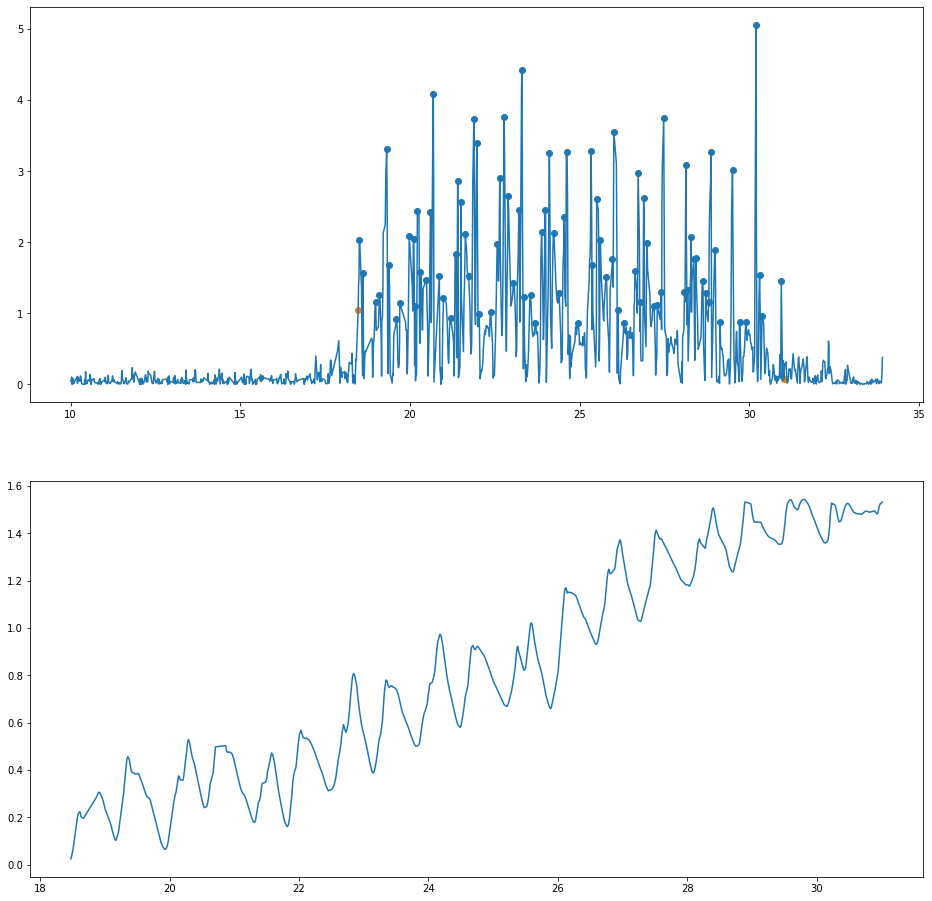

('5', 3, 'Male', 78, 62, False, 12.5445, 83, 0.1522, 51.4414, 0.8297, 10.4003, 2852.8065)
('5', 3, 'Male', 78, 62, False, 12.5445, 83, 0.1522, 51.4414, 0.8297, 10.4003, 2852.8065, 3.2579)
('5', 3, 'Male', 78, 62, False, 12.5445, 83, 0.1522, 51.4414, 0.8297, 10.4003, 2852.8065, 3.2579, -0.0621, 0.0785, 0.0609, 6, 113, 'Psychosis')
('5', 3, 'Male', 78, 62, False, 12.5445, 83, 0.1522, 51.4414, 0.8297, 10.4003, 2852.8065, 3.2579, -0.0621, 0.0785, 0.0609, 6, 114, 'Aggressiveness')
('5', 3, 'Male', 78, 62, False, 12.5445, 83, 0.1522, 51.4414, 0.8297, 10.4003, 2852.8065, 3.2579, -0.0621, 0.0785, 0.0609, 6, 115, 'Hallucinations')


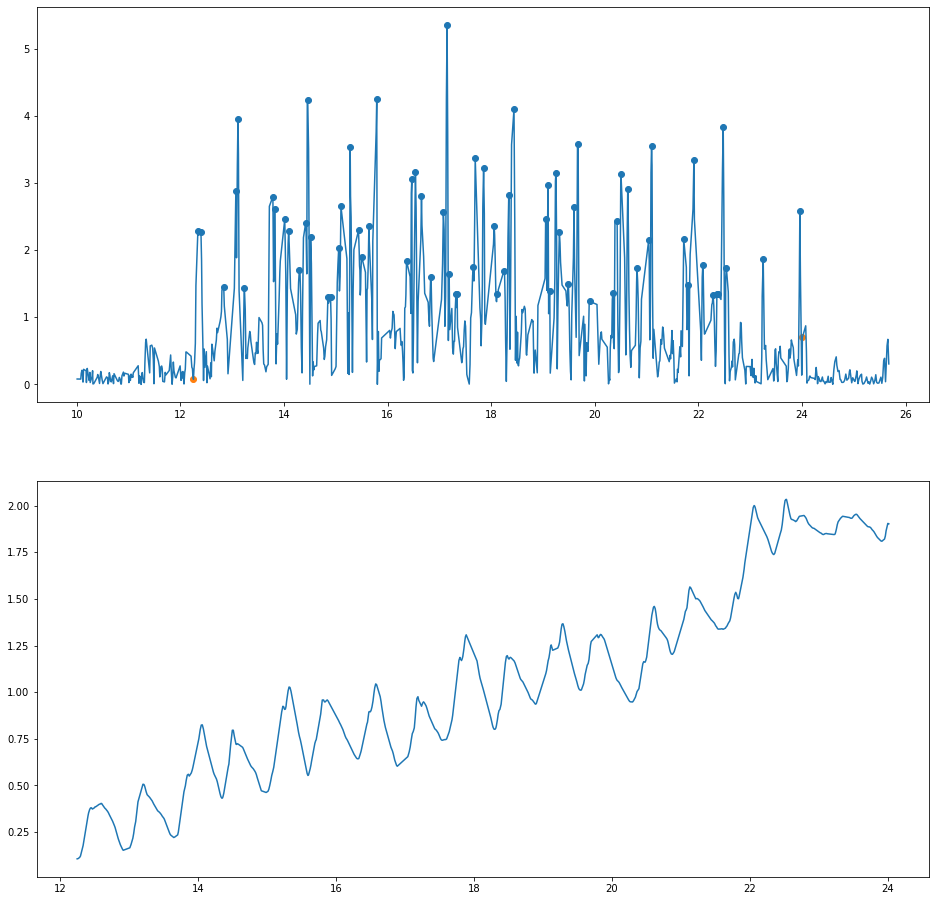

('6', 3, 'Male', 78, 62, False, 11.7585, 68, 0.174, 65.47200000000001, 1.056, 12.3444, 4144.2045)
('6', 3, 'Male', 78, 62, False, 11.7585, 68, 0.174, 65.47200000000001, 1.056, 12.3444, 4144.2045, 0.3176)
('6', 3, 'Male', 78, 62, False, 11.7585, 68, 0.174, 65.47200000000001, 1.056, 12.3444, 4144.2045, 0.3176, 0.1244, 0.1486, 0.1824, 6, 113, 'Psychosis')
('6', 3, 'Male', 78, 62, False, 11.7585, 68, 0.174, 65.47200000000001, 1.056, 12.3444, 4144.2045, 0.3176, 0.1244, 0.1486, 0.1824, 6, 114, 'Aggressiveness')
('6', 3, 'Male', 78, 62, False, 11.7585, 68, 0.174, 65.47200000000001, 1.056, 12.3444, 4144.2045, 0.3176, 0.1244, 0.1486, 0.1824, 6, 115, 'Hallucinations')


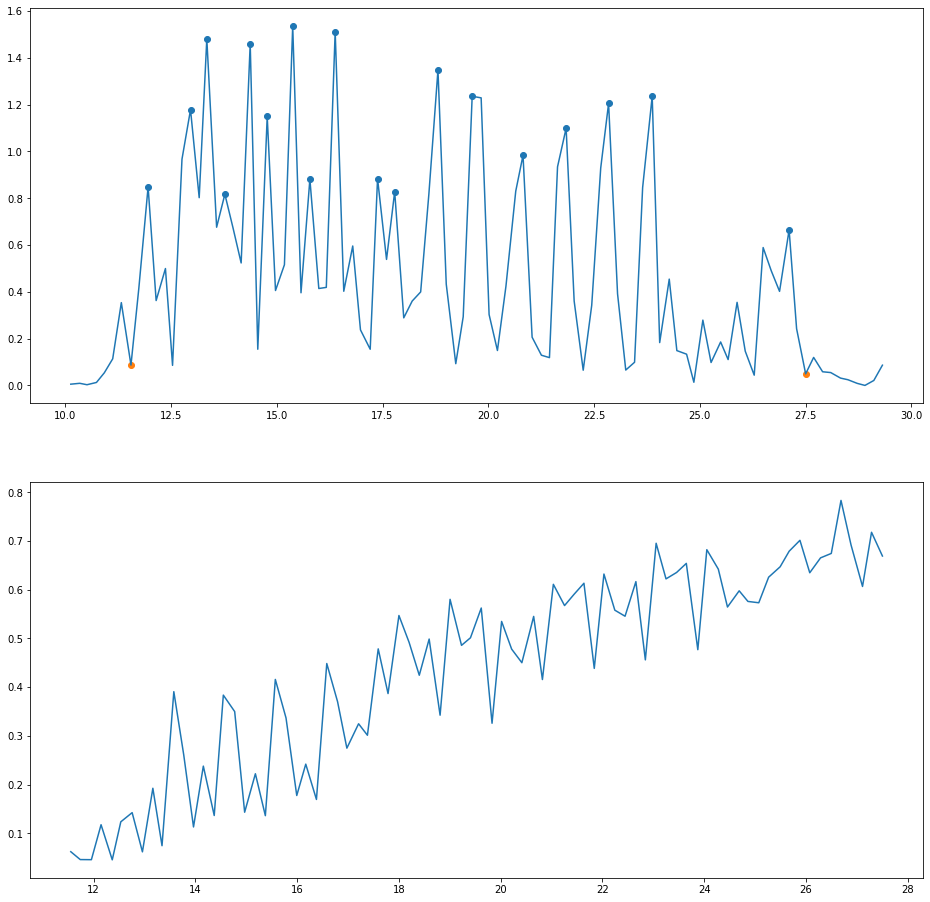

('7', 4, 'Female', 69, 50, False, 15.9515, 18, 0.892, 21.795, 0.4359, 6.9214, -127.9445)
('7', 4, 'Female', 69, 50, False, 15.9515, 18, 0.892, 21.795, 0.4359, 6.9214, -127.9445, 0.2069)
('7', 4, 'Female', 69, 50, False, 15.9515, 18, 0.892, 21.795, 0.4359, 6.9214, -127.9445, 0.2069, 0.047, -0.043, -0.1245, 6, 116, 'Endogenous Depression')
('7', 4, 'Female', 69, 50, False, 15.9515, 18, 0.892, 21.795, 0.4359, 6.9214, -127.9445, 0.2069, 0.047, -0.043, -0.1245, 6, 111, 'Occlusive Peripheral Artery Disease')
('7', 4, 'Female', 69, 50, False, 15.9515, 18, 0.892, 21.795, 0.4359, 6.9214, -127.9445, 0.2069, 0.047, -0.043, -0.1245, 6, 117, 'Intellectual Deficit')
('7', 4, 'Female', 69, 50, False, 15.9515, 18, 0.892, 21.795, 0.4359, 6.9214, -127.9445, 0.2069, 0.047, -0.043, -0.1245, 6, 118, 'Atrioventricular Block')
('7', 4, 'Female', 69, 50, False, 15.9515, 18, 0.892, 21.795, 0.4359, 6.9214, -127.9445, 0.2069, 0.047, -0.043, -0.1245, 6, 119, 'Cataract')
('7', 4, 'Female', 69, 50, False, 15.9515, 

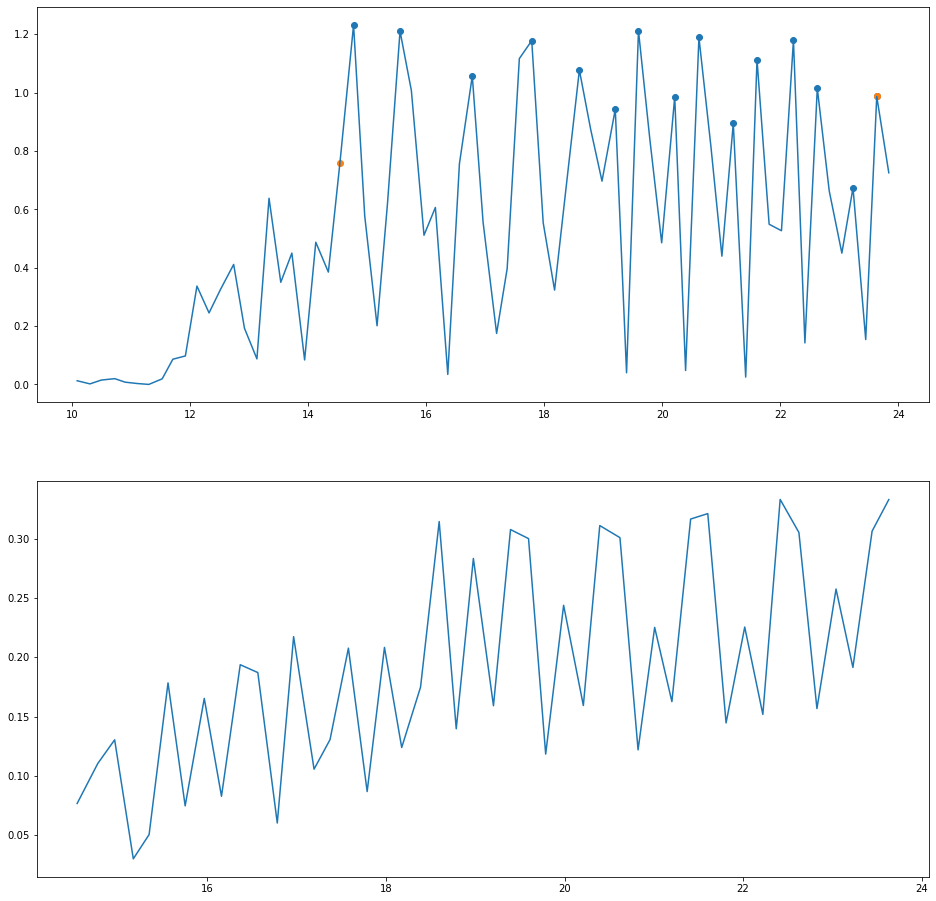

('8', 4, 'Female', 69, 50, False, 9.0935, 15, 0.6335, 9.58, 0.1916, 1.7201, -133.7195)
('8', 4, 'Female', 69, 50, False, 9.0935, 15, 0.6335, 9.58, 0.1916, 1.7201, -133.7195, 0.3791)
('8', 4, 'Female', 69, 50, False, 9.0935, 15, 0.6335, 9.58, 0.1916, 1.7201, -133.7195, 0.3791, 0.115, 0.1005, 0.3647, 6, 116, 'Endogenous Depression')
('8', 4, 'Female', 69, 50, False, 9.0935, 15, 0.6335, 9.58, 0.1916, 1.7201, -133.7195, 0.3791, 0.115, 0.1005, 0.3647, 6, 111, 'Occlusive Peripheral Artery Disease')
('8', 4, 'Female', 69, 50, False, 9.0935, 15, 0.6335, 9.58, 0.1916, 1.7201, -133.7195, 0.3791, 0.115, 0.1005, 0.3647, 6, 117, 'Intellectual Deficit')
('8', 4, 'Female', 69, 50, False, 9.0935, 15, 0.6335, 9.58, 0.1916, 1.7201, -133.7195, 0.3791, 0.115, 0.1005, 0.3647, 6, 118, 'Atrioventricular Block')
('8', 4, 'Female', 69, 50, False, 9.0935, 15, 0.6335, 9.58, 0.1916, 1.7201, -133.7195, 0.3791, 0.115, 0.1005, 0.3647, 6, 119, 'Cataract')
('8', 4, 'Female', 69, 50, False, 9.0935, 15, 0.6335, 9.58, 0.

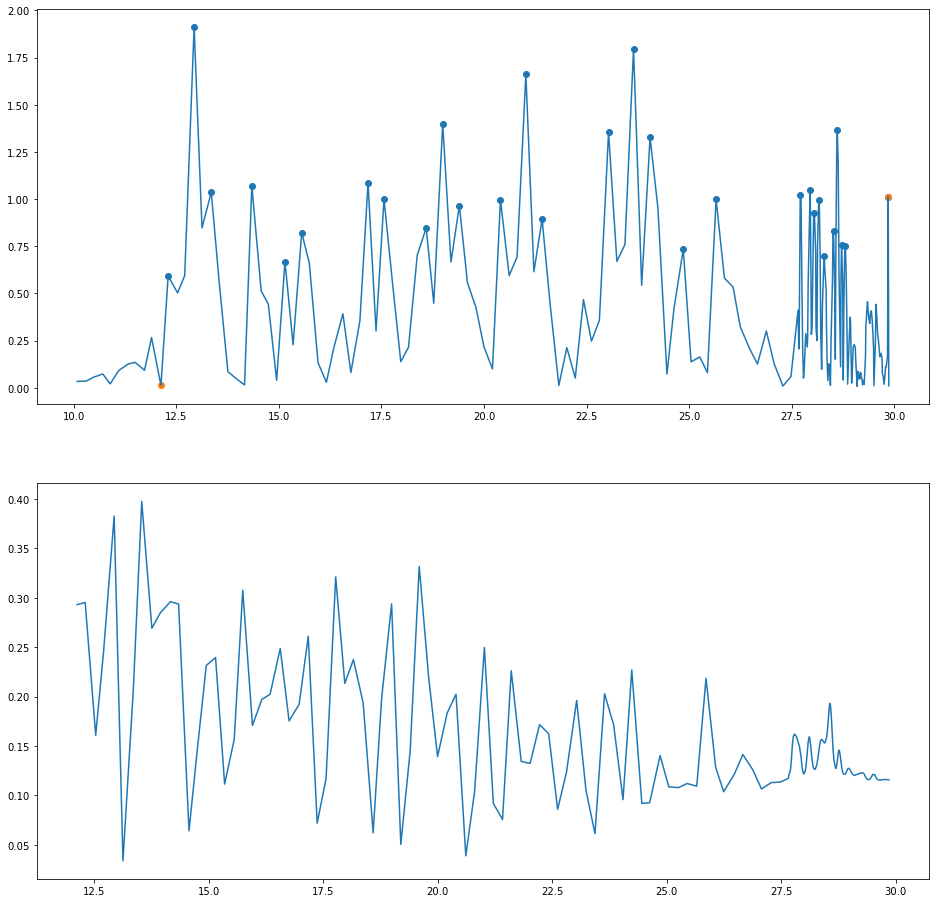

('9', 5, 'Female', 78, 77, False, 17.7225, 29, 0.6272, 11.596200000000001, 0.1506, 3.0971, -310.9255)
('9', 5, 'Female', 78, 77, False, 17.7225, 29, 0.6272, 11.596200000000001, 0.1506, 3.0971, -310.9255, 0.0626)
('9', 5, 'Female', 78, 77, False, 17.7225, 29, 0.6272, 11.596200000000001, 0.1506, 3.0971, -310.9255, 0.0626, -0.045, 0.0402, -0.0341, 8, 121, 'Depressive-Anxious Syndrome')
('9', 5, 'Female', 78, 77, False, 17.7225, 29, 0.6272, 11.596200000000001, 0.1506, 3.0971, -310.9255, 0.0626, -0.045, 0.0402, -0.0341, 8, 122, 'Osteoporosis')
('9', 5, 'Female', 78, 77, False, 17.7225, 29, 0.6272, 11.596200000000001, 0.1506, 3.0971, -310.9255, 0.0626, -0.045, 0.0402, -0.0341, 8, 123, 'Varicose Veins')
('9', 5, 'Female', 78, 77, False, 17.7225, 29, 0.6272, 11.596200000000001, 0.1506, 3.0971, -310.9255, 0.0626, -0.045, 0.0402, -0.0341, 8, 124, 'Sinus Bradycardia')
('9', 5, 'Female', 78, 77, False, 17.7225, 29, 0.6272, 11.596200000000001, 0.1506, 3.0971, -310.9255, 0.0626, -0.045, 0.0402, -0.0

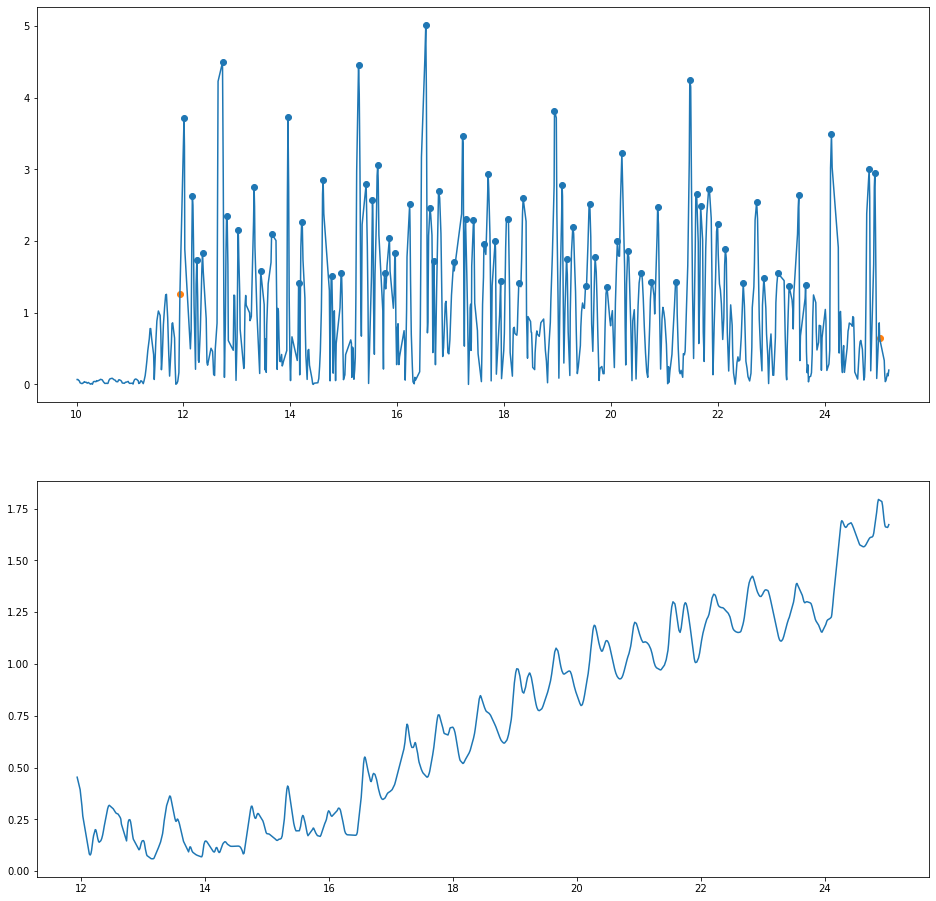

('10', 5, 'Female', 78, 77, False, 13.0955, 70, 0.1879, 56.4256, 0.7328, 9.5442, 3193.8527)
('10', 5, 'Female', 78, 77, False, 13.0955, 70, 0.1879, 56.4256, 0.7328, 9.5442, 3193.8527, 0.0853)
('10', 5, 'Female', 78, 77, False, 13.0955, 70, 0.1879, 56.4256, 0.7328, 9.5442, 3193.8527, 0.0853, 0.0321, 0.2053, 0.0179, 8, 121, 'Depressive-Anxious Syndrome')
('10', 5, 'Female', 78, 77, False, 13.0955, 70, 0.1879, 56.4256, 0.7328, 9.5442, 3193.8527, 0.0853, 0.0321, 0.2053, 0.0179, 8, 122, 'Osteoporosis')
('10', 5, 'Female', 78, 77, False, 13.0955, 70, 0.1879, 56.4256, 0.7328, 9.5442, 3193.8527, 0.0853, 0.0321, 0.2053, 0.0179, 8, 123, 'Varicose Veins')
('10', 5, 'Female', 78, 77, False, 13.0955, 70, 0.1879, 56.4256, 0.7328, 9.5442, 3193.8527, 0.0853, 0.0321, 0.2053, 0.0179, 8, 124, 'Sinus Bradycardia')
('10', 5, 'Female', 78, 77, False, 13.0955, 70, 0.1879, 56.4256, 0.7328, 9.5442, 3193.8527, 0.0853, 0.0321, 0.2053, 0.0179, 8, 106, 'Dyslipidemia')
('10', 5, 'Female', 78, 77, False, 13.0955, 70

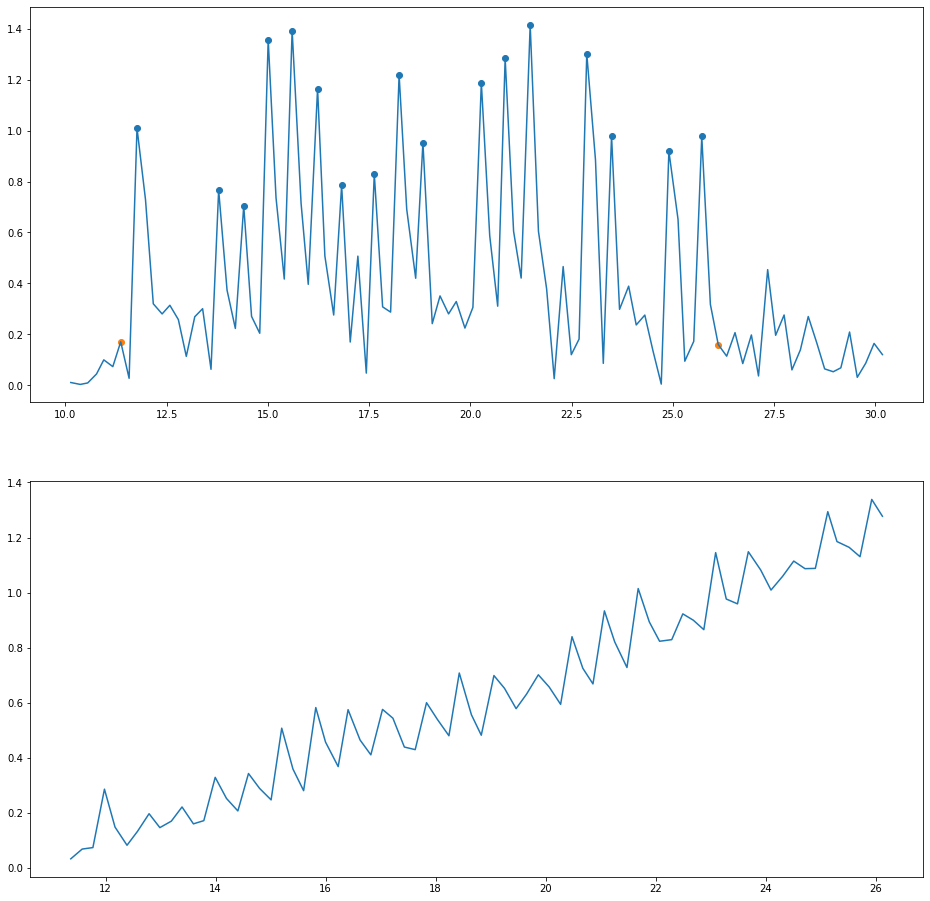

('11', 6, 'Female', 93, 69, False, 14.7525, 17, 0.8719, 43.380300000000005, 0.6287, 9.1307, 21.2525)
('11', 6, 'Female', 93, 69, False, 14.7525, 17, 0.8719, 43.380300000000005, 0.6287, 9.1307, 21.2525, 0.199)
('11', 6, 'Female', 93, 69, False, 14.7525, 17, 0.8719, 43.380300000000005, 0.6287, 9.1307, 21.2525, 0.199, 0.0105, -0.049, -0.1342, 9, 104, 'Arterial Hypertension')
('11', 6, 'Female', 93, 69, False, 14.7525, 17, 0.8719, 43.380300000000005, 0.6287, 9.1307, 21.2525, 0.199, 0.0105, -0.049, -0.1342, 9, 127, 'Dizziness Syndrome')
('11', 6, 'Female', 93, 69, False, 14.7525, 17, 0.8719, 43.380300000000005, 0.6287, 9.1307, 21.2525, 0.199, 0.0105, -0.049, -0.1342, 9, 128, 'Insanity')
('11', 6, 'Female', 93, 69, False, 14.7525, 17, 0.8719, 43.380300000000005, 0.6287, 9.1307, 21.2525, 0.199, 0.0105, -0.049, -0.1342, 9, 129, 'Perceptual Hypoacusis')
('11', 6, 'Female', 93, 69, False, 14.7525, 17, 0.8719, 43.380300000000005, 0.6287, 9.1307, 21.2525, 0.199, 0.0105, -0.049, -0.1342, 9, 130, 'D

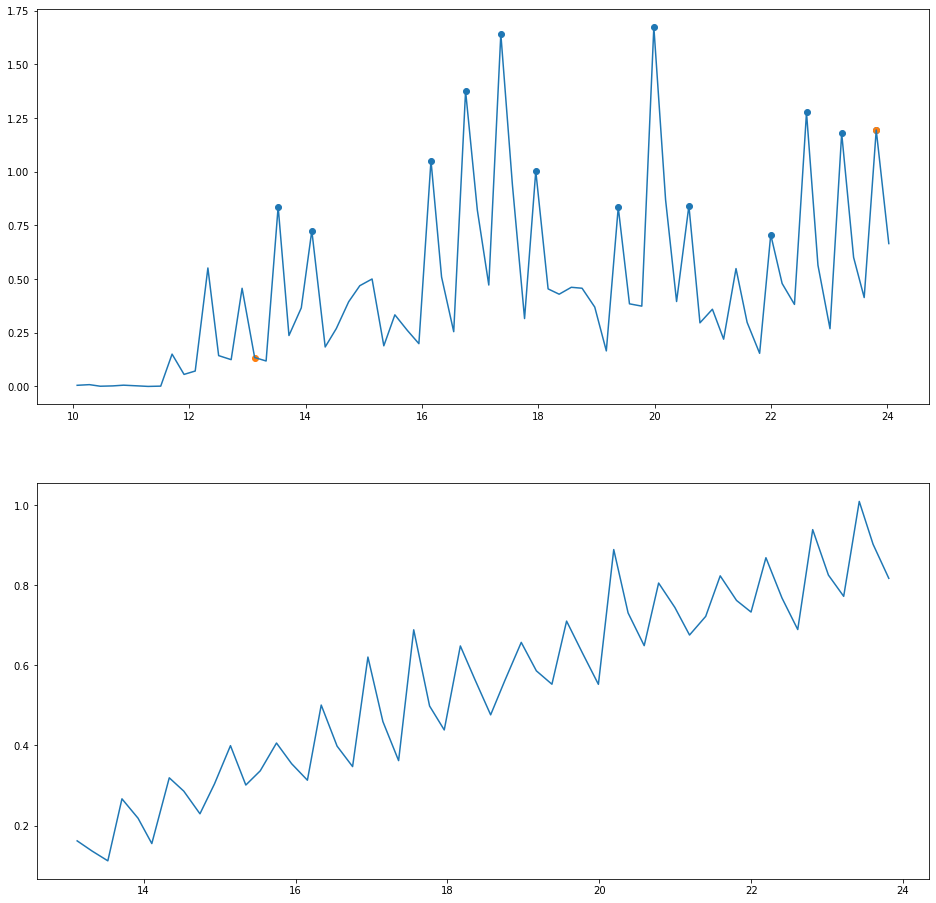

('12', 6, 'Female', 93, 69, False, 10.6885, 13, 0.8575, 37.956900000000005, 0.5501, 5.8377, 23.1362)
('12', 6, 'Female', 93, 69, False, 10.6885, 13, 0.8575, 37.956900000000005, 0.5501, 5.8377, 23.1362, 0.0794)
('12', 6, 'Female', 93, 69, False, 10.6885, 13, 0.8575, 37.956900000000005, 0.5501, 5.8377, 23.1362, 0.0794, 0.1303, 0.2019, 0.1509, 9, 104, 'Arterial Hypertension')
('12', 6, 'Female', 93, 69, False, 10.6885, 13, 0.8575, 37.956900000000005, 0.5501, 5.8377, 23.1362, 0.0794, 0.1303, 0.2019, 0.1509, 9, 127, 'Dizziness Syndrome')
('12', 6, 'Female', 93, 69, False, 10.6885, 13, 0.8575, 37.956900000000005, 0.5501, 5.8377, 23.1362, 0.0794, 0.1303, 0.2019, 0.1509, 9, 128, 'Insanity')
('12', 6, 'Female', 93, 69, False, 10.6885, 13, 0.8575, 37.956900000000005, 0.5501, 5.8377, 23.1362, 0.0794, 0.1303, 0.2019, 0.1509, 9, 129, 'Perceptual Hypoacusis')
('12', 6, 'Female', 93, 69, False, 10.6885, 13, 0.8575, 37.956900000000005, 0.5501, 5.8377, 23.1362, 0.0794, 0.1303, 0.2019, 0.1509, 9, 130, '

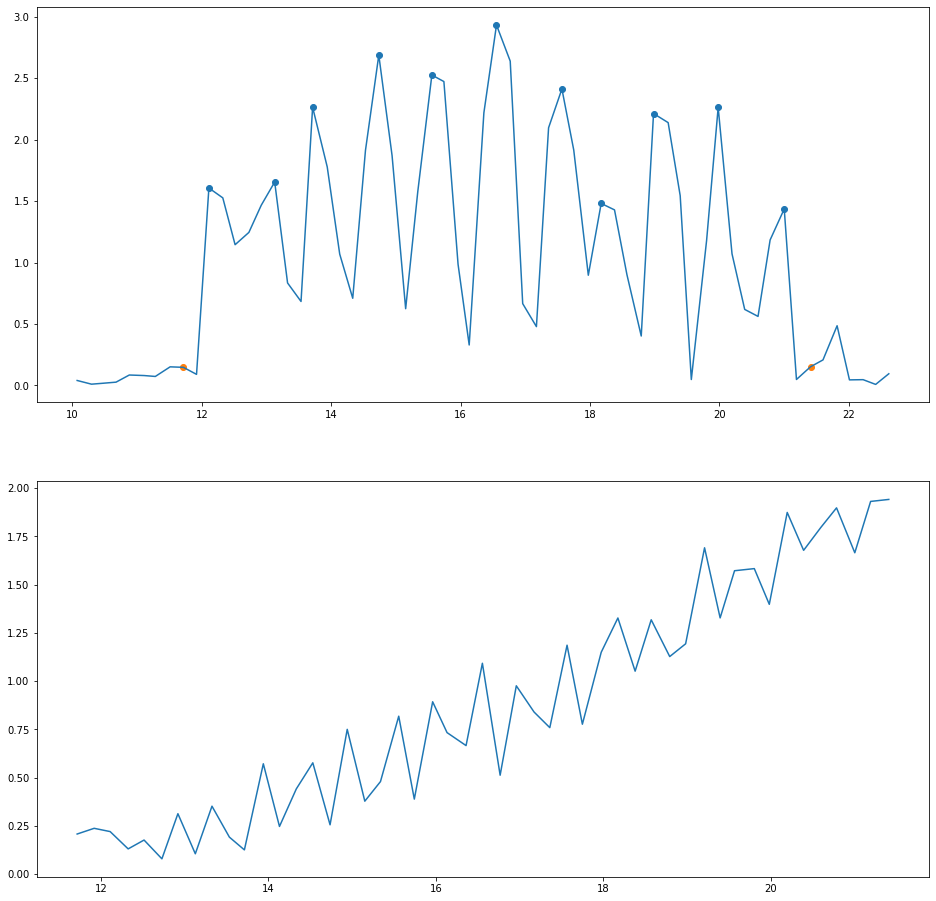

('13', 7, 'Male', 92, 72, False, 9.6925, 11, 0.8897, 63.216, 0.878, 8.3362, -280.4179)
('13', 7, 'Male', 92, 72, False, 9.6925, 11, 0.8897, 63.216, 0.878, 8.3362, -280.4179, 0.2859)
('13', 7, 'Male', 92, 72, False, 9.6925, 11, 0.8897, 63.216, 0.878, 8.3362, -280.4179, 0.2859, -0.0747, 0.0138, -0.1346, 9, 104, 'Arterial Hypertension')
('13', 7, 'Male', 92, 72, False, 9.6925, 11, 0.8897, 63.216, 0.878, 8.3362, -280.4179, 0.2859, -0.0747, 0.0138, -0.1346, 9, 124, 'Sinus Bradycardia')
('13', 7, 'Male', 92, 72, False, 9.6925, 11, 0.8897, 63.216, 0.878, 8.3362, -280.4179, 0.2859, -0.0747, 0.0138, -0.1346, 9, 118, 'Atrioventricular Block')
('13', 7, 'Male', 92, 72, False, 9.6925, 11, 0.8897, 63.216, 0.878, 8.3362, -280.4179, 0.2859, -0.0747, 0.0138, -0.1346, 9, 136, 'Stroke')
('13', 7, 'Male', 92, 72, False, 9.6925, 11, 0.8897, 63.216, 0.878, 8.3362, -280.4179, 0.2859, -0.0747, 0.0138, -0.1346, 9, 106, 'Dyslipidemia')
('13', 7, 'Male', 92, 72, False, 9.6925, 11, 0.8897, 63.216, 0.878, 8.3362,

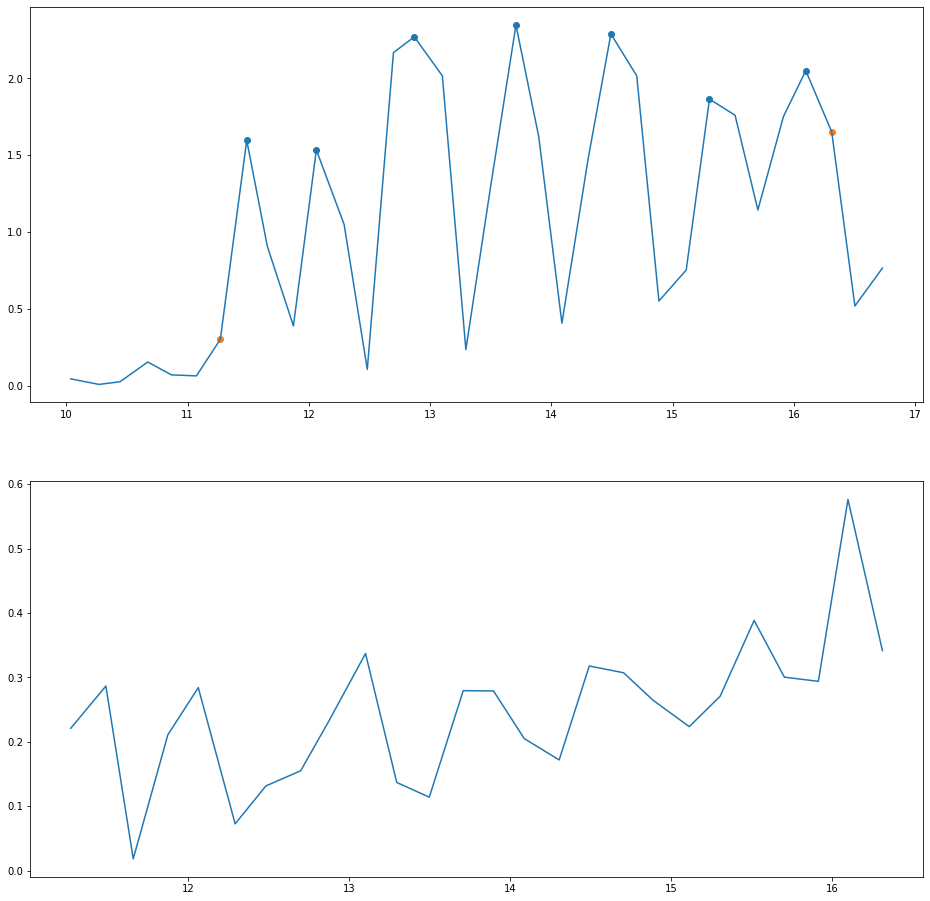

('14', 7, 'Male', 92, 72, False, 5.0425, 7, 0.7688, 17.82, 0.2475, 1.2669, -399.8731)
('14', 7, 'Male', 92, 72, False, 5.0425, 7, 0.7688, 17.82, 0.2475, 1.2669, -399.8731, 0.1611)
('14', 7, 'Male', 92, 72, False, 5.0425, 7, 0.7688, 17.82, 0.2475, 1.2669, -399.8731, 0.1611, 0.0516, -0.0015, 0.2048, 9, 104, 'Arterial Hypertension')
('14', 7, 'Male', 92, 72, False, 5.0425, 7, 0.7688, 17.82, 0.2475, 1.2669, -399.8731, 0.1611, 0.0516, -0.0015, 0.2048, 9, 124, 'Sinus Bradycardia')
('14', 7, 'Male', 92, 72, False, 5.0425, 7, 0.7688, 17.82, 0.2475, 1.2669, -399.8731, 0.1611, 0.0516, -0.0015, 0.2048, 9, 118, 'Atrioventricular Block')
('14', 7, 'Male', 92, 72, False, 5.0425, 7, 0.7688, 17.82, 0.2475, 1.2669, -399.8731, 0.1611, 0.0516, -0.0015, 0.2048, 9, 136, 'Stroke')
('14', 7, 'Male', 92, 72, False, 5.0425, 7, 0.7688, 17.82, 0.2475, 1.2669, -399.8731, 0.1611, 0.0516, -0.0015, 0.2048, 9, 106, 'Dyslipidemia')
('14', 7, 'Male', 92, 72, False, 5.0425, 7, 0.7688, 17.82, 0.2475, 1.2669, -399.8731, 0

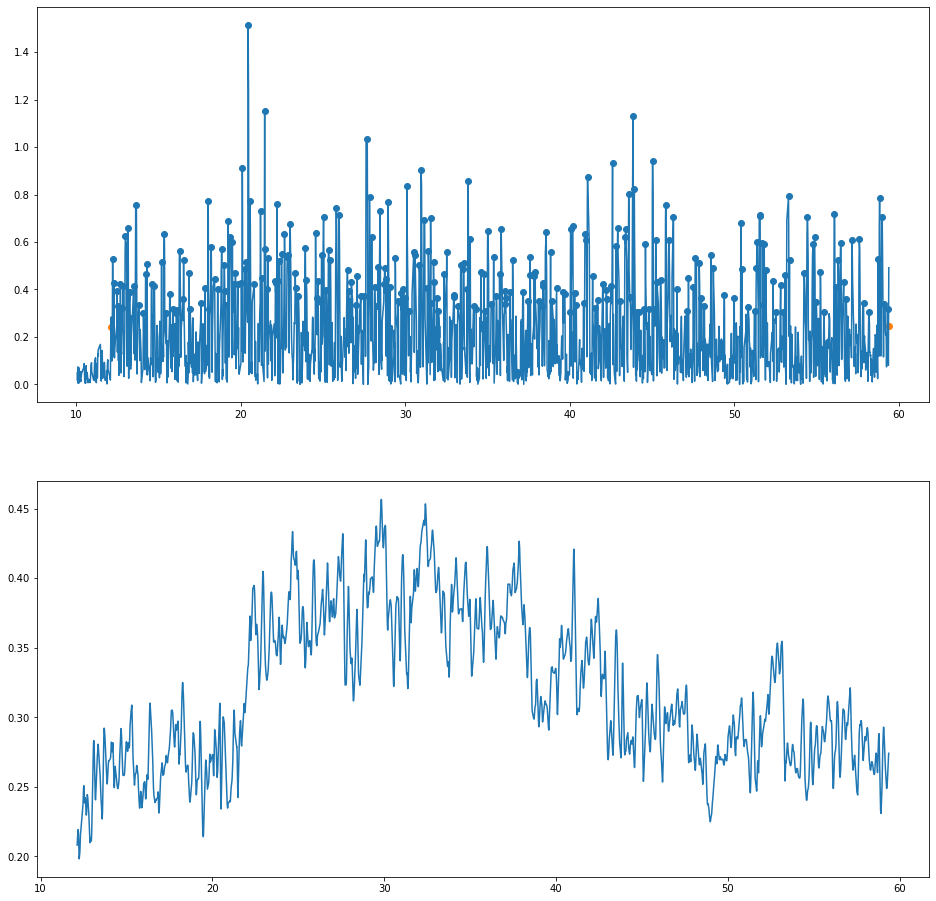

('15', 8, 'Male', 86, 106, True, 47.2385, 263, 0.1802, 33.8034, 0.3189, 15.0551, 281.2291)
('15', 8, 'Male', 86, 106, True, 47.2385, 263, 0.1802, 33.8034, 0.3189, 15.0551, 281.2291, 0.1157)
('15', 8, 'Male', 86, 106, True, 47.2385, 263, 0.1802, 33.8034, 0.3189, 15.0551, 281.2291, 0.1157, 0.0463, 0.0143, -0.0836, 9, 104, 'Arterial Hypertension')
('15', 8, 'Male', 86, 106, True, 47.2385, 263, 0.1802, 33.8034, 0.3189, 15.0551, 281.2291, 0.1157, 0.0463, 0.0143, -0.0836, 9, 141, 'Diverticular Disease')
('15', 8, 'Male', 86, 106, True, 47.2385, 263, 0.1802, 33.8034, 0.3189, 15.0551, 281.2291, 0.1157, 0.0463, 0.0143, -0.0836, 9, 142, 'Heart Failure')
('15', 8, 'Male', 86, 106, True, 47.2385, 263, 0.1802, 33.8034, 0.3189, 15.0551, 281.2291, 0.1157, 0.0463, 0.0143, -0.0836, 9, 143, 'Cardiomyopathy')
('15', 8, 'Male', 86, 106, True, 47.2385, 263, 0.1802, 33.8034, 0.3189, 15.0551, 281.2291, 0.1157, 0.0463, 0.0143, -0.0836, 9, 144, 'Right Gonarthrosis')
('15', 8, 'Male', 86, 106, True, 47.2385, 26

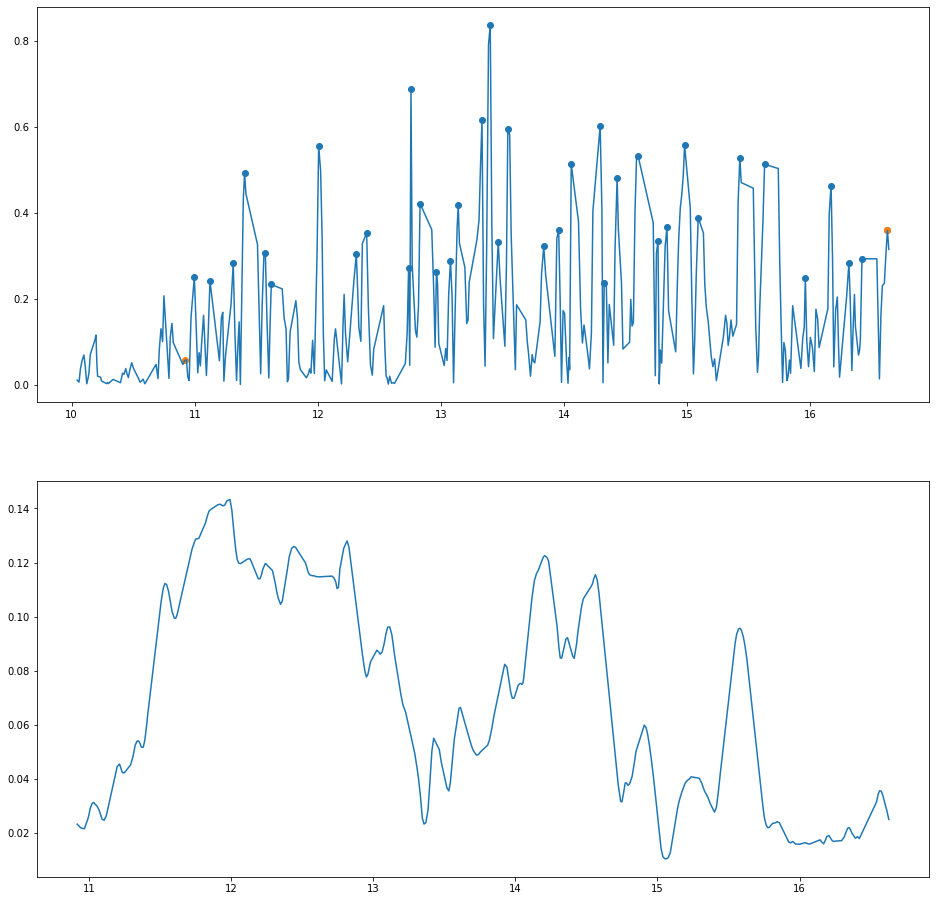

('16', 8, 'Male', 86, 106, True, 5.7095, 37, 0.1569, 7.271599999999999, 0.0686, 0.4, -17.9453)
('16', 8, 'Male', 86, 106, True, 5.7095, 37, 0.1569, 7.271599999999999, 0.0686, 0.4, -17.9453, 0.3647)
('16', 8, 'Male', 86, 106, True, 5.7095, 37, 0.1569, 7.271599999999999, 0.0686, 0.4, -17.9453, 0.3647, -0.0313, -0.0012, 0.1016, 9, 104, 'Arterial Hypertension')
('16', 8, 'Male', 86, 106, True, 5.7095, 37, 0.1569, 7.271599999999999, 0.0686, 0.4, -17.9453, 0.3647, -0.0313, -0.0012, 0.1016, 9, 141, 'Diverticular Disease')
('16', 8, 'Male', 86, 106, True, 5.7095, 37, 0.1569, 7.271599999999999, 0.0686, 0.4, -17.9453, 0.3647, -0.0313, -0.0012, 0.1016, 9, 142, 'Heart Failure')
('16', 8, 'Male', 86, 106, True, 5.7095, 37, 0.1569, 7.271599999999999, 0.0686, 0.4, -17.9453, 0.3647, -0.0313, -0.0012, 0.1016, 9, 143, 'Cardiomyopathy')
('16', 8, 'Male', 86, 106, True, 5.7095, 37, 0.1569, 7.271599999999999, 0.0686, 0.4, -17.9453, 0.3647, -0.0313, -0.0012, 0.1016, 9, 144, 'Right Gonarthrosis')
('16', 8, '

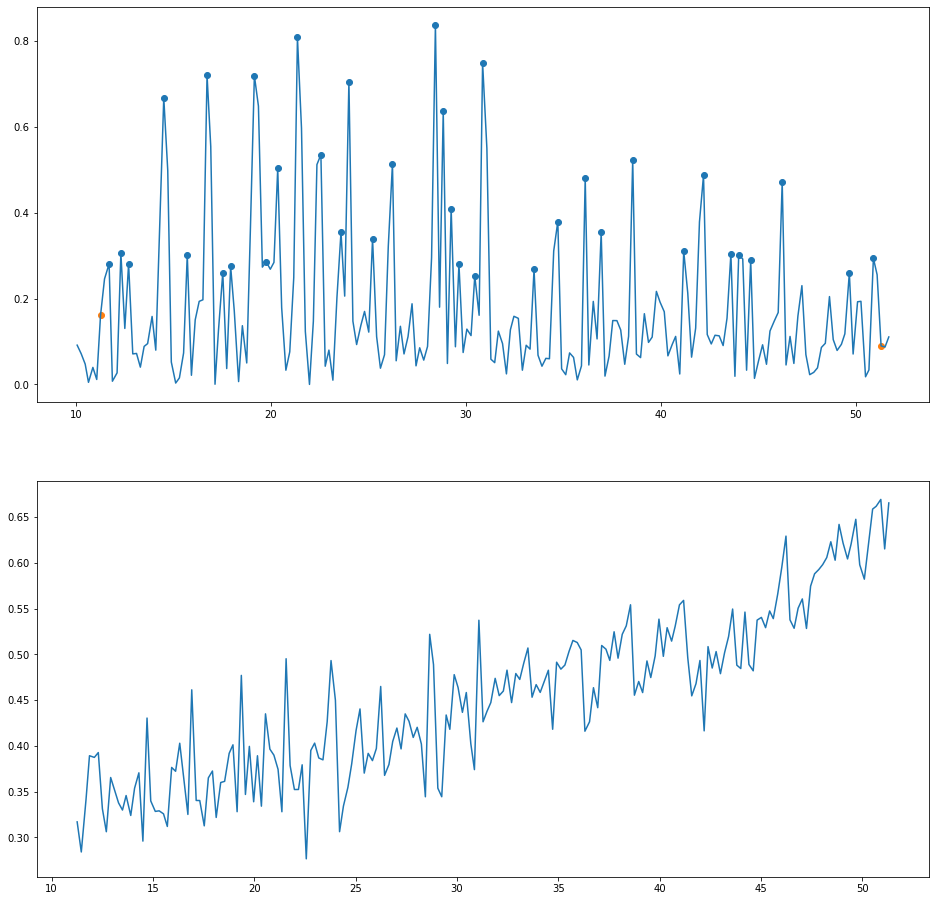

('17', 9, 'Female', 87, 79, True, 40.0395, 36, 1.1207, 35.7949, 0.4531, 18.1416, -36.142)
('17', 9, 'Female', 87, 79, True, 40.0395, 36, 1.1207, 35.7949, 0.4531, 18.1416, -36.142, 0.284)
('17', 9, 'Female', 87, 79, True, 40.0395, 36, 1.1207, 35.7949, 0.4531, 18.1416, -36.142, 0.284, -0.0199, -0.0118, -0.0761, 6, 149, 'Sequelae Of Peritoneal Tuberculosis')
('17', 9, 'Female', 87, 79, True, 40.0395, 36, 1.1207, 35.7949, 0.4531, 18.1416, -36.142, 0.284, -0.0199, -0.0118, -0.0761, 6, 137, 'Chronic Obstructive Pulmonary Disease')
('17', 9, 'Female', 87, 79, True, 40.0395, 36, 1.1207, 35.7949, 0.4531, 18.1416, -36.142, 0.284, -0.0199, -0.0118, -0.0761, 6, 104, 'Arterial Hypertension')
('17', 9, 'Female', 87, 79, True, 40.0395, 36, 1.1207, 35.7949, 0.4531, 18.1416, -36.142, 0.284, -0.0199, -0.0118, -0.0761, 6, 150, 'Pulmonary Arterial Hypertension')
('17', 9, 'Female', 87, 79, True, 40.0395, 36, 1.1207, 35.7949, 0.4531, 18.1416, -36.142, 0.284, -0.0199, -0.0118, -0.0761, 6, 151, 'Pacemaker')


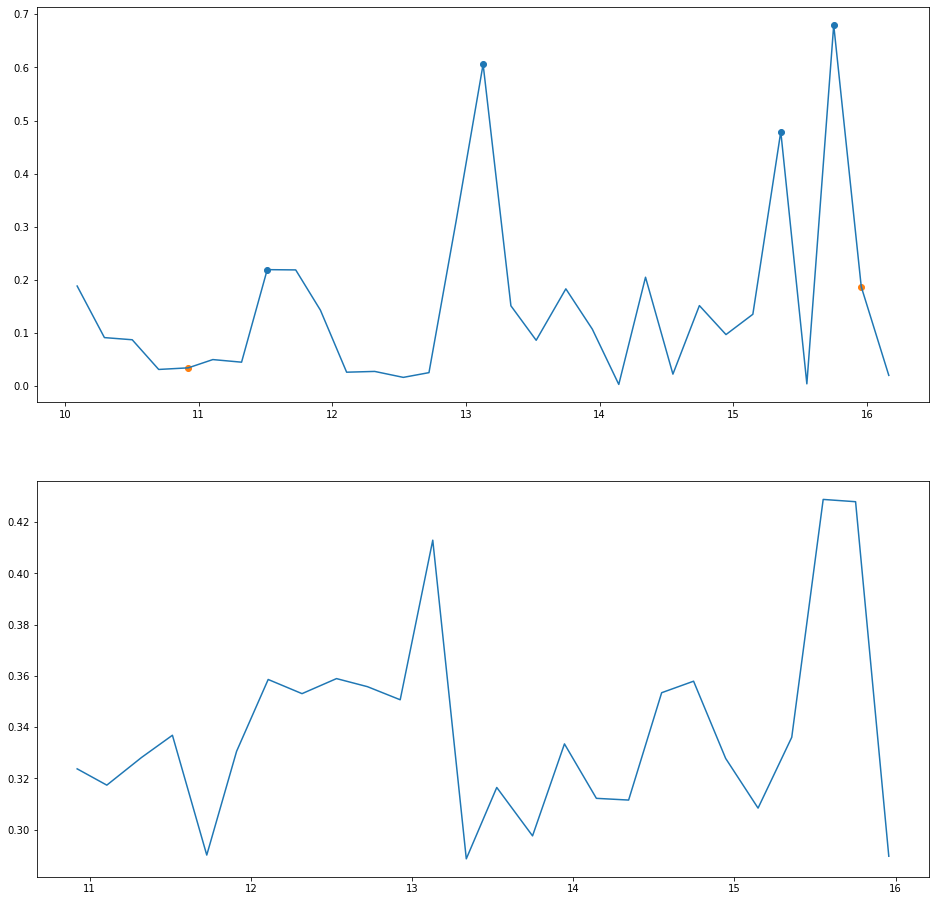

('18', 9, 'Female', 87, 79, True, 5.0355, 4, 1.4132, 26.7968, 0.3392, 1.7879, -9.1635)
('18', 9, 'Female', 87, 79, True, 5.0355, 4, 1.4132, 26.7968, 0.3392, 1.7879, -9.1635, 0.2903)
('18', 9, 'Female', 87, 79, True, 5.0355, 4, 1.4132, 26.7968, 0.3392, 1.7879, -9.1635, 0.2903, 0.1555, -0.0302, 0.1208, 6, 149, 'Sequelae Of Peritoneal Tuberculosis')
('18', 9, 'Female', 87, 79, True, 5.0355, 4, 1.4132, 26.7968, 0.3392, 1.7879, -9.1635, 0.2903, 0.1555, -0.0302, 0.1208, 6, 137, 'Chronic Obstructive Pulmonary Disease')
('18', 9, 'Female', 87, 79, True, 5.0355, 4, 1.4132, 26.7968, 0.3392, 1.7879, -9.1635, 0.2903, 0.1555, -0.0302, 0.1208, 6, 104, 'Arterial Hypertension')
('18', 9, 'Female', 87, 79, True, 5.0355, 4, 1.4132, 26.7968, 0.3392, 1.7879, -9.1635, 0.2903, 0.1555, -0.0302, 0.1208, 6, 150, 'Pulmonary Arterial Hypertension')
('18', 9, 'Female', 87, 79, True, 5.0355, 4, 1.4132, 26.7968, 0.3392, 1.7879, -9.1635, 0.2903, 0.1555, -0.0302, 0.1208, 6, 151, 'Pacemaker')
('18', 9, 'Female', 87, 7

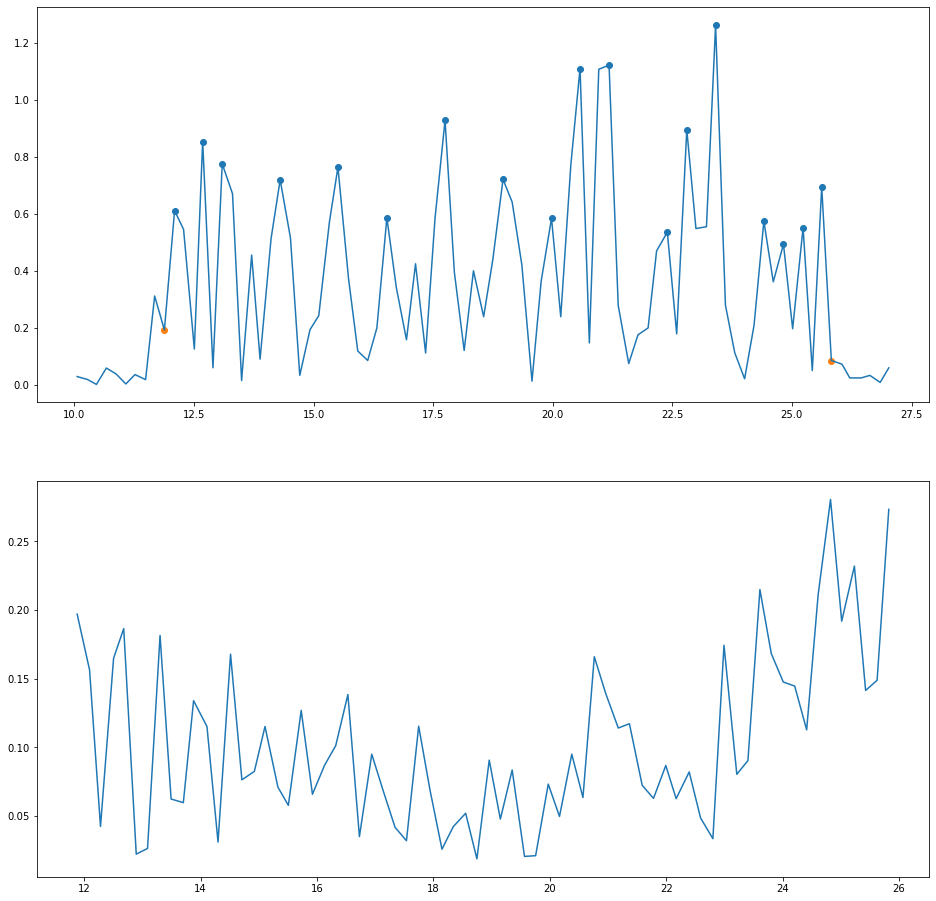

('19', 10, 'Female', 83, 59, False, 13.9435, 18, 0.7963, 6.1065, 0.1035, 1.4252, -109.238)
('19', 10, 'Female', 83, 59, False, 13.9435, 18, 0.7963, 6.1065, 0.1035, 1.4252, -109.238, 0.0575)
('19', 10, 'Female', 83, 59, False, 13.9435, 18, 0.7963, 6.1065, 0.1035, 1.4252, -109.238, 0.0575, 0.008, 0.0033, -0.0483, 8, 104, 'Arterial Hypertension')
('19', 10, 'Female', 83, 59, False, 13.9435, 18, 0.7963, 6.1065, 0.1035, 1.4252, -109.238, 0.0575, 0.008, 0.0033, -0.0483, 8, 128, 'Insanity')
('19', 10, 'Female', 83, 59, False, 13.9435, 18, 0.7963, 6.1065, 0.1035, 1.4252, -109.238, 0.0575, 0.008, 0.0033, -0.0483, 8, 106, 'Dyslipidemia')
('19', 10, 'Female', 83, 59, False, 13.9435, 18, 0.7963, 6.1065, 0.1035, 1.4252, -109.238, 0.0575, 0.008, 0.0033, -0.0483, 8, 155, 'Moderate Mitral Insufficiency')
('19', 10, 'Female', 83, 59, False, 13.9435, 18, 0.7963, 6.1065, 0.1035, 1.4252, -109.238, 0.0575, 0.008, 0.0033, -0.0483, 8, 156, 'Intestinal Bands;')


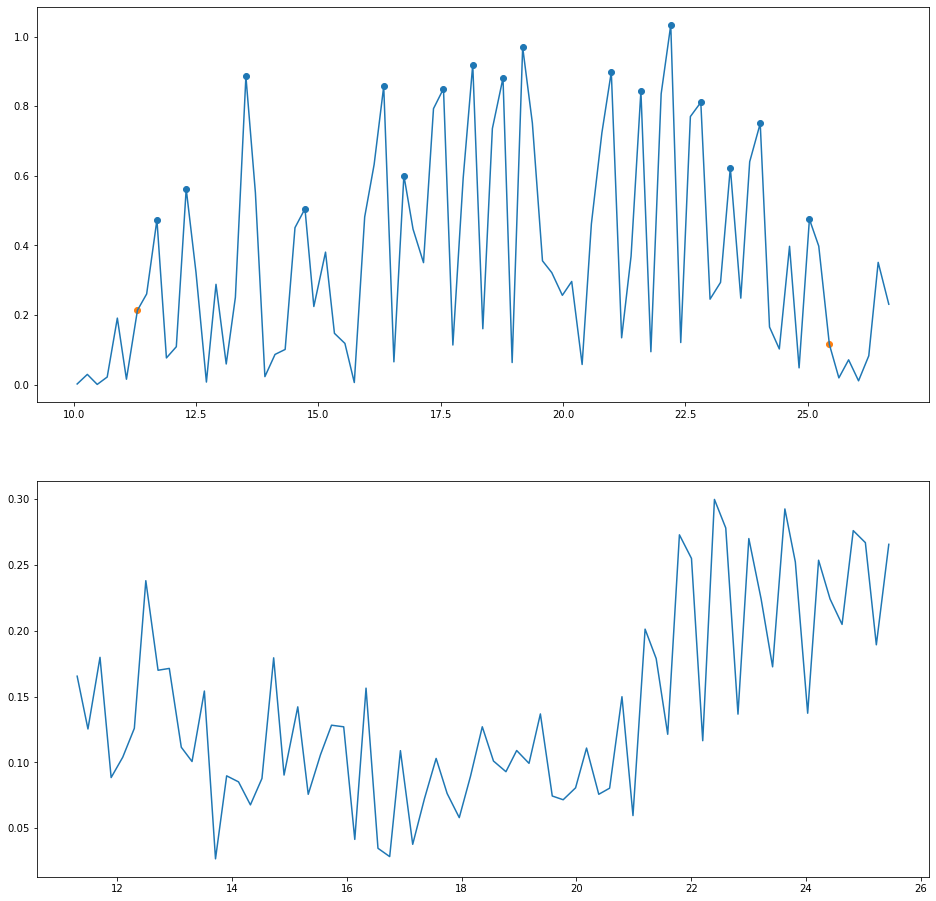

('20', 10, 'Female', 83, 59, False, 14.1385, 17, 0.8337, 8.3485, 0.1415, 2.0061, -103.9575)
('20', 10, 'Female', 83, 59, False, 14.1385, 17, 0.8337, 8.3485, 0.1415, 2.0061, -103.9575, 0.6248)
('20', 10, 'Female', 83, 59, False, 14.1385, 17, 0.8337, 8.3485, 0.1415, 2.0061, -103.9575, 0.6248, -0.0308, 0.2267, 0.404, 8, 104, 'Arterial Hypertension')
('20', 10, 'Female', 83, 59, False, 14.1385, 17, 0.8337, 8.3485, 0.1415, 2.0061, -103.9575, 0.6248, -0.0308, 0.2267, 0.404, 8, 128, 'Insanity')
('20', 10, 'Female', 83, 59, False, 14.1385, 17, 0.8337, 8.3485, 0.1415, 2.0061, -103.9575, 0.6248, -0.0308, 0.2267, 0.404, 8, 106, 'Dyslipidemia')
('20', 10, 'Female', 83, 59, False, 14.1385, 17, 0.8337, 8.3485, 0.1415, 2.0061, -103.9575, 0.6248, -0.0308, 0.2267, 0.404, 8, 155, 'Moderate Mitral Insufficiency')
('20', 10, 'Female', 83, 59, False, 14.1385, 17, 0.8337, 8.3485, 0.1415, 2.0061, -103.9575, 0.6248, -0.0308, 0.2267, 0.404, 8, 156, 'Intestinal Bands;')


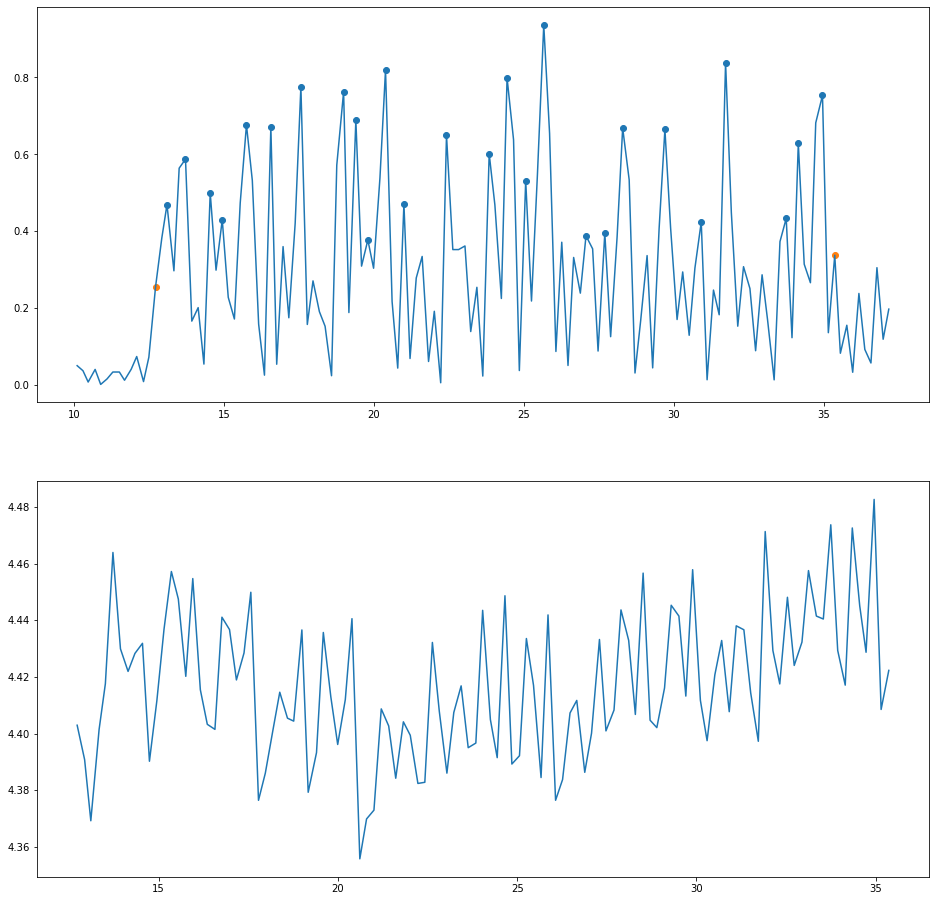

('21', 11, 'Male', 88, 63, True, 22.6385, 26, 0.8744, 278.3151, 4.4177, 100.9786, -62.9806)
('21', 11, 'Male', 88, 63, True, 22.6385, 26, 0.8744, 278.3151, 4.4177, 100.9786, -62.9806, 3.0914)
('21', 11, 'Male', 88, 63, True, 22.6385, 26, 0.8744, 278.3151, 4.4177, 100.9786, -62.9806, 3.0914, -0.0326, 0.0192, -0.0525, 8, 136, 'Stroke')
('21', 11, 'Male', 88, 63, True, 22.6385, 26, 0.8744, 278.3151, 4.4177, 100.9786, -62.9806, 3.0914, -0.0326, 0.0192, -0.0525, 8, 157, 'Asteoricospic Plaque In The Right Carotid Bulb')
('21', 11, 'Male', 88, 63, True, 22.6385, 26, 0.8744, 278.3151, 4.4177, 100.9786, -62.9806, 3.0914, -0.0326, 0.0192, -0.0525, 8, 106, 'Dyslipidemia')
('21', 11, 'Male', 88, 63, True, 22.6385, 26, 0.8744, 278.3151, 4.4177, 100.9786, -62.9806, 3.0914, -0.0326, 0.0192, -0.0525, 8, 104, 'Arterial Hypertension')
('21', 11, 'Male', 88, 63, True, 22.6385, 26, 0.8744, 278.3151, 4.4177, 100.9786, -62.9806, 3.0914, -0.0326, 0.0192, -0.0525, 8, 103, 'Diabetes')
('21', 11, 'Male', 88, 63

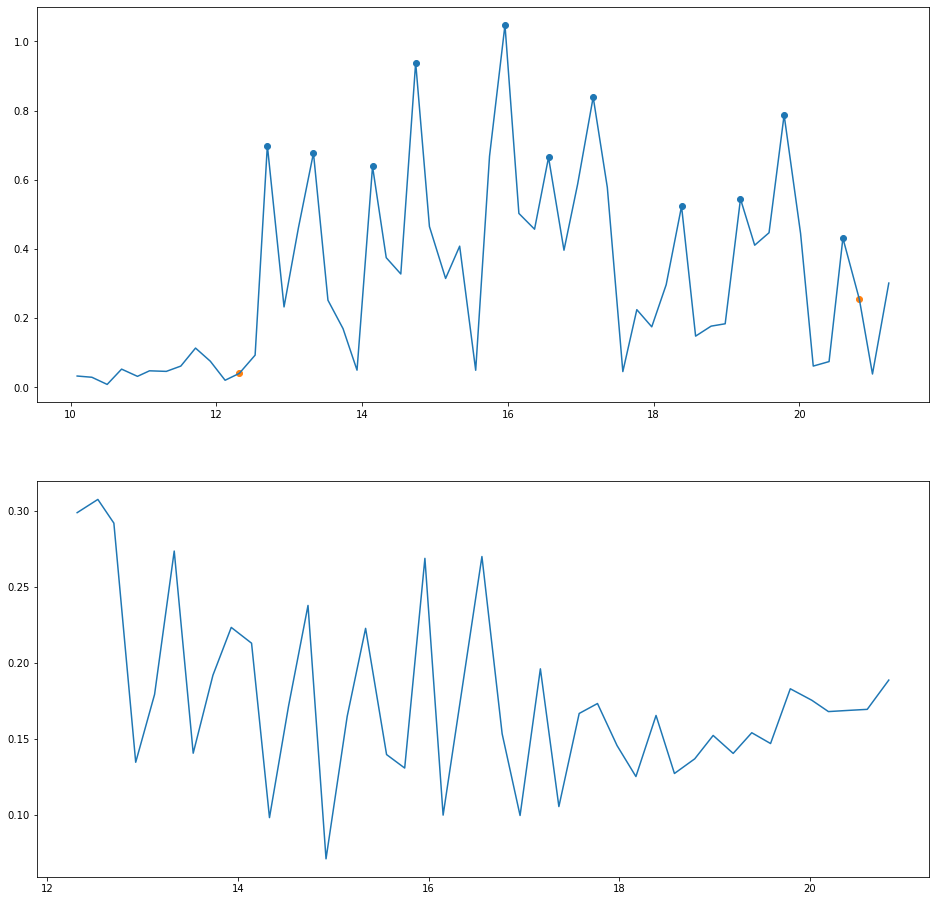

('22', 11, 'Male', 88, 63, True, 8.5125, 11, 0.7906, 11.1132, 0.1764, 1.5482, -72.1597)
('22', 11, 'Male', 88, 63, True, 8.5125, 11, 0.7906, 11.1132, 0.1764, 1.5482, -72.1597, 0.3566)
('22', 11, 'Male', 88, 63, True, 8.5125, 11, 0.7906, 11.1132, 0.1764, 1.5482, -72.1597, 0.3566, -0.0717, 0.0809, 0.1414, 8, 136, 'Stroke')
('22', 11, 'Male', 88, 63, True, 8.5125, 11, 0.7906, 11.1132, 0.1764, 1.5482, -72.1597, 0.3566, -0.0717, 0.0809, 0.1414, 8, 157, 'Asteoricospic Plaque In The Right Carotid Bulb')
('22', 11, 'Male', 88, 63, True, 8.5125, 11, 0.7906, 11.1132, 0.1764, 1.5482, -72.1597, 0.3566, -0.0717, 0.0809, 0.1414, 8, 106, 'Dyslipidemia')
('22', 11, 'Male', 88, 63, True, 8.5125, 11, 0.7906, 11.1132, 0.1764, 1.5482, -72.1597, 0.3566, -0.0717, 0.0809, 0.1414, 8, 104, 'Arterial Hypertension')
('22', 11, 'Male', 88, 63, True, 8.5125, 11, 0.7906, 11.1132, 0.1764, 1.5482, -72.1597, 0.3566, -0.0717, 0.0809, 0.1414, 8, 103, 'Diabetes')
('22', 11, 'Male', 88, 63, True, 8.5125, 11, 0.7906, 11.11

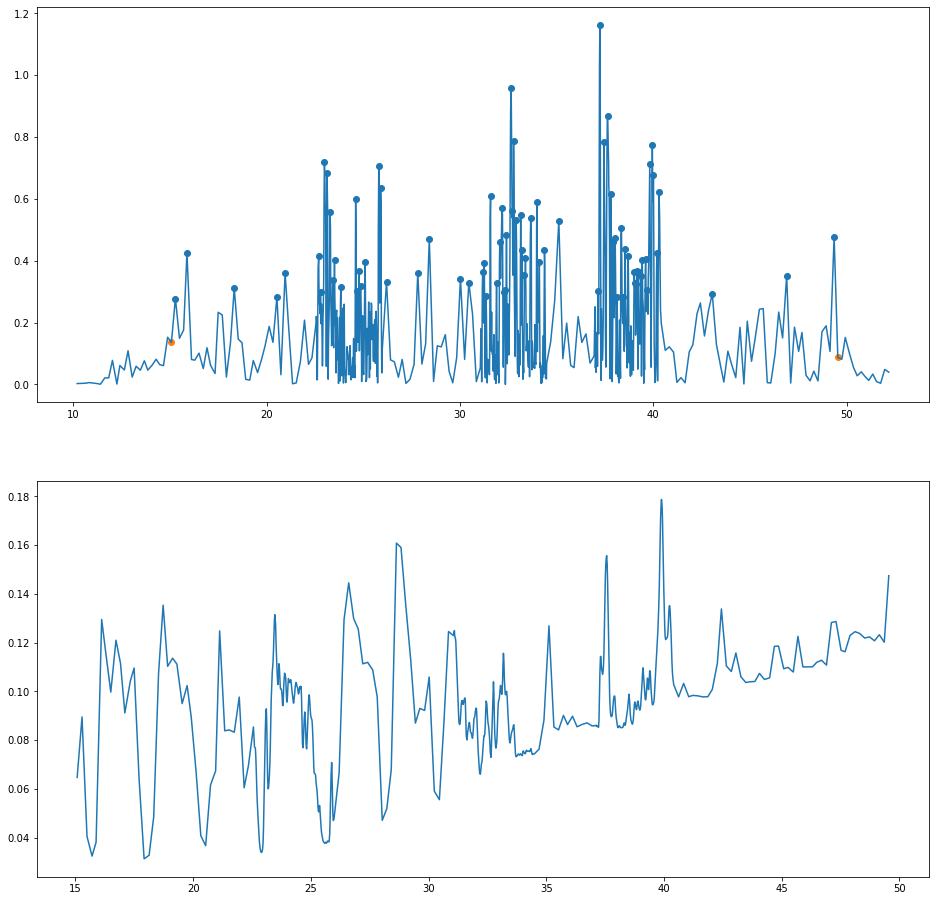

('23', 12, 'Female', 88, 79, True, 34.4805, 77, 0.4489, 7.2838, 0.0922, 3.3154, -92.4532)
('23', 12, 'Female', 88, 79, True, 34.4805, 77, 0.4489, 7.2838, 0.0922, 3.3154, -92.4532, 0.7797)
('23', 12, 'Female', 88, 79, True, 34.4805, 77, 0.4489, 7.2838, 0.0922, 3.3154, -92.4532, 0.7797, -0.0464, 0.0597, -0.0405, 9, 103, 'Diabetes')
('23', 12, 'Female', 88, 79, True, 34.4805, 77, 0.4489, 7.2838, 0.0922, 3.3154, -92.4532, 0.7797, -0.0464, 0.0597, -0.0405, 9, 153, 'Pulmonary Edema')
('23', 12, 'Female', 88, 79, True, 34.4805, 77, 0.4489, 7.2838, 0.0922, 3.3154, -92.4532, 0.7797, -0.0464, 0.0597, -0.0405, 9, 104, 'Arterial Hypertension')
('23', 12, 'Female', 88, 79, True, 34.4805, 77, 0.4489, 7.2838, 0.0922, 3.3154, -92.4532, 0.7797, -0.0464, 0.0597, -0.0405, 9, 106, 'Dyslipidemia')
('23', 12, 'Female', 88, 79, True, 34.4805, 77, 0.4489, 7.2838, 0.0922, 3.3154, -92.4532, 0.7797, -0.0464, 0.0597, -0.0405, 9, 161, 'Dacryocystorhinostomy')
('23', 12, 'Female', 88, 79, True, 34.4805, 77, 0.4489,

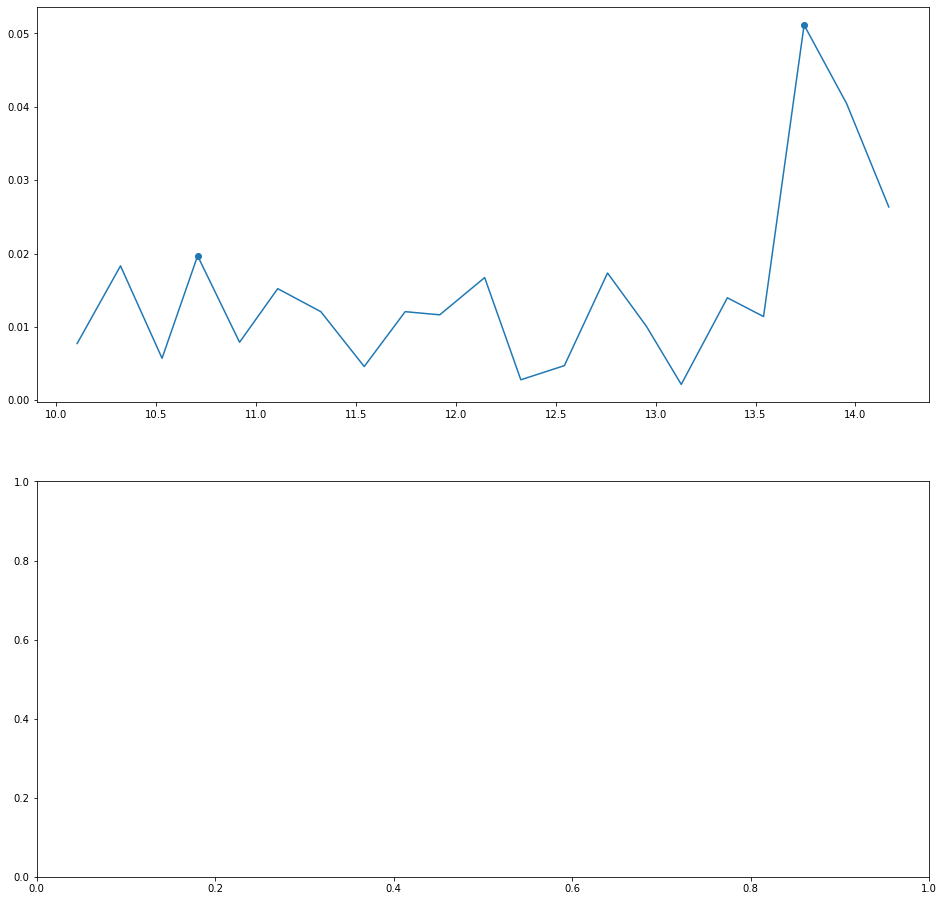

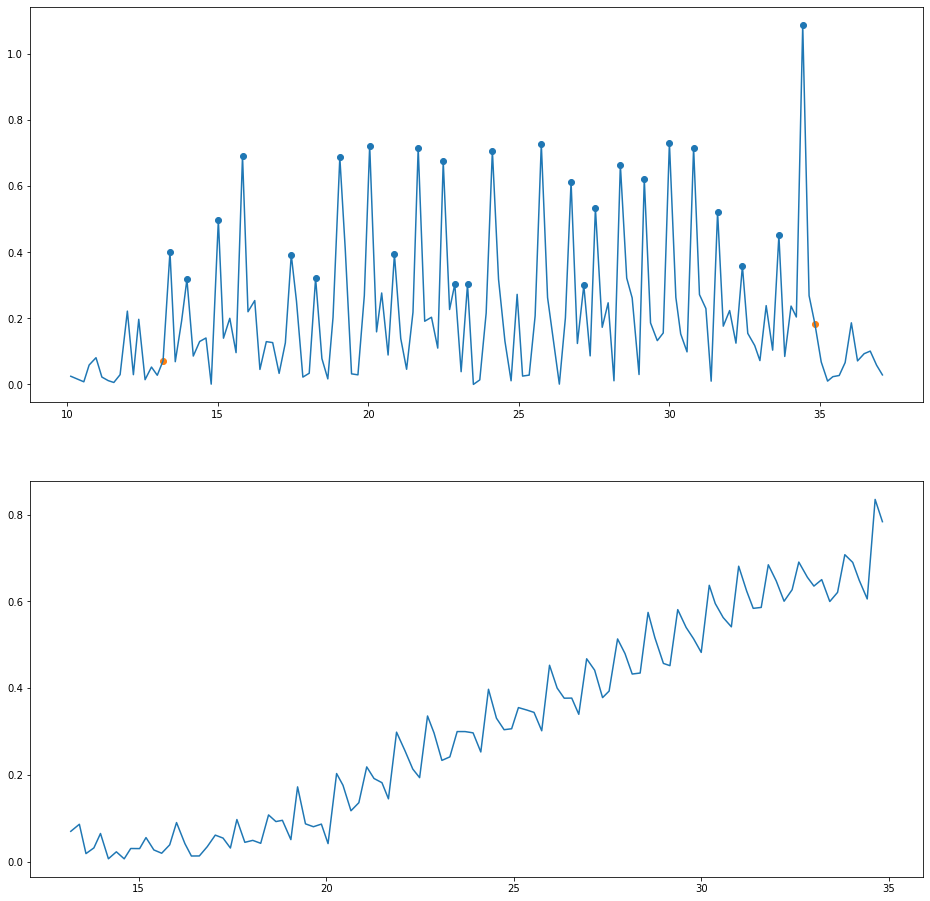

('25', 13, 'Female', 83, 58, True, 21.6365, 26, 0.8406, 18.4266, 0.3177, 6.7722, 6.5313)
('25', 13, 'Female', 83, 58, True, 21.6365, 26, 0.8406, 18.4266, 0.3177, 6.7722, 6.5313, 1.2572)
('25', 13, 'Female', 83, 58, True, 21.6365, 26, 0.8406, 18.4266, 0.3177, 6.7722, 6.5313, 1.2572, -0.0869, 0.0086, -0.5809, 9, 104, 'Arterial Hypertension')
('25', 13, 'Female', 83, 58, True, 21.6365, 26, 0.8406, 18.4266, 0.3177, 6.7722, 6.5313, 1.2572, -0.0869, 0.0086, -0.5809, 9, 166, 'Tension Headaches')
('25', 13, 'Female', 83, 58, True, 21.6365, 26, 0.8406, 18.4266, 0.3177, 6.7722, 6.5313, 1.2572, -0.0869, 0.0086, -0.5809, 9, 103, 'Diabetes')
('25', 13, 'Female', 83, 58, True, 21.6365, 26, 0.8406, 18.4266, 0.3177, 6.7722, 6.5313, 1.2572, -0.0869, 0.0086, -0.5809, 9, 167, 'Asthmatic Bronchitis')
('25', 13, 'Female', 83, 58, True, 21.6365, 26, 0.8406, 18.4266, 0.3177, 6.7722, 6.5313, 1.2572, -0.0869, 0.0086, -0.5809, 9, 168, 'Thyroid Nodules')
('25', 13, 'Female', 83, 58, True, 21.6365, 26, 0.8406, 18

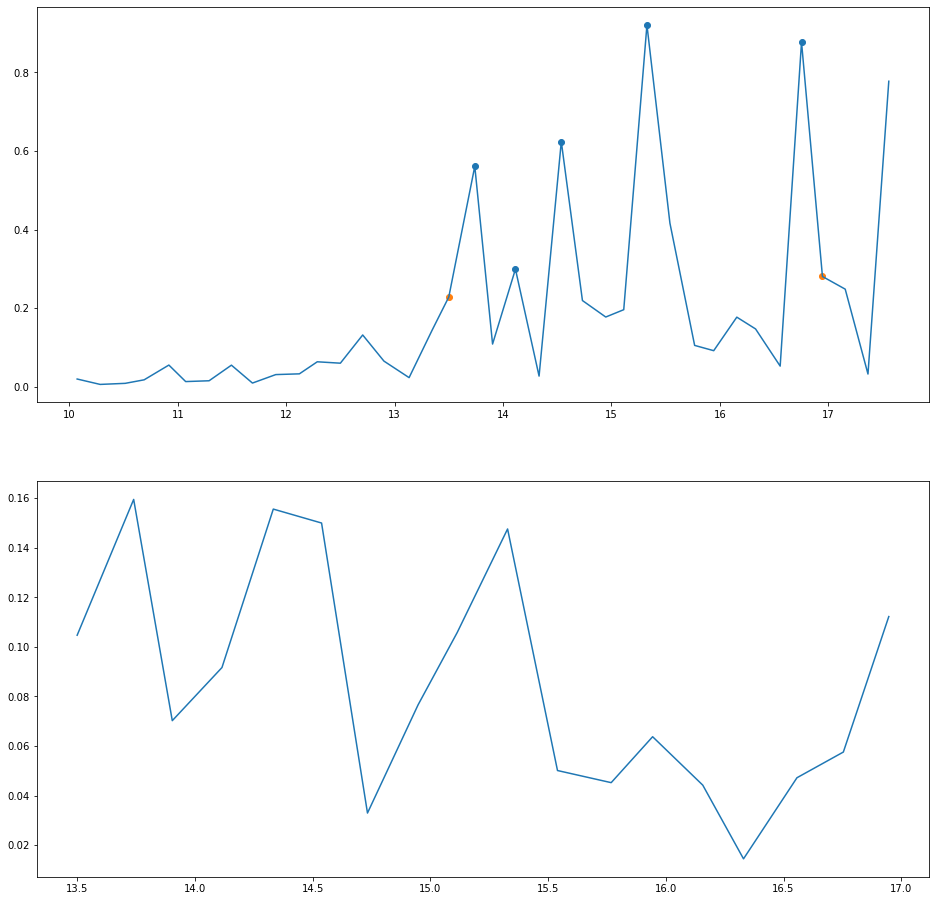

('26', 13, 'Female', 83, 58, True, 3.4475, 5, 0.754, 4.9590000000000005, 0.0855, 0.2985, -19.0525)
('26', 13, 'Female', 83, 58, True, 3.4475, 5, 0.754, 4.9590000000000005, 0.0855, 0.2985, -19.0525, 1.2344)
('26', 13, 'Female', 83, 58, True, 3.4475, 5, 0.754, 4.9590000000000005, 0.0855, 0.2985, -19.0525, 1.2344, 0.0267, 0.0146, 0.0536, 9, 104, 'Arterial Hypertension')
('26', 13, 'Female', 83, 58, True, 3.4475, 5, 0.754, 4.9590000000000005, 0.0855, 0.2985, -19.0525, 1.2344, 0.0267, 0.0146, 0.0536, 9, 166, 'Tension Headaches')
('26', 13, 'Female', 83, 58, True, 3.4475, 5, 0.754, 4.9590000000000005, 0.0855, 0.2985, -19.0525, 1.2344, 0.0267, 0.0146, 0.0536, 9, 103, 'Diabetes')
('26', 13, 'Female', 83, 58, True, 3.4475, 5, 0.754, 4.9590000000000005, 0.0855, 0.2985, -19.0525, 1.2344, 0.0267, 0.0146, 0.0536, 9, 167, 'Asthmatic Bronchitis')
('26', 13, 'Female', 83, 58, True, 3.4475, 5, 0.754, 4.9590000000000005, 0.0855, 0.2985, -19.0525, 1.2344, 0.0267, 0.0146, 0.0536, 9, 168, 'Thyroid Nodules'

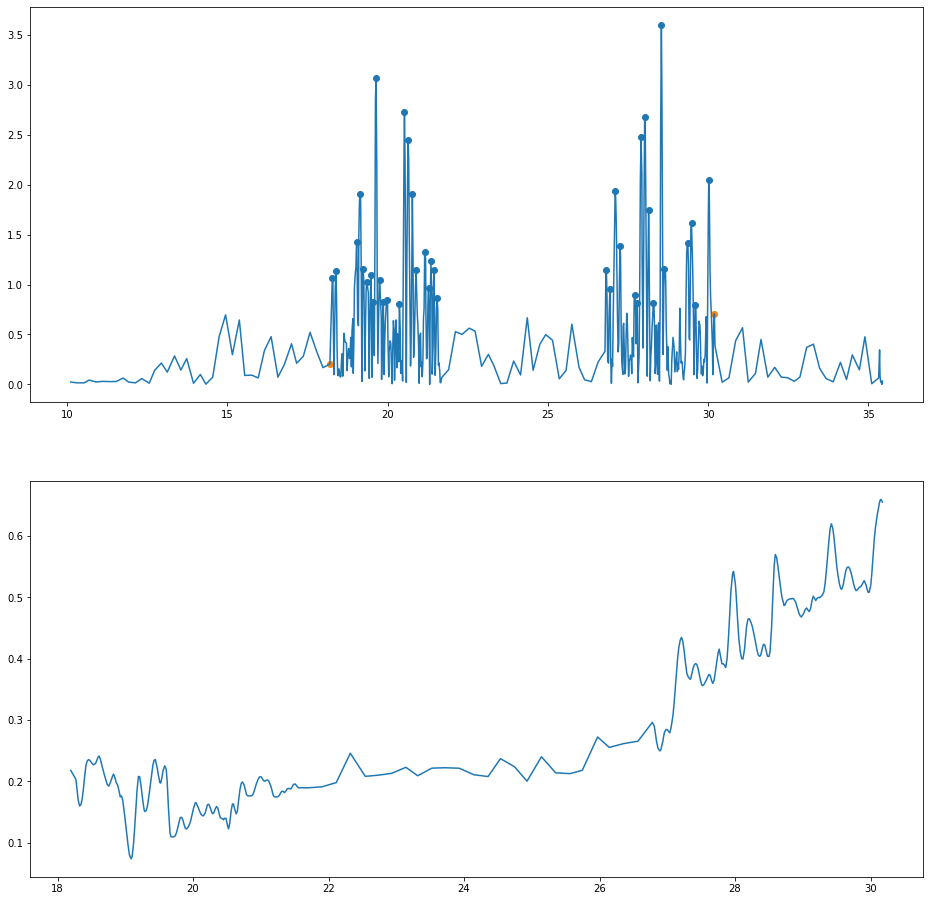

('27', 14, 'Female', 83, 77, True, 11.9805, 38, 0.318, 23.777600000000003, 0.3088, 3.3293, 448.6641)
('27', 14, 'Female', 83, 77, True, 11.9805, 38, 0.318, 23.777600000000003, 0.3088, 3.3293, 448.6641, 0.0974)
('27', 14, 'Female', 83, 77, True, 11.9805, 38, 0.318, 23.777600000000003, 0.3088, 3.3293, 448.6641, 0.0974, -0.066, 0.027, -0.1751, 9, 176, 'Atrial Fibrillation')
('27', 14, 'Female', 83, 77, True, 11.9805, 38, 0.318, 23.777600000000003, 0.3088, 3.3293, 448.6641, 0.0974, -0.066, 0.027, -0.1751, 9, 177, 'Hypertensive Congestive Heart Failure')
('27', 14, 'Female', 83, 77, True, 11.9805, 38, 0.318, 23.777600000000003, 0.3088, 3.3293, 448.6641, 0.0974, -0.066, 0.027, -0.1751, 9, 104, 'Arterial Hypertension')
('27', 14, 'Female', 83, 77, True, 11.9805, 38, 0.318, 23.777600000000003, 0.3088, 3.3293, 448.6641, 0.0974, -0.066, 0.027, -0.1751, 9, 106, 'Dyslipidemia')
('27', 14, 'Female', 83, 77, True, 11.9805, 38, 0.318, 23.777600000000003, 0.3088, 3.3293, 448.6641, 0.0974, -0.066, 0.02

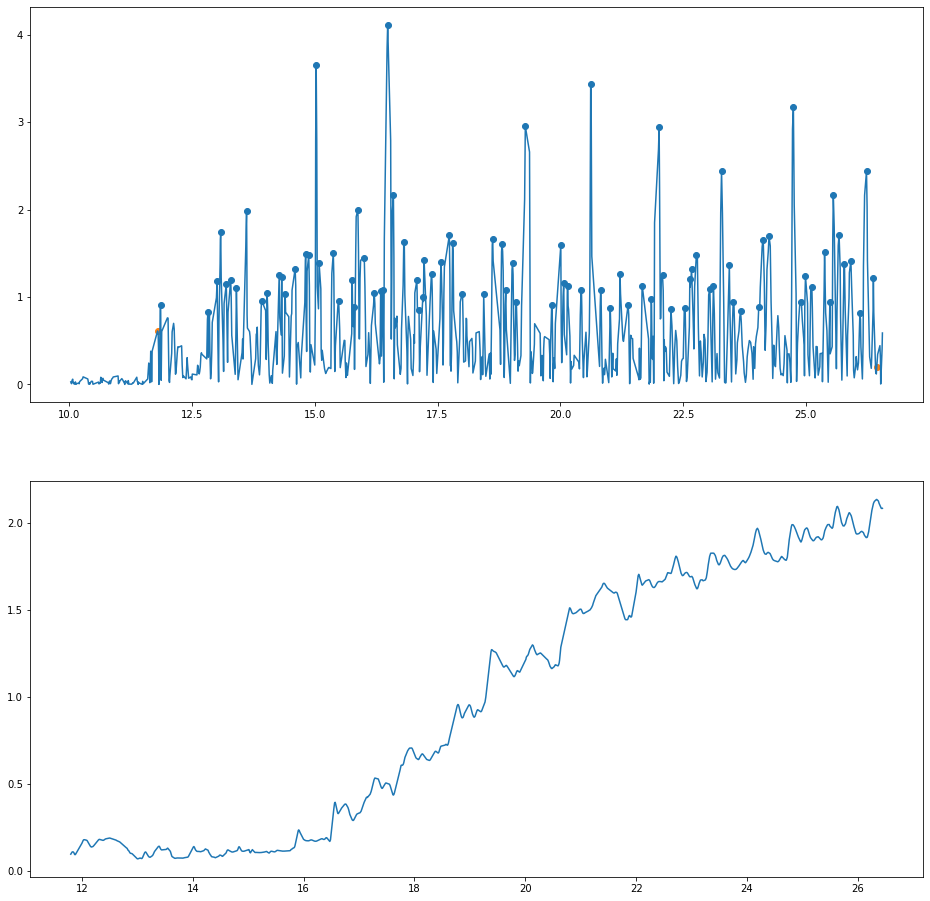

('28', 14, 'Female', 83, 77, True, 14.6465, 87, 0.1693, 74.6438, 0.9694, 14.1266, 5195.691)
('28', 14, 'Female', 83, 77, True, 14.6465, 87, 0.1693, 74.6438, 0.9694, 14.1266, 5195.691, 2.4695)
('28', 14, 'Female', 83, 77, True, 14.6465, 87, 0.1693, 74.6438, 0.9694, 14.1266, 5195.691, 2.4695, 0.0895, 0.107, 0.1254, 9, 176, 'Atrial Fibrillation')
('28', 14, 'Female', 83, 77, True, 14.6465, 87, 0.1693, 74.6438, 0.9694, 14.1266, 5195.691, 2.4695, 0.0895, 0.107, 0.1254, 9, 177, 'Hypertensive Congestive Heart Failure')
('28', 14, 'Female', 83, 77, True, 14.6465, 87, 0.1693, 74.6438, 0.9694, 14.1266, 5195.691, 2.4695, 0.0895, 0.107, 0.1254, 9, 104, 'Arterial Hypertension')
('28', 14, 'Female', 83, 77, True, 14.6465, 87, 0.1693, 74.6438, 0.9694, 14.1266, 5195.691, 2.4695, 0.0895, 0.107, 0.1254, 9, 106, 'Dyslipidemia')
('28', 14, 'Female', 83, 77, True, 14.6465, 87, 0.1693, 74.6438, 0.9694, 14.1266, 5195.691, 2.4695, 0.0895, 0.107, 0.1254, 9, 178, 'Asthma')
('28', 14, 'Female', 83, 77, True, 14.

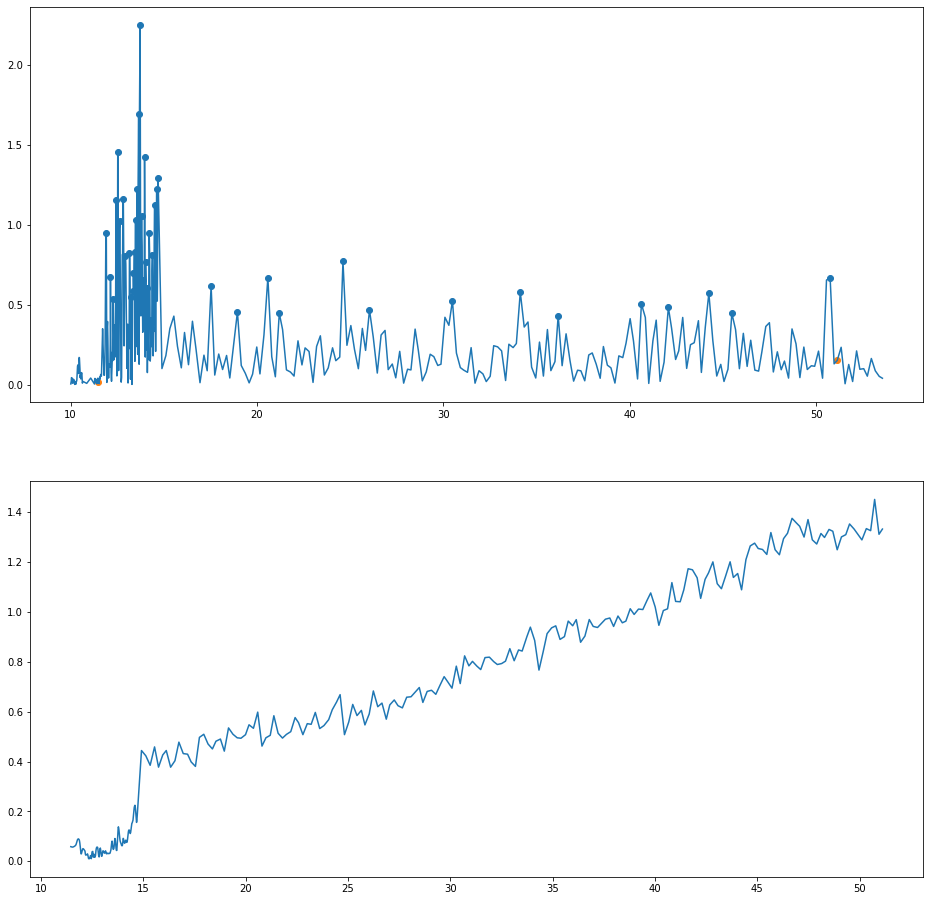

('29', 15, 'Male', 88, 71, True, 39.6715, 41, 0.9709, 33.4623, 0.4713, 30.9694, 237.2399)
('29', 15, 'Male', 88, 71, True, 39.6715, 41, 0.9709, 33.4623, 0.4713, 30.9694, 237.2399, 0.1719)
('29', 15, 'Male', 88, 71, True, 39.6715, 41, 0.9709, 33.4623, 0.4713, 30.9694, 237.2399, 0.1719, -0.0141, 0.0167, -0.0199, 10, 176, 'Atrial Fibrillation')
('29', 15, 'Male', 88, 71, True, 39.6715, 41, 0.9709, 33.4623, 0.4713, 30.9694, 237.2399, 0.1719, -0.0141, 0.0167, -0.0199, 10, 183, 'Bifascicular Block')
('29', 15, 'Male', 88, 71, True, 39.6715, 41, 0.9709, 33.4623, 0.4713, 30.9694, 237.2399, 0.1719, -0.0141, 0.0167, -0.0199, 10, 137, 'Chronic Obstructive Pulmonary Disease')
('29', 15, 'Male', 88, 71, True, 39.6715, 41, 0.9709, 33.4623, 0.4713, 30.9694, 237.2399, 0.1719, -0.0141, 0.0167, -0.0199, 10, 128, 'Insanity')
('29', 15, 'Male', 88, 71, True, 39.6715, 41, 0.9709, 33.4623, 0.4713, 30.9694, 237.2399, 0.1719, -0.0141, 0.0167, -0.0199, 10, 184, 'Distal Radio')
('29', 15, 'Male', 88, 71, True, 

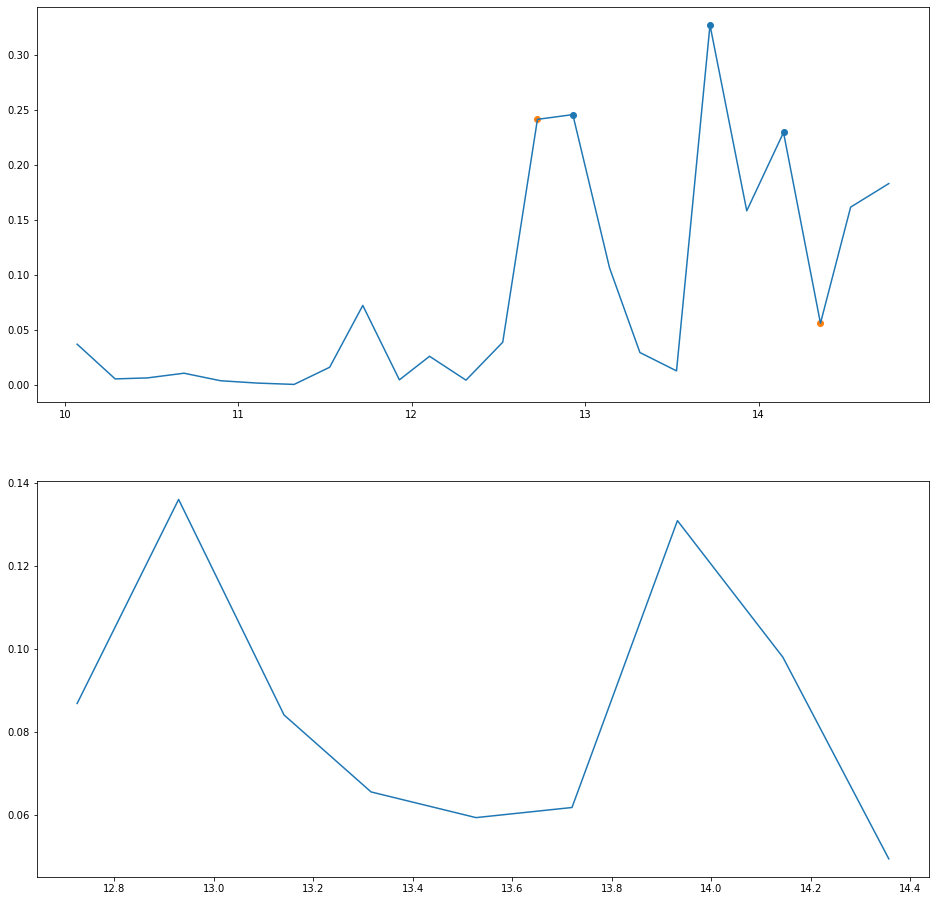

('30', 15, 'Male', 88, 71, True, 1.6325, 3, 0.608, 6.1273, 0.0863, 0.1677, -3.3791)
('30', 15, 'Male', 88, 71, True, 1.6325, 3, 0.608, 6.1273, 0.0863, 0.1677, -3.3791, 0.0494)
('30', 15, 'Male', 88, 71, True, 1.6325, 3, 0.608, 6.1273, 0.0863, 0.1677, -3.3791, 0.0494, 0.005, 0.013, -0.0024, 10, 176, 'Atrial Fibrillation')
('30', 15, 'Male', 88, 71, True, 1.6325, 3, 0.608, 6.1273, 0.0863, 0.1677, -3.3791, 0.0494, 0.005, 0.013, -0.0024, 10, 183, 'Bifascicular Block')
('30', 15, 'Male', 88, 71, True, 1.6325, 3, 0.608, 6.1273, 0.0863, 0.1677, -3.3791, 0.0494, 0.005, 0.013, -0.0024, 10, 137, 'Chronic Obstructive Pulmonary Disease')
('30', 15, 'Male', 88, 71, True, 1.6325, 3, 0.608, 6.1273, 0.0863, 0.1677, -3.3791, 0.0494, 0.005, 0.013, -0.0024, 10, 128, 'Insanity')
('30', 15, 'Male', 88, 71, True, 1.6325, 3, 0.608, 6.1273, 0.0863, 0.1677, -3.3791, 0.0494, 0.005, 0.013, -0.0024, 10, 184, 'Distal Radio')
('30', 15, 'Male', 88, 71, True, 1.6325, 3, 0.608, 6.1273, 0.0863, 0.1677, -3.3791, 0.0494

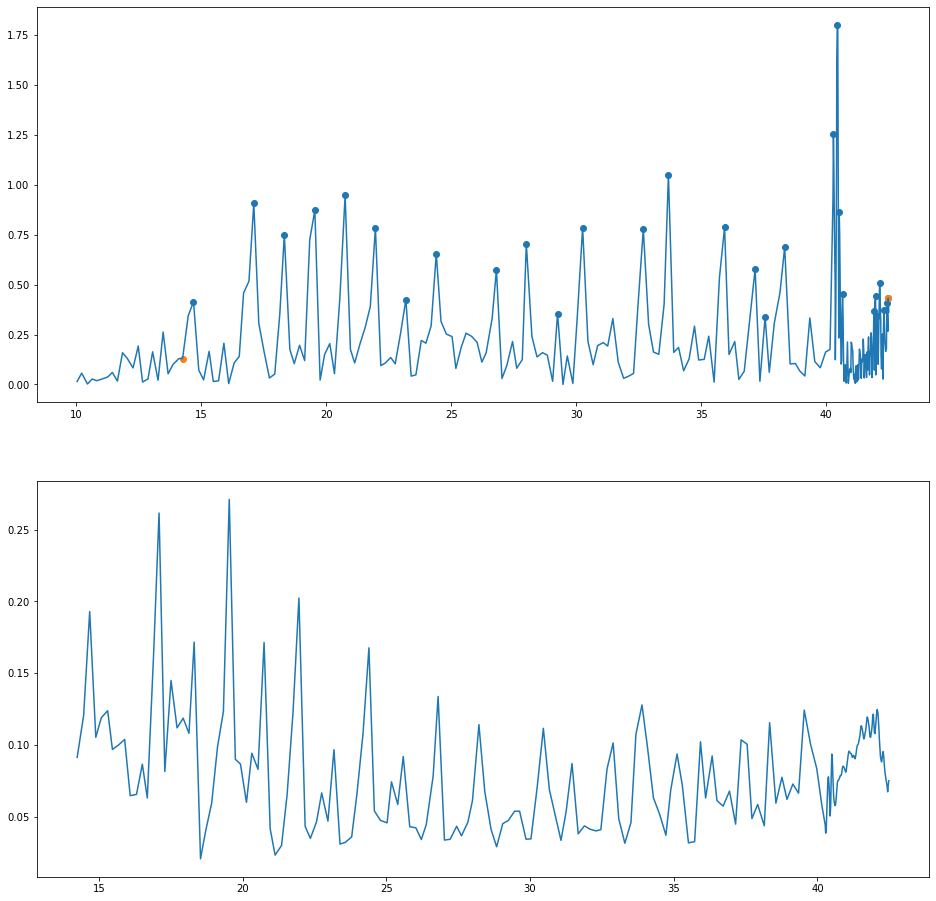

('31', 16, 'Female', 87, 72, True, 28.2325, 29, 0.9932, 6.048, 0.084, 2.2291, -115.2643)
('31', 16, 'Female', 87, 72, True, 28.2325, 29, 0.9932, 6.048, 0.084, 2.2291, -115.2643, 0.2936)
('31', 16, 'Female', 87, 72, True, 28.2325, 29, 0.9932, 6.048, 0.084, 2.2291, -115.2643, 0.2936, -0.0358, 0.0242, -0.0822, 10, 142, 'Heart Failure')
('31', 16, 'Female', 87, 72, True, 28.2325, 29, 0.9932, 6.048, 0.084, 2.2291, -115.2643, 0.2936, -0.0358, 0.0242, -0.0822, 10, 187, ' Atrial Fibrillation')
('31', 16, 'Female', 87, 72, True, 28.2325, 29, 0.9932, 6.048, 0.084, 2.2291, -115.2643, 0.2936, -0.0358, 0.0242, -0.0822, 10, 104, 'Arterial Hypertension')
('31', 16, 'Female', 87, 72, True, 28.2325, 29, 0.9932, 6.048, 0.084, 2.2291, -115.2643, 0.2936, -0.0358, 0.0242, -0.0822, 10, 188, 'Colonic Neoplasm')
('31', 16, 'Female', 87, 72, True, 28.2325, 29, 0.9932, 6.048, 0.084, 2.2291, -115.2643, 0.2936, -0.0358, 0.0242, -0.0822, 10, 189, 'Melanoma')
('31', 16, 'Female', 87, 72, True, 28.2325, 29, 0.9932, 

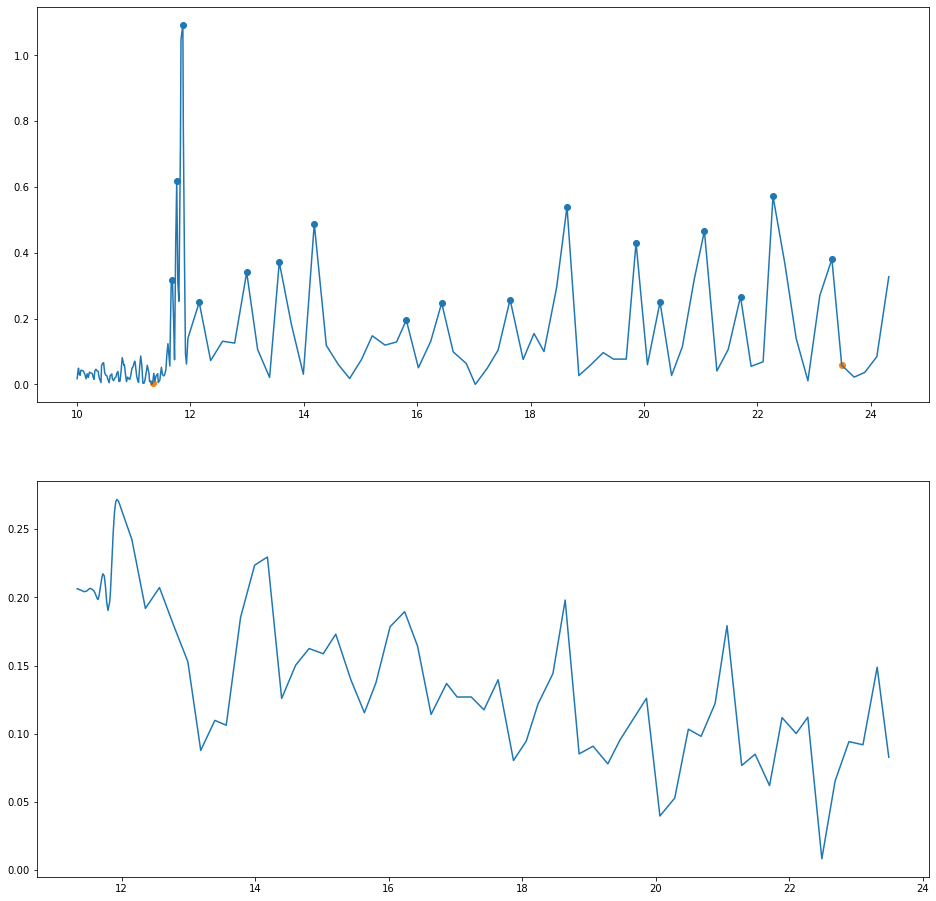

('32', 16, 'Female', 87, 72, True, 12.1565, 17, 0.7276, 11.4984, 0.1597, 1.6422, 26.7269)
('32', 16, 'Female', 87, 72, True, 12.1565, 17, 0.7276, 11.4984, 0.1597, 1.6422, 26.7269, 0.2321)
('32', 16, 'Female', 87, 72, True, 12.1565, 17, 0.7276, 11.4984, 0.1597, 1.6422, 26.7269, 0.2321, 0.0898, 0.022, 0.24, 10, 142, 'Heart Failure')
('32', 16, 'Female', 87, 72, True, 12.1565, 17, 0.7276, 11.4984, 0.1597, 1.6422, 26.7269, 0.2321, 0.0898, 0.022, 0.24, 10, 187, ' Atrial Fibrillation')
('32', 16, 'Female', 87, 72, True, 12.1565, 17, 0.7276, 11.4984, 0.1597, 1.6422, 26.7269, 0.2321, 0.0898, 0.022, 0.24, 10, 104, 'Arterial Hypertension')
('32', 16, 'Female', 87, 72, True, 12.1565, 17, 0.7276, 11.4984, 0.1597, 1.6422, 26.7269, 0.2321, 0.0898, 0.022, 0.24, 10, 188, 'Colonic Neoplasm')
('32', 16, 'Female', 87, 72, True, 12.1565, 17, 0.7276, 11.4984, 0.1597, 1.6422, 26.7269, 0.2321, 0.0898, 0.022, 0.24, 10, 189, 'Melanoma')
('32', 16, 'Female', 87, 72, True, 12.1565, 17, 0.7276, 11.4984, 0.1597, 1

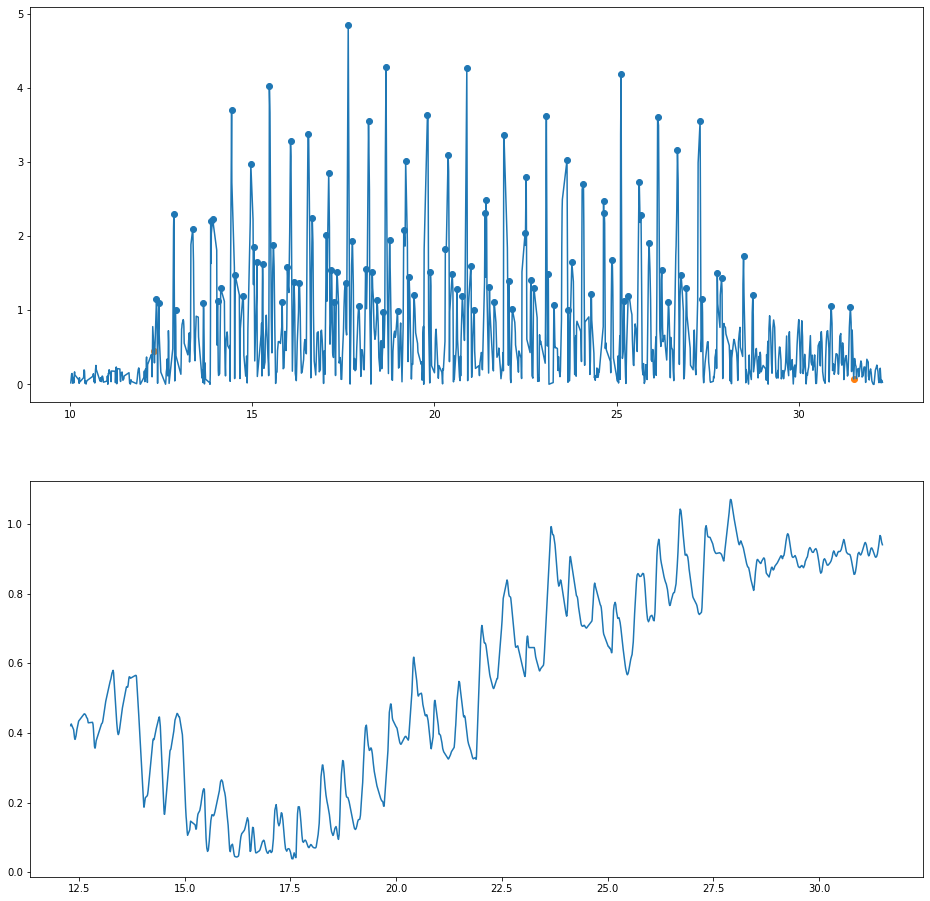

('33', 17, 'Female', 77, 62, True, 19.1915, 99, 0.1947, 34.441, 0.5555, 10.6059, 1078.0937)
('33', 17, 'Female', 77, 62, True, 19.1915, 99, 0.1947, 34.441, 0.5555, 10.6059, 1078.0937, 0.2556)
('33', 17, 'Female', 77, 62, True, 19.1915, 99, 0.1947, 34.441, 0.5555, 10.6059, 1078.0937, 0.2556, -0.0681, -0.0013, -0.1874, 9, 191, 'Stuttering')
('33', 17, 'Female', 77, 62, True, 19.1915, 99, 0.1947, 34.441, 0.5555, 10.6059, 1078.0937, 0.2556, -0.0681, -0.0013, -0.1874, 9, 192, 'Tremor')
('33', 17, 'Female', 77, 62, True, 19.1915, 99, 0.1947, 34.441, 0.5555, 10.6059, 1078.0937, 0.2556, -0.0681, -0.0013, -0.1874, 9, 193, 'Hiatus Hernia')
('33', 17, 'Female', 77, 62, True, 19.1915, 99, 0.1947, 34.441, 0.5555, 10.6059, 1078.0937, 0.2556, -0.0681, -0.0013, -0.1874, 9, 194, "Barrett'S Esophagus")
('33', 17, 'Female', 77, 62, True, 19.1915, 99, 0.1947, 34.441, 0.5555, 10.6059, 1078.0937, 0.2556, -0.0681, -0.0013, -0.1874, 9, 135, 'Bilateral Gonarthrosis')


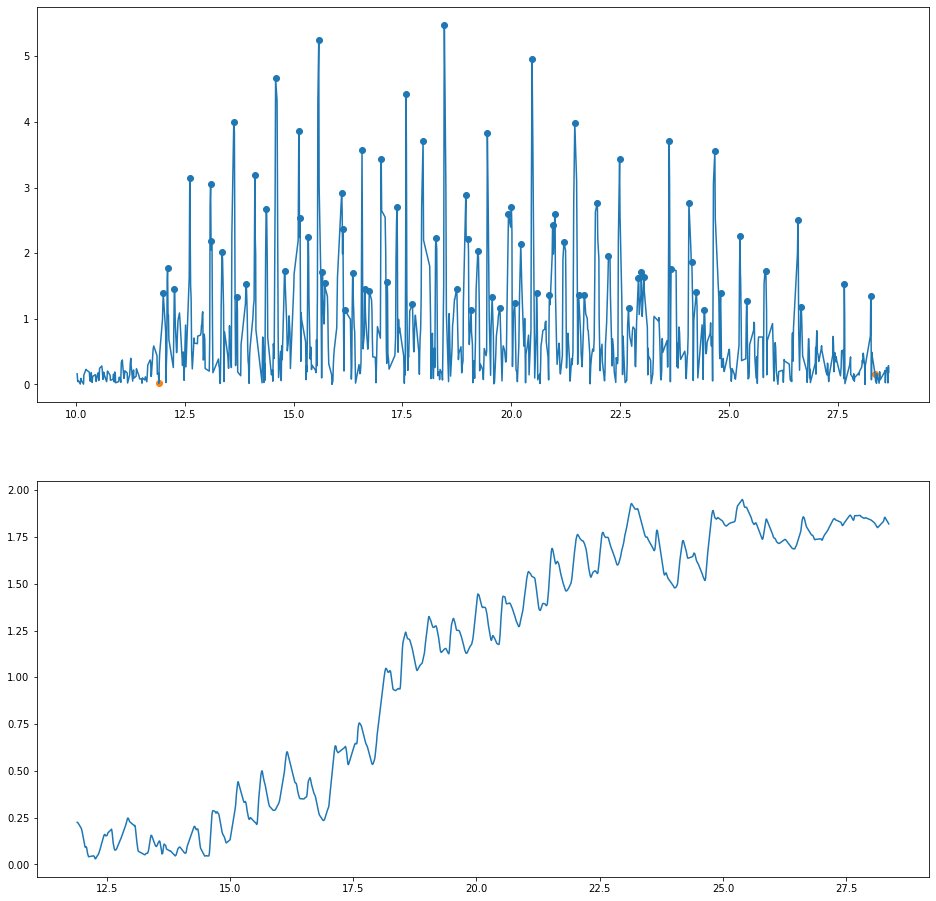

('34', 17, 'Female', 77, 62, True, 16.4595, 78, 0.2117, 67.6606, 1.0913, 17.9429, 4505.1871)
('34', 17, 'Female', 77, 62, True, 16.4595, 78, 0.2117, 67.6606, 1.0913, 17.9429, 4505.1871, 2.1062)
('34', 17, 'Female', 77, 62, True, 16.4595, 78, 0.2117, 67.6606, 1.0913, 17.9429, 4505.1871, 2.1062, 0.0759, 0.2109, 0.1393, 9, 191, 'Stuttering')
('34', 17, 'Female', 77, 62, True, 16.4595, 78, 0.2117, 67.6606, 1.0913, 17.9429, 4505.1871, 2.1062, 0.0759, 0.2109, 0.1393, 9, 192, 'Tremor')
('34', 17, 'Female', 77, 62, True, 16.4595, 78, 0.2117, 67.6606, 1.0913, 17.9429, 4505.1871, 2.1062, 0.0759, 0.2109, 0.1393, 9, 193, 'Hiatus Hernia')
('34', 17, 'Female', 77, 62, True, 16.4595, 78, 0.2117, 67.6606, 1.0913, 17.9429, 4505.1871, 2.1062, 0.0759, 0.2109, 0.1393, 9, 194, "Barrett'S Esophagus")
('34', 17, 'Female', 77, 62, True, 16.4595, 78, 0.2117, 67.6606, 1.0913, 17.9429, 4505.1871, 2.1062, 0.0759, 0.2109, 0.1393, 9, 135, 'Bilateral Gonarthrosis')


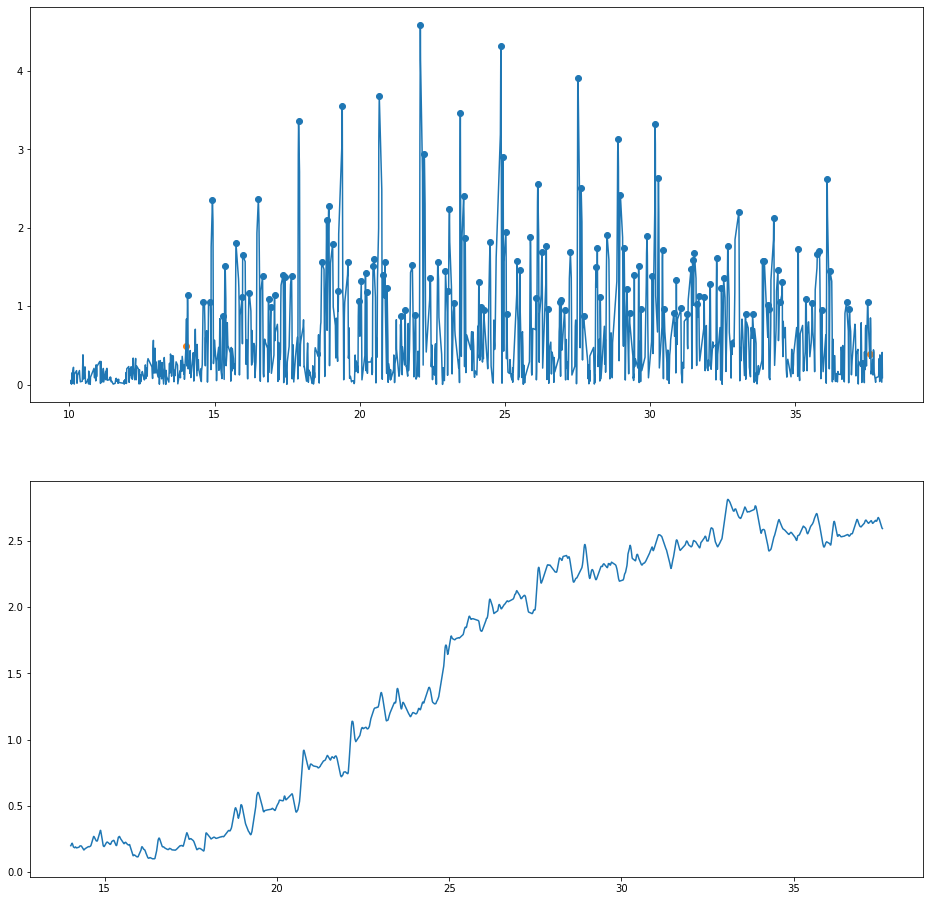

('35', 18, 'Female', 86, 90, True, 23.5615, 129, 0.1835, 139.78799999999998, 1.5532, 36.4874, 13904.8475)
('35', 18, 'Female', 86, 90, True, 23.5615, 129, 0.1835, 139.78799999999998, 1.5532, 36.4874, 13904.8475, 0.3953)
('35', 18, 'Female', 86, 90, True, 23.5615, 129, 0.1835, 139.78799999999998, 1.5532, 36.4874, 13904.8475, 0.3953, 0.3926, -0.0336, -0.1649, 8, 128, 'Insanity')


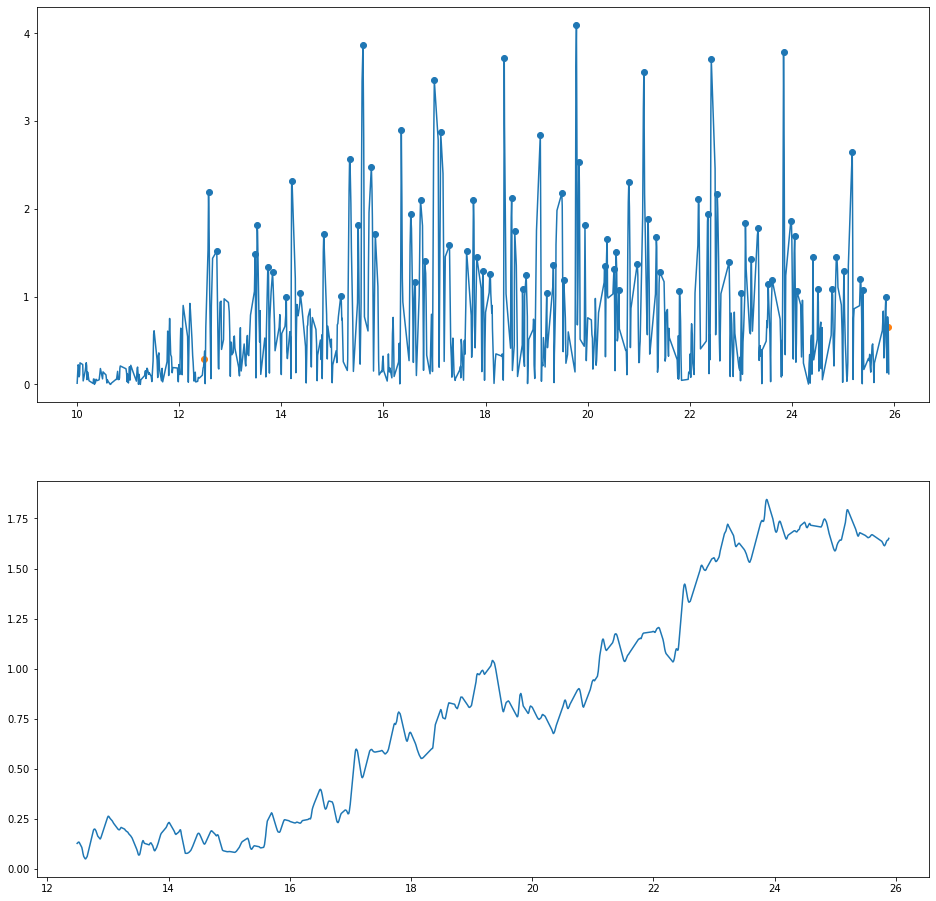

('36', 18, 'Female', 86, 90, True, 13.3905, 78, 0.1727, 74.322, 0.8258, 11.0146, 4892.6705)
('36', 18, 'Female', 86, 90, True, 13.3905, 78, 0.1727, 74.322, 0.8258, 11.0146, 4892.6705, 1.846)
('36', 18, 'Female', 86, 90, True, 13.3905, 78, 0.1727, 74.322, 0.8258, 11.0146, 4892.6705, 1.846, -0.2723, -0.25, -0.046, 8, 128, 'Insanity')


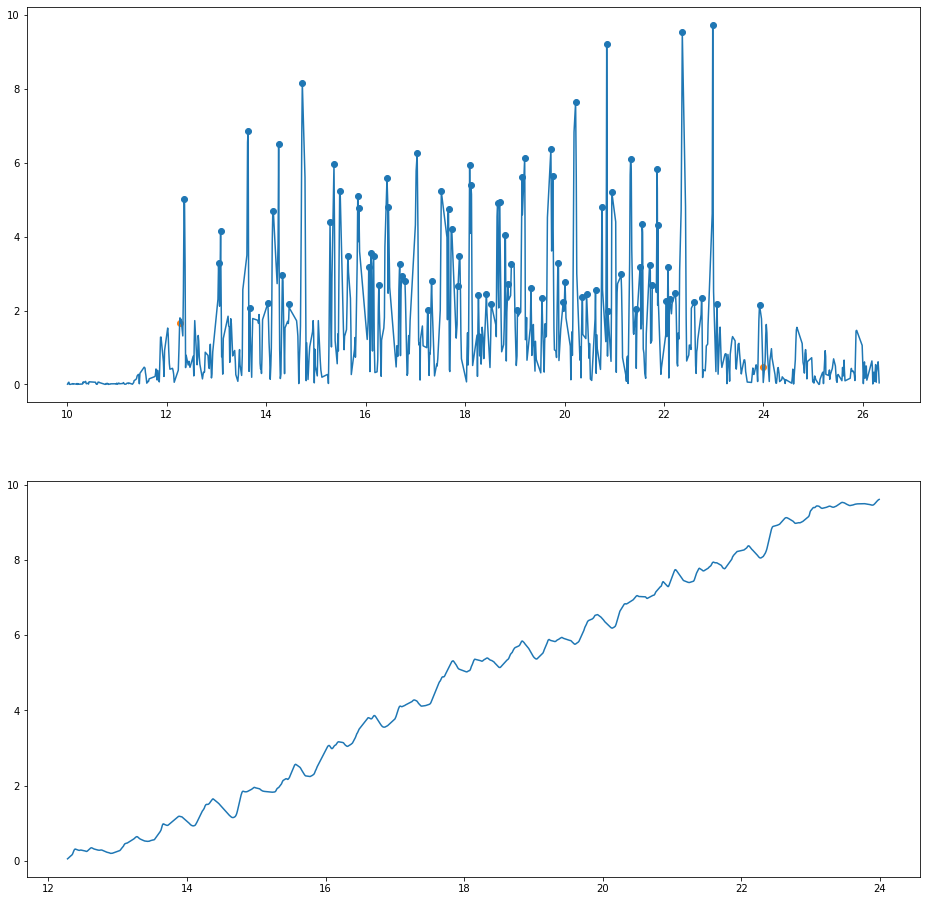

('37', 19, 'Female', 64, 63, False, 11.7105, 81, 0.1452, 304.03799999999995, 4.826, 56.2897, 151760.1524)
('37', 19, 'Female', 64, 63, False, 11.7105, 81, 0.1452, 304.03799999999995, 4.826, 56.2897, 151760.1524, 0.2187)
('37', 19, 'Female', 64, 63, False, 11.7105, 81, 0.1452, 304.03799999999995, 4.826, 56.2897, 151760.1524, 0.2187, -0.0044, 0.1226, 0.2599, 8, 101, 'Depressive Syndrome')
('37', 19, 'Female', 64, 63, False, 11.7105, 81, 0.1452, 304.03799999999995, 4.826, 56.2897, 151760.1524, 0.2187, -0.0044, 0.1226, 0.2599, 8, 104, 'Arterial Hypertension')
('37', 19, 'Female', 64, 63, False, 11.7105, 81, 0.1452, 304.03799999999995, 4.826, 56.2897, 151760.1524, 0.2187, -0.0044, 0.1226, 0.2599, 8, 148, 'Allergic Rhinitis')


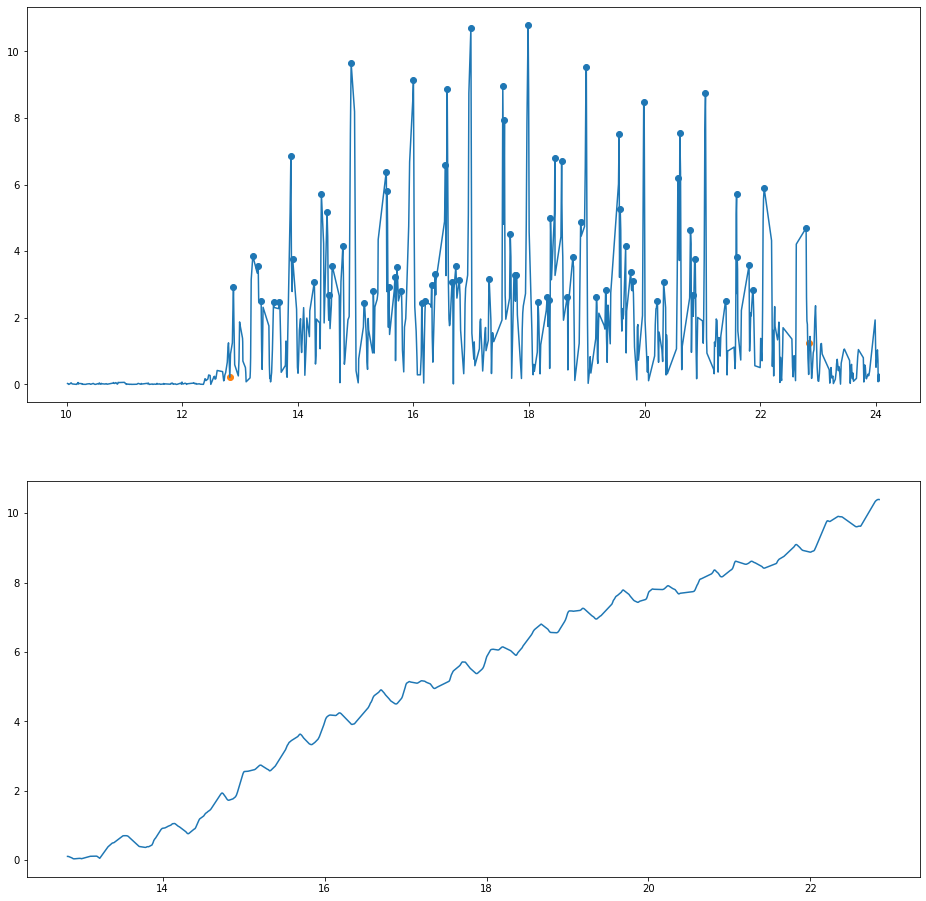

('38', 19, 'Female', 64, 63, False, 10.0275, 74, 0.1362, 332.4447, 5.2769, 52.8586, 184589.1878)
('38', 19, 'Female', 64, 63, False, 10.0275, 74, 0.1362, 332.4447, 5.2769, 52.8586, 184589.1878, 0.8582)
('38', 19, 'Female', 64, 63, False, 10.0275, 74, 0.1362, 332.4447, 5.2769, 52.8586, 184589.1878, 0.8582, -0.3004, 0.2721, -0.2435, 8, 101, 'Depressive Syndrome')
('38', 19, 'Female', 64, 63, False, 10.0275, 74, 0.1362, 332.4447, 5.2769, 52.8586, 184589.1878, 0.8582, -0.3004, 0.2721, -0.2435, 8, 104, 'Arterial Hypertension')
('38', 19, 'Female', 64, 63, False, 10.0275, 74, 0.1362, 332.4447, 5.2769, 52.8586, 184589.1878, 0.8582, -0.3004, 0.2721, -0.2435, 8, 148, 'Allergic Rhinitis')


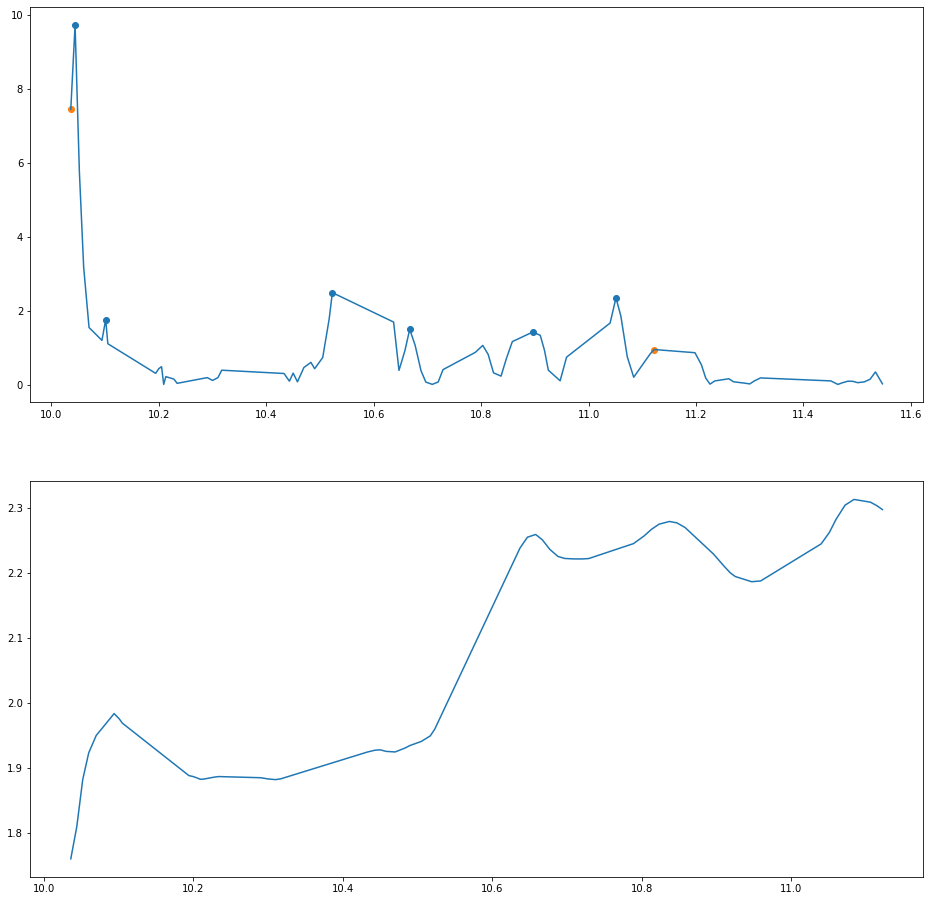

('39', 20, 'Female', 67, 91, False, 1.0865, 6, 0.2019, 189.78050000000002, 2.0855, 2.2407, 4538.2251)
('39', 20, 'Female', 67, 91, False, 1.0865, 6, 0.2019, 189.78050000000002, 2.0855, 2.2407, 4538.2251, 2.7932)
('39', 20, 'Female', 67, 91, False, 1.0865, 6, 0.2019, 189.78050000000002, 2.0855, 2.2407, 4538.2251, 2.7932, -0.0494, 0.0802, -0.0044, 8, 101, 'Depressive Syndrome')
('39', 20, 'Female', 67, 91, False, 1.0865, 6, 0.2019, 189.78050000000002, 2.0855, 2.2407, 4538.2251, 2.7932, -0.0494, 0.0802, -0.0044, 8, 195, 'Knee Prosthesis')
('39', 20, 'Female', 67, 91, False, 1.0865, 6, 0.2019, 189.78050000000002, 2.0855, 2.2407, 4538.2251, 2.7932, -0.0494, 0.0802, -0.0044, 8, 196, 'Sigmoidectomy')
('39', 20, 'Female', 67, 91, False, 1.0865, 6, 0.2019, 189.78050000000002, 2.0855, 2.2407, 4538.2251, 2.7932, -0.0494, 0.0802, -0.0044, 8, 197, 'Temporary Colostomy And Laparotomy')


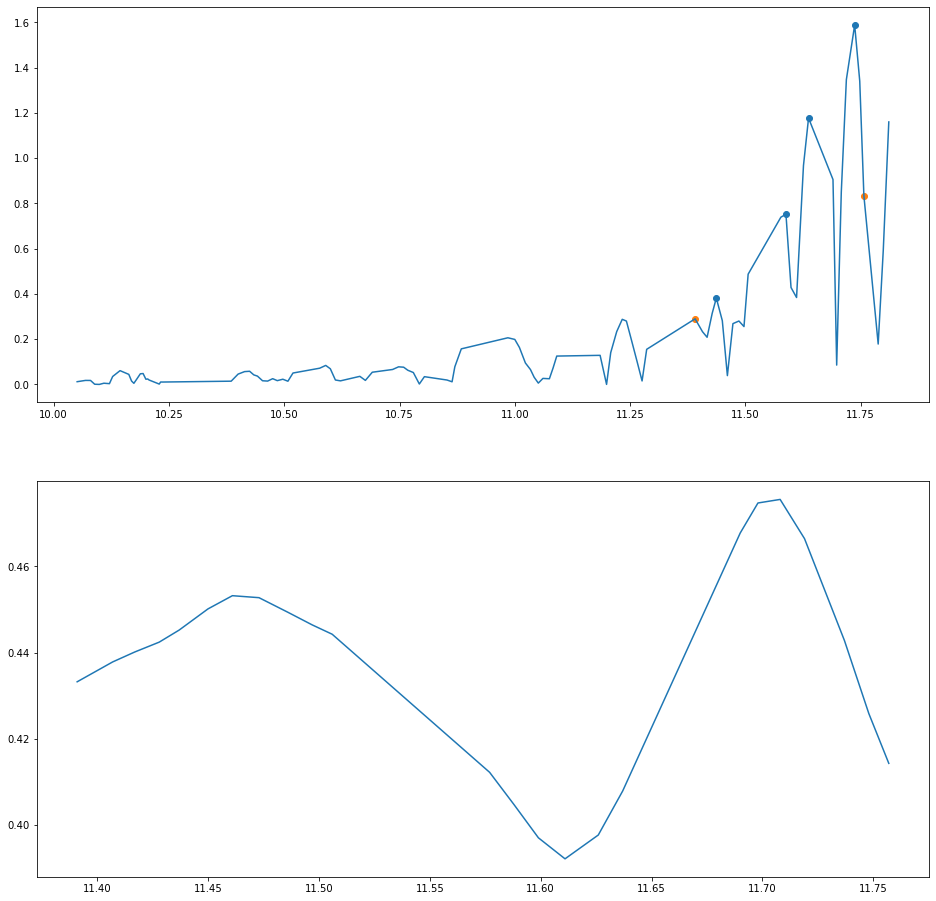

('40', 20, 'Female', 67, 91, False, 0.3665, 4, 0.1005, 39.767, 0.437, 0.2035, -153.4164)
('40', 20, 'Female', 67, 91, False, 0.3665, 4, 0.1005, 39.767, 0.437, 0.2035, -153.4164, 3.4067)
('40', 20, 'Female', 67, 91, False, 0.3665, 4, 0.1005, 39.767, 0.437, 0.2035, -153.4164, 3.4067, -0.003, -0.0039, -0.0002, 8, 101, 'Depressive Syndrome')
('40', 20, 'Female', 67, 91, False, 0.3665, 4, 0.1005, 39.767, 0.437, 0.2035, -153.4164, 3.4067, -0.003, -0.0039, -0.0002, 8, 195, 'Knee Prosthesis')
('40', 20, 'Female', 67, 91, False, 0.3665, 4, 0.1005, 39.767, 0.437, 0.2035, -153.4164, 3.4067, -0.003, -0.0039, -0.0002, 8, 196, 'Sigmoidectomy')
('40', 20, 'Female', 67, 91, False, 0.3665, 4, 0.1005, 39.767, 0.437, 0.2035, -153.4164, 3.4067, -0.003, -0.0039, -0.0002, 8, 197, 'Temporary Colostomy And Laparotomy')


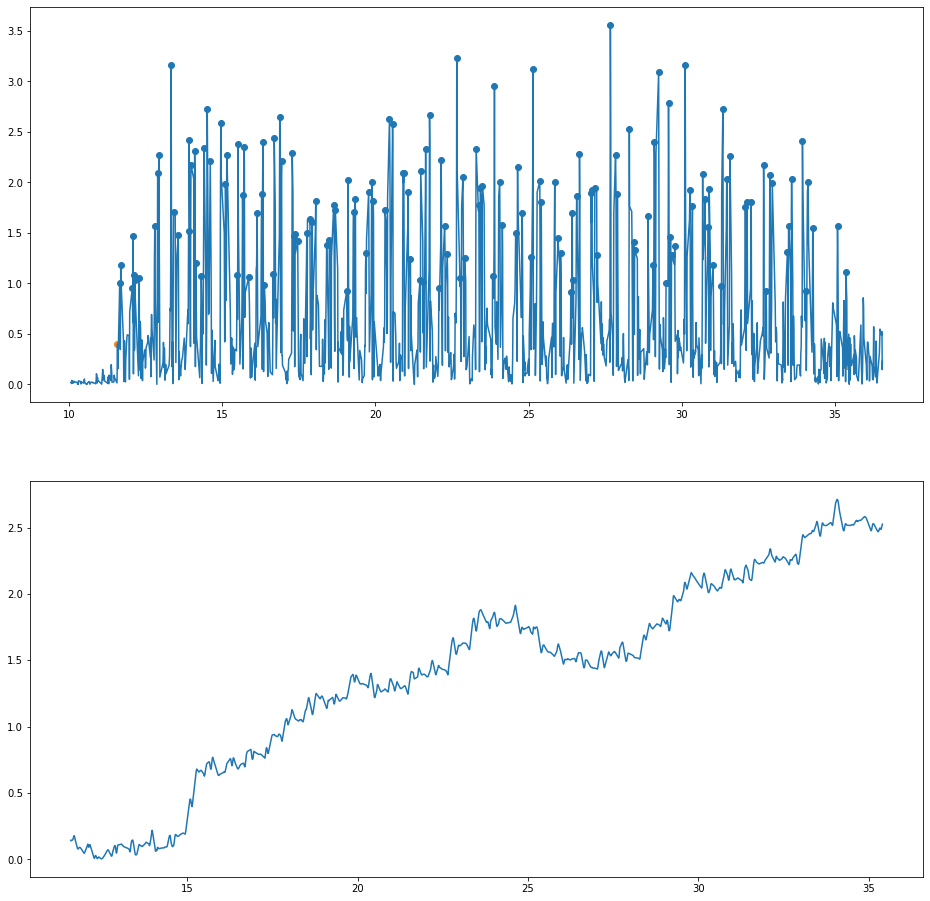

('41', 21, 'Female', 86, 60, False, 23.8355, 148, 0.1619, 84.444, 1.4074, 33.4945, 11778.3125)
('41', 21, 'Female', 86, 60, False, 23.8355, 148, 0.1619, 84.444, 1.4074, 33.4945, 11778.3125, 0.4795)
('41', 21, 'Female', 86, 60, False, 23.8355, 148, 0.1619, 84.444, 1.4074, 33.4945, 11778.3125, 0.4795, 0.0796, -0.0262, 0.8267, 8, 101, 'Depressive Syndrome')
('41', 21, 'Female', 86, 60, False, 23.8355, 148, 0.1619, 84.444, 1.4074, 33.4945, 11778.3125, 0.4795, 0.0796, -0.0262, 0.8267, 8, 198, 'Osteopathic Dorsal Trauma')
('41', 21, 'Female', 86, 60, False, 23.8355, 148, 0.1619, 84.444, 1.4074, 33.4945, 11778.3125, 0.4795, 0.0796, -0.0262, 0.8267, 8, 190, 'Hypercholesterolemia')
('41', 21, 'Female', 86, 60, False, 23.8355, 148, 0.1619, 84.444, 1.4074, 33.4945, 11778.3125, 0.4795, 0.0796, -0.0262, 0.8267, 8, 103, 'Diabetes')
('41', 21, 'Female', 86, 60, False, 23.8355, 148, 0.1619, 84.444, 1.4074, 33.4945, 11778.3125, 0.4795, 0.0796, -0.0262, 0.8267, 8, 199, 'Renal Lytrase')
('41', 21, 'Femal

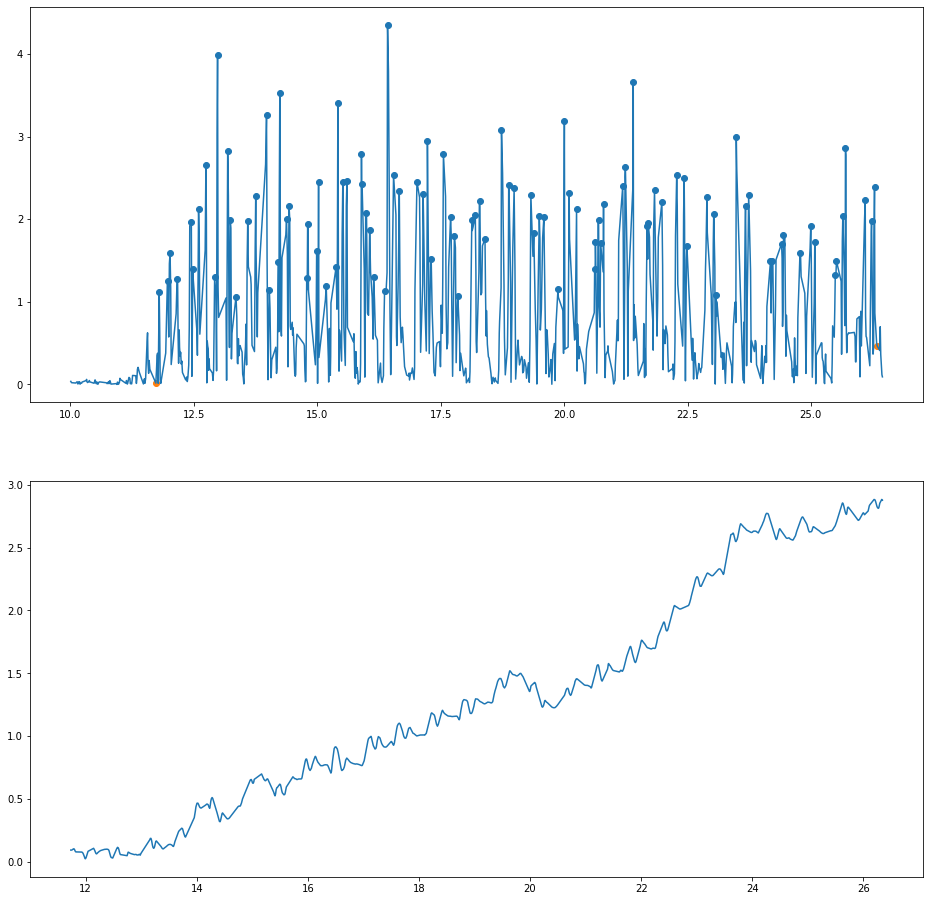

('42', 21, 'Female', 86, 60, False, 14.6125, 97, 0.1514, 78.714, 1.3119, 19.1523, 7627.7825)
('42', 21, 'Female', 86, 60, False, 14.6125, 97, 0.1514, 78.714, 1.3119, 19.1523, 7627.7825, 1.0055)
('42', 21, 'Female', 86, 60, False, 14.6125, 97, 0.1514, 78.714, 1.3119, 19.1523, 7627.7825, 1.0055, -0.2553, -0.2248, 0.006, 8, 101, 'Depressive Syndrome')
('42', 21, 'Female', 86, 60, False, 14.6125, 97, 0.1514, 78.714, 1.3119, 19.1523, 7627.7825, 1.0055, -0.2553, -0.2248, 0.006, 8, 198, 'Osteopathic Dorsal Trauma')
('42', 21, 'Female', 86, 60, False, 14.6125, 97, 0.1514, 78.714, 1.3119, 19.1523, 7627.7825, 1.0055, -0.2553, -0.2248, 0.006, 8, 190, 'Hypercholesterolemia')
('42', 21, 'Female', 86, 60, False, 14.6125, 97, 0.1514, 78.714, 1.3119, 19.1523, 7627.7825, 1.0055, -0.2553, -0.2248, 0.006, 8, 103, 'Diabetes')
('42', 21, 'Female', 86, 60, False, 14.6125, 97, 0.1514, 78.714, 1.3119, 19.1523, 7627.7825, 1.0055, -0.2553, -0.2248, 0.006, 8, 199, 'Renal Lytrase')
('42', 21, 'Female', 86, 60, Fa

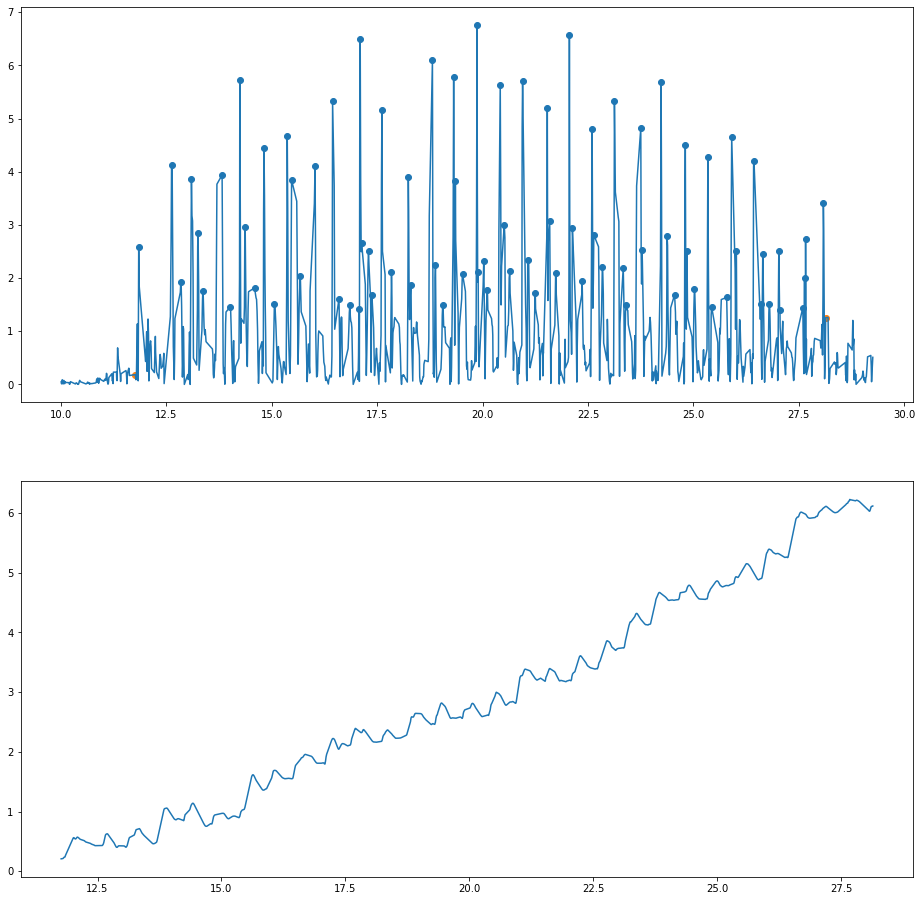

('43', 22, 'Male', 55, 63, True, 16.3725, 80, 0.206, 185.4342, 2.9434, 48.0277, 51737.396)
('43', 22, 'Male', 55, 63, True, 16.3725, 80, 0.206, 185.4342, 2.9434, 48.0277, 51737.396, 0.1532)
('43', 22, 'Male', 55, 63, True, 16.3725, 80, 0.206, 185.4342, 2.9434, 48.0277, 51737.396, 0.1532, -0.0097, 0.09, 0.6256, 8, 202, 'Psoriasis')
('43', 22, 'Male', 55, 63, True, 16.3725, 80, 0.206, 185.4342, 2.9434, 48.0277, 51737.396, 0.1532, -0.0097, 0.09, 0.6256, 8, 203, 'Blind On The Right')


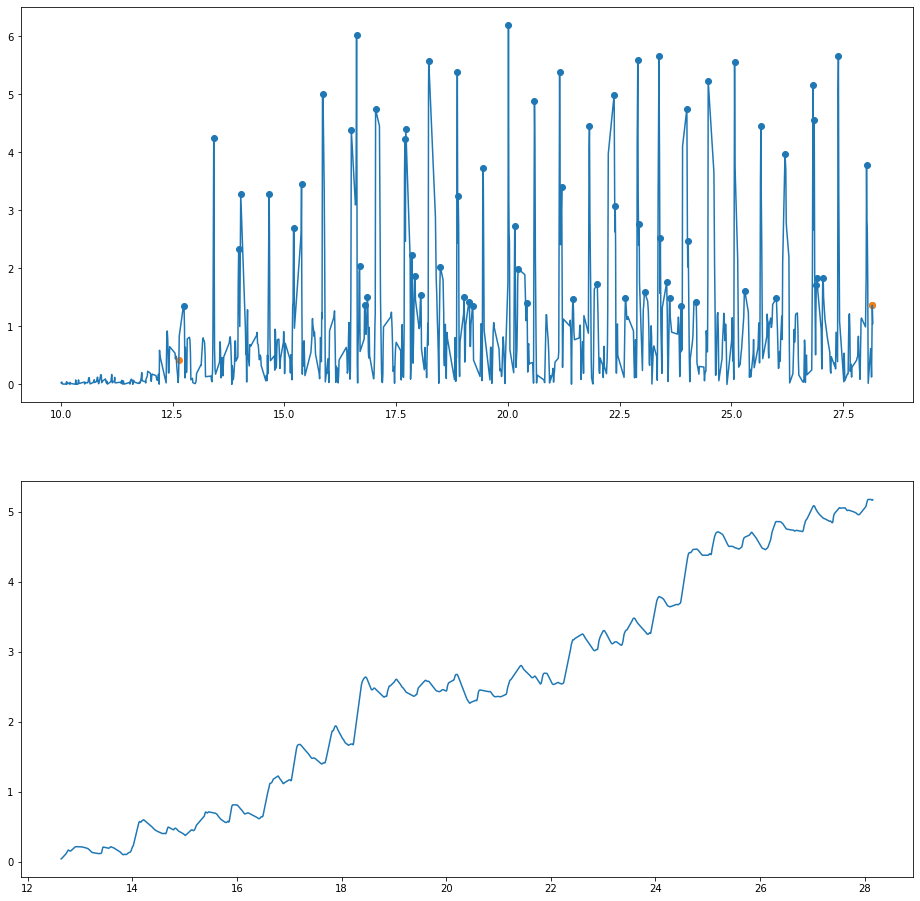

('44', 22, 'Male', 55, 63, True, 15.5115, 65, 0.2411, 158.8797, 2.5219, 38.7789, 44066.2955)
('44', 22, 'Male', 55, 63, True, 15.5115, 65, 0.2411, 158.8797, 2.5219, 38.7789, 44066.2955, 1.6667)
('44', 22, 'Male', 55, 63, True, 15.5115, 65, 0.2411, 158.8797, 2.5219, 38.7789, 44066.2955, 1.6667, 0.0241, -0.0065, 0.0141, 8, 202, 'Psoriasis')
('44', 22, 'Male', 55, 63, True, 15.5115, 65, 0.2411, 158.8797, 2.5219, 38.7789, 44066.2955, 1.6667, 0.0241, -0.0065, 0.0141, 8, 203, 'Blind On The Right')


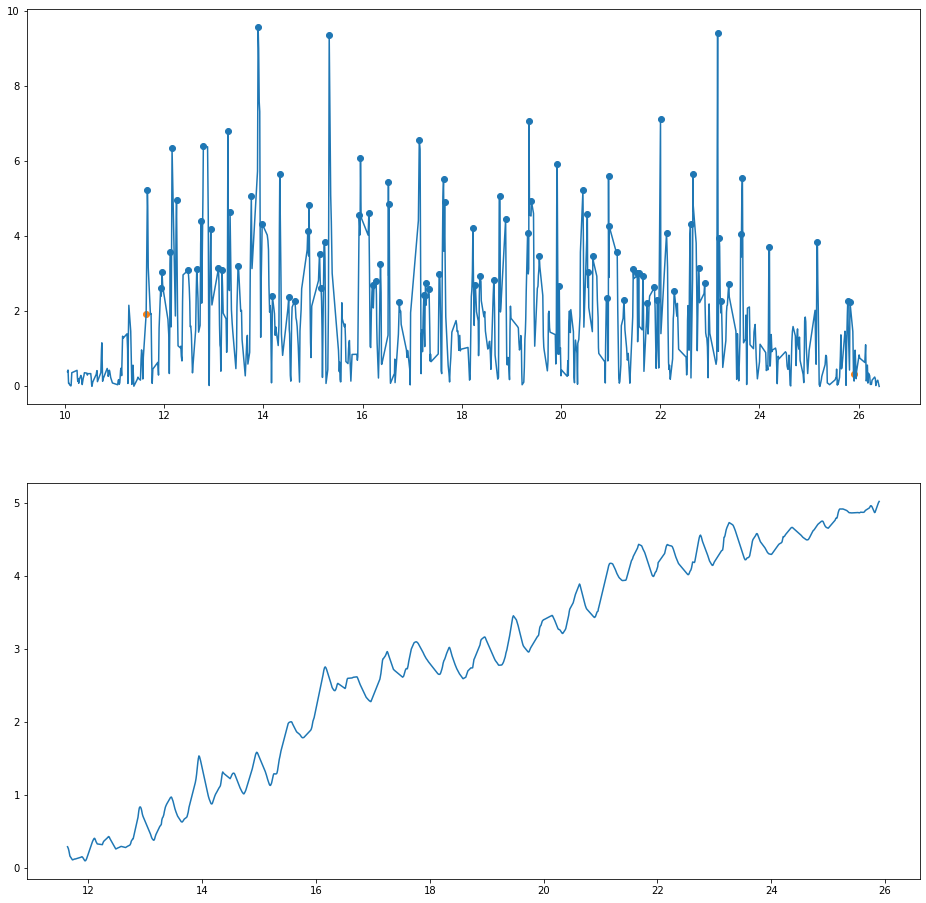

('45', 23, 'Male', 83, 60, False, 14.2605, 90, 0.1596, 171.048, 2.8508, 40.4803, 53582.3345)
('45', 23, 'Male', 83, 60, False, 14.2605, 90, 0.1596, 171.048, 2.8508, 40.4803, 53582.3345, 0.6015)
('45', 23, 'Male', 83, 60, False, 14.2605, 90, 0.1596, 171.048, 2.8508, 40.4803, 53582.3345, 0.6015, -0.4201, 0.2198, -0.1462, 6, 104, 'Arterial Hypertension')
('45', 23, 'Male', 83, 60, False, 14.2605, 90, 0.1596, 171.048, 2.8508, 40.4803, 53582.3345, 0.6015, -0.4201, 0.2198, -0.1462, 6, 204, 'Ethanolic Habits')


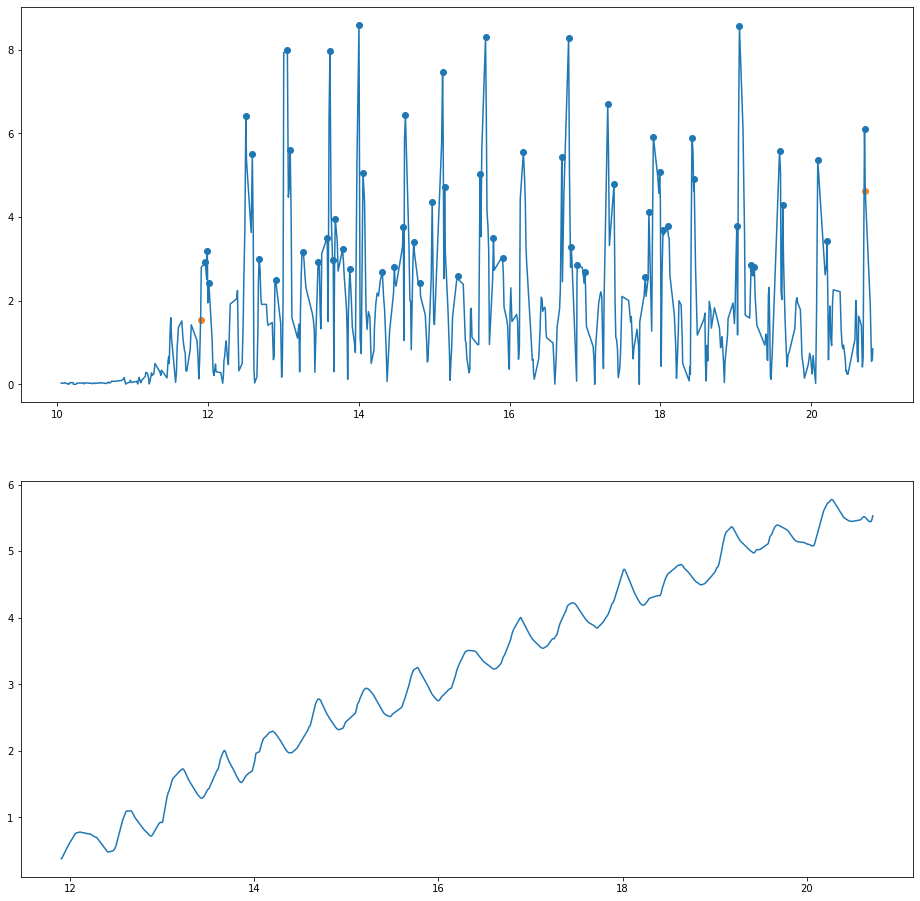

('46', 23, 'Male', 83, 60, False, 8.8175, 59, 0.1513, 194.148, 3.2358, 28.3855, 51919.3445)
('46', 23, 'Male', 83, 60, False, 8.8175, 59, 0.1513, 194.148, 3.2358, 28.3855, 51919.3445, 0.9187)
('46', 23, 'Male', 83, 60, False, 8.8175, 59, 0.1513, 194.148, 3.2358, 28.3855, 51919.3445, 0.9187, -0.272, 0.2248, -0.2026, 6, 104, 'Arterial Hypertension')
('46', 23, 'Male', 83, 60, False, 8.8175, 59, 0.1513, 194.148, 3.2358, 28.3855, 51919.3445, 0.9187, -0.272, 0.2248, -0.2026, 6, 204, 'Ethanolic Habits')


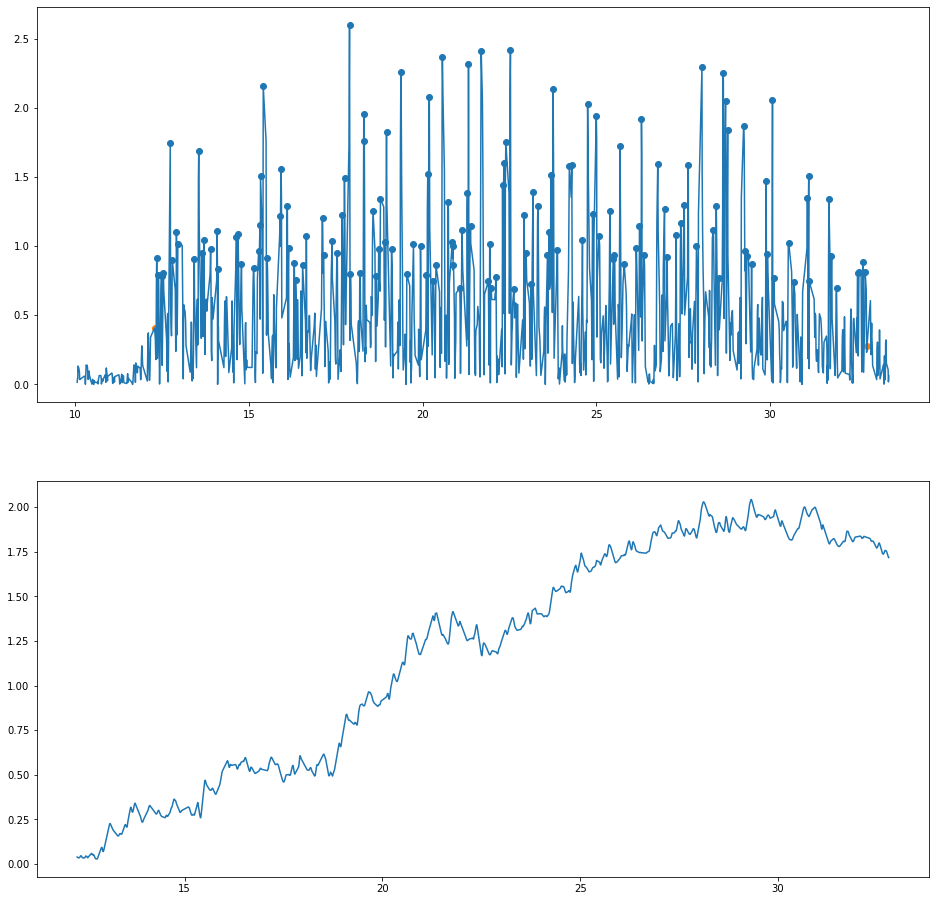

('47', 24, 'Female', 89, 87, False, 20.5165, 140, 0.1473, 103.1298, 1.1854, 24.3776, 10103.3888)
('47', 24, 'Female', 89, 87, False, 20.5165, 140, 0.1473, 103.1298, 1.1854, 24.3776, 10103.3888, 0.5307)
('47', 24, 'Female', 89, 87, False, 20.5165, 140, 0.1473, 103.1298, 1.1854, 24.3776, 10103.3888, 0.5307, -0.0452, -0.0277, 0.2571, 8, 142, 'Heart Failure')
('47', 24, 'Female', 89, 87, False, 20.5165, 140, 0.1473, 103.1298, 1.1854, 24.3776, 10103.3888, 0.5307, -0.0452, -0.0277, 0.2571, 8, 104, 'Arterial Hypertension')
('47', 24, 'Female', 89, 87, False, 20.5165, 140, 0.1473, 103.1298, 1.1854, 24.3776, 10103.3888, 0.5307, -0.0452, -0.0277, 0.2571, 8, 205, 'Sinusoidal Hypertrophy Of The Prostate')
('47', 24, 'Female', 89, 87, False, 20.5165, 140, 0.1473, 103.1298, 1.1854, 24.3776, 10103.3888, 0.5307, -0.0452, -0.0277, 0.2571, 8, 176, 'Atrial Fibrillation')


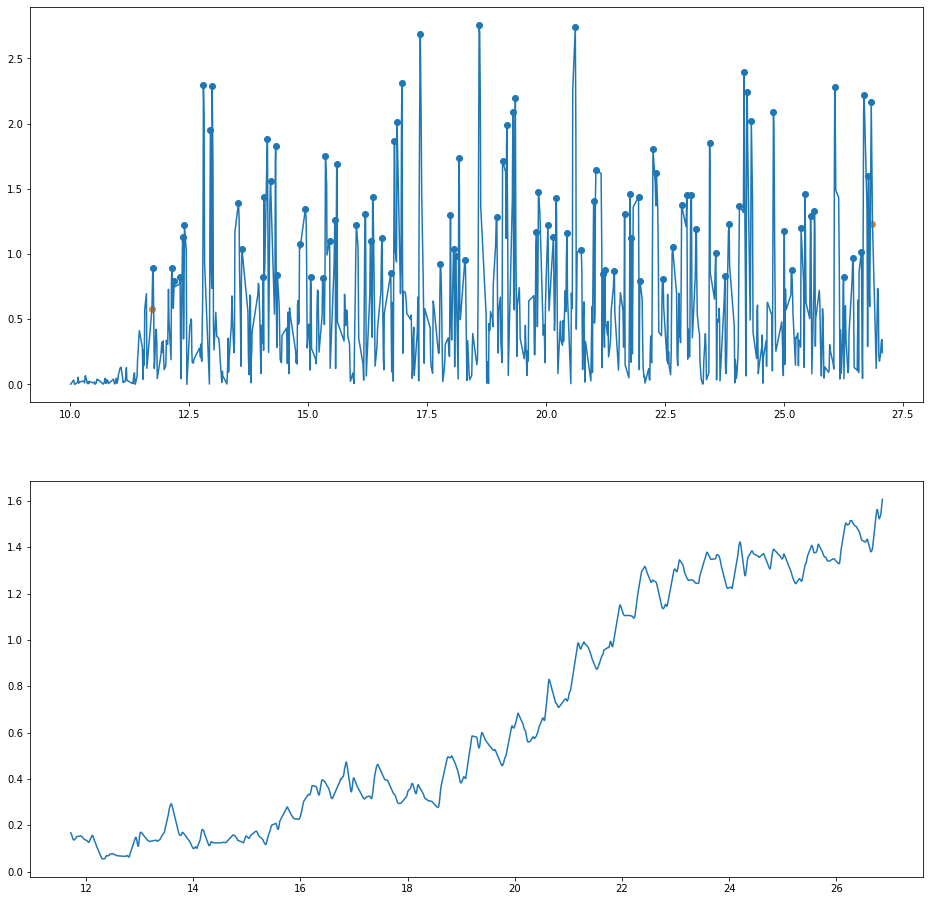

('48', 24, 'Female', 89, 87, False, 15.1475, 95, 0.1612, 59.2644, 0.6812, 10.3137, 5295.3686)
('48', 24, 'Female', 89, 87, False, 15.1475, 95, 0.1612, 59.2644, 0.6812, 10.3137, 5295.3686, 2.0216)
('48', 24, 'Female', 89, 87, False, 15.1475, 95, 0.1612, 59.2644, 0.6812, 10.3137, 5295.3686, 2.0216, -0.3318, 0.3607, -0.2728, 8, 142, 'Heart Failure')
('48', 24, 'Female', 89, 87, False, 15.1475, 95, 0.1612, 59.2644, 0.6812, 10.3137, 5295.3686, 2.0216, -0.3318, 0.3607, -0.2728, 8, 104, 'Arterial Hypertension')
('48', 24, 'Female', 89, 87, False, 15.1475, 95, 0.1612, 59.2644, 0.6812, 10.3137, 5295.3686, 2.0216, -0.3318, 0.3607, -0.2728, 8, 205, 'Sinusoidal Hypertrophy Of The Prostate')
('48', 24, 'Female', 89, 87, False, 15.1475, 95, 0.1612, 59.2644, 0.6812, 10.3137, 5295.3686, 2.0216, -0.3318, 0.3607, -0.2728, 8, 176, 'Atrial Fibrillation')


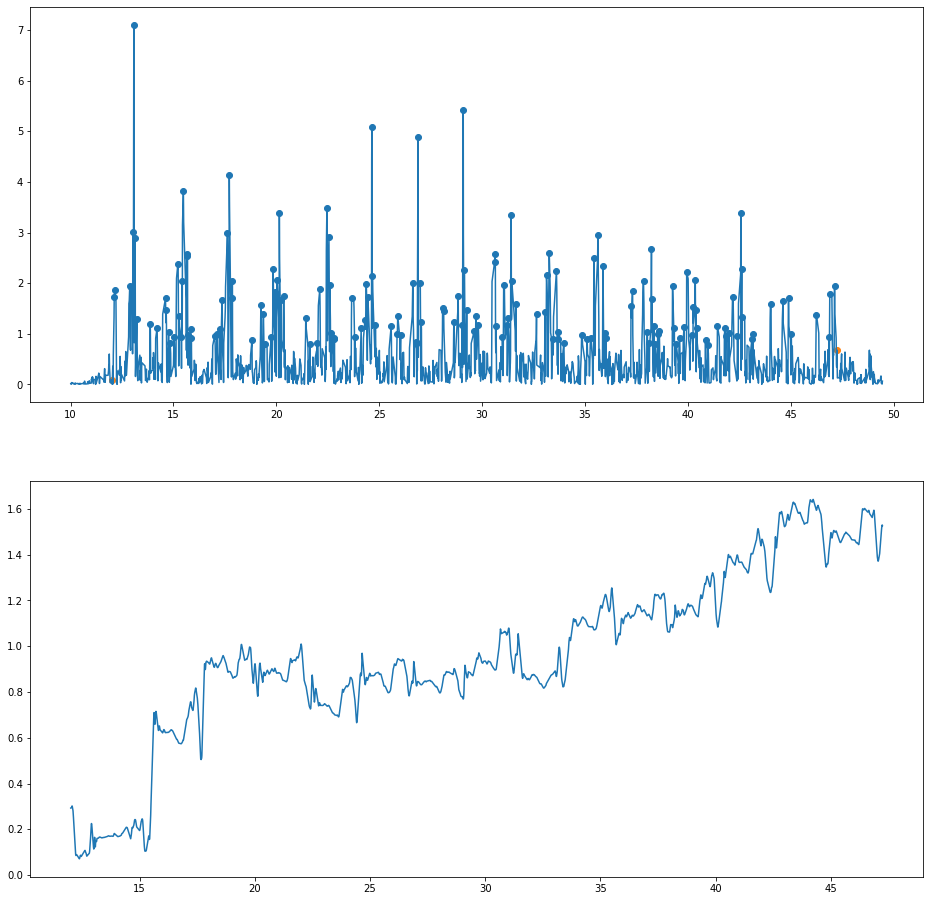

('49', 25, 'Male', 59, 95, False, 35.2305, 154, 0.2293, 91.2665, 0.9607, 33.8095, 6019.5615)
('49', 25, 'Male', 59, 95, False, 35.2305, 154, 0.2293, 91.2665, 0.9607, 33.8095, 6019.5615, 0.3625)
('49', 25, 'Male', 59, 95, False, 35.2305, 154, 0.2293, 91.2665, 0.9607, 33.8095, 6019.5615, 0.3625, -0.2227, -0.0257, -0.1821, 8, 136, 'Stroke')


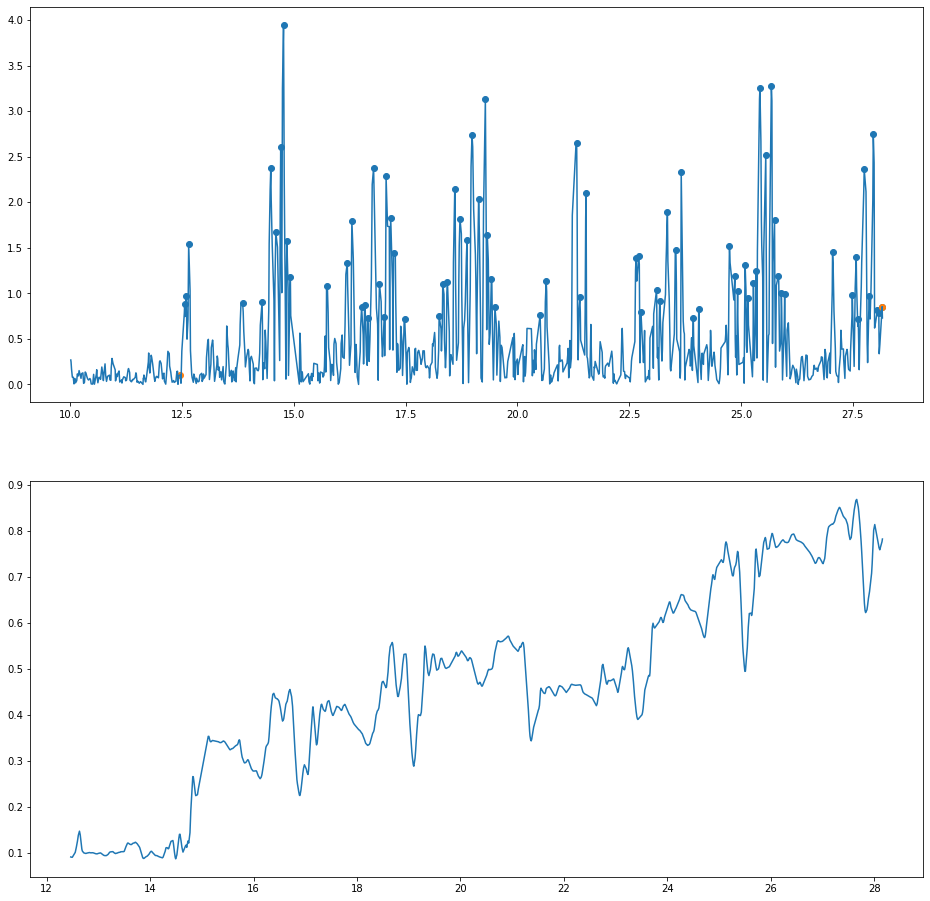

('50', 25, 'Male', 59, 95, False, 15.6895, 75, 0.2112, 43.928, 0.4624, 7.2241, 1107.121)
('50', 25, 'Male', 59, 95, False, 15.6895, 75, 0.2112, 43.928, 0.4624, 7.2241, 1107.121, 2.9853)
('50', 25, 'Male', 59, 95, False, 15.6895, 75, 0.2112, 43.928, 0.4624, 7.2241, 1107.121, 2.9853, 0.0205, -0.0112, 0.1472, 8, 136, 'Stroke')


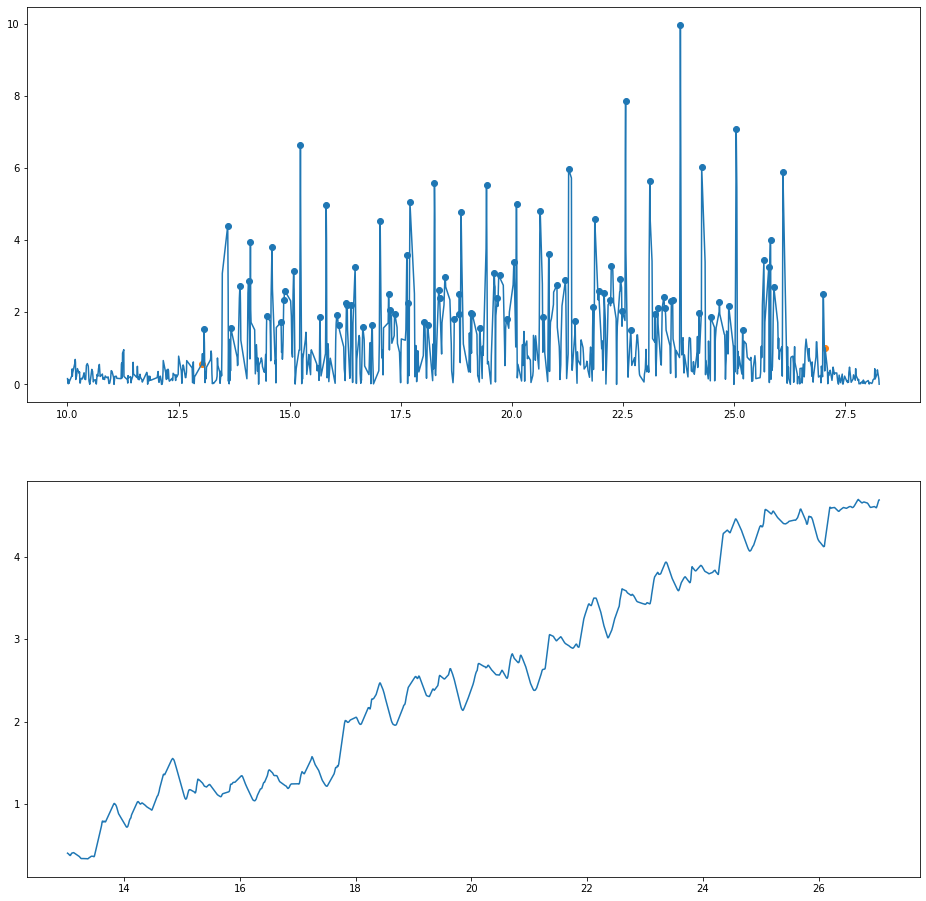

('51', 26, 'Male', 92, 54, False, 14.0285, 88, 0.1607, 139.22820000000002, 2.5783, 36.2087, 26679.4943)
('51', 26, 'Male', 92, 54, False, 14.0285, 88, 0.1607, 139.22820000000002, 2.5783, 36.2087, 26679.4943, 0.7231)
('51', 26, 'Male', 92, 54, False, 14.0285, 88, 0.1607, 139.22820000000002, 2.5783, 36.2087, 26679.4943, 0.7231, 0.2638, 0.171, -0.3191, 7, 104, 'Arterial Hypertension')
('51', 26, 'Male', 92, 54, False, 14.0285, 88, 0.1607, 139.22820000000002, 2.5783, 36.2087, 26679.4943, 0.7231, 0.2638, 0.171, -0.3191, 7, 106, 'Dyslipidemia')
('51', 26, 'Male', 92, 54, False, 14.0285, 88, 0.1607, 139.22820000000002, 2.5783, 36.2087, 26679.4943, 0.7231, 0.2638, 0.171, -0.3191, 7, 206, 'Dizziness Syndrome;')


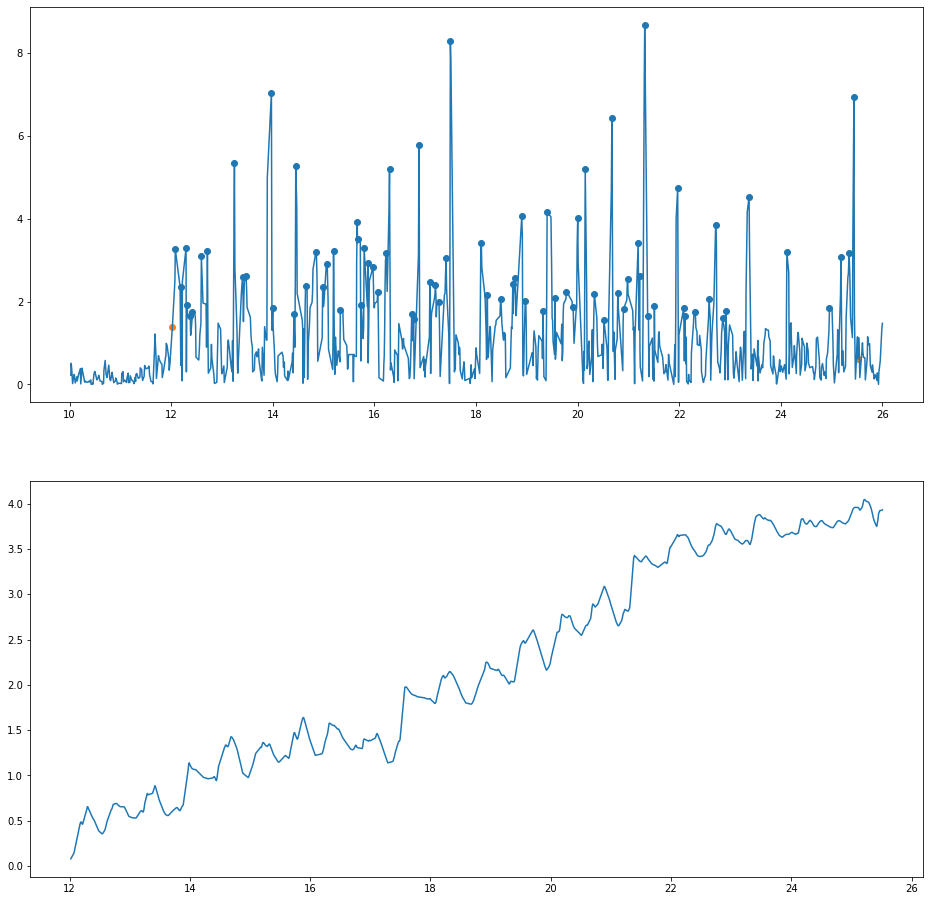

('52', 26, 'Male', 92, 54, False, 13.4925, 77, 0.1763, 119.9826, 2.2219, 29.7066, 16783.0979)
('52', 26, 'Male', 92, 54, False, 13.4925, 77, 0.1763, 119.9826, 2.2219, 29.7066, 16783.0979, 1.8375)
('52', 26, 'Male', 92, 54, False, 13.4925, 77, 0.1763, 119.9826, 2.2219, 29.7066, 16783.0979, 1.8375, -0.2194, 0.649, -0.197, 7, 104, 'Arterial Hypertension')
('52', 26, 'Male', 92, 54, False, 13.4925, 77, 0.1763, 119.9826, 2.2219, 29.7066, 16783.0979, 1.8375, -0.2194, 0.649, -0.197, 7, 106, 'Dyslipidemia')
('52', 26, 'Male', 92, 54, False, 13.4925, 77, 0.1763, 119.9826, 2.2219, 29.7066, 16783.0979, 1.8375, -0.2194, 0.649, -0.197, 7, 206, 'Dizziness Syndrome;')


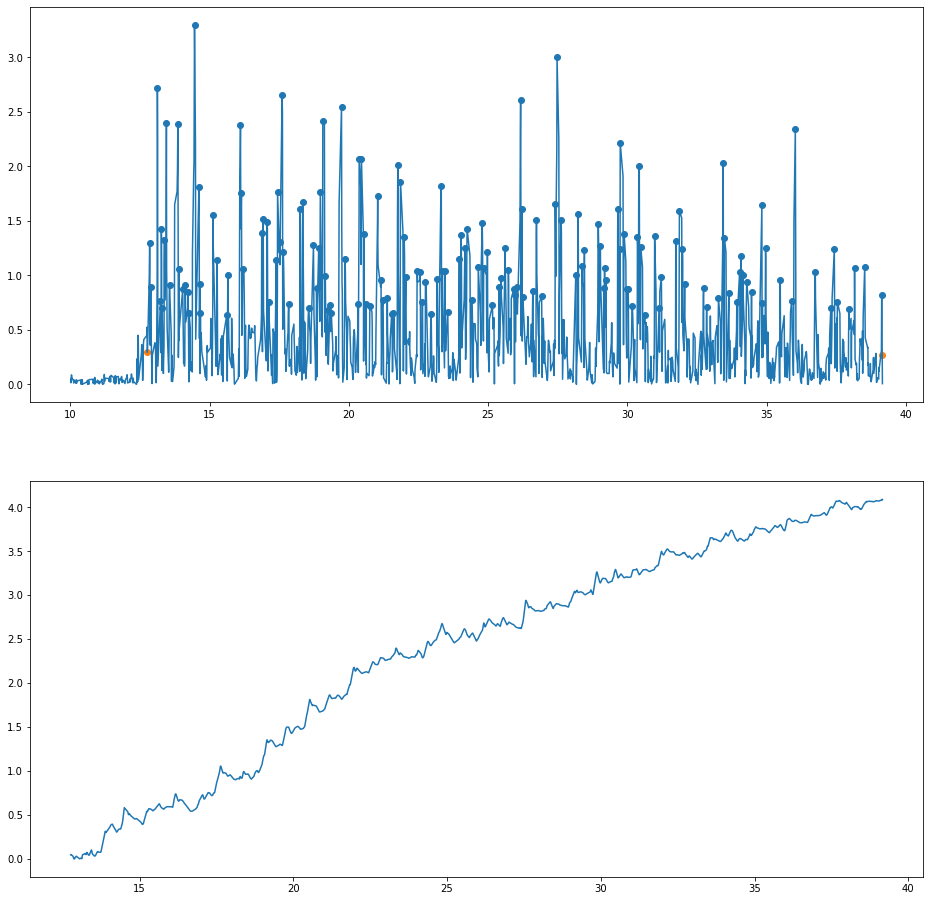

('53', 27, 'Female', 97, 66, False, 26.3915, 155, 0.1712, 156.71699999999998, 2.3745, 62.5855, 22884.9791)
('53', 27, 'Female', 97, 66, False, 26.3915, 155, 0.1712, 156.71699999999998, 2.3745, 62.5855, 22884.9791, 0.5608)
('53', 27, 'Female', 97, 66, False, 26.3915, 155, 0.1712, 156.71699999999998, 2.3745, 62.5855, 22884.9791, 0.5608, -0.3986, 0.2865, 0.0854, 8, 136, 'Stroke')
('53', 27, 'Female', 97, 66, False, 26.3915, 155, 0.1712, 156.71699999999998, 2.3745, 62.5855, 22884.9791, 0.5608, -0.3986, 0.2865, 0.0854, 8, 207, 'Heart Disease')
('53', 27, 'Female', 97, 66, False, 26.3915, 155, 0.1712, 156.71699999999998, 2.3745, 62.5855, 22884.9791, 0.5608, -0.3986, 0.2865, 0.0854, 8, 104, 'Arterial Hypertension')
('53', 27, 'Female', 97, 66, False, 26.3915, 155, 0.1712, 156.71699999999998, 2.3745, 62.5855, 22884.9791, 0.5608, -0.3986, 0.2865, 0.0854, 8, 176, 'Atrial Fibrillation')
('53', 27, 'Female', 97, 66, False, 26.3915, 155, 0.1712, 156.71699999999998, 2.3745, 62.5855, 22884.9791, 0.56

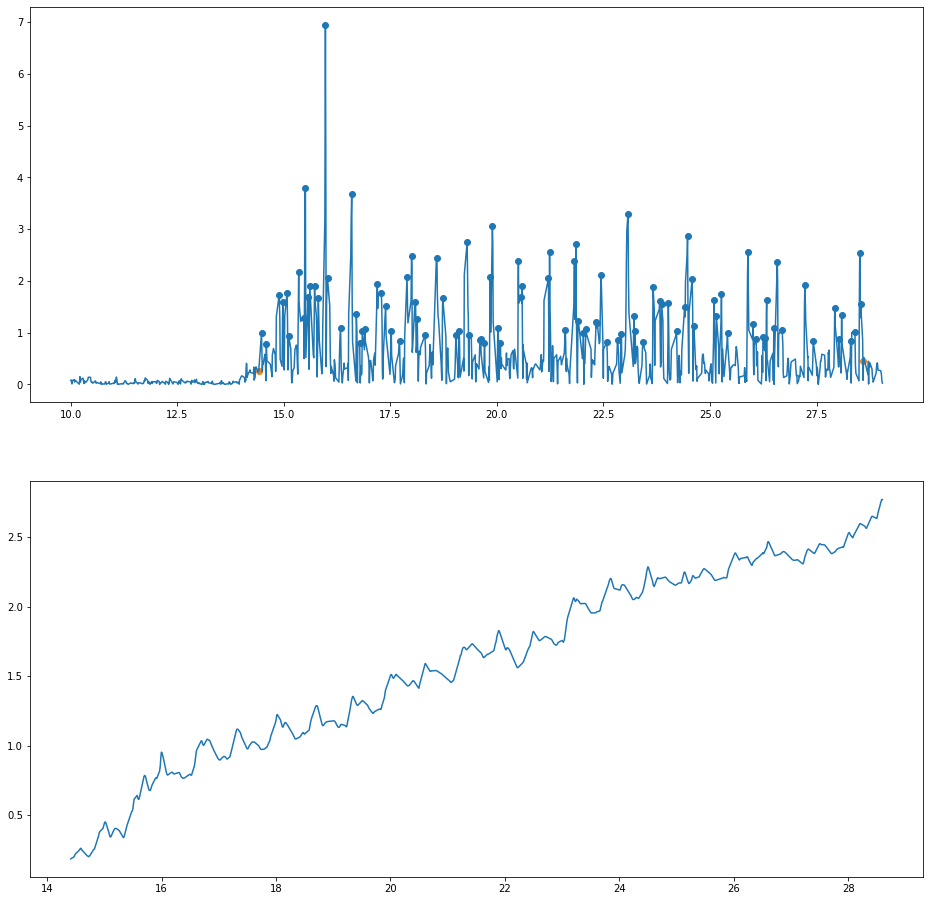

('54', 27, 'Female', 97, 66, False, 14.1875, 96, 0.1484, 105.2304, 1.5944, 22.566, 14593.0427)
('54', 27, 'Female', 97, 66, False, 14.1875, 96, 0.1484, 105.2304, 1.5944, 22.566, 14593.0427, 2.2339)
('54', 27, 'Female', 97, 66, False, 14.1875, 96, 0.1484, 105.2304, 1.5944, 22.566, 14593.0427, 2.2339, -0.2482, 0.097, -0.0912, 8, 136, 'Stroke')
('54', 27, 'Female', 97, 66, False, 14.1875, 96, 0.1484, 105.2304, 1.5944, 22.566, 14593.0427, 2.2339, -0.2482, 0.097, -0.0912, 8, 207, 'Heart Disease')
('54', 27, 'Female', 97, 66, False, 14.1875, 96, 0.1484, 105.2304, 1.5944, 22.566, 14593.0427, 2.2339, -0.2482, 0.097, -0.0912, 8, 104, 'Arterial Hypertension')
('54', 27, 'Female', 97, 66, False, 14.1875, 96, 0.1484, 105.2304, 1.5944, 22.566, 14593.0427, 2.2339, -0.2482, 0.097, -0.0912, 8, 176, 'Atrial Fibrillation')
('54', 27, 'Female', 97, 66, False, 14.1875, 96, 0.1484, 105.2304, 1.5944, 22.566, 14593.0427, 2.2339, -0.2482, 0.097, -0.0912, 8, 103, 'Diabetes')


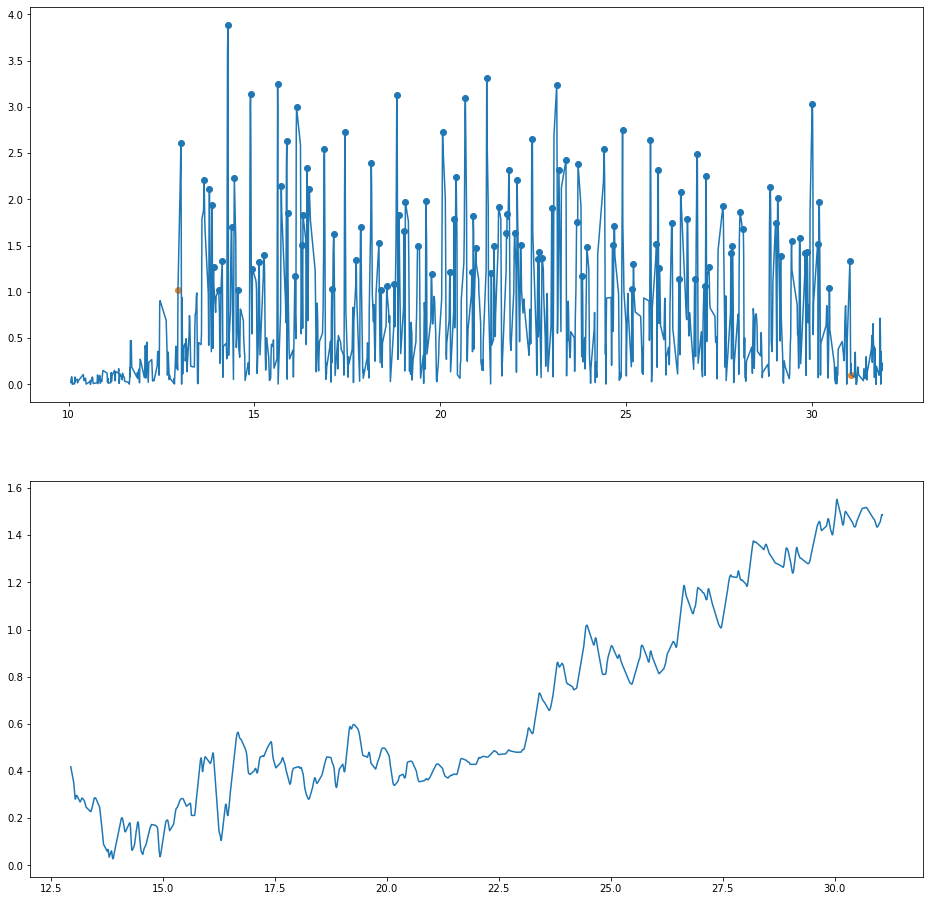

('55', 28, 'Female', 89, 69, False, 18.1155, 110, 0.1656, 47.389199999999995, 0.6868, 12.3171, 1851.3188)
('55', 28, 'Female', 89, 69, False, 18.1155, 110, 0.1656, 47.389199999999995, 0.6868, 12.3171, 1851.3188, 0.2145)
('55', 28, 'Female', 89, 69, False, 18.1155, 110, 0.1656, 47.389199999999995, 0.6868, 12.3171, 1851.3188, 0.2145, 0.1276, -0.0269, -0.0567, 8, 104, 'Arterial Hypertension')
('55', 28, 'Female', 89, 69, False, 18.1155, 110, 0.1656, 47.389199999999995, 0.6868, 12.3171, 1851.3188, 0.2145, 0.1276, -0.0269, -0.0567, 8, 106, 'Dyslipidemia')
('55', 28, 'Female', 89, 69, False, 18.1155, 110, 0.1656, 47.389199999999995, 0.6868, 12.3171, 1851.3188, 0.2145, 0.1276, -0.0269, -0.0567, 8, 208, 'Depression')
('55', 28, 'Female', 89, 69, False, 18.1155, 110, 0.1656, 47.389199999999995, 0.6868, 12.3171, 1851.3188, 0.2145, 0.1276, -0.0269, -0.0567, 8, 209, 'Gonarthrosis')
('55', 28, 'Female', 89, 69, False, 18.1155, 110, 0.1656, 47.389199999999995, 0.6868, 12.3171, 1851.3188, 0.2145, 0.1

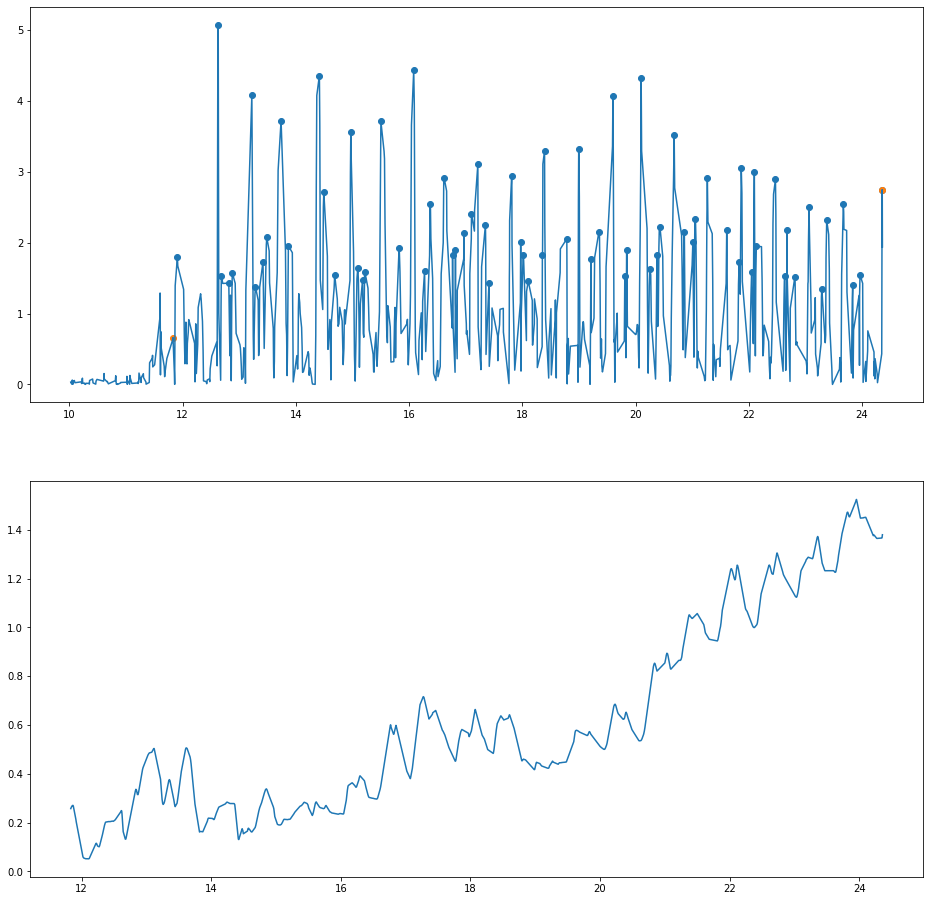

('56', 28, 'Female', 89, 69, False, 12.5275, 70, 0.1809, 42.331500000000005, 0.6135, 7.6567, 2250.2423)
('56', 28, 'Female', 89, 69, False, 12.5275, 70, 0.1809, 42.331500000000005, 0.6135, 7.6567, 2250.2423, 0.3309)
('56', 28, 'Female', 89, 69, False, 12.5275, 70, 0.1809, 42.331500000000005, 0.6135, 7.6567, 2250.2423, 0.3309, -0.2497, 0.3468, -0.3542, 8, 104, 'Arterial Hypertension')
('56', 28, 'Female', 89, 69, False, 12.5275, 70, 0.1809, 42.331500000000005, 0.6135, 7.6567, 2250.2423, 0.3309, -0.2497, 0.3468, -0.3542, 8, 106, 'Dyslipidemia')
('56', 28, 'Female', 89, 69, False, 12.5275, 70, 0.1809, 42.331500000000005, 0.6135, 7.6567, 2250.2423, 0.3309, -0.2497, 0.3468, -0.3542, 8, 208, 'Depression')
('56', 28, 'Female', 89, 69, False, 12.5275, 70, 0.1809, 42.331500000000005, 0.6135, 7.6567, 2250.2423, 0.3309, -0.2497, 0.3468, -0.3542, 8, 209, 'Gonarthrosis')
('56', 28, 'Female', 89, 69, False, 12.5275, 70, 0.1809, 42.331500000000005, 0.6135, 7.6567, 2250.2423, 0.3309, -0.2497, 0.3468, 

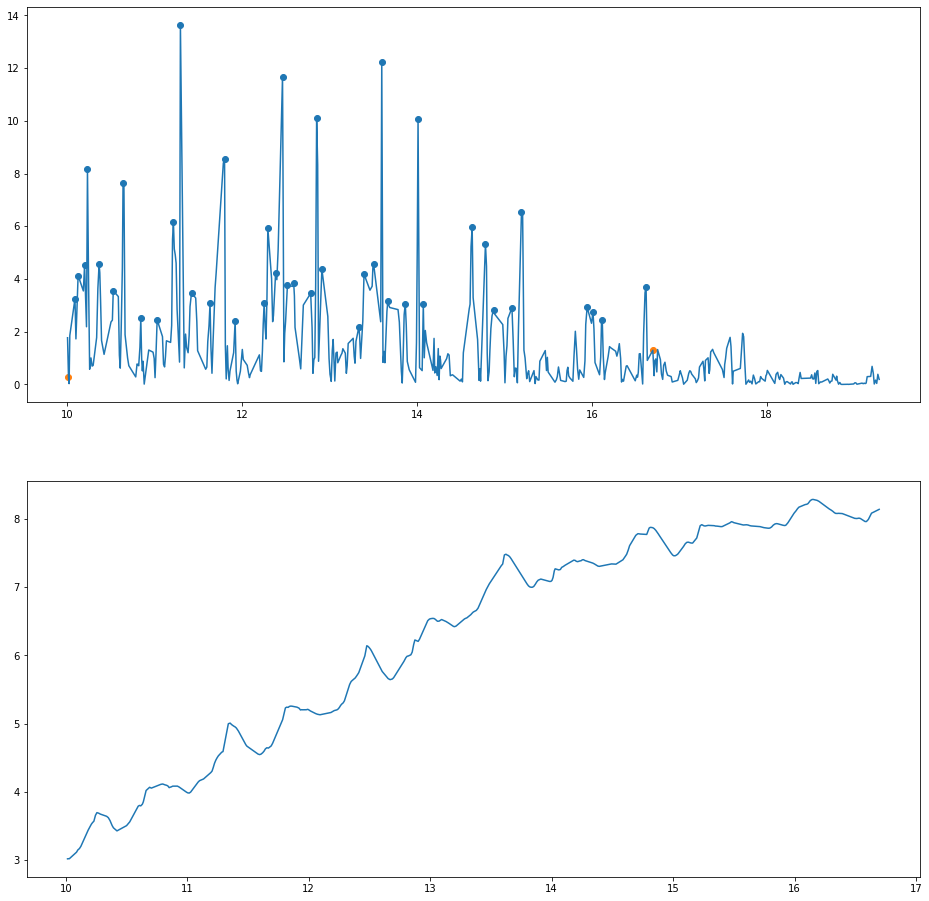

('57', 29, 'Female', 78, 48, False, 6.6835, 41, 0.1638, 301.0176, 6.2712, 41.8843, 71257.5125)
('57', 29, 'Female', 78, 48, False, 6.6835, 41, 0.1638, 301.0176, 6.2712, 41.8843, 71257.5125, 0.5656)
('57', 29, 'Female', 78, 48, False, 6.6835, 41, 0.1638, 301.0176, 6.2712, 41.8843, 71257.5125, 0.5656, -0.0695, 0.0108, -0.1433, 8, 103, 'Diabetes')


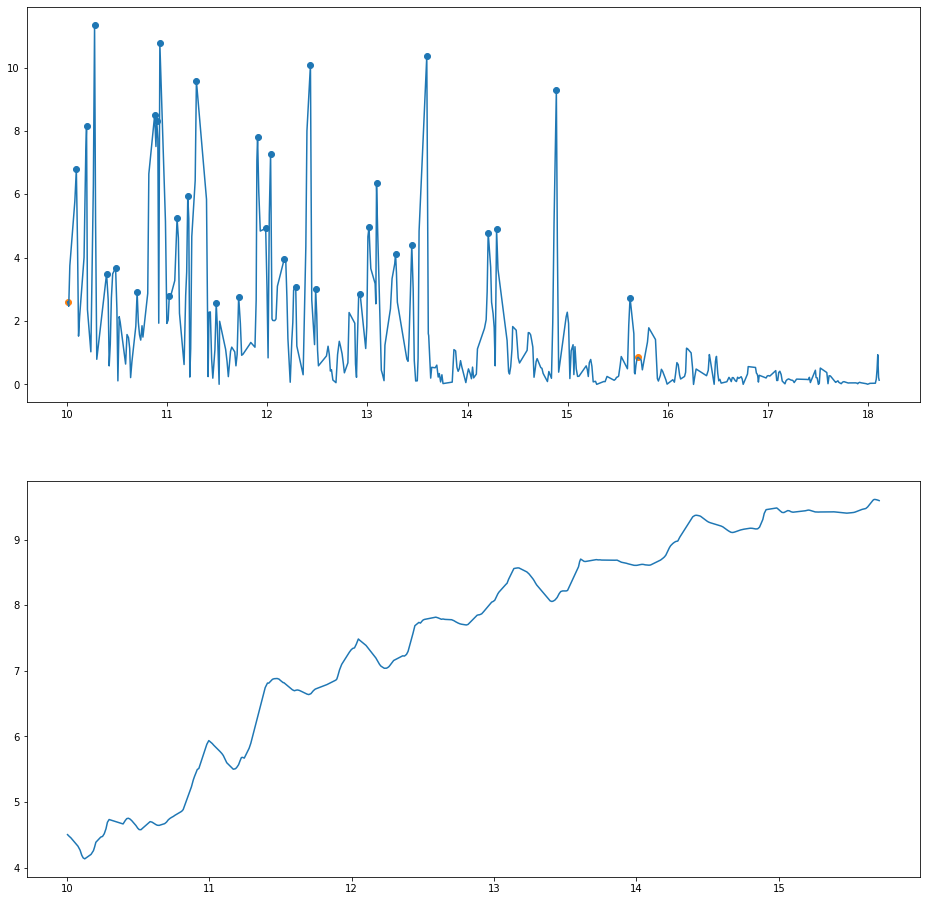

('58', 29, 'Female', 78, 48, False, 5.6995, 32, 0.1789, 361.608, 7.5335, 42.8202, 77841.2549)
('58', 29, 'Female', 78, 48, False, 5.6995, 32, 0.1789, 361.608, 7.5335, 42.8202, 77841.2549, 0.455)
('58', 29, 'Female', 78, 48, False, 5.6995, 32, 0.1789, 361.608, 7.5335, 42.8202, 77841.2549, 0.455, 0.0175, -0.0438, -0.0576, 8, 103, 'Diabetes')


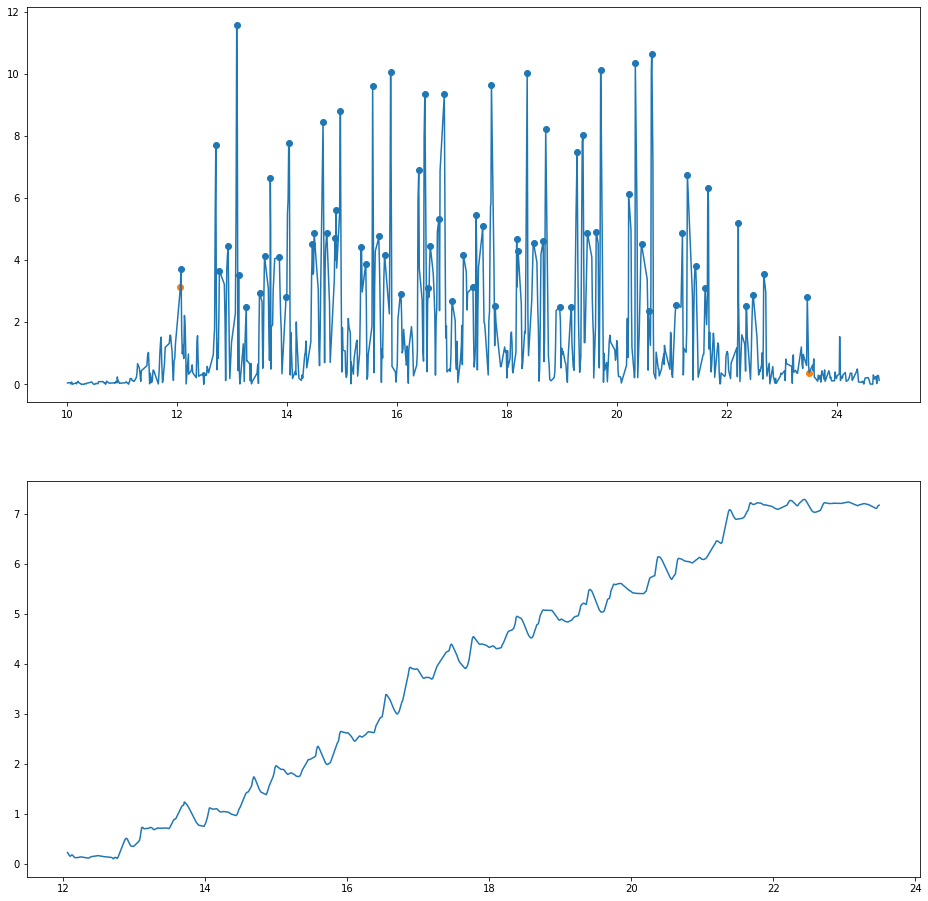

('59', 30, 'Female', 88, 47, False, 11.4335, 69, 0.168, 183.7559, 3.9097, 44.7287, 62056.4082)
('59', 30, 'Female', 88, 47, False, 11.4335, 69, 0.168, 183.7559, 3.9097, 44.7287, 62056.4082, 0.2508)
('59', 30, 'Female', 88, 47, False, 11.4335, 69, 0.168, 183.7559, 3.9097, 44.7287, 62056.4082, 0.2508, -0.0091, -0.0697, -0.0805, 9, 212, 'Osteoporosis ')


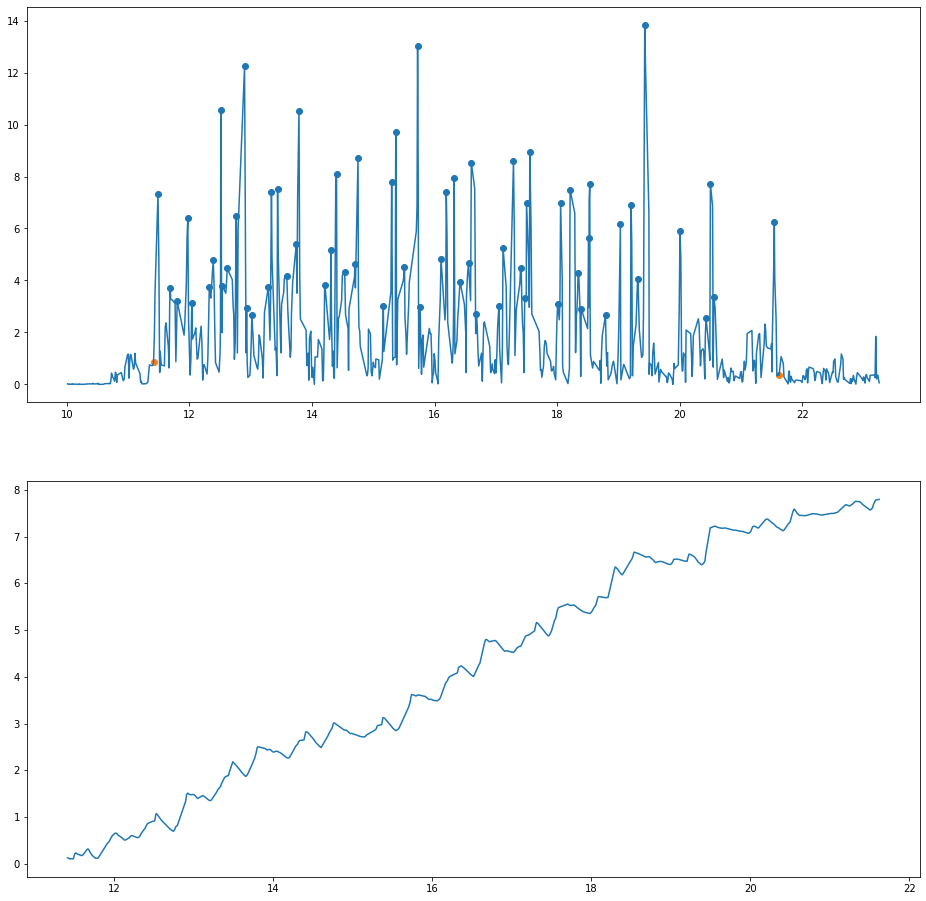

('60', 30, 'Female', 88, 47, False, 10.2085, 63, 0.1627, 199.5808, 4.2464, 43.0582, 67326.0999)
('60', 30, 'Female', 88, 47, False, 10.2085, 63, 0.1627, 199.5808, 4.2464, 43.0582, 67326.0999, 1.5818)
('60', 30, 'Female', 88, 47, False, 10.2085, 63, 0.1627, 199.5808, 4.2464, 43.0582, 67326.0999, 1.5818, -0.1007, 0.0871, -0.1527, 9, 212, 'Osteoporosis ')


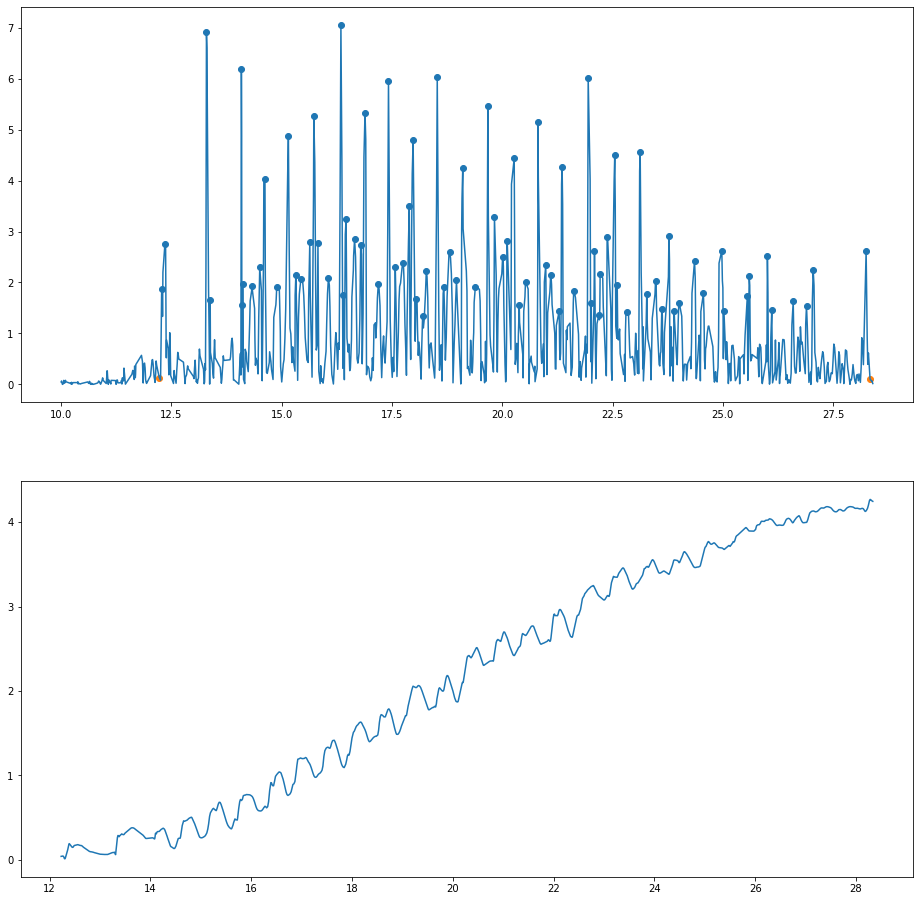

('61', 31, 'Male', 82, 77, False, 16.1065, 80, 0.2024, 166.2584, 2.1592, 34.8001, 33125.3466)
('61', 31, 'Male', 82, 77, False, 16.1065, 80, 0.2024, 166.2584, 2.1592, 34.8001, 33125.3466, 0.2254)
('61', 31, 'Male', 82, 77, False, 16.1065, 80, 0.2024, 166.2584, 2.1592, 34.8001, 33125.3466, 0.2254, -0.0093, -0.0274, -0.041, 6, 213, 'Alzheimer')
('61', 31, 'Male', 82, 77, False, 16.1065, 80, 0.2024, 166.2584, 2.1592, 34.8001, 33125.3466, 0.2254, -0.0093, -0.0274, -0.041, 6, 103, 'Diabetes')


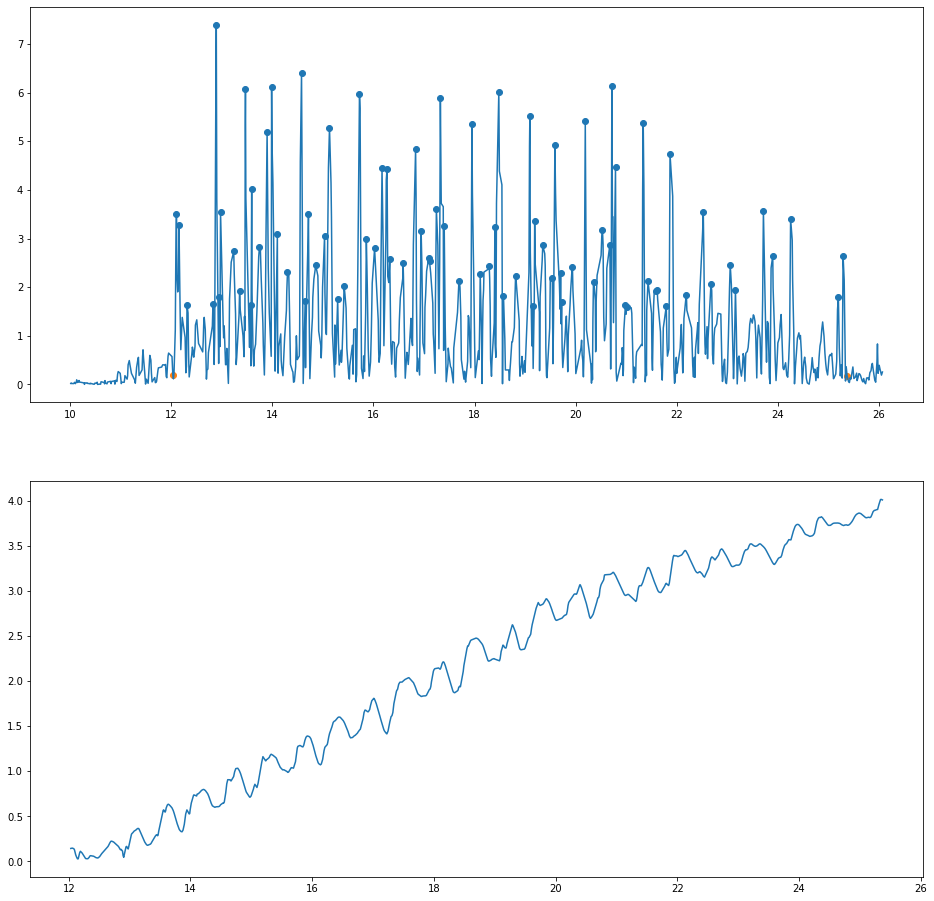

('62', 31, 'Male', 82, 77, False, 13.3365, 80, 0.1674, 163.6558, 2.1254, 28.3417, 32865.1867)
('62', 31, 'Male', 82, 77, False, 13.3365, 80, 0.1674, 163.6558, 2.1254, 28.3417, 32865.1867, 0.2476)
('62', 31, 'Male', 82, 77, False, 13.3365, 80, 0.1674, 163.6558, 2.1254, 28.3417, 32865.1867, 0.2476, -0.0236, -0.0225, -0.0134, 6, 213, 'Alzheimer')
('62', 31, 'Male', 82, 77, False, 13.3365, 80, 0.1674, 163.6558, 2.1254, 28.3417, 32865.1867, 0.2476, -0.0236, -0.0225, -0.0134, 6, 103, 'Diabetes')


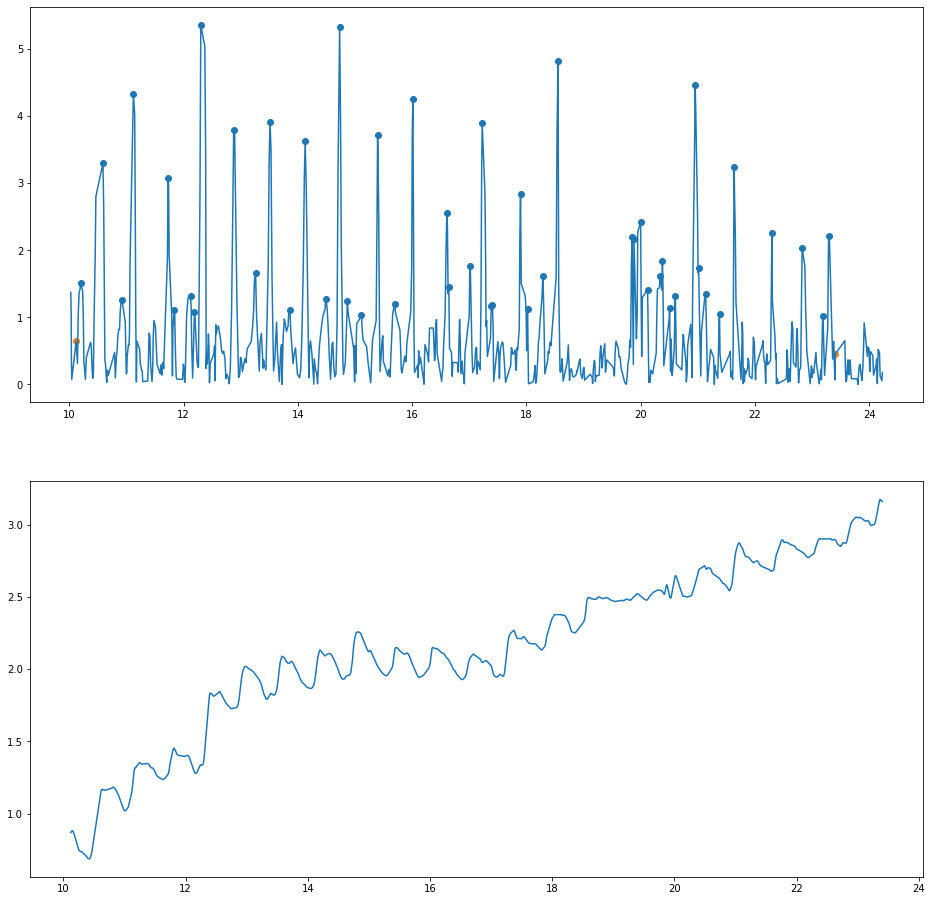

('63', 32, 'Female', 83, 51, False, 13.2825, 48, 0.2792, 109.4103, 2.1453, 28.4928, 11487.5669)
('63', 32, 'Female', 83, 51, False, 13.2825, 48, 0.2792, 109.4103, 2.1453, 28.4928, 11487.5669, 0.711)
('63', 32, 'Female', 83, 51, False, 13.2825, 48, 0.2792, 109.4103, 2.1453, 28.4928, 11487.5669, 0.711, -0.0621, 0.0129, -0.1088, 5, 212, 'Osteoporosis ')


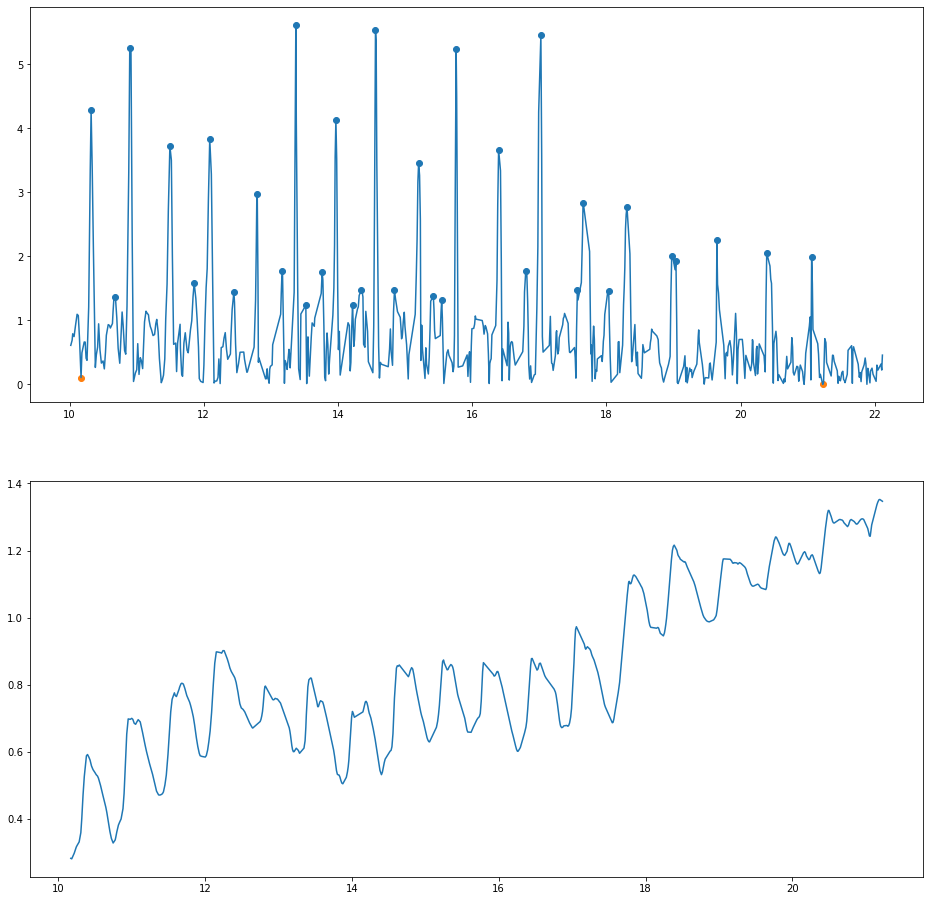

('64', 32, 'Female', 83, 51, False, 11.0545, 33, 0.3361, 43.0287, 0.8437, 9.3425, 3370.1213)
('64', 32, 'Female', 83, 51, False, 11.0545, 33, 0.3361, 43.0287, 0.8437, 9.3425, 3370.1213, 0.1974)
('64', 32, 'Female', 83, 51, False, 11.0545, 33, 0.3361, 43.0287, 0.8437, 9.3425, 3370.1213, 0.1974, -0.014, -0.0085, -0.0634, 5, 212, 'Osteoporosis ')


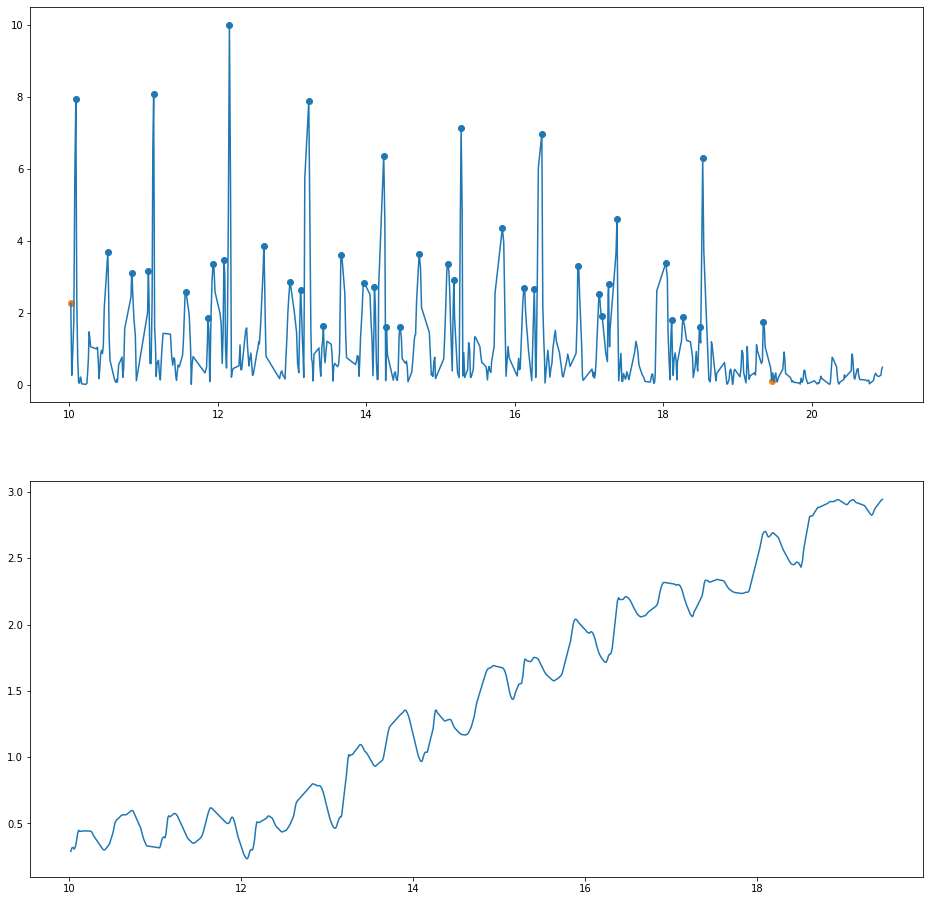

('65', 33, 'Female', 89, 53, False, 9.4385, 40, 0.2379, 76.85, 1.45, 13.7361, 7455.0547)
('65', 33, 'Female', 89, 53, False, 9.4385, 40, 0.2379, 76.85, 1.45, 13.7361, 7455.0547, 0.3634)
('65', 33, 'Female', 89, 53, False, 9.4385, 40, 0.2379, 76.85, 1.45, 13.7361, 7455.0547, 0.3634, -0.0181, -0.0064, -0.0273, 5, 104, 'Arterial Hypertension')
('65', 33, 'Female', 89, 53, False, 9.4385, 40, 0.2379, 76.85, 1.45, 13.7361, 7455.0547, 0.3634, -0.0181, -0.0064, -0.0273, 5, 214, 'Cholesterol;')


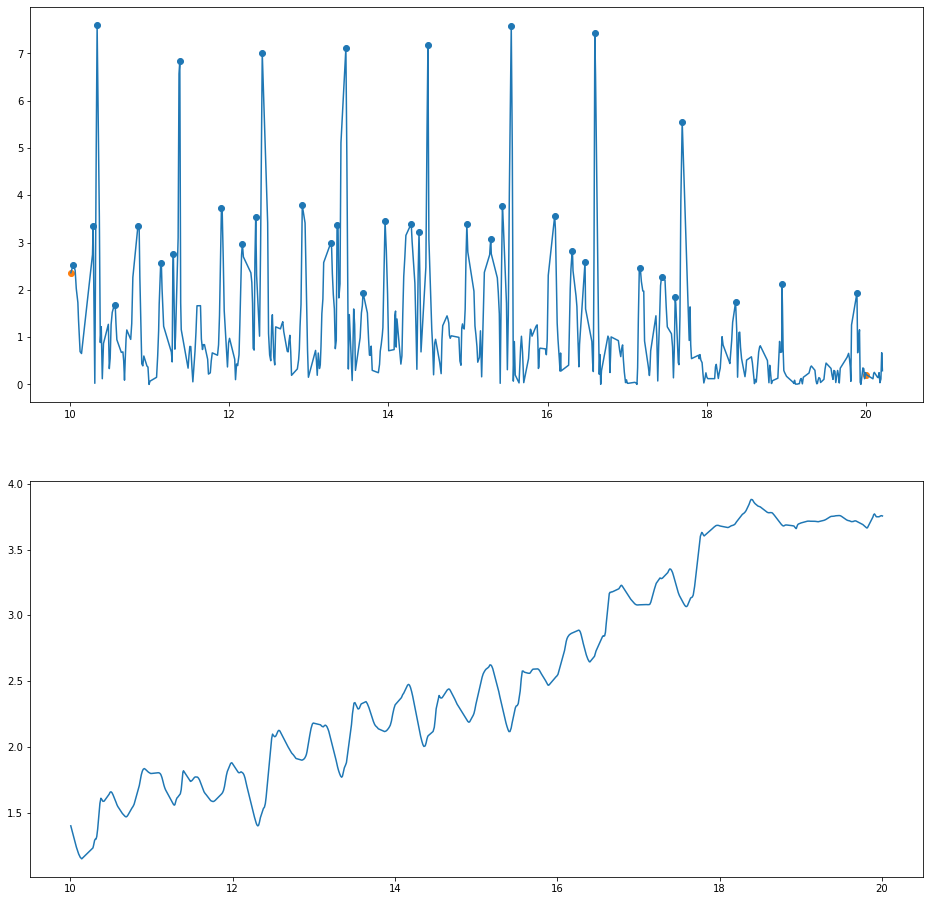

('66', 33, 'Female', 89, 53, False, 9.9965, 36, 0.2819, 136.4644, 2.5748, 25.5907, 16021.6461)
('66', 33, 'Female', 89, 53, False, 9.9965, 36, 0.2819, 136.4644, 2.5748, 25.5907, 16021.6461, 0.1579)
('66', 33, 'Female', 89, 53, False, 9.9965, 36, 0.2819, 136.4644, 2.5748, 25.5907, 16021.6461, 0.1579, 0.0019, -0.0225, -0.0514, 5, 104, 'Arterial Hypertension')
('66', 33, 'Female', 89, 53, False, 9.9965, 36, 0.2819, 136.4644, 2.5748, 25.5907, 16021.6461, 0.1579, 0.0019, -0.0225, -0.0514, 5, 214, 'Cholesterol;')


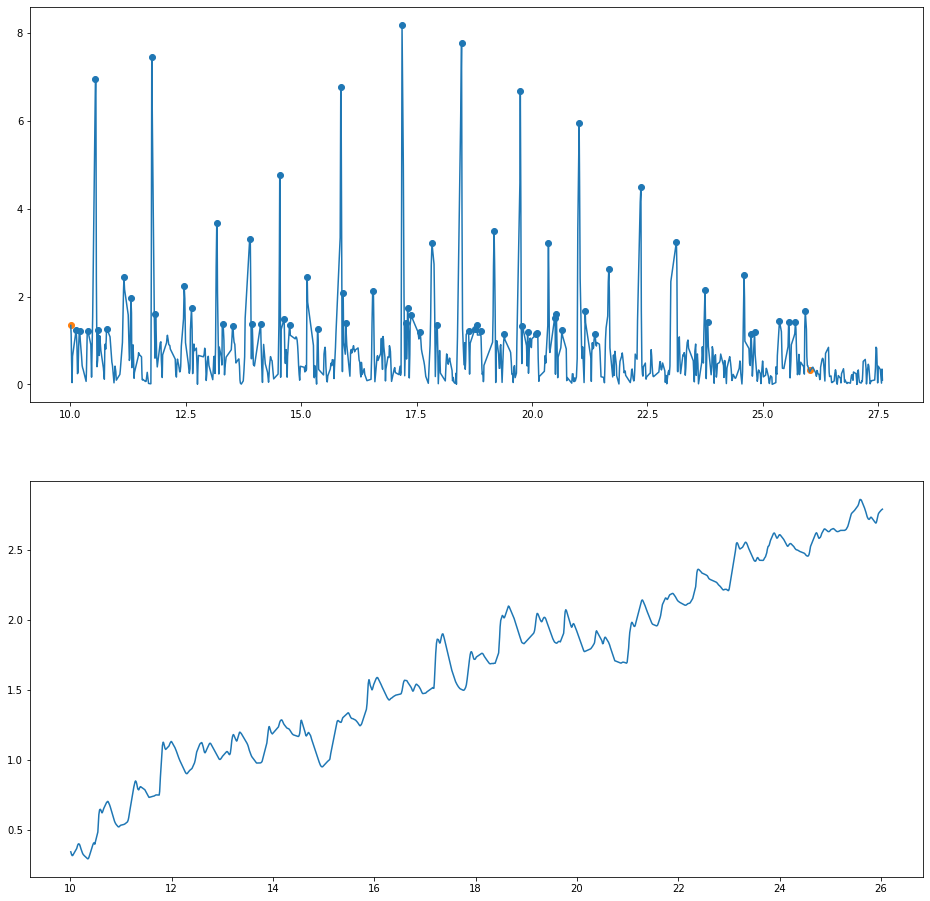

('67', 34, 'Female', 90, 59, True, 16.0205, 65, 0.2472, 98.4887, 1.6693, 26.6847, 14271.1388)
('67', 34, 'Female', 90, 59, True, 16.0205, 65, 0.2472, 98.4887, 1.6693, 26.6847, 14271.1388, 0.4234)
('67', 34, 'Female', 90, 59, True, 16.0205, 65, 0.2472, 98.4887, 1.6693, 26.6847, 14271.1388, 0.4234, -0.0573, 0.0102, -0.0886, 8, 215, 'Hearing Problems')
('67', 34, 'Female', 90, 59, True, 16.0205, 65, 0.2472, 98.4887, 1.6693, 26.6847, 14271.1388, 0.4234, -0.0573, 0.0102, -0.0886, 8, 216, 'Ulcer')
('67', 34, 'Female', 90, 59, True, 16.0205, 65, 0.2472, 98.4887, 1.6693, 26.6847, 14271.1388, 0.4234, -0.0573, 0.0102, -0.0886, 8, 217, 'Arterial Hypertension;')


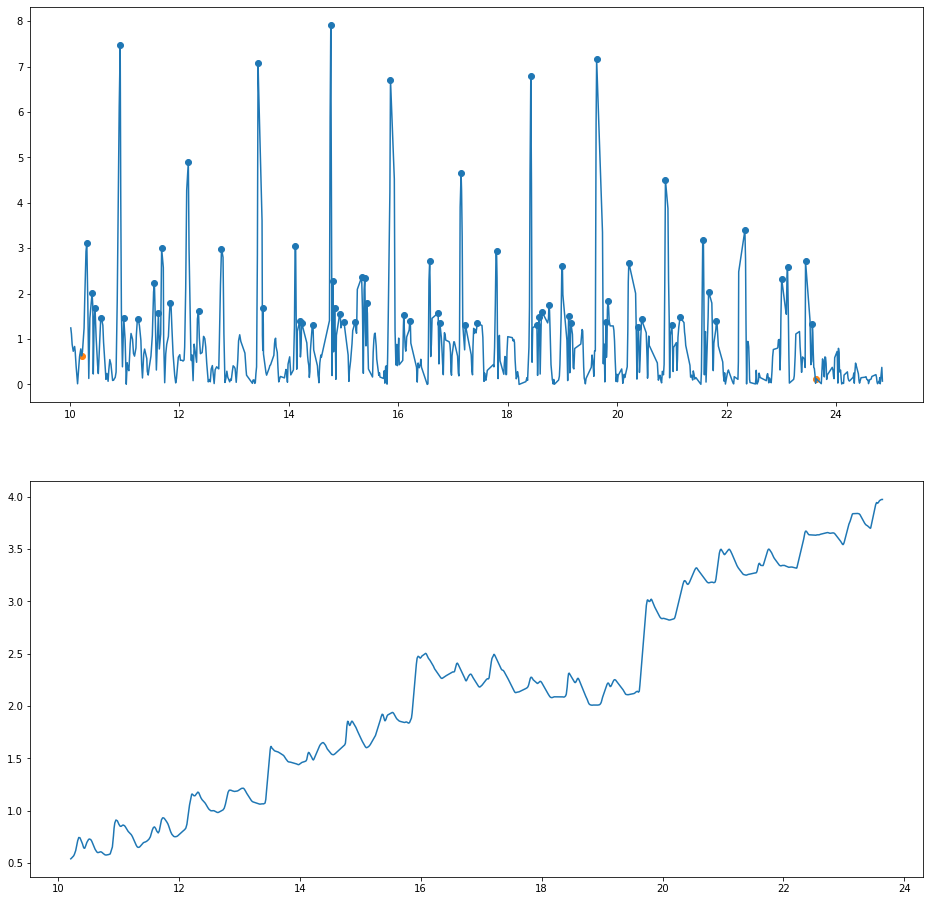

('68', 34, 'Female', 90, 59, True, 13.4235, 64, 0.2109, 127.36330000000001, 2.1587, 28.6918, 15404.1453)
('68', 34, 'Female', 90, 59, True, 13.4235, 64, 0.2109, 127.36330000000001, 2.1587, 28.6918, 15404.1453, 0.2515)
('68', 34, 'Female', 90, 59, True, 13.4235, 64, 0.2109, 127.36330000000001, 2.1587, 28.6918, 15404.1453, 0.2515, -0.0208, -0.0551, -0.0632, 8, 215, 'Hearing Problems')
('68', 34, 'Female', 90, 59, True, 13.4235, 64, 0.2109, 127.36330000000001, 2.1587, 28.6918, 15404.1453, 0.2515, -0.0208, -0.0551, -0.0632, 8, 216, 'Ulcer')
('68', 34, 'Female', 90, 59, True, 13.4235, 64, 0.2109, 127.36330000000001, 2.1587, 28.6918, 15404.1453, 0.2515, -0.0208, -0.0551, -0.0632, 8, 217, 'Arterial Hypertension;')


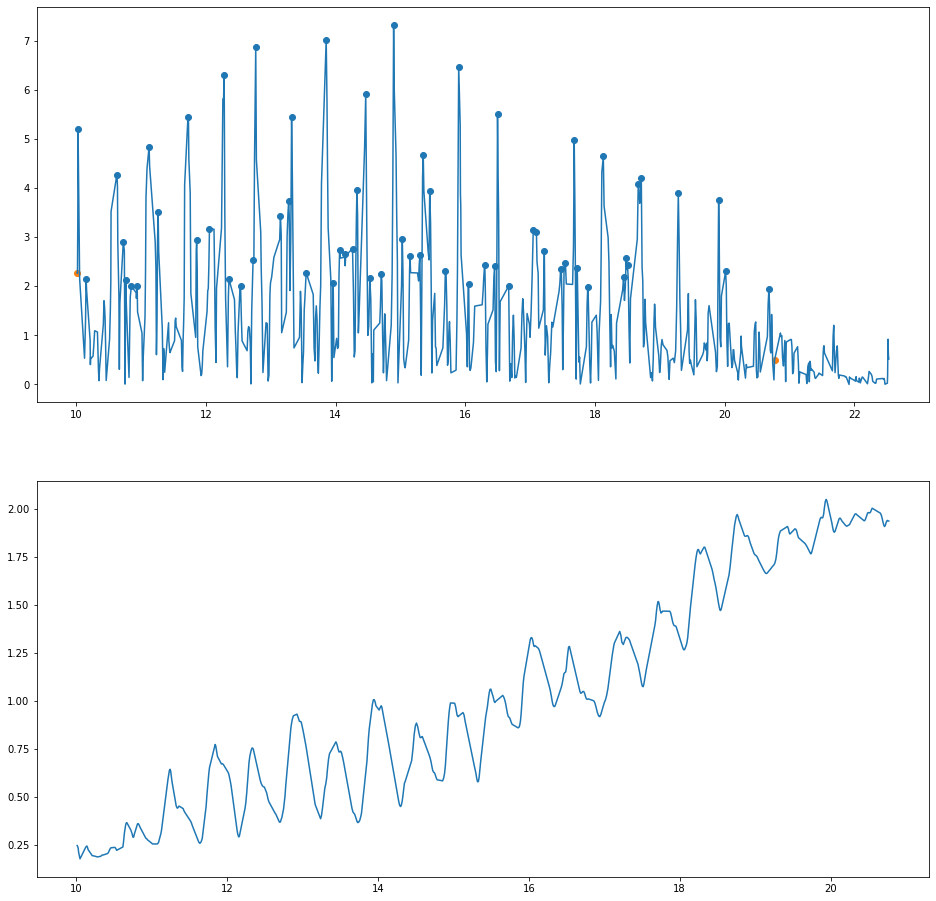

('69', 35, 'Female', 64, 68, False, 10.7595, 61, 0.1781, 69.50280000000001, 1.0221, 11.0118, 6818.0205)
('69', 35, 'Female', 64, 68, False, 10.7595, 61, 0.1781, 69.50280000000001, 1.0221, 11.0118, 6818.0205, 0.7682)
('69', 35, 'Female', 64, 68, False, 10.7595, 61, 0.1781, 69.50280000000001, 1.0221, 11.0118, 6818.0205, 0.7682, -0.0484, 0.033, -0.0717, 6, 104, 'Arterial Hypertension')


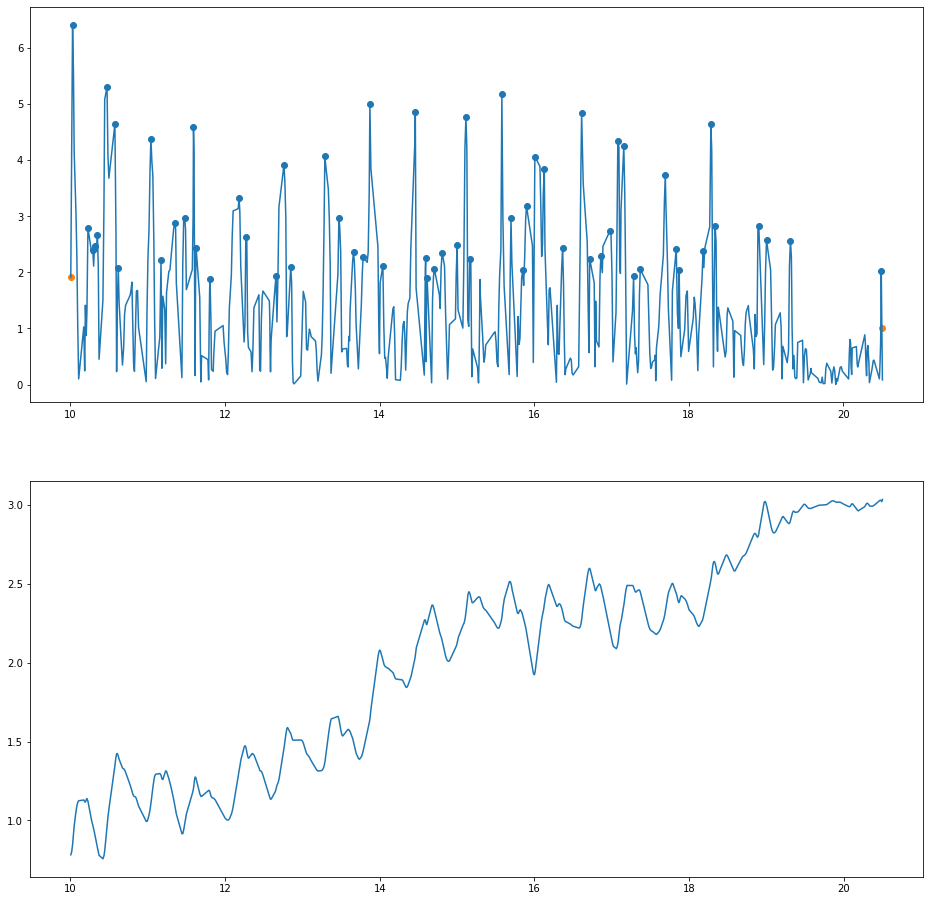

('70', 35, 'Female', 64, 68, False, 10.4975, 59, 0.1809, 137.326, 2.0195, 21.1578, 16507.1297)
('70', 35, 'Female', 64, 68, False, 10.4975, 59, 0.1809, 137.326, 2.0195, 21.1578, 16507.1297, 0.362)
('70', 35, 'Female', 64, 68, False, 10.4975, 59, 0.1809, 137.326, 2.0195, 21.1578, 16507.1297, 0.362, -0.0269, 0.0214, -0.066, 6, 104, 'Arterial Hypertension')


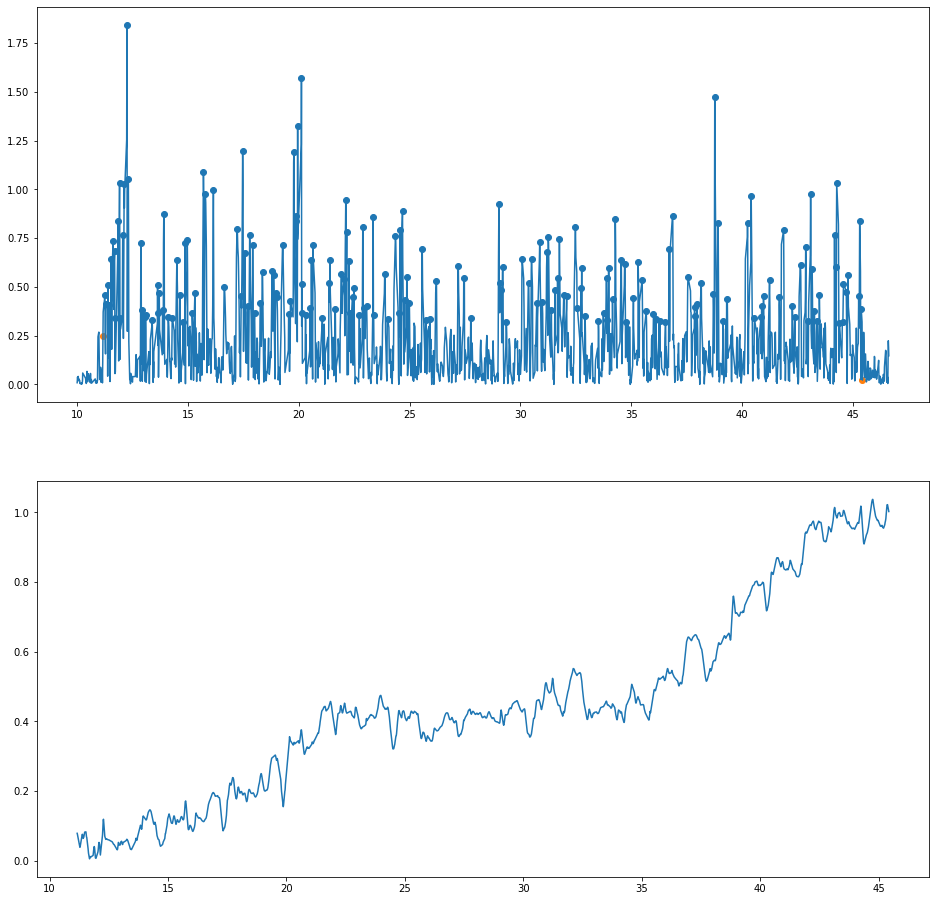

('71', 36, 'Female', 90, 66, True, 34.2675, 185, 0.1859, 29.7066, 0.4501, 15.3643, 1096.5179)
('71', 36, 'Female', 90, 66, True, 34.2675, 185, 0.1859, 29.7066, 0.4501, 15.3643, 1096.5179, 0.3534)
('71', 36, 'Female', 90, 66, True, 34.2675, 185, 0.1859, 29.7066, 0.4501, 15.3643, 1096.5179, 0.3534, 0.0435, -0.0853, 0.0369, 6, 218, 'Spine Problems')
('71', 36, 'Female', 90, 66, True, 34.2675, 185, 0.1859, 29.7066, 0.4501, 15.3643, 1096.5179, 0.3534, 0.0435, -0.0853, 0.0369, 6, 122, 'Osteoporosis')
('71', 36, 'Female', 90, 66, True, 34.2675, 185, 0.1859, 29.7066, 0.4501, 15.3643, 1096.5179, 0.3534, 0.0435, -0.0853, 0.0369, 6, 208, 'Depression')
('71', 36, 'Female', 90, 66, True, 34.2675, 185, 0.1859, 29.7066, 0.4501, 15.3643, 1096.5179, 0.3534, 0.0435, -0.0853, 0.0369, 6, 162, 'Epilepsy')
('71', 36, 'Female', 90, 66, True, 34.2675, 185, 0.1859, 29.7066, 0.4501, 15.3643, 1096.5179, 0.3534, 0.0435, -0.0853, 0.0369, 6, 219, 'Cholestrol;')
('72', 36, 'Female', 90, 66, True, 10.289, 2, '#N/A', 

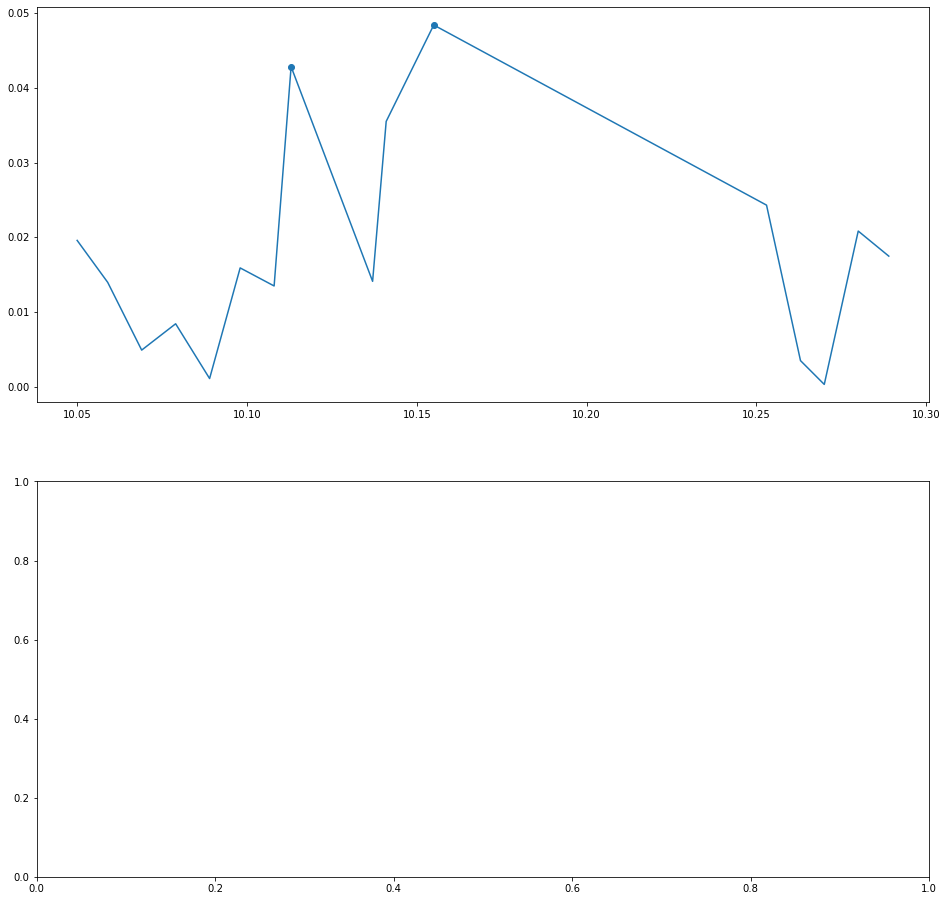

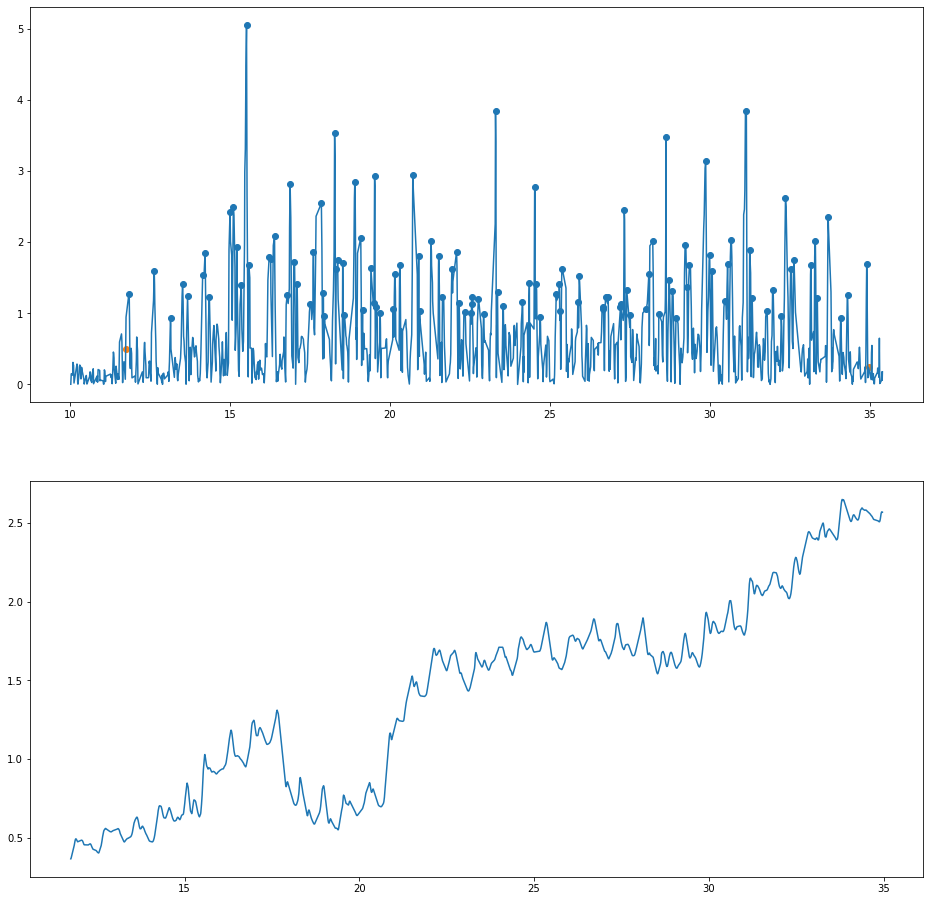

('73', 37, 'Female', 74, 104, False, 23.2285, 113, 0.2065, 146.6712, 1.4103, 32.8038, 22103.5885)
('73', 37, 'Female', 74, 104, False, 23.2285, 113, 0.2065, 146.6712, 1.4103, 32.8038, 22103.5885, 1.8684)
('73', 37, 'Female', 74, 104, False, 23.2285, 113, 0.2065, 146.6712, 1.4103, 32.8038, 22103.5885, 1.8684, 0.1297, -0.2041, 0.1706, 8, 103, 'Diabetes')
('73', 37, 'Female', 74, 104, False, 23.2285, 113, 0.2065, 146.6712, 1.4103, 32.8038, 22103.5885, 1.8684, 0.1297, -0.2041, 0.1706, 8, 179, "Parkinson'S Disease")
('73', 37, 'Female', 74, 104, False, 23.2285, 113, 0.2065, 146.6712, 1.4103, 32.8038, 22103.5885, 1.8684, 0.1297, -0.2041, 0.1706, 8, 218, 'Spine Problems')
('73', 37, 'Female', 74, 104, False, 23.2285, 113, 0.2065, 146.6712, 1.4103, 32.8038, 22103.5885, 1.8684, 0.1297, -0.2041, 0.1706, 8, 220, 'Cholesterol')
('73', 37, 'Female', 74, 104, False, 23.2285, 113, 0.2065, 146.6712, 1.4103, 32.8038, 22103.5885, 1.8684, 0.1297, -0.2041, 0.1706, 8, 142, 'Heart Failure')
('73', 37, 'Fema

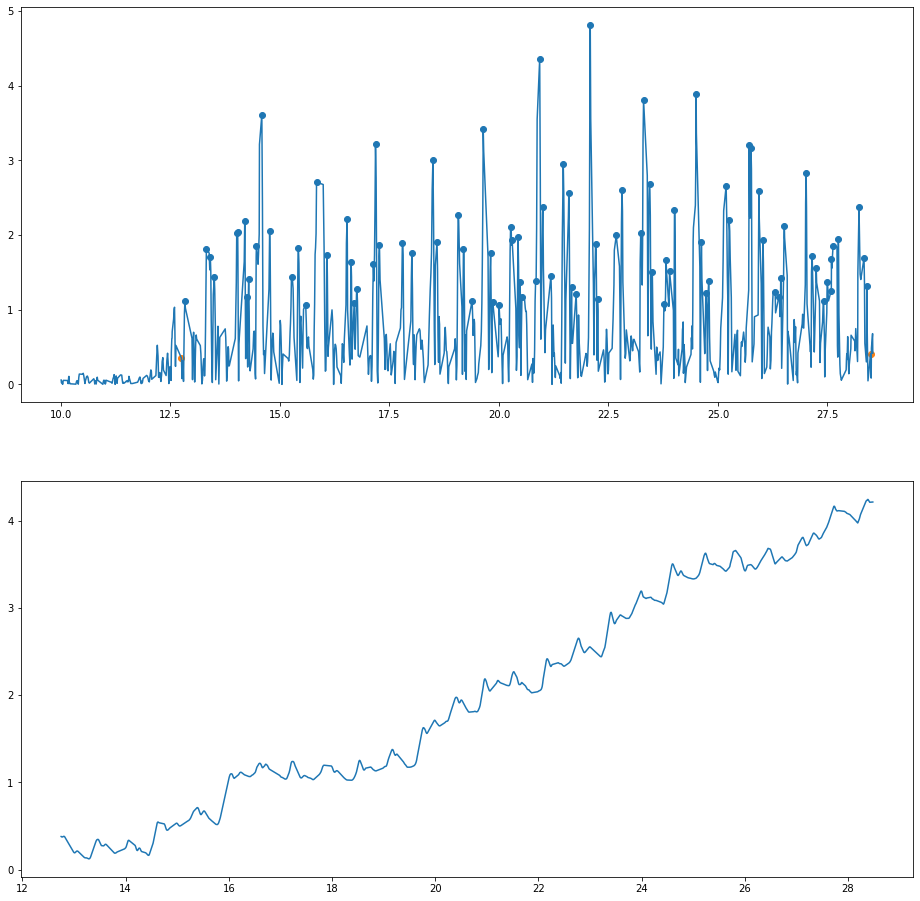

('74', 37, 'Female', 74, 104, False, 15.7325, 87, 0.1815, 206.9288, 1.9897, 31.2668, 25281.8285)
('74', 37, 'Female', 74, 104, False, 15.7325, 87, 0.1815, 206.9288, 1.9897, 31.2668, 25281.8285, 1.9282)
('74', 37, 'Female', 74, 104, False, 15.7325, 87, 0.1815, 206.9288, 1.9897, 31.2668, 25281.8285, 1.9282, -0.0951, 0.2422, -0.1868, 8, 103, 'Diabetes')
('74', 37, 'Female', 74, 104, False, 15.7325, 87, 0.1815, 206.9288, 1.9897, 31.2668, 25281.8285, 1.9282, -0.0951, 0.2422, -0.1868, 8, 179, "Parkinson'S Disease")
('74', 37, 'Female', 74, 104, False, 15.7325, 87, 0.1815, 206.9288, 1.9897, 31.2668, 25281.8285, 1.9282, -0.0951, 0.2422, -0.1868, 8, 218, 'Spine Problems')
('74', 37, 'Female', 74, 104, False, 15.7325, 87, 0.1815, 206.9288, 1.9897, 31.2668, 25281.8285, 1.9282, -0.0951, 0.2422, -0.1868, 8, 220, 'Cholesterol')
('74', 37, 'Female', 74, 104, False, 15.7325, 87, 0.1815, 206.9288, 1.9897, 31.2668, 25281.8285, 1.9282, -0.0951, 0.2422, -0.1868, 8, 142, 'Heart Failure')
('74', 37, 'Female

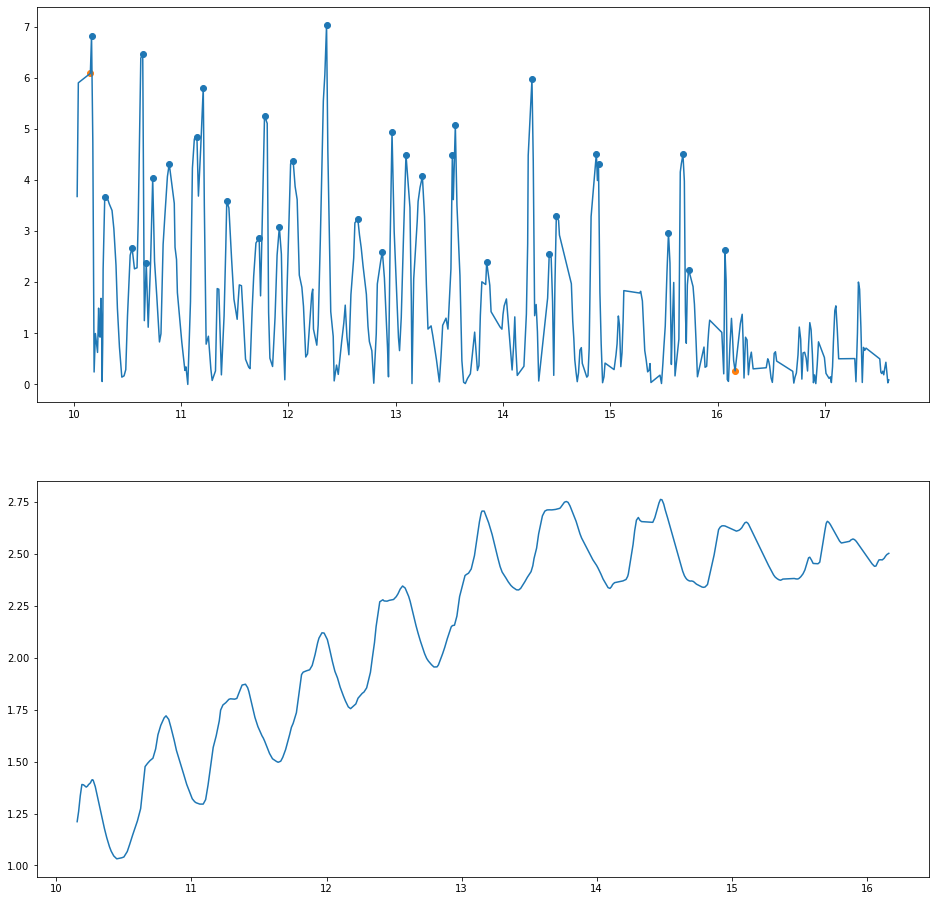

('75', 38, 'Male', 69, 90, True, 6.0085, 32, 0.1909, 190.91700000000003, 2.1213, 12.9593, 20450.9075)
('75', 38, 'Male', 69, 90, True, 6.0085, 32, 0.1909, 190.91700000000003, 2.1213, 12.9593, 20450.9075, 0.5891)
('75', 38, 'Male', 69, 90, True, 6.0085, 32, 0.1909, 190.91700000000003, 2.1213, 12.9593, 20450.9075, 0.5891, -0.0173, -0.0066, -0.0515, 8, 208, 'Depression')


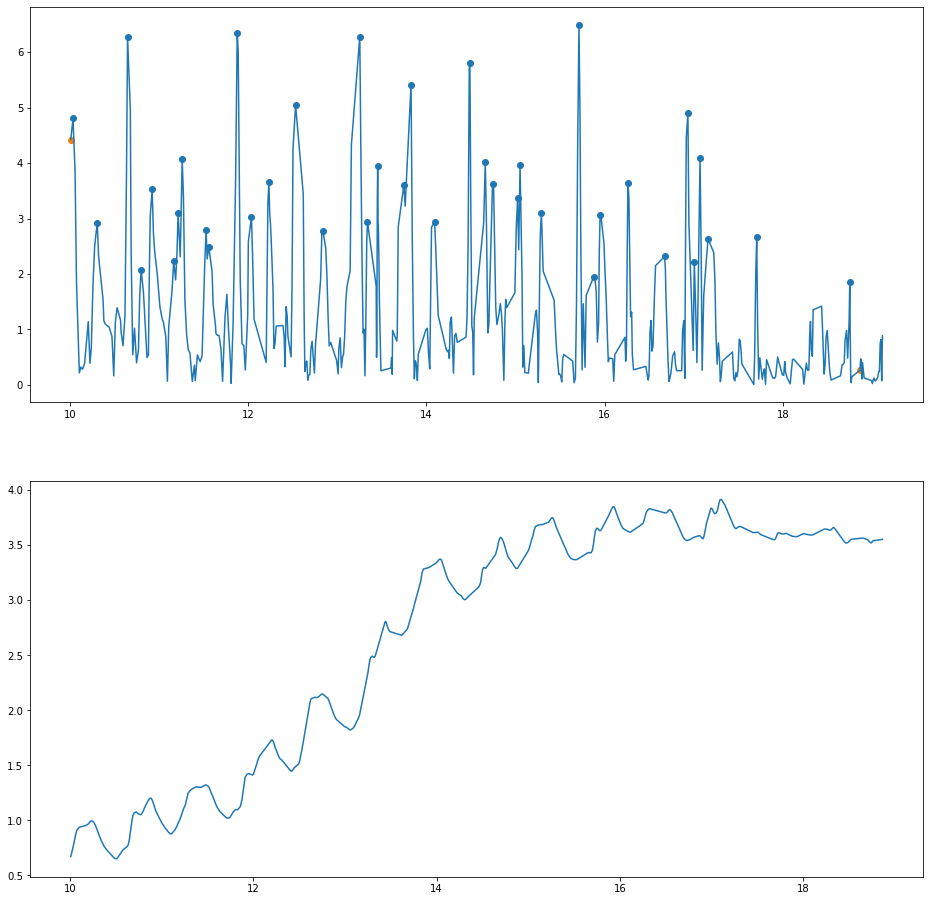

('76', 38, 'Male', 69, 90, True, 8.8525, 38, 0.236, 242.24400000000003, 2.6916, 23.6904, 24017.1935)
('76', 38, 'Male', 69, 90, True, 8.8525, 38, 0.236, 242.24400000000003, 2.6916, 23.6904, 24017.1935, 0.1932)
('76', 38, 'Male', 69, 90, True, 8.8525, 38, 0.236, 242.24400000000003, 2.6916, 23.6904, 24017.1935, 0.1932, 0.0024, -0.0259, -0.064, 8, 208, 'Depression')


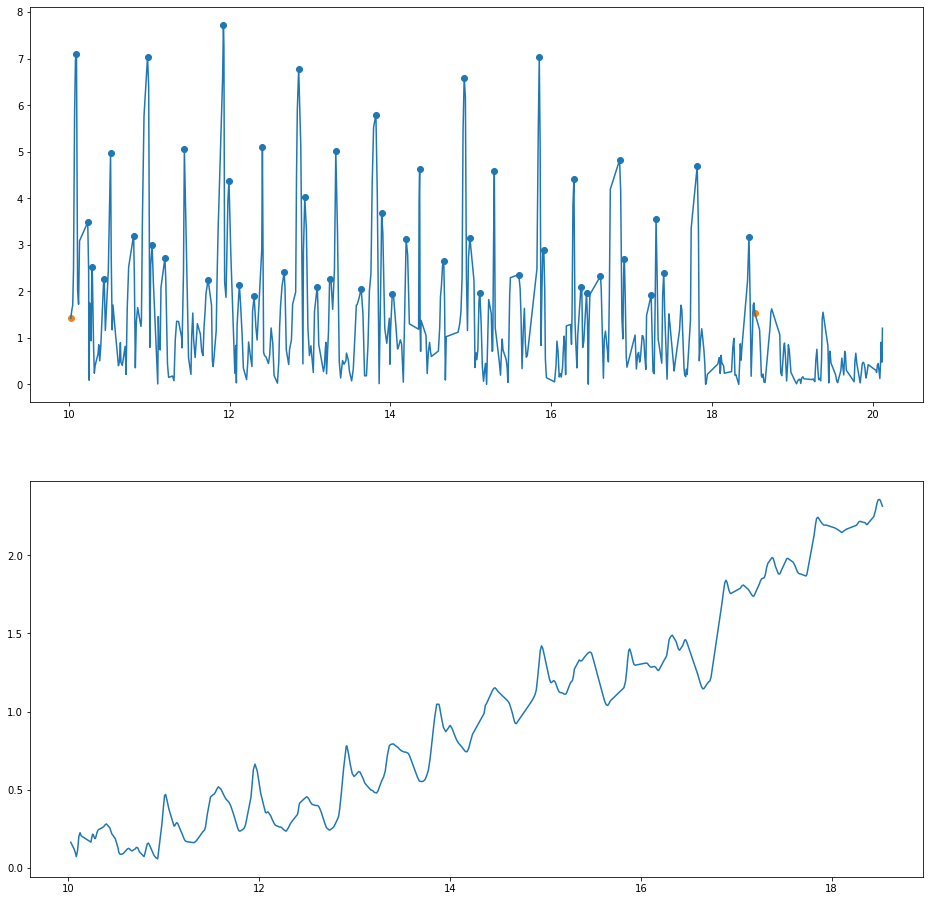

('77', 39, 'Female', 77, 60, True, 8.5095, 47, 0.1824, 58.77, 0.9795, 8.272, 5392.3865)
('77', 39, 'Female', 77, 60, True, 8.5095, 47, 0.1824, 58.77, 0.9795, 8.272, 5392.3865, 0.2385)
('77', 39, 'Female', 77, 60, True, 8.5095, 47, 0.1824, 58.77, 0.9795, 8.272, 5392.3865, 0.2385, -0.0673, -0.0208, -0.0918, 8, 221, 'Hearing')
('77', 39, 'Female', 77, 60, True, 8.5095, 47, 0.1824, 58.77, 0.9795, 8.272, 5392.3865, 0.2385, -0.0673, -0.0208, -0.0918, 8, 104, 'Arterial Hypertension')


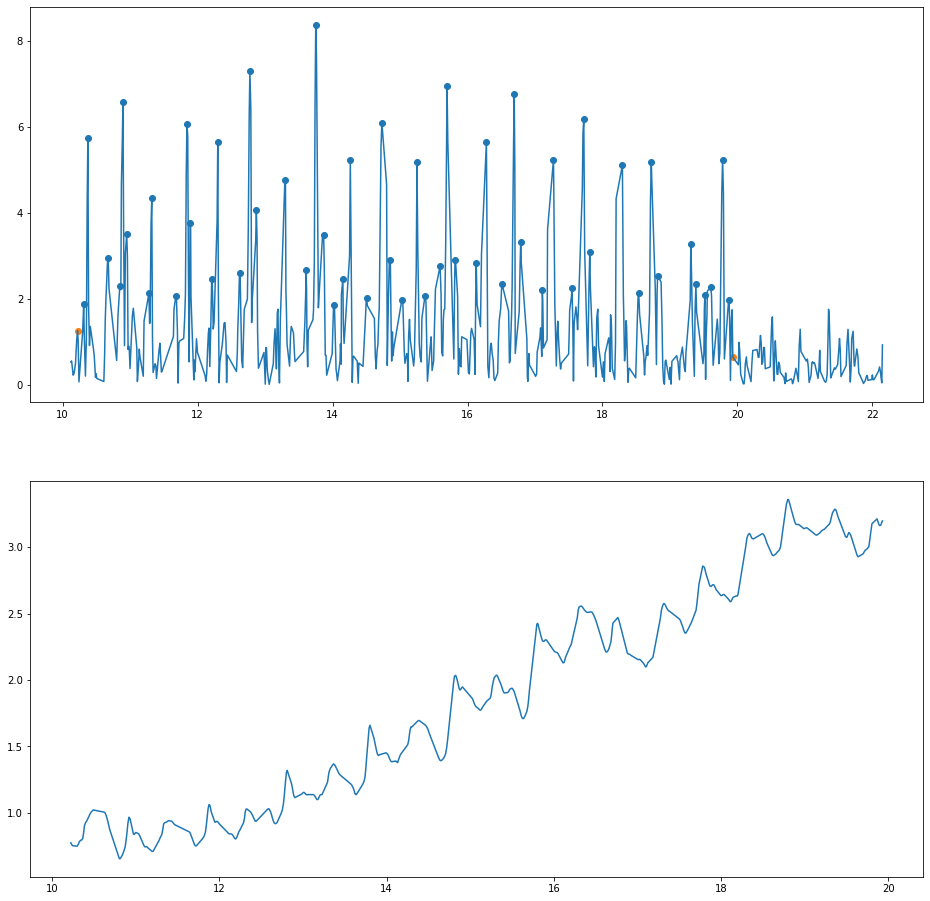

('78', 39, 'Female', 77, 60, True, 9.7105, 52, 0.188, 111.82199999999999, 1.8637, 18.067, 14460.3965)
('78', 39, 'Female', 77, 60, True, 9.7105, 52, 0.188, 111.82199999999999, 1.8637, 18.067, 14460.3965, 0.1349)
('78', 39, 'Female', 77, 60, True, 9.7105, 52, 0.188, 111.82199999999999, 1.8637, 18.067, 14460.3965, 0.1349, -0.0101, -0.004, -0.0514, 8, 221, 'Hearing')
('78', 39, 'Female', 77, 60, True, 9.7105, 52, 0.188, 111.82199999999999, 1.8637, 18.067, 14460.3965, 0.1349, -0.0101, -0.004, -0.0514, 8, 104, 'Arterial Hypertension')


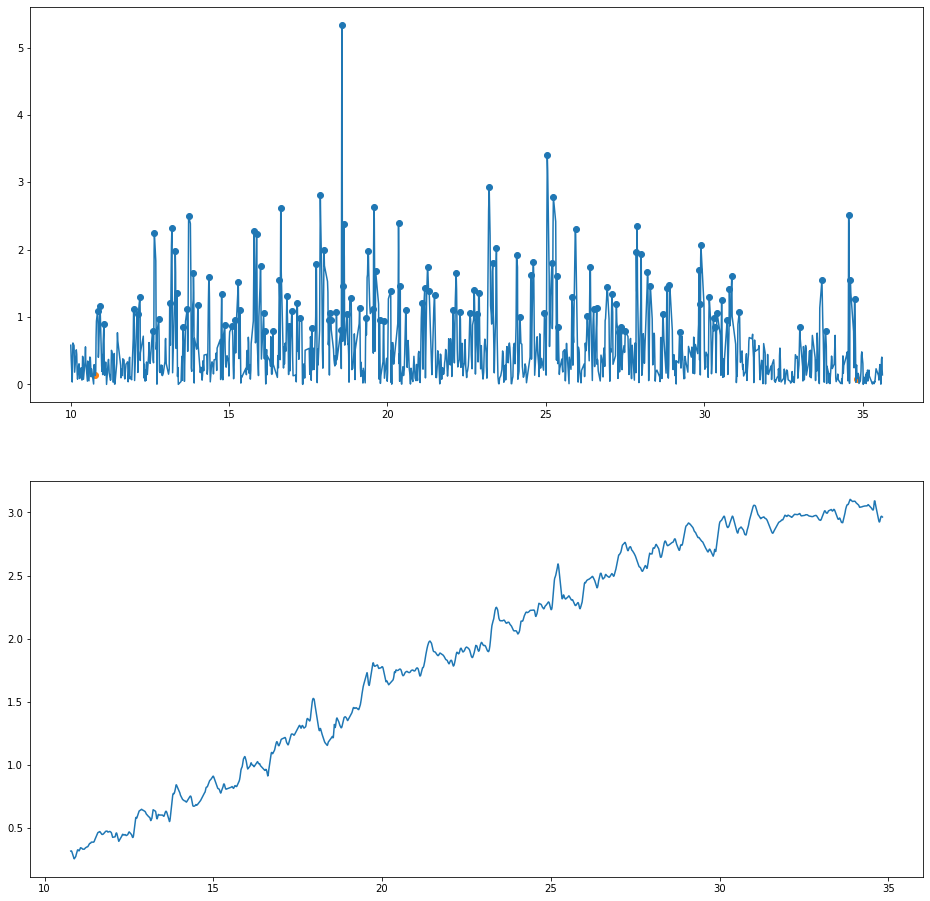

('79', 40, 'Female', 90, 60, True, 24.0475, 128, 0.1887, 113.74199999999999, 1.8957, 45.5559, 12180.5645)
('79', 40, 'Female', 90, 60, True, 24.0475, 128, 0.1887, 113.74199999999999, 1.8957, 45.5559, 12180.5645, 0.3051)
('79', 40, 'Female', 90, 60, True, 24.0475, 128, 0.1887, 113.74199999999999, 1.8957, 45.5559, 12180.5645, 0.3051, -0.0222, 0.0349, -0.0685, 6, 212, 'Osteoporosis ')


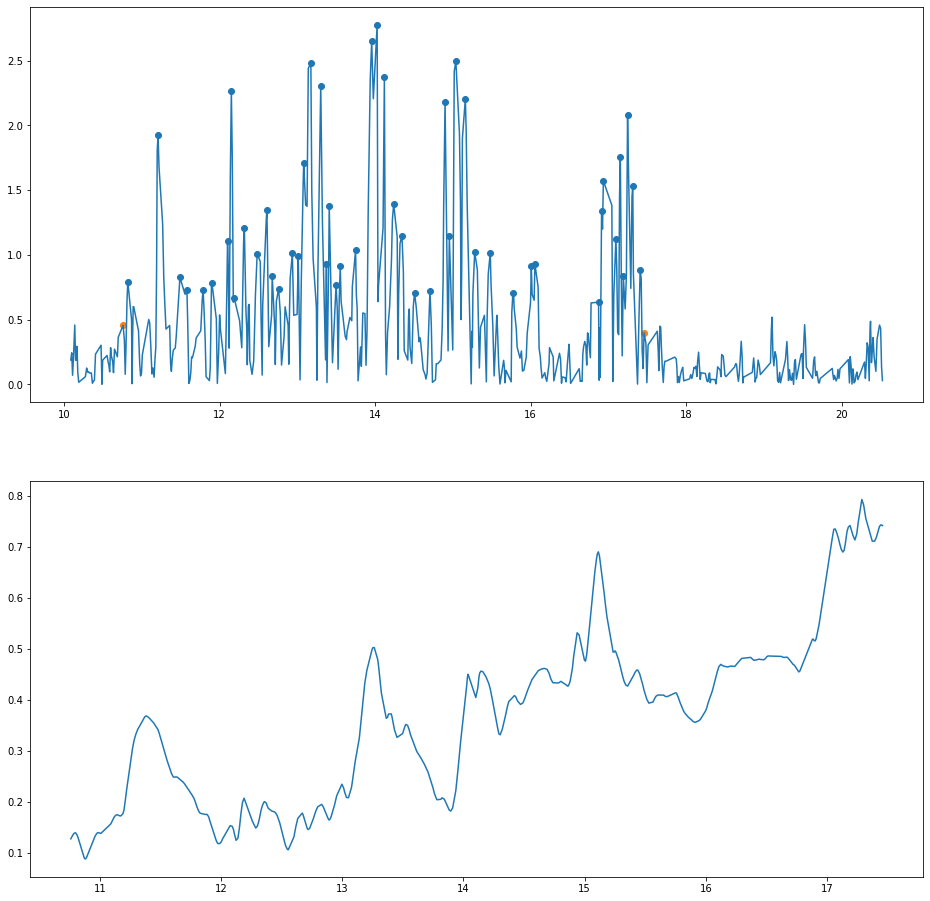

('80', 40, 'Female', 90, 60, True, 6.6975, 49, 0.1377, 21.804, 0.3634, 2.4284, 592.5785)
('80', 40, 'Female', 90, 60, True, 6.6975, 49, 0.1377, 21.804, 0.3634, 2.4284, 592.5785, 0.8158)
('80', 40, 'Female', 90, 60, True, 6.6975, 49, 0.1377, 21.804, 0.3634, 2.4284, 592.5785, 0.8158, 0.028, -0.0619, 0.0418, 6, 212, 'Osteoporosis ')


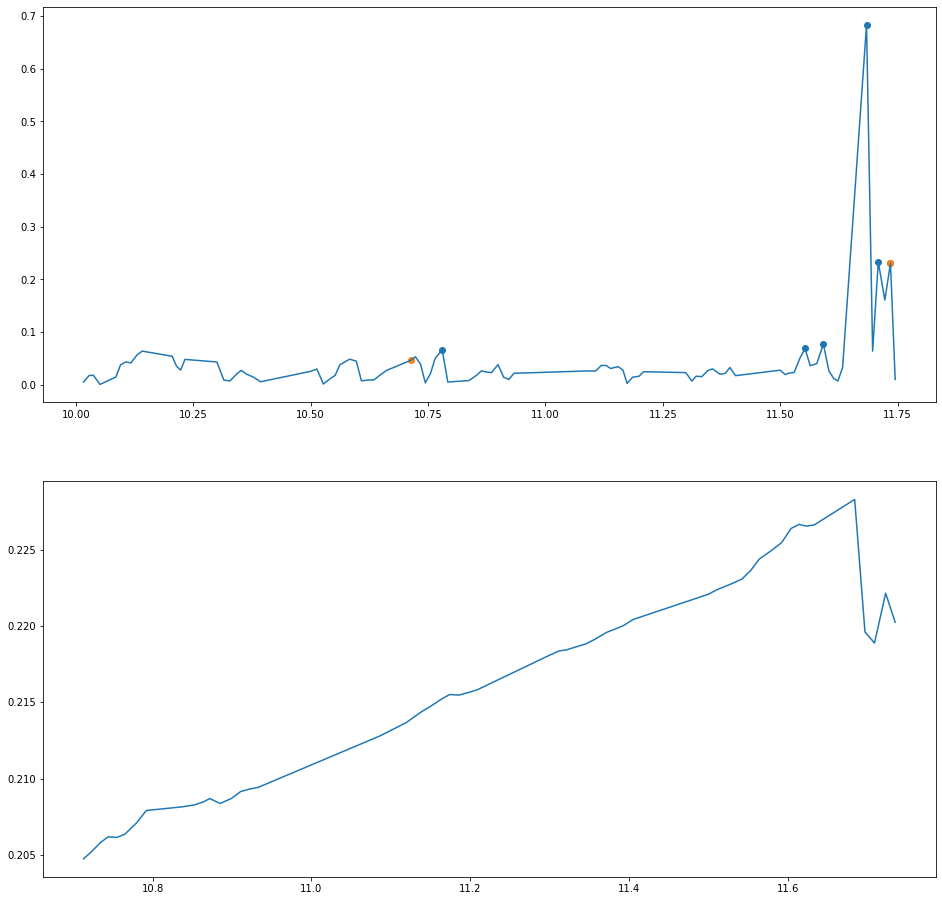

('81', 41, 'Female', 75, 60, False, 1.0225, 6, 0.1915, 13.002, 0.2167, 0.2314, 5.5325)
('81', 41, 'Female', 75, 60, False, 1.0225, 6, 0.1915, 13.002, 0.2167, 0.2314, 5.5325, 0.1201)
('81', 41, 'Female', 75, 60, False, 1.0225, 6, 0.1915, 13.002, 0.2167, 0.2314, 5.5325, 0.1201, 0.0017, 0.001, 0.002, 6, 104, 'Arterial Hypertension')


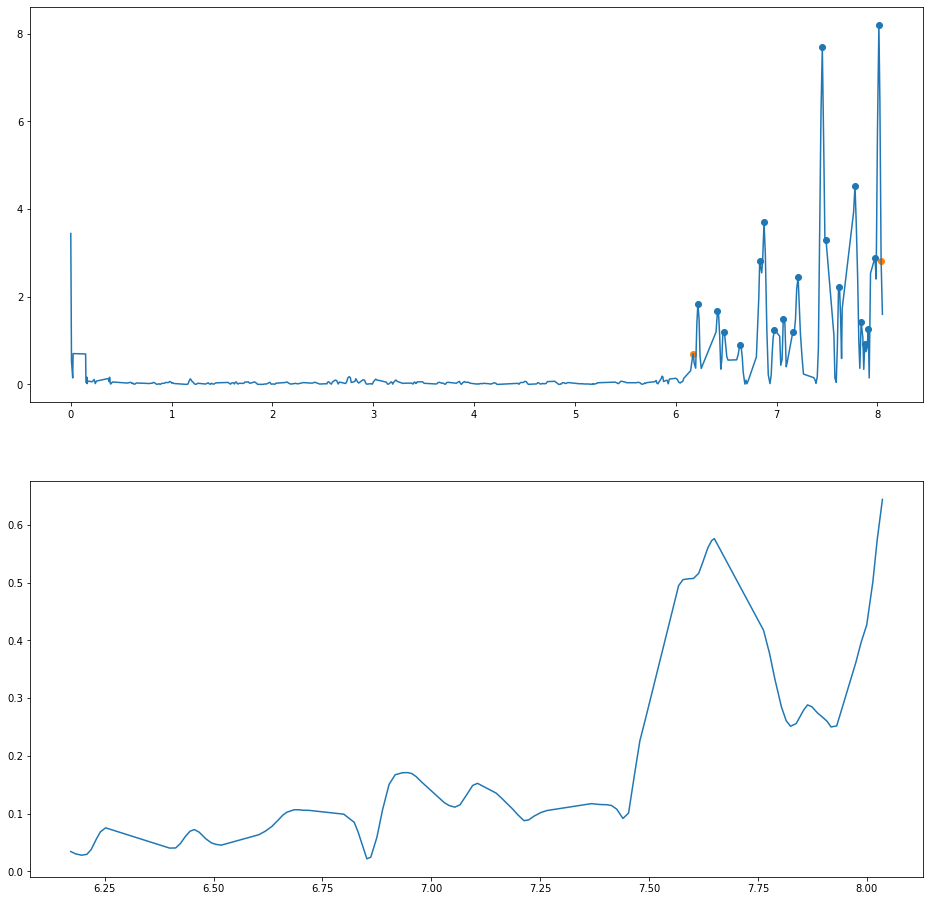

('82', 41, 'Female', 75, 60, False, 1.8645, 19, 0.1002, 11.322000000000001, 0.1887, 0.3427, 841.5845)
('82', 41, 'Female', 75, 60, False, 1.8645, 19, 0.1002, 11.322000000000001, 0.1887, 0.3427, 841.5845, 0.0243)
('82', 41, 'Female', 75, 60, False, 1.8645, 19, 0.1002, 11.322000000000001, 0.1887, 0.3427, 841.5845, 0.0243, -0.0056, 0.016, -0.0135, 6, 104, 'Arterial Hypertension')


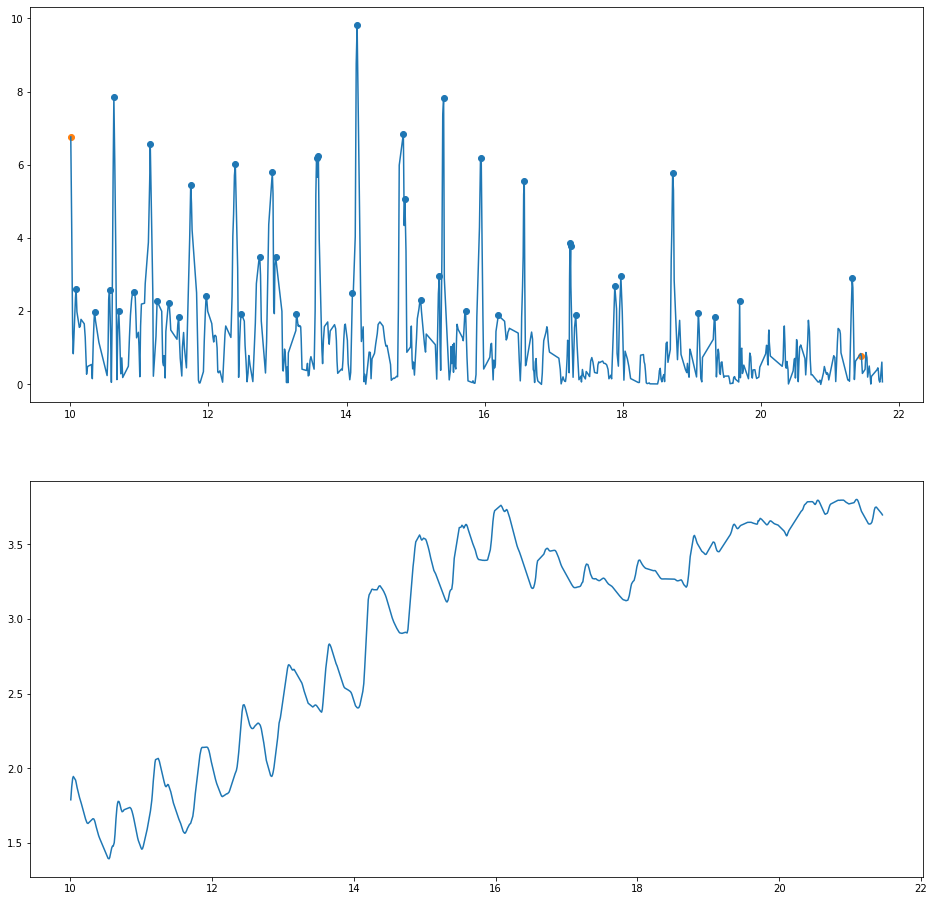

('83', 42, 'Female', 82, 77, False, 11.4515, 41, 0.2815, 226.3492, 2.9396, 33.6664, 29879.6811)
('83', 42, 'Female', 82, 77, False, 11.4515, 41, 0.2815, 226.3492, 2.9396, 33.6664, 29879.6811, 0.1889)
('83', 42, 'Female', 82, 77, False, 11.4515, 41, 0.2815, 226.3492, 2.9396, 33.6664, 29879.6811, 0.1889, 0.0086, 0.0382, -0.0154, 9, 222, 'Anxiety')
('83', 42, 'Female', 82, 77, False, 11.4515, 41, 0.2815, 226.3492, 2.9396, 33.6664, 29879.6811, 0.1889, 0.0086, 0.0382, -0.0154, 9, 223, 'Rhinoconjunctivitis')
('83', 42, 'Female', 82, 77, False, 11.4515, 41, 0.2815, 226.3492, 2.9396, 33.6664, 29879.6811, 0.1889, 0.0086, 0.0382, -0.0154, 9, 148, 'Allergic Rhinitis')
('83', 42, 'Female', 82, 77, False, 11.4515, 41, 0.2815, 226.3492, 2.9396, 33.6664, 29879.6811, 0.1889, 0.0086, 0.0382, -0.0154, 9, 142, 'Heart Failure')
('83', 42, 'Female', 82, 77, False, 11.4515, 41, 0.2815, 226.3492, 2.9396, 33.6664, 29879.6811, 0.1889, 0.0086, 0.0382, -0.0154, 9, 224, 'Arterial Fiber')
('83', 42, 'Female', 82, 

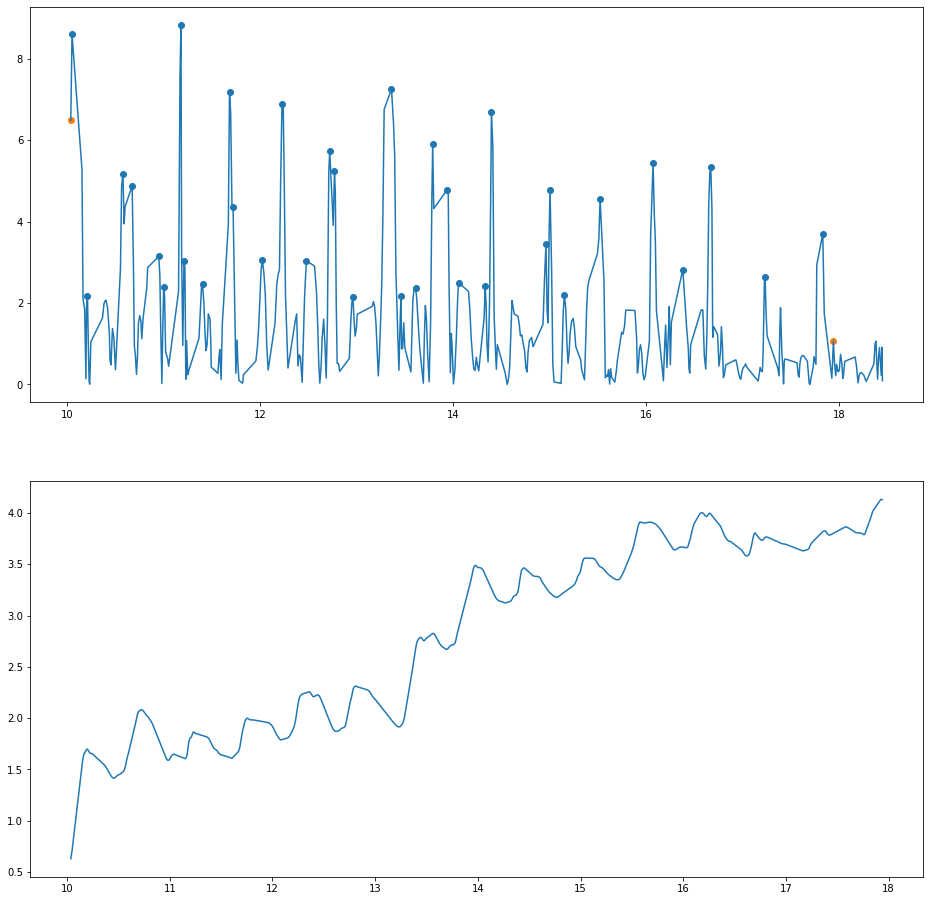

('84', 42, 'Female', 82, 77, False, 7.9045, 34, 0.2363, 217.38639999999998, 2.8232, 22.2159, 33683.5119)
('84', 42, 'Female', 82, 77, False, 7.9045, 34, 0.2363, 217.38639999999998, 2.8232, 22.2159, 33683.5119, 0.1798)
('84', 42, 'Female', 82, 77, False, 7.9045, 34, 0.2363, 217.38639999999998, 2.8232, 22.2159, 33683.5119, 0.1798, -0.0199, -0.0126, -0.0283, 9, 222, 'Anxiety')
('84', 42, 'Female', 82, 77, False, 7.9045, 34, 0.2363, 217.38639999999998, 2.8232, 22.2159, 33683.5119, 0.1798, -0.0199, -0.0126, -0.0283, 9, 223, 'Rhinoconjunctivitis')
('84', 42, 'Female', 82, 77, False, 7.9045, 34, 0.2363, 217.38639999999998, 2.8232, 22.2159, 33683.5119, 0.1798, -0.0199, -0.0126, -0.0283, 9, 148, 'Allergic Rhinitis')
('84', 42, 'Female', 82, 77, False, 7.9045, 34, 0.2363, 217.38639999999998, 2.8232, 22.2159, 33683.5119, 0.1798, -0.0199, -0.0126, -0.0283, 9, 142, 'Heart Failure')
('84', 42, 'Female', 82, 77, False, 7.9045, 34, 0.2363, 217.38639999999998, 2.8232, 22.2159, 33683.5119, 0.1798, -0.01

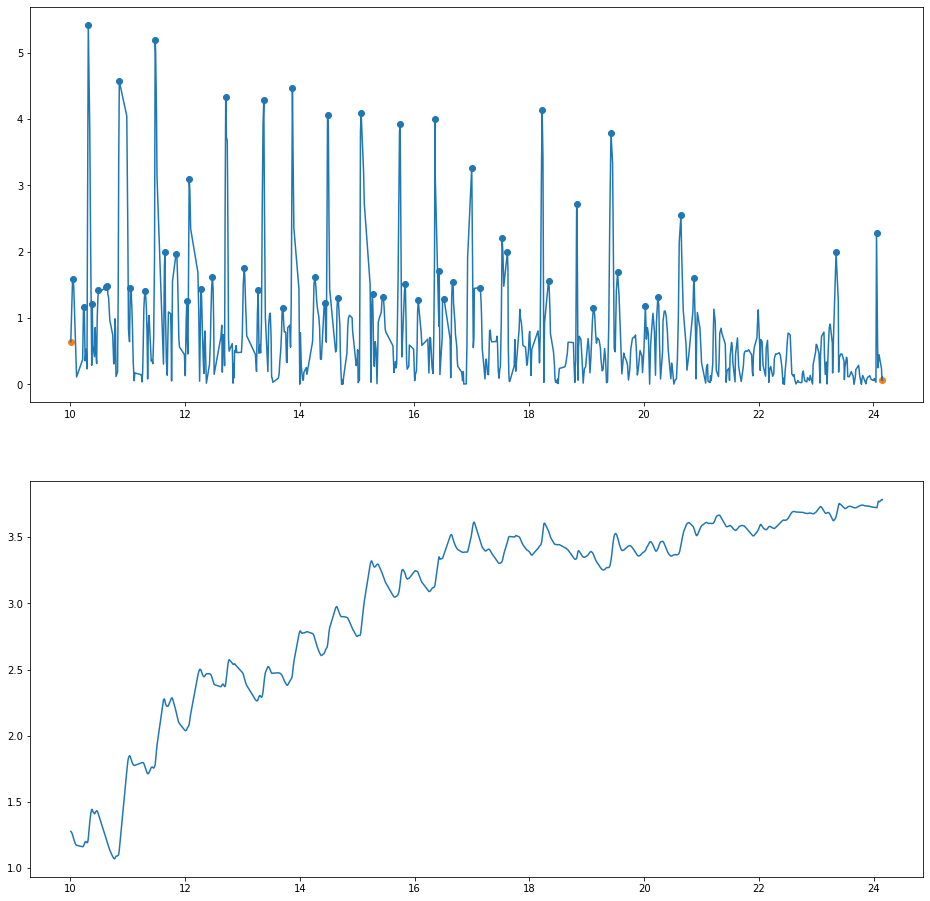

('85', 43, 'Female', 86, 70, True, 14.1415, 53, 0.2698, 210.12599999999998, 3.0018, 42.4369, 15162.1755)
('85', 43, 'Female', 86, 70, True, 14.1415, 53, 0.2698, 210.12599999999998, 3.0018, 42.4369, 15162.1755, 0.2589)
('85', 43, 'Female', 86, 70, True, 14.1415, 53, 0.2698, 210.12599999999998, 3.0018, 42.4369, 15162.1755, 0.2589, 0.0013, -0.0129, -0.0159, 7, 103, 'Diabetes')
('85', 43, 'Female', 86, 70, True, 14.1415, 53, 0.2698, 210.12599999999998, 3.0018, 42.4369, 15162.1755, 0.2589, 0.0013, -0.0129, -0.0159, 7, 226, "Mã©Niã¨Re'S Syndrome")
('85', 43, 'Female', 86, 70, True, 14.1415, 53, 0.2698, 210.12599999999998, 3.0018, 42.4369, 15162.1755, 0.2589, 0.0013, -0.0129, -0.0159, 7, 104, 'Arterial Hypertension')


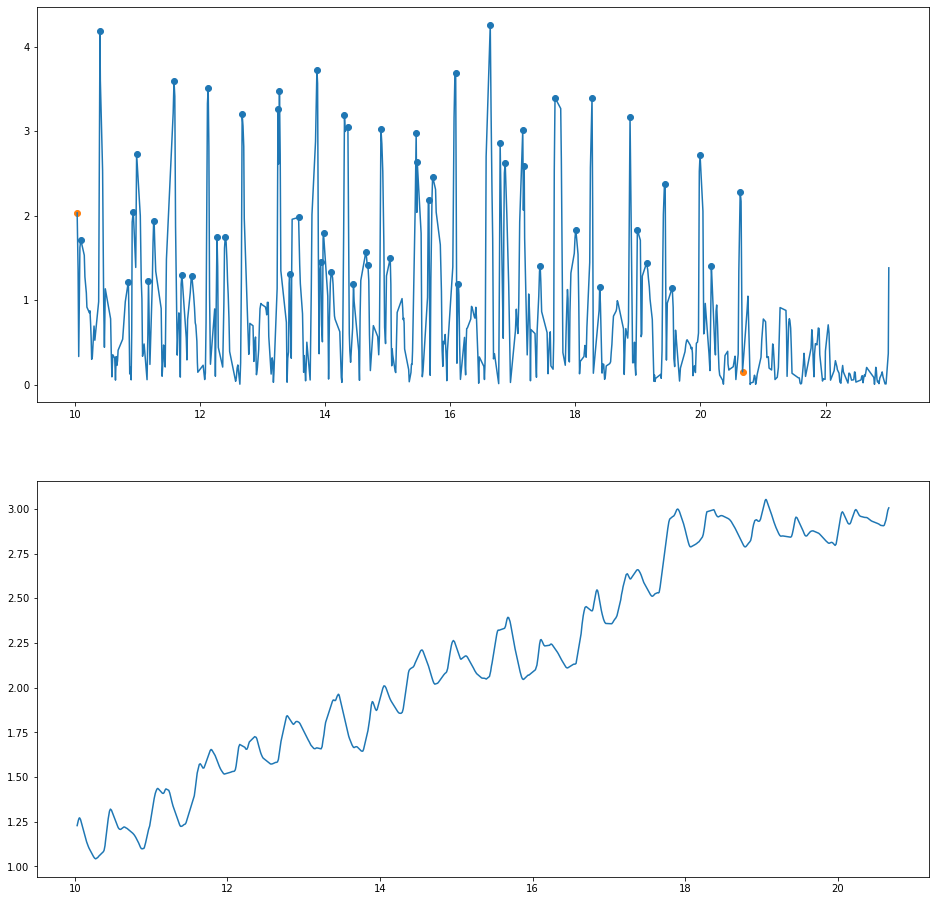

('86', 43, 'Female', 86, 70, True, 10.6435, 53, 0.2033, 150.91299999999998, 2.1559, 22.8995, 14519.9395)
('86', 43, 'Female', 86, 70, True, 10.6435, 53, 0.2033, 150.91299999999998, 2.1559, 22.8995, 14519.9395, 0.4549)
('86', 43, 'Female', 86, 70, True, 10.6435, 53, 0.2033, 150.91299999999998, 2.1559, 22.8995, 14519.9395, 0.4549, -0.0049, 0.006, -0.0086, 7, 103, 'Diabetes')
('86', 43, 'Female', 86, 70, True, 10.6435, 53, 0.2033, 150.91299999999998, 2.1559, 22.8995, 14519.9395, 0.4549, -0.0049, 0.006, -0.0086, 7, 226, "Mã©Niã¨Re'S Syndrome")
('86', 43, 'Female', 86, 70, True, 10.6435, 53, 0.2033, 150.91299999999998, 2.1559, 22.8995, 14519.9395, 0.4549, -0.0049, 0.006, -0.0086, 7, 104, 'Arterial Hypertension')


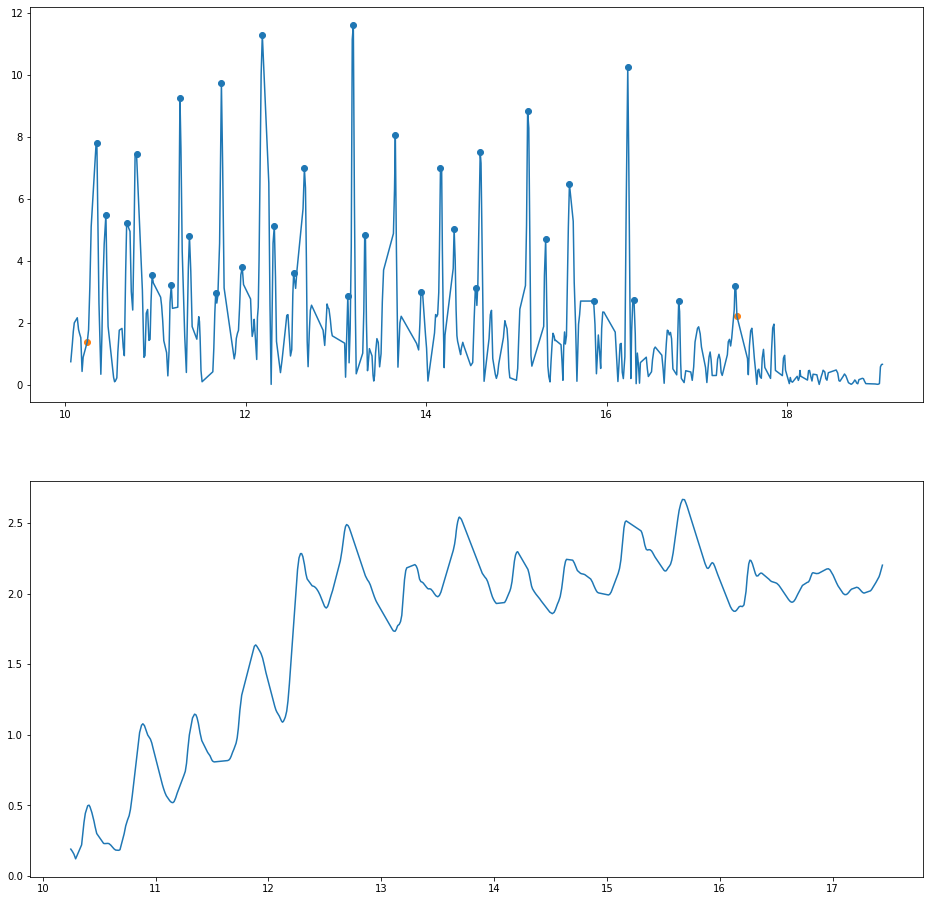

('87', 44, 'Female', 78, 68, False, 7.1945, 32, 0.2284, 119.3944, 1.7558, 12.7682, 19687.7685)
('87', 44, 'Female', 78, 68, False, 7.1945, 32, 0.2284, 119.3944, 1.7558, 12.7682, 19687.7685, 0.2079)
('87', 44, 'Female', 78, 68, False, 7.1945, 32, 0.2284, 119.3944, 1.7558, 12.7682, 19687.7685, 0.2079, 0.0068, -0.0009, -0.0281, 9, 222, 'Anxiety')
('87', 44, 'Female', 78, 68, False, 7.1945, 32, 0.2284, 119.3944, 1.7558, 12.7682, 19687.7685, 0.2079, 0.0068, -0.0009, -0.0281, 9, 227, 'Primary Hyperuricemia')
('87', 44, 'Female', 78, 68, False, 7.1945, 32, 0.2284, 119.3944, 1.7558, 12.7682, 19687.7685, 0.2079, 0.0068, -0.0009, -0.0281, 9, 104, 'Arterial Hypertension')


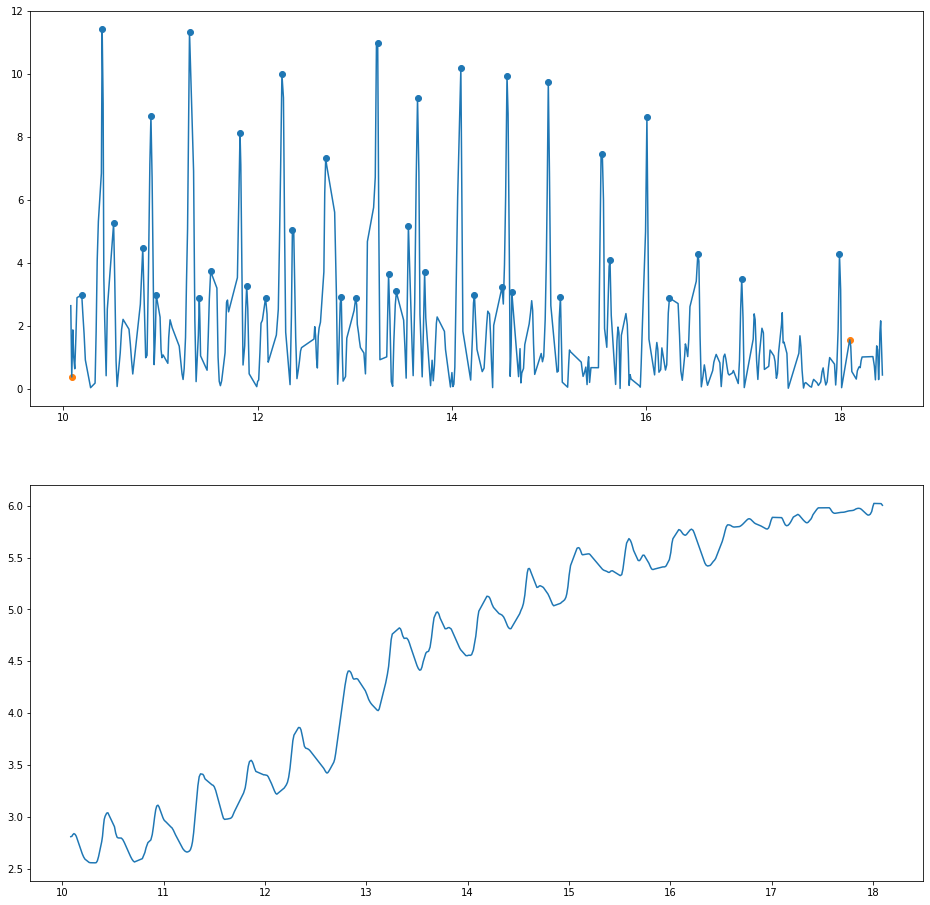

('88', 44, 'Female', 78, 68, False, 8.0085, 37, 0.2171, 311.2428, 4.5771, 36.6335, 73246.0101)
('88', 44, 'Female', 78, 68, False, 8.0085, 37, 0.2171, 311.2428, 4.5771, 36.6335, 73246.0101, 0.2636)
('88', 44, 'Female', 78, 68, False, 8.0085, 37, 0.2171, 311.2428, 4.5771, 36.6335, 73246.0101, 0.2636, -0.0151, -0.021, -0.0136, 9, 222, 'Anxiety')
('88', 44, 'Female', 78, 68, False, 8.0085, 37, 0.2171, 311.2428, 4.5771, 36.6335, 73246.0101, 0.2636, -0.0151, -0.021, -0.0136, 9, 227, 'Primary Hyperuricemia')
('88', 44, 'Female', 78, 68, False, 8.0085, 37, 0.2171, 311.2428, 4.5771, 36.6335, 73246.0101, 0.2636, -0.0151, -0.021, -0.0136, 9, 104, 'Arterial Hypertension')


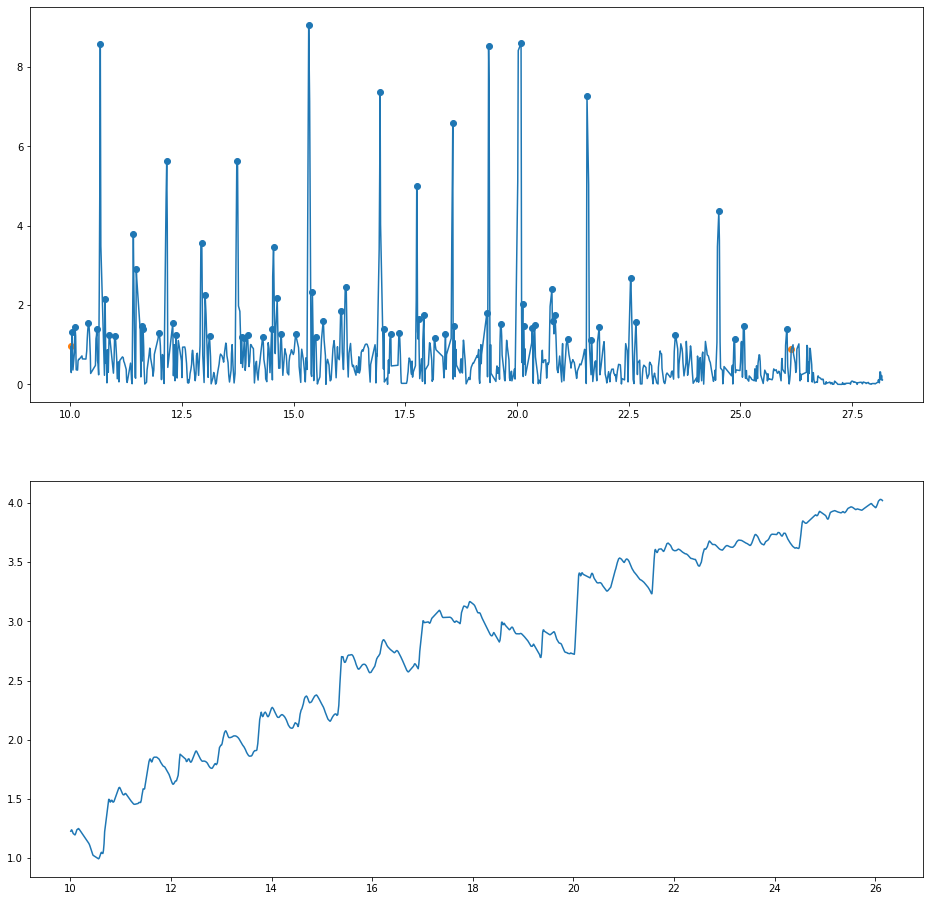

('89', 45, 'Male', 78, 95, True, 16.1315, 68, 0.2394, 266.51300000000003, 2.8054, 45.2889, 35449.3835)
('89', 45, 'Male', 78, 95, True, 16.1315, 68, 0.2394, 266.51300000000003, 2.8054, 45.2889, 35449.3835, 0.4985)
('89', 45, 'Male', 78, 95, True, 16.1315, 68, 0.2394, 266.51300000000003, 2.8054, 45.2889, 35449.3835, 0.4985, -0.0062, -0.0632, 0.0214, 9, 228, 'Benign Prostatic Hyperplasia')
('89', 45, 'Male', 78, 95, True, 16.1315, 68, 0.2394, 266.51300000000003, 2.8054, 45.2889, 35449.3835, 0.4985, -0.0062, -0.0632, 0.0214, 9, 104, 'Arterial Hypertension')
('89', 45, 'Male', 78, 95, True, 16.1315, 68, 0.2394, 266.51300000000003, 2.8054, 45.2889, 35449.3835, 0.4985, -0.0062, -0.0632, 0.0214, 9, 178, 'Asthma')


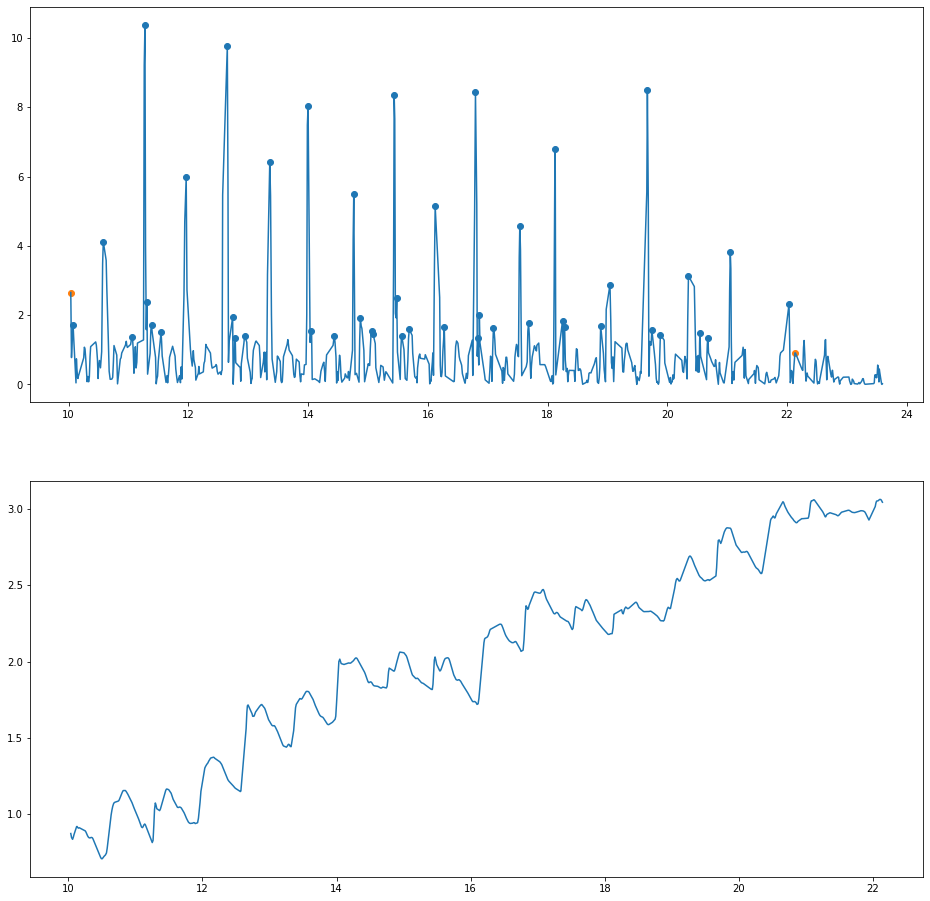

('90', 45, 'Male', 78, 95, True, 12.1055, 45, 0.2723, 191.8525, 2.0195, 24.4416, 22670.3065)
('90', 45, 'Male', 78, 95, True, 12.1055, 45, 0.2723, 191.8525, 2.0195, 24.4416, 22670.3065, 0.4083)
('90', 45, 'Male', 78, 95, True, 12.1055, 45, 0.2723, 191.8525, 2.0195, 24.4416, 22670.3065, 0.4083, -0.0087, -0.0006, -0.0117, 9, 228, 'Benign Prostatic Hyperplasia')
('90', 45, 'Male', 78, 95, True, 12.1055, 45, 0.2723, 191.8525, 2.0195, 24.4416, 22670.3065, 0.4083, -0.0087, -0.0006, -0.0117, 9, 104, 'Arterial Hypertension')
('90', 45, 'Male', 78, 95, True, 12.1055, 45, 0.2723, 191.8525, 2.0195, 24.4416, 22670.3065, 0.4083, -0.0087, -0.0006, -0.0117, 9, 178, 'Asthma')


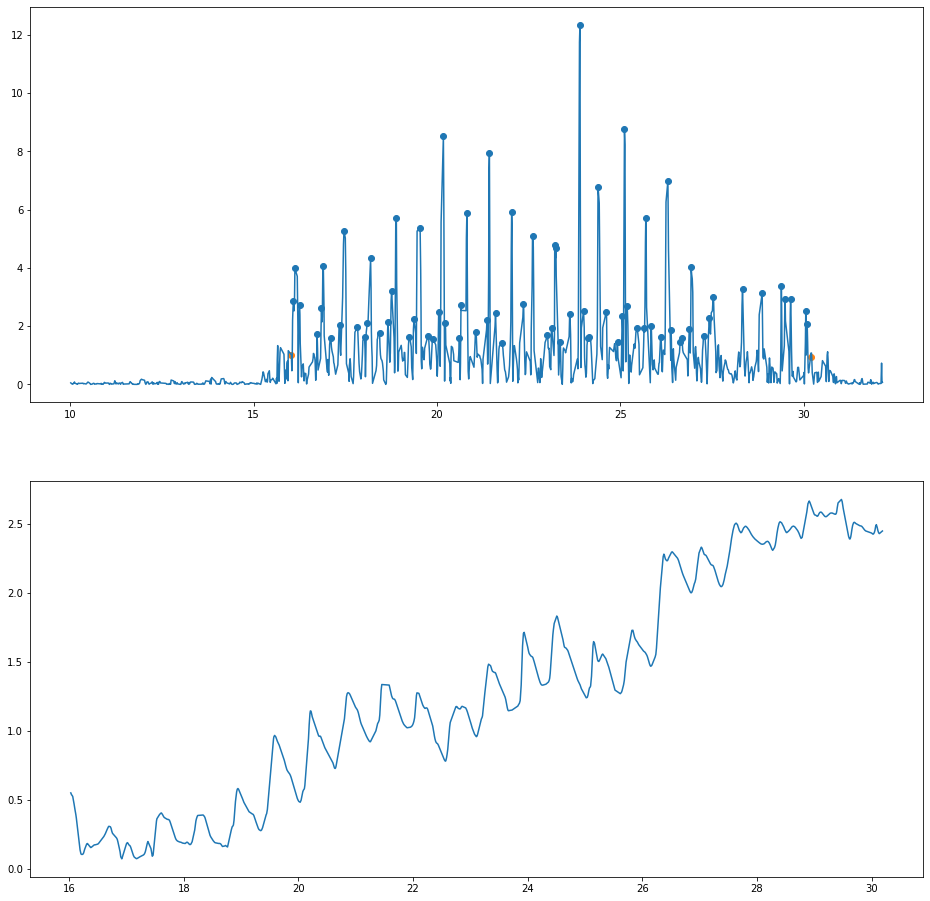

('91', 46, 'Female', 80, 56, False, 14.1605, 73, 0.1951, 72.4528, 1.2938, 18.4345, 9294.9757)
('91', 46, 'Female', 80, 56, False, 14.1605, 73, 0.1951, 72.4528, 1.2938, 18.4345, 9294.9757, 0.3611)
('91', 46, 'Female', 80, 56, False, 14.1605, 73, 0.1951, 72.4528, 1.2938, 18.4345, 9294.9757, 0.3611, -0.0201, 0.051, 0.1109, 7, 103, 'Diabetes')
('91', 46, 'Female', 80, 56, False, 14.1605, 73, 0.1951, 72.4528, 1.2938, 18.4345, 9294.9757, 0.3611, -0.0201, 0.051, 0.1109, 7, 229, 'Gastric Ulcers')
('91', 46, 'Female', 80, 56, False, 14.1605, 73, 0.1951, 72.4528, 1.2938, 18.4345, 9294.9757, 0.3611, -0.0201, 0.051, 0.1109, 7, 104, 'Arterial Hypertension')


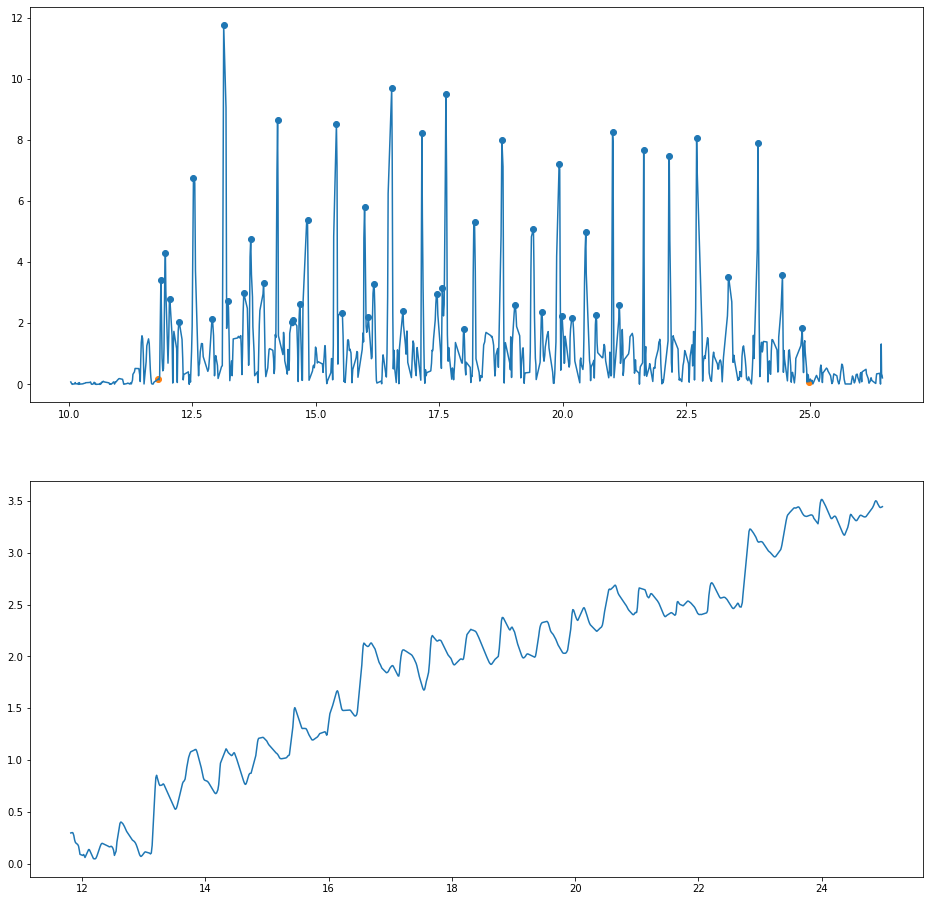

('92', 46, 'Female', 80, 56, False, 13.1665, 47, 0.2827, 107.2064, 1.9144, 25.2251, 18600.5629)
('92', 46, 'Female', 80, 56, False, 13.1665, 47, 0.2827, 107.2064, 1.9144, 25.2251, 18600.5629, 0.3822)
('92', 46, 'Female', 80, 56, False, 13.1665, 47, 0.2827, 107.2064, 1.9144, 25.2251, 18600.5629, 0.3822, 0.0131, -0.0151, 0.0256, 7, 103, 'Diabetes')
('92', 46, 'Female', 80, 56, False, 13.1665, 47, 0.2827, 107.2064, 1.9144, 25.2251, 18600.5629, 0.3822, 0.0131, -0.0151, 0.0256, 7, 229, 'Gastric Ulcers')
('92', 46, 'Female', 80, 56, False, 13.1665, 47, 0.2827, 107.2064, 1.9144, 25.2251, 18600.5629, 0.3822, 0.0131, -0.0151, 0.0256, 7, 104, 'Arterial Hypertension')


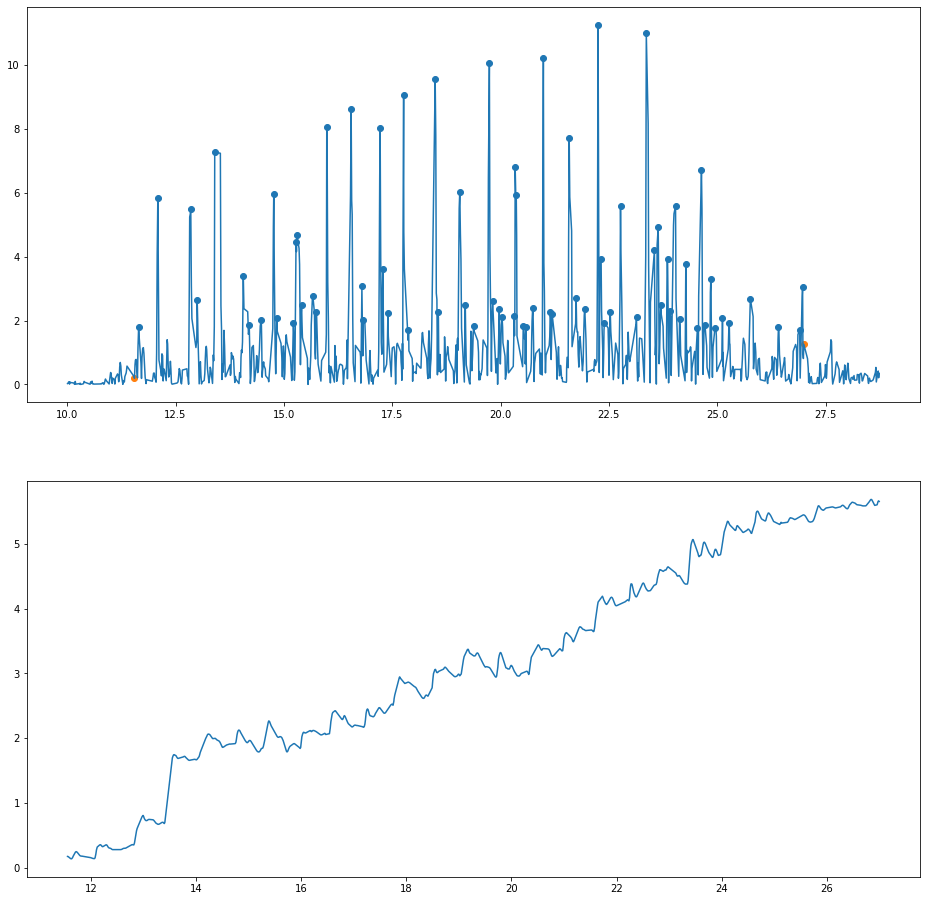

('93', 48, 'Female', 87, 54, False, 15.4475, 72, 0.2163, 169.59779999999998, 3.1407, 48.5547, 49571.1473)
('93', 48, 'Female', 87, 54, False, 15.4475, 72, 0.2163, 169.59779999999998, 3.1407, 48.5547, 49571.1473, 0.2842)
('93', 48, 'Female', 87, 54, False, 15.4475, 72, 0.2163, 169.59779999999998, 3.1407, 48.5547, 49571.1473, 0.2842, -0.0178, -0.1067, -0.0022, 9, 162, 'Epilepsy')
('93', 48, 'Female', 87, 54, False, 15.4475, 72, 0.2163, 169.59779999999998, 3.1407, 48.5547, 49571.1473, 0.2842, -0.0178, -0.1067, -0.0022, 9, 229, 'Gastric Ulcers')
('93', 48, 'Female', 87, 54, False, 15.4475, 72, 0.2163, 169.59779999999998, 3.1407, 48.5547, 49571.1473, 0.2842, -0.0178, -0.1067, -0.0022, 9, 104, 'Arterial Hypertension')
('93', 48, 'Female', 87, 54, False, 15.4475, 72, 0.2163, 169.59779999999998, 3.1407, 48.5547, 49571.1473, 0.2842, -0.0178, -0.1067, -0.0022, 9, 179, "Parkinson'S Disease")
('93', 48, 'Female', 87, 54, False, 15.4475, 72, 0.2163, 169.59779999999998, 3.1407, 48.5547, 49571.1473, 

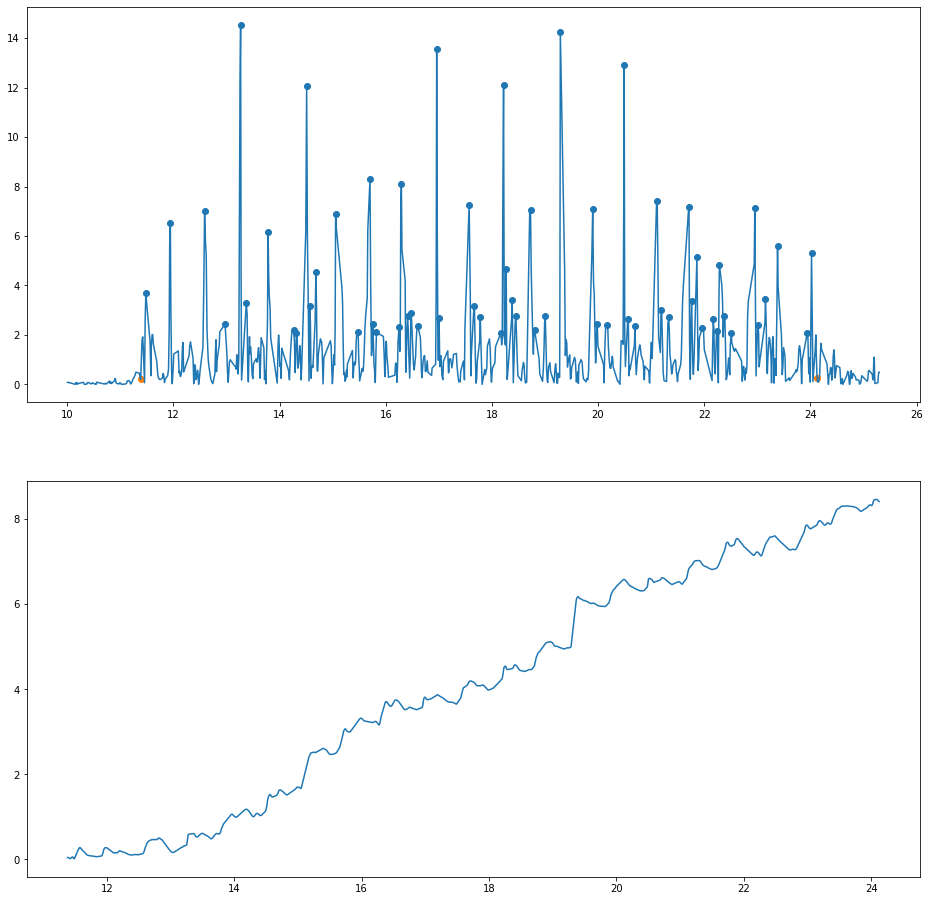

('94', 48, 'Female', 87, 54, False, 12.7425, 60, 0.2131, 222.74460000000002, 4.1249, 52.331, 71916.5903)
('94', 48, 'Female', 87, 54, False, 12.7425, 60, 0.2131, 222.74460000000002, 4.1249, 52.331, 71916.5903, 0.7786)
('94', 48, 'Female', 87, 54, False, 12.7425, 60, 0.2131, 222.74460000000002, 4.1249, 52.331, 71916.5903, 0.7786, 0.0035, 0.0965, -0.0143, 9, 162, 'Epilepsy')
('94', 48, 'Female', 87, 54, False, 12.7425, 60, 0.2131, 222.74460000000002, 4.1249, 52.331, 71916.5903, 0.7786, 0.0035, 0.0965, -0.0143, 9, 229, 'Gastric Ulcers')
('94', 48, 'Female', 87, 54, False, 12.7425, 60, 0.2131, 222.74460000000002, 4.1249, 52.331, 71916.5903, 0.7786, 0.0035, 0.0965, -0.0143, 9, 104, 'Arterial Hypertension')
('94', 48, 'Female', 87, 54, False, 12.7425, 60, 0.2131, 222.74460000000002, 4.1249, 52.331, 71916.5903, 0.7786, 0.0035, 0.0965, -0.0143, 9, 179, "Parkinson'S Disease")
('94', 48, 'Female', 87, 54, False, 12.7425, 60, 0.2131, 222.74460000000002, 4.1249, 52.331, 71916.5903, 0.7786, 0.0035,

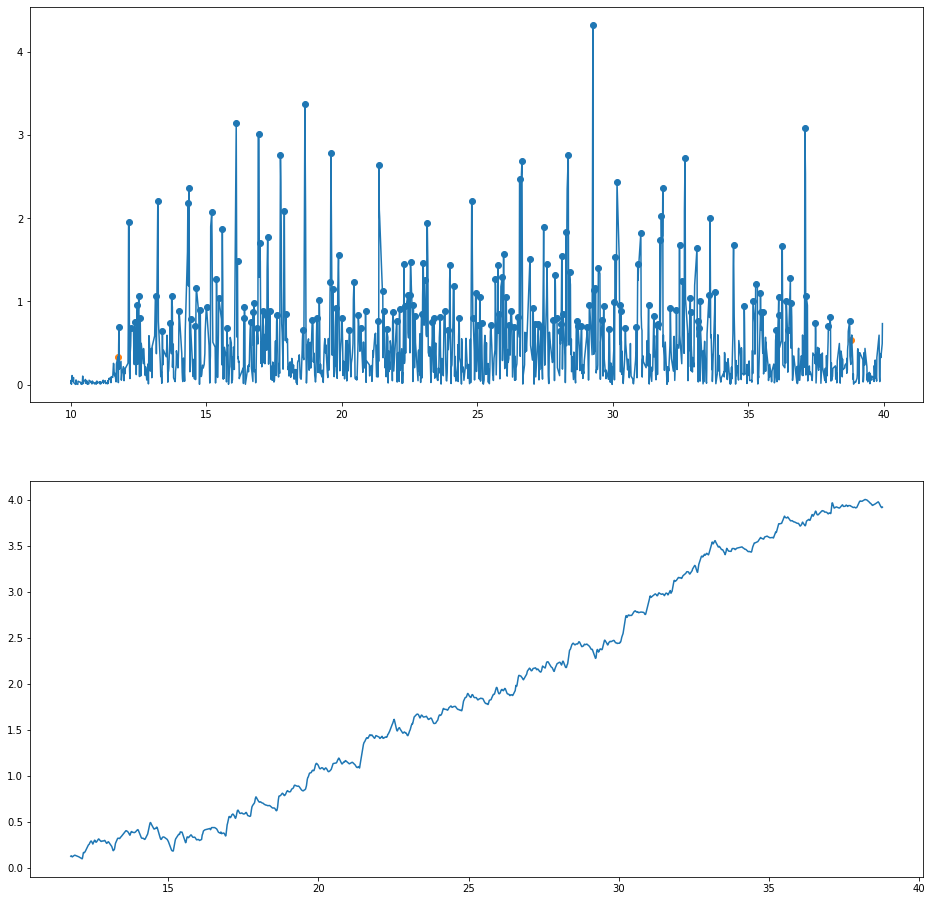

('95', 49, 'Male', 90, 61, True, 27.0515, 185, 0.147, 118.37049999999999, 1.9405, 52.5219, 22632.4279)
('95', 49, 'Male', 90, 61, True, 27.0515, 185, 0.147, 118.37049999999999, 1.9405, 52.5219, 22632.4279, 1.1363)
('95', 49, 'Male', 90, 61, True, 27.0515, 185, 0.147, 118.37049999999999, 1.9405, 52.5219, 22632.4279, 1.1363, -0.0562, -0.3416, -0.2566, 7, 230, 'Prostate Problems')
('95', 49, 'Male', 90, 61, True, 27.0515, 185, 0.147, 118.37049999999999, 1.9405, 52.5219, 22632.4279, 1.1363, -0.0562, -0.3416, -0.2566, 7, 231, 'Arterial Sypertension')


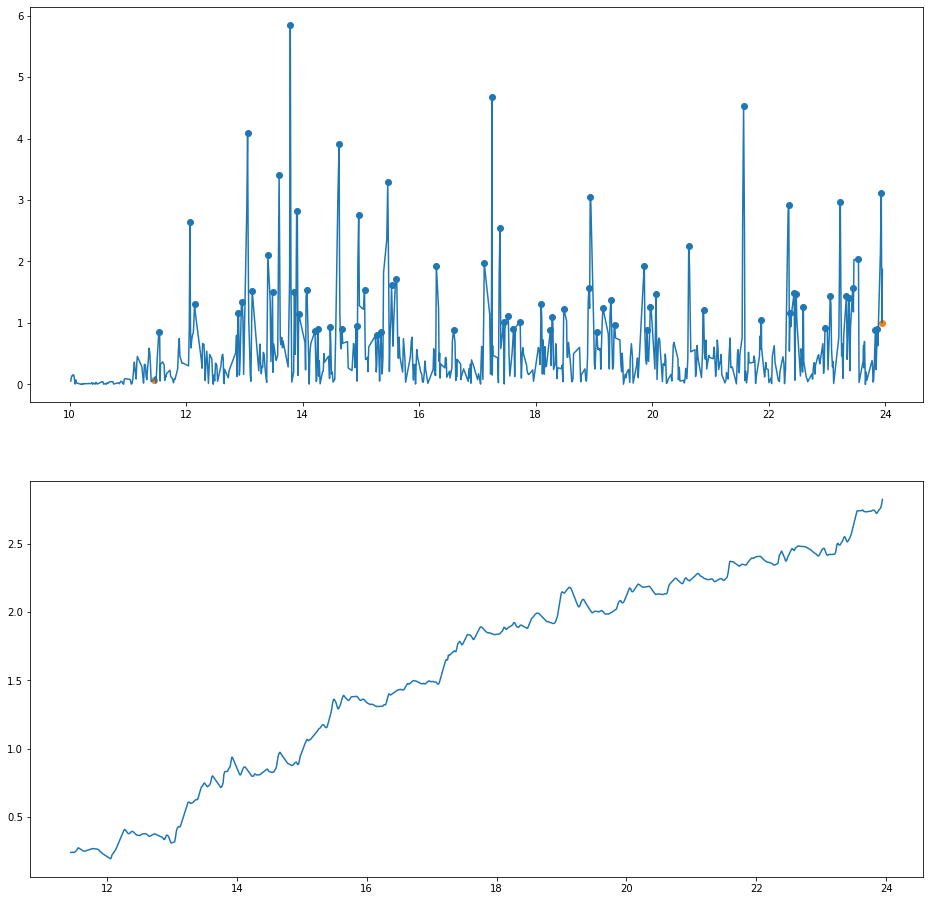

('96', 49, 'Male', 90, 61, True, 12.5005, 70, 0.1802, 96.6301, 1.5841, 19.7314, 13324.078)
('96', 49, 'Male', 90, 61, True, 12.5005, 70, 0.1802, 96.6301, 1.5841, 19.7314, 13324.078, 0.6251)
('96', 49, 'Male', 90, 61, True, 12.5005, 70, 0.1802, 96.6301, 1.5841, 19.7314, 13324.078, 0.6251, -0.1019, -0.1349, -0.0545, 7, 230, 'Prostate Problems')
('96', 49, 'Male', 90, 61, True, 12.5005, 70, 0.1802, 96.6301, 1.5841, 19.7314, 13324.078, 0.6251, -0.1019, -0.1349, -0.0545, 7, 231, 'Arterial Sypertension')


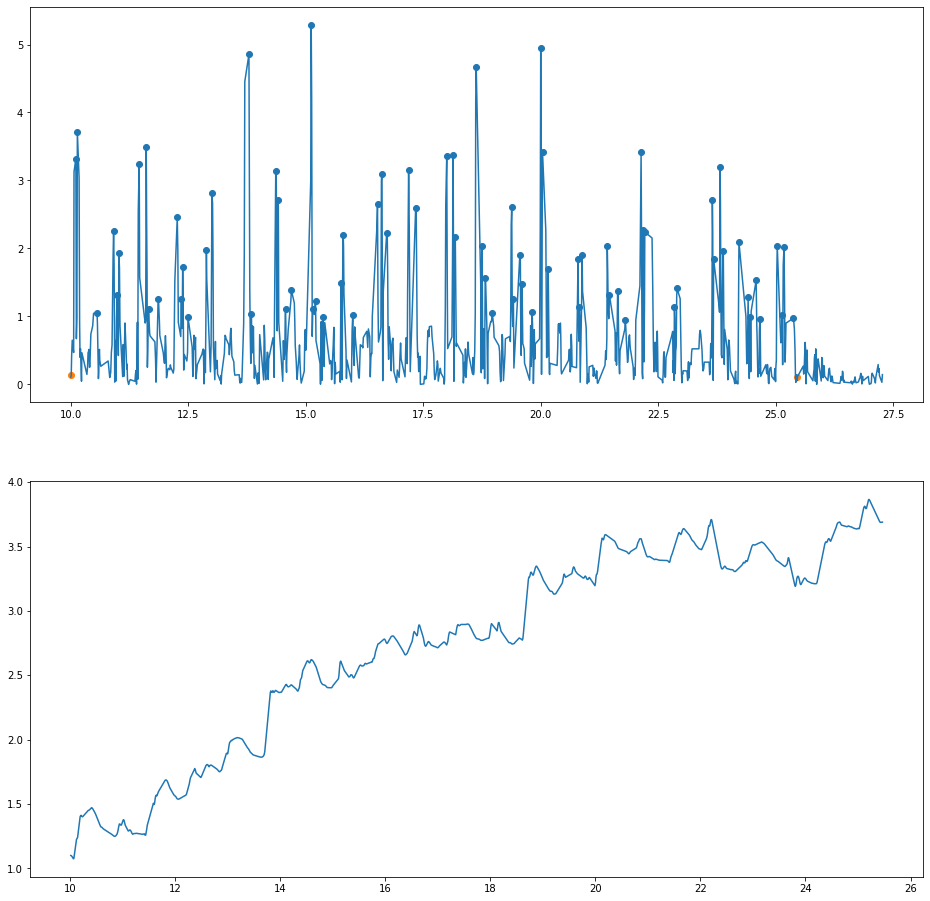

('97', 50, 'Female', 83, 78, True, 15.4535, 74, 0.2095, 213.9618, 2.7431, 42.3347, 27629.5427)
('97', 50, 'Female', 83, 78, True, 15.4535, 74, 0.2095, 213.9618, 2.7431, 42.3347, 27629.5427, 0.4509)
('97', 50, 'Female', 83, 78, True, 15.4535, 74, 0.2095, 213.9618, 2.7431, 42.3347, 27629.5427, 0.4509, 0.0106, 0.021, -0.0222, 10, 104, 'Arterial Hypertension')


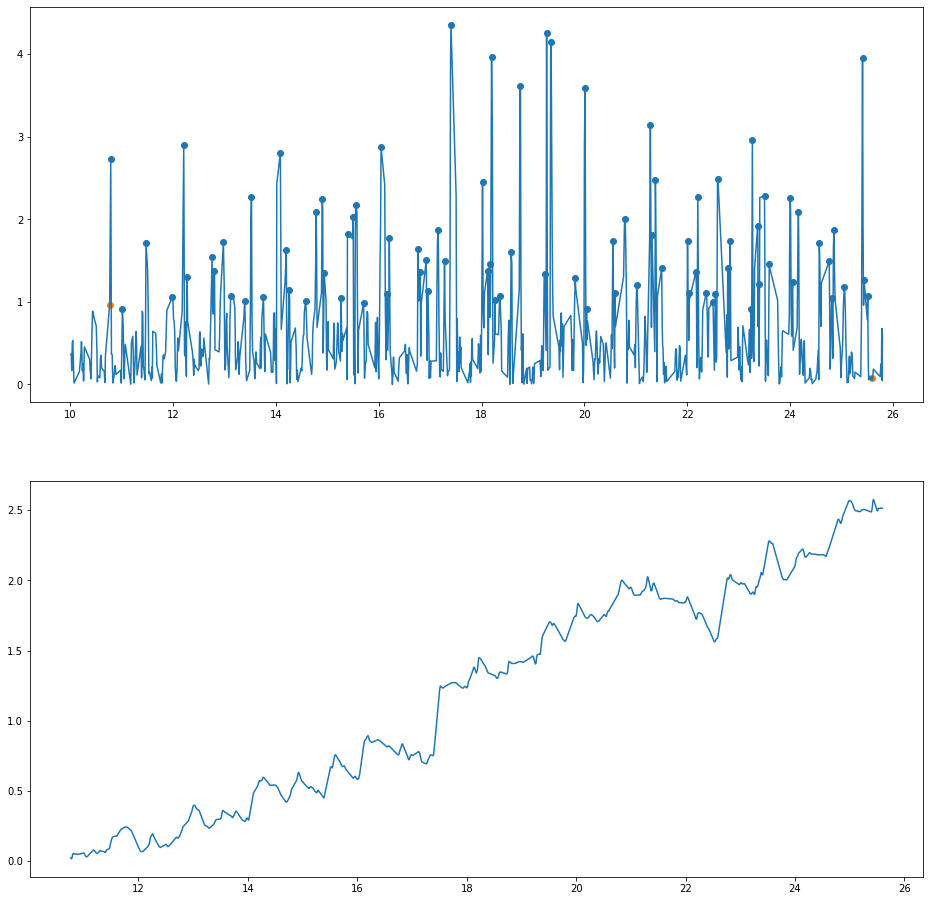

('98', 50, 'Female', 83, 78, True, 14.8345, 84, 0.1779, 93.8886, 1.2037, 17.7781, 13640.5235)
('98', 50, 'Female', 83, 78, True, 14.8345, 84, 0.1779, 93.8886, 1.2037, 17.7781, 13640.5235, 2.3673)
('98', 50, 'Female', 83, 78, True, 14.8345, 84, 0.1779, 93.8886, 1.2037, 17.7781, 13640.5235, 2.3673, 0.0424, 0.4538, 0.1109, 10, 104, 'Arterial Hypertension')


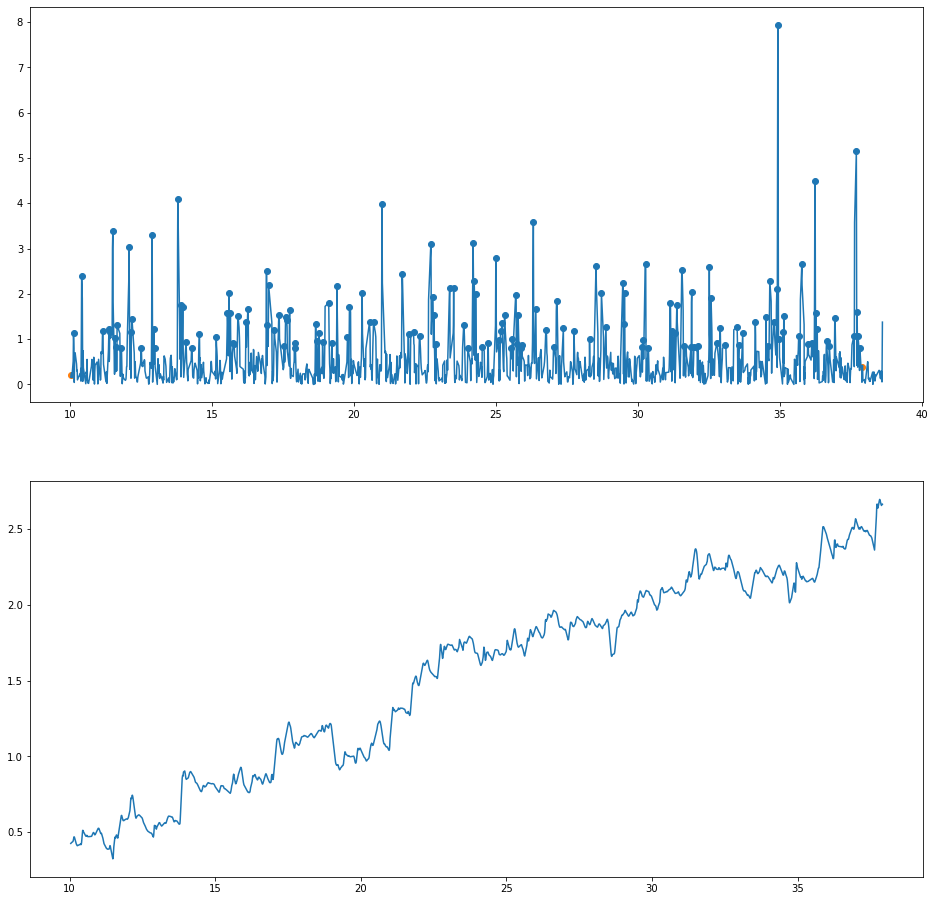

('99', 51, 'Female', 85, 44, True, 27.8695, 148, 0.189, 67.1484, 1.5261, 42.4174, 7208.6305)
('99', 51, 'Female', 85, 44, True, 27.8695, 148, 0.189, 67.1484, 1.5261, 42.4174, 7208.6305, 0.5078)
('99', 51, 'Female', 85, 44, True, 27.8695, 148, 0.189, 67.1484, 1.5261, 42.4174, 7208.6305, 0.5078, -0.0395, 0.015, -0.0559, 8, 103, 'Diabetes')
('99', 51, 'Female', 85, 44, True, 27.8695, 148, 0.189, 67.1484, 1.5261, 42.4174, 7208.6305, 0.5078, -0.0395, 0.015, -0.0559, 8, 142, 'Heart Failure')
('99', 51, 'Female', 85, 44, True, 27.8695, 148, 0.189, 67.1484, 1.5261, 42.4174, 7208.6305, 0.5078, -0.0395, 0.015, -0.0559, 8, 104, 'Arterial Hypertension')


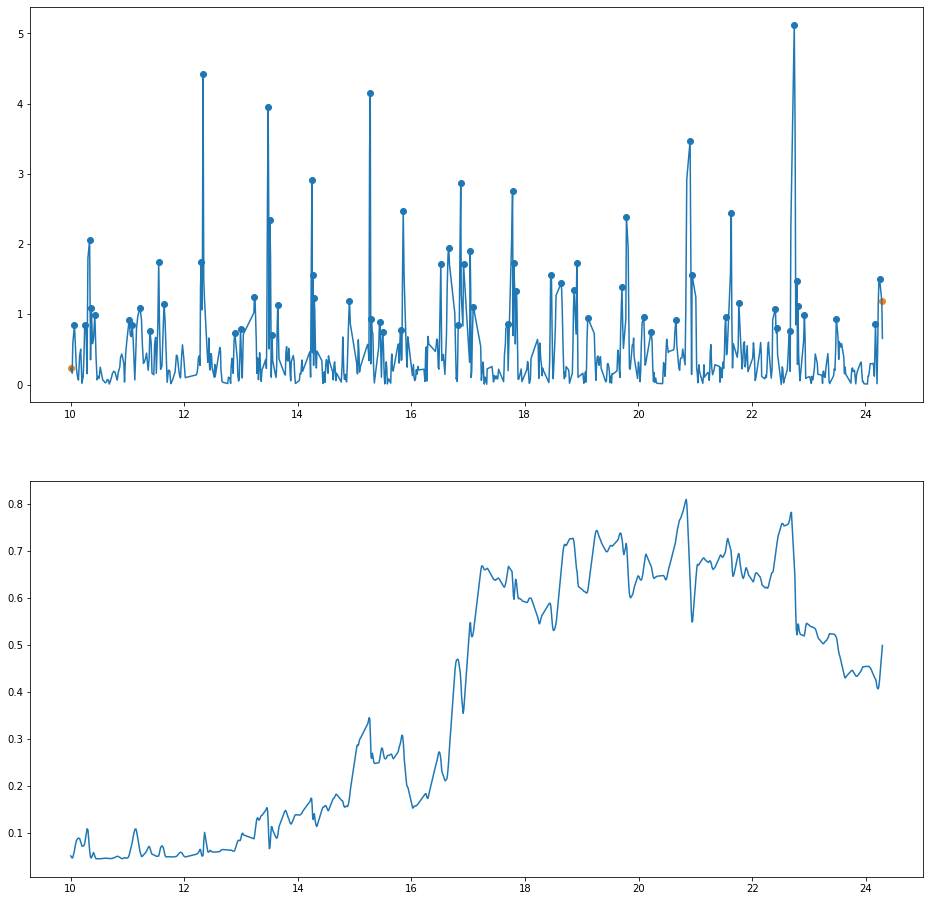

('100', 51, 'Female', 85, 44, True, 14.2885, 66, 0.2187, 17.1512, 0.3898, 5.4909, -626.5947)
('100', 51, 'Female', 85, 44, True, 14.2885, 66, 0.2187, 17.1512, 0.3898, 5.4909, -626.5947, 0.4798)
('100', 51, 'Female', 85, 44, True, 14.2885, 66, 0.2187, 17.1512, 0.3898, 5.4909, -626.5947, 0.4798, -0.0193, 0.0424, 0.0578, 8, 103, 'Diabetes')
('100', 51, 'Female', 85, 44, True, 14.2885, 66, 0.2187, 17.1512, 0.3898, 5.4909, -626.5947, 0.4798, -0.0193, 0.0424, 0.0578, 8, 142, 'Heart Failure')
('100', 51, 'Female', 85, 44, True, 14.2885, 66, 0.2187, 17.1512, 0.3898, 5.4909, -626.5947, 0.4798, -0.0193, 0.0424, 0.0578, 8, 104, 'Arterial Hypertension')


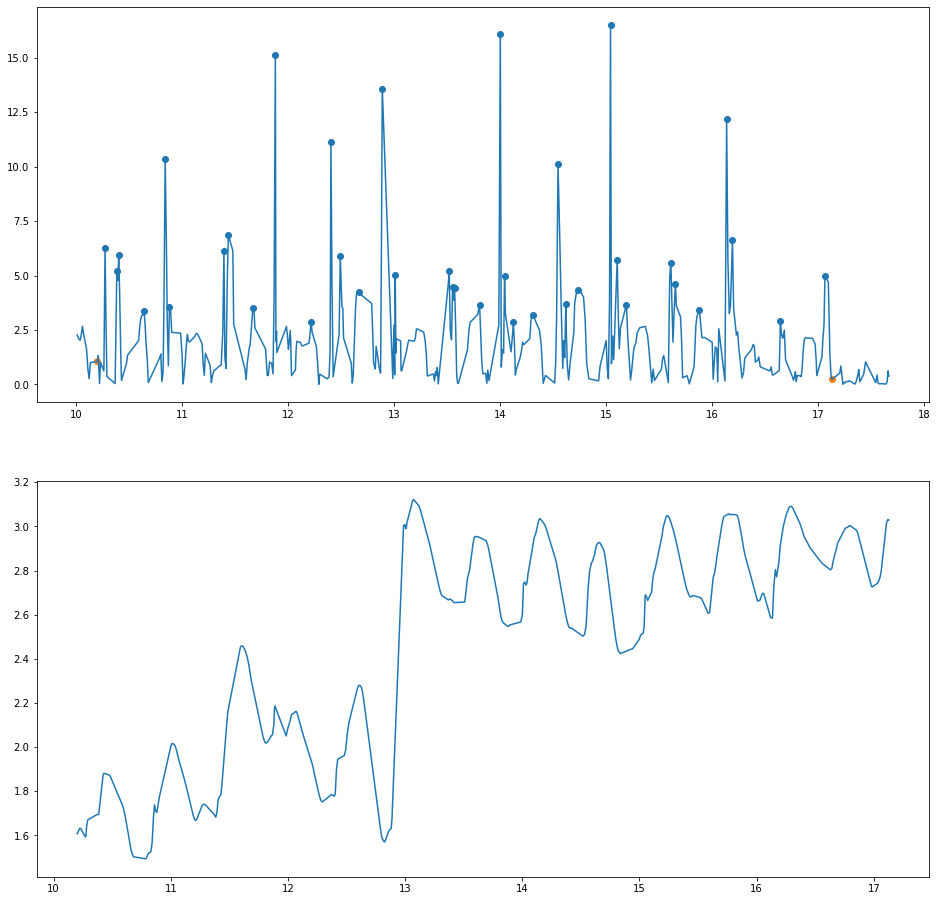

('101', 52, 'Male', 81, 70, False, 6.9275, 37, 0.1891, 171.997, 2.4571, 17.0187, 22474.8305)
('101', 52, 'Male', 81, 70, False, 6.9275, 37, 0.1891, 171.997, 2.4571, 17.0187, 22474.8305, 0.1315)
('101', 52, 'Male', 81, 70, False, 6.9275, 37, 0.1891, 171.997, 2.4571, 17.0187, 22474.8305, 0.1315, -0.0038, 0.0096, -0.0096, 5, 232, "Mã©Niã¨Re'S Disease")
('101', 52, 'Male', 81, 70, False, 6.9275, 37, 0.1891, 171.997, 2.4571, 17.0187, 22474.8305, 0.1315, -0.0038, 0.0096, -0.0096, 5, 233, 'Kidney Disease')


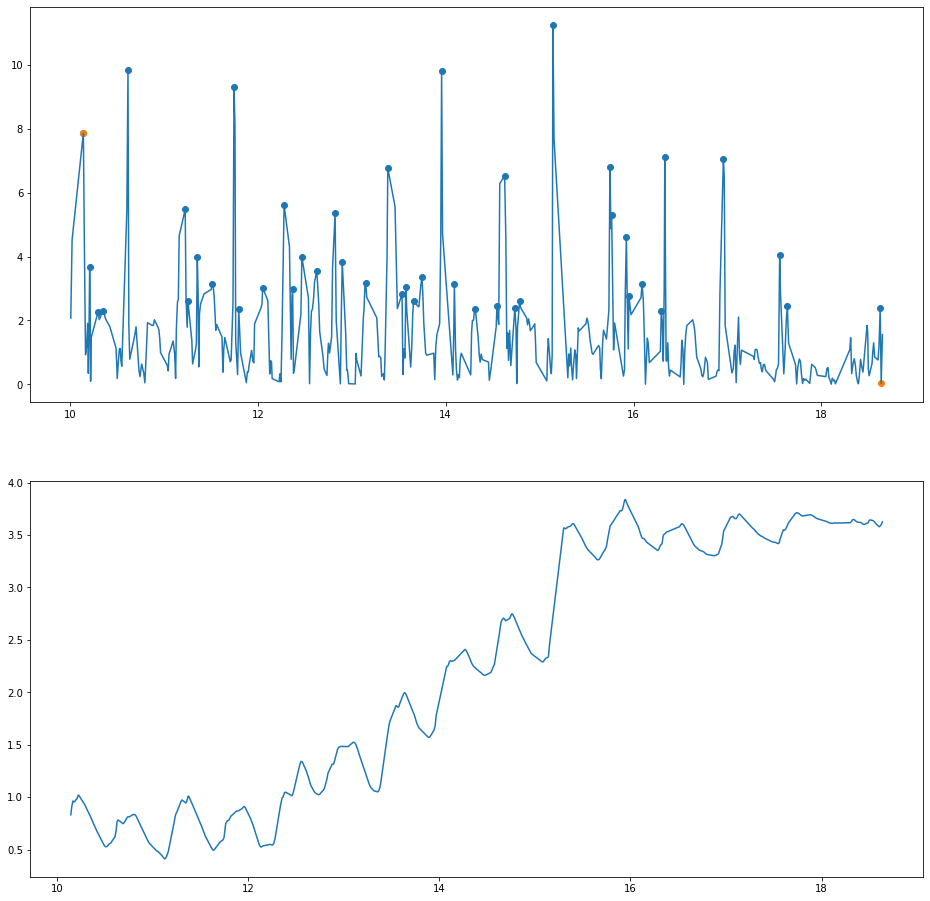

('102', 52, 'Male', 81, 70, False, 8.4945, 43, 0.2025, 155.66600000000003, 2.2238, 18.859, 14826.4345)
('102', 52, 'Male', 81, 70, False, 8.4945, 43, 0.2025, 155.66600000000003, 2.2238, 18.859, 14826.4345, 1.0152)
('102', 52, 'Male', 81, 70, False, 8.4945, 43, 0.2025, 155.66600000000003, 2.2238, 18.859, 14826.4345, 1.0152, 0.0208, 0.0227, -0.0377, 5, 232, "Mã©Niã¨Re'S Disease")
('102', 52, 'Male', 81, 70, False, 8.4945, 43, 0.2025, 155.66600000000003, 2.2238, 18.859, 14826.4345, 1.0152, 0.0208, 0.0227, -0.0377, 5, 233, 'Kidney Disease')


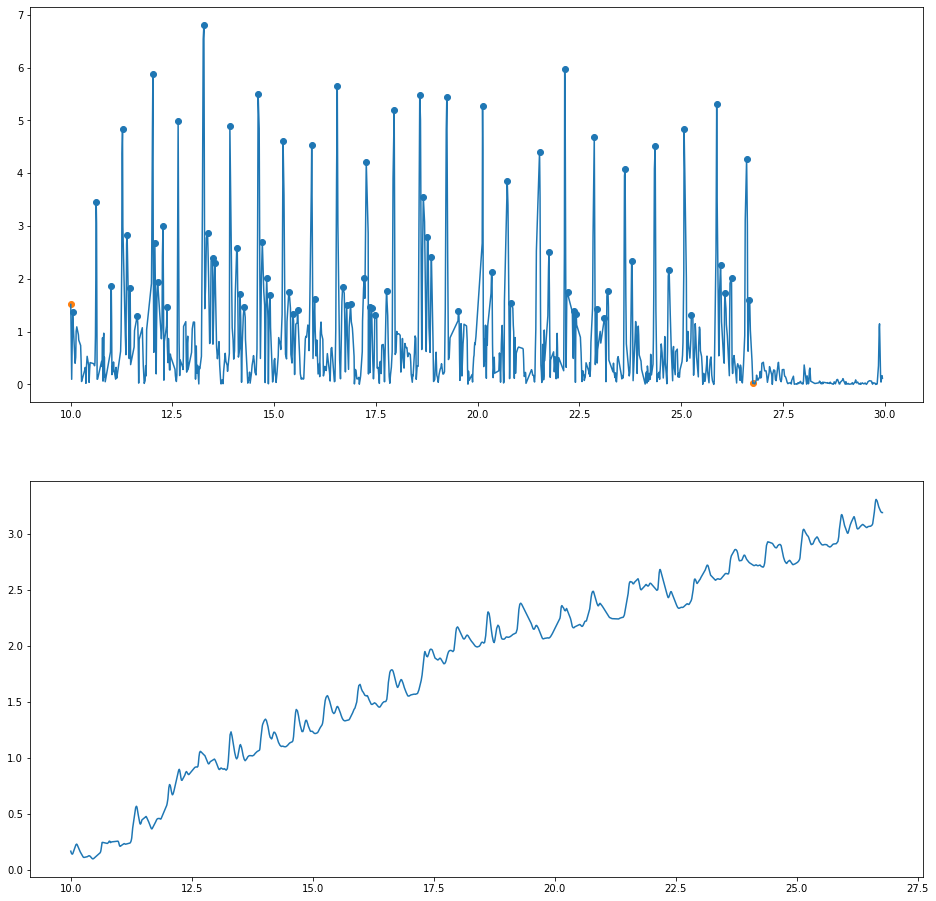

('103', 53, 'Female', 84, 50, True, 16.7685, 74, 0.2281, 91.79, 1.8358, 30.7791, 14742.3405)
('103', 53, 'Female', 84, 50, True, 16.7685, 74, 0.2281, 91.79, 1.8358, 30.7791, 14742.3405, 0.2856)
('103', 53, 'Female', 84, 50, True, 16.7685, 74, 0.2281, 91.79, 1.8358, 30.7791, 14742.3405, 0.2856, 0.0068, -0.0129, 0.1458, 8, 103, 'Diabetes')


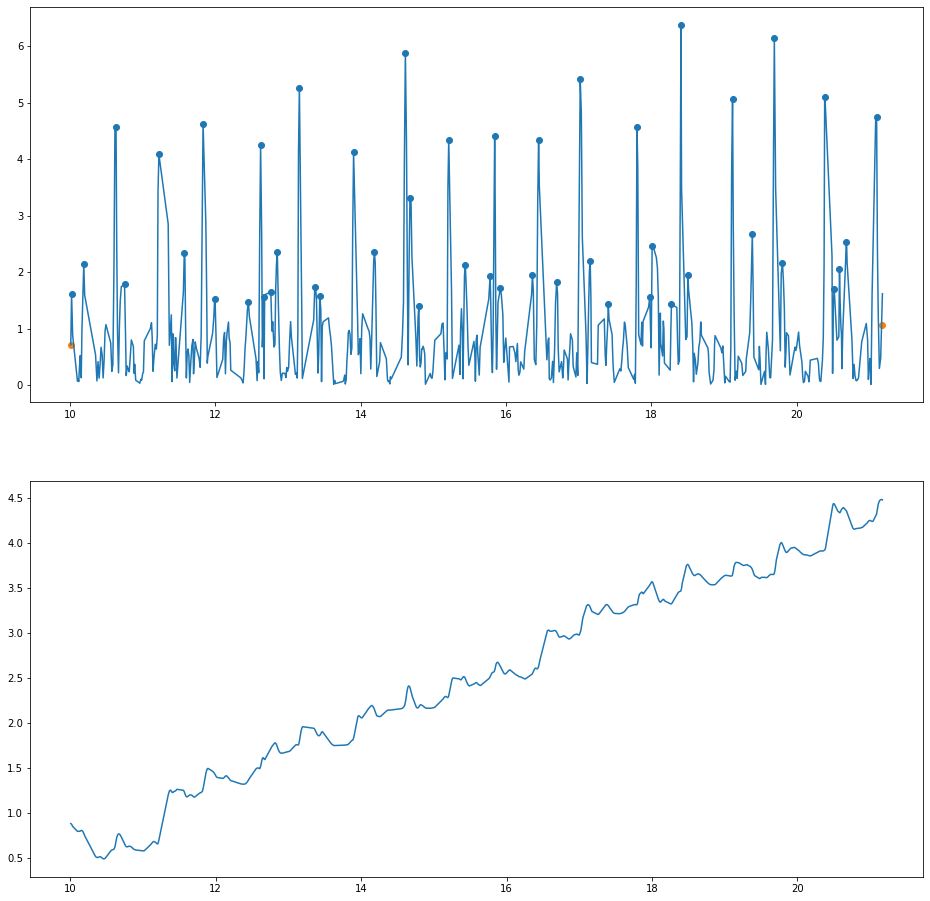

('104', 53, 'Female', 84, 50, True, 11.1615, 47, 0.2414, 125.47500000000001, 2.5095, 27.8056, 17126.7155)
('104', 53, 'Female', 84, 50, True, 11.1615, 47, 0.2414, 125.47500000000001, 2.5095, 27.8056, 17126.7155, 0.5456)
('104', 53, 'Female', 84, 50, True, 11.1615, 47, 0.2414, 125.47500000000001, 2.5095, 27.8056, 17126.7155, 0.5456, -0.0702, -0.0719, -0.006, 8, 103, 'Diabetes')


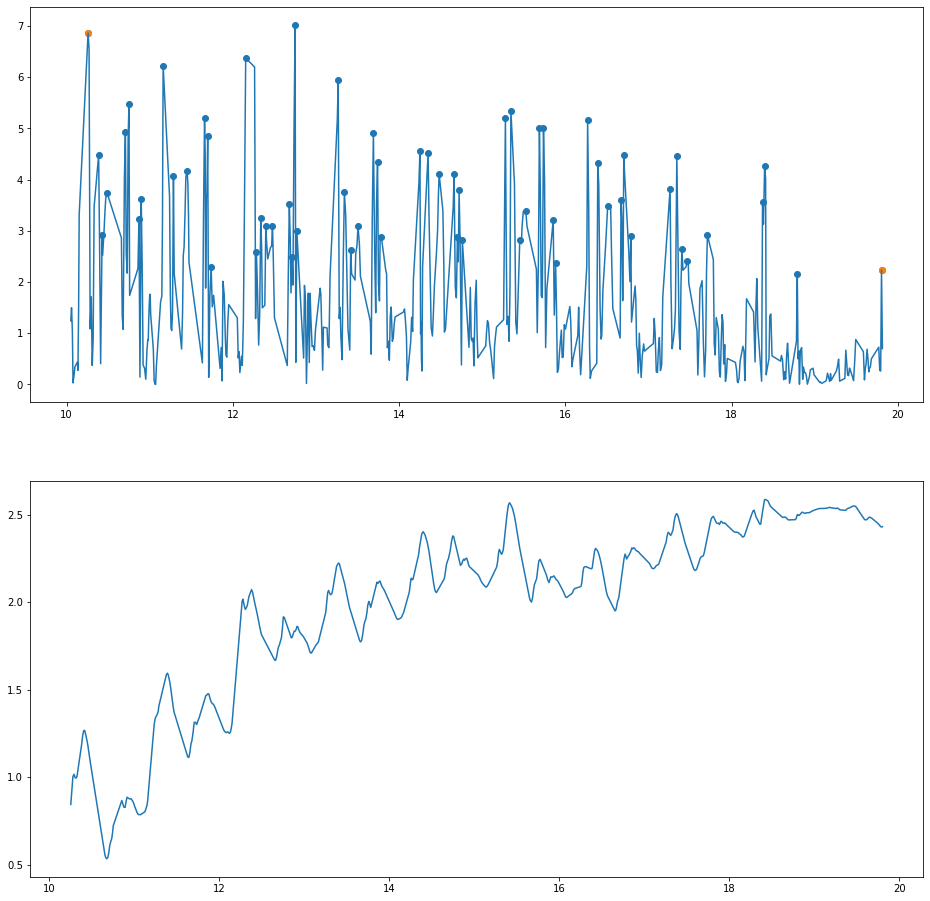

('105', 54, 'Male', 67, 67, False, 9.5445, 60, 0.1623, 133.4104, 1.9912, 19.0478, 13851.7011)
('105', 54, 'Male', 67, 67, False, 9.5445, 60, 0.1623, 133.4104, 1.9912, 19.0478, 13851.7011, 0.3484)
('105', 54, 'Male', 67, 67, False, 9.5445, 60, 0.1623, 133.4104, 1.9912, 19.0478, 13851.7011, 0.3484, 0.0351, 0.0113, 0.0627, 8, 103, 'Diabetes')


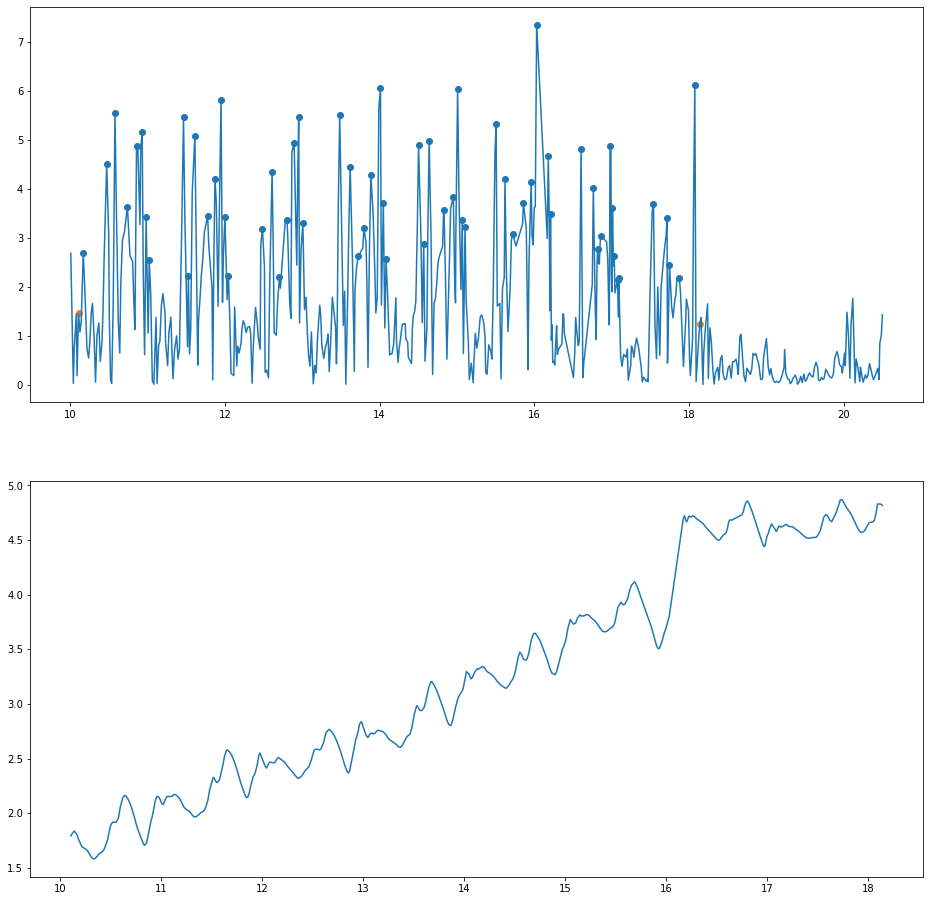

('106', 54, 'Male', 67, 67, False, 8.0315, 61, 0.1323, 219.8337, 3.2811, 26.2267, 29911.7619)
('106', 54, 'Male', 67, 67, False, 8.0315, 61, 0.1323, 219.8337, 3.2811, 26.2267, 29911.7619, 0.6586)
('106', 54, 'Male', 67, 67, False, 8.0315, 61, 0.1323, 219.8337, 3.2811, 26.2267, 29911.7619, 0.6586, -0.0149, 0.0781, -0.001, 8, 103, 'Diabetes')


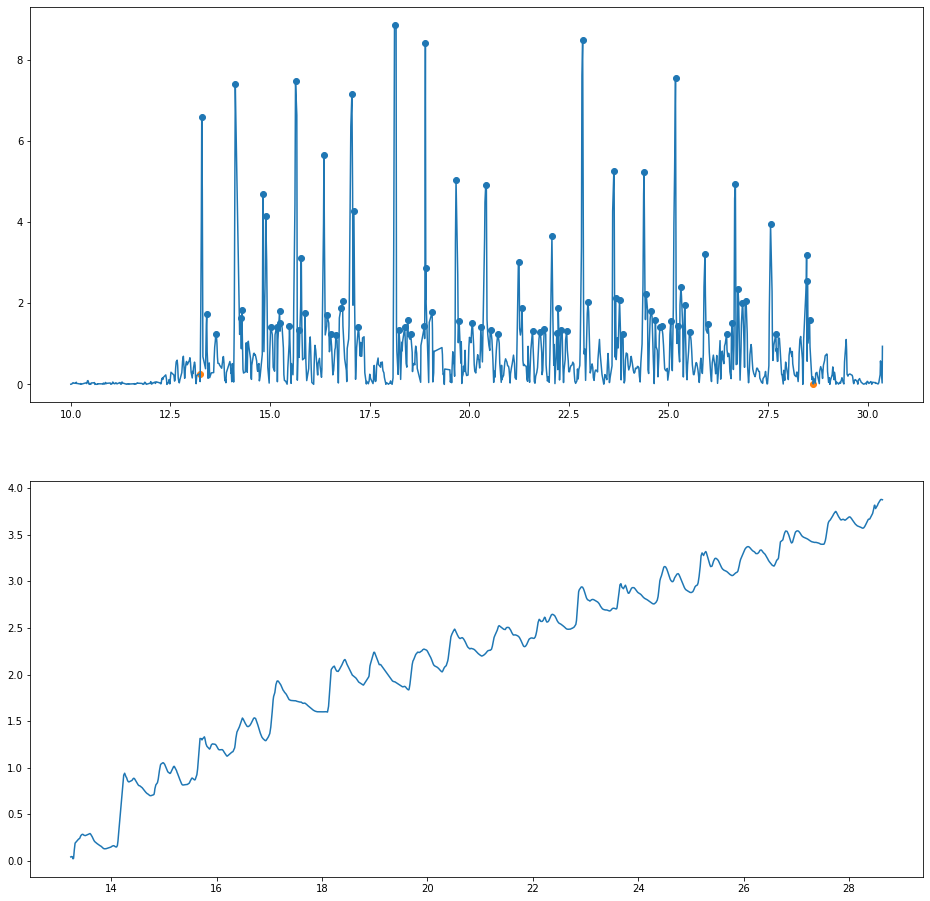

('107', 55, 'Male', 76, 64, True, 15.3975, 83, 0.1865, 141.9712, 2.2183, 34.2422, 25964.8581)
('107', 55, 'Male', 76, 64, True, 15.3975, 83, 0.1865, 141.9712, 2.2183, 34.2422, 25964.8581, 0.1372)
('107', 55, 'Male', 76, 64, True, 15.3975, 83, 0.1865, 141.9712, 2.2183, 34.2422, 25964.8581, 0.1372, -0.0403, 0.1148, -0.0595, 5, 104, 'Arterial Hypertension')


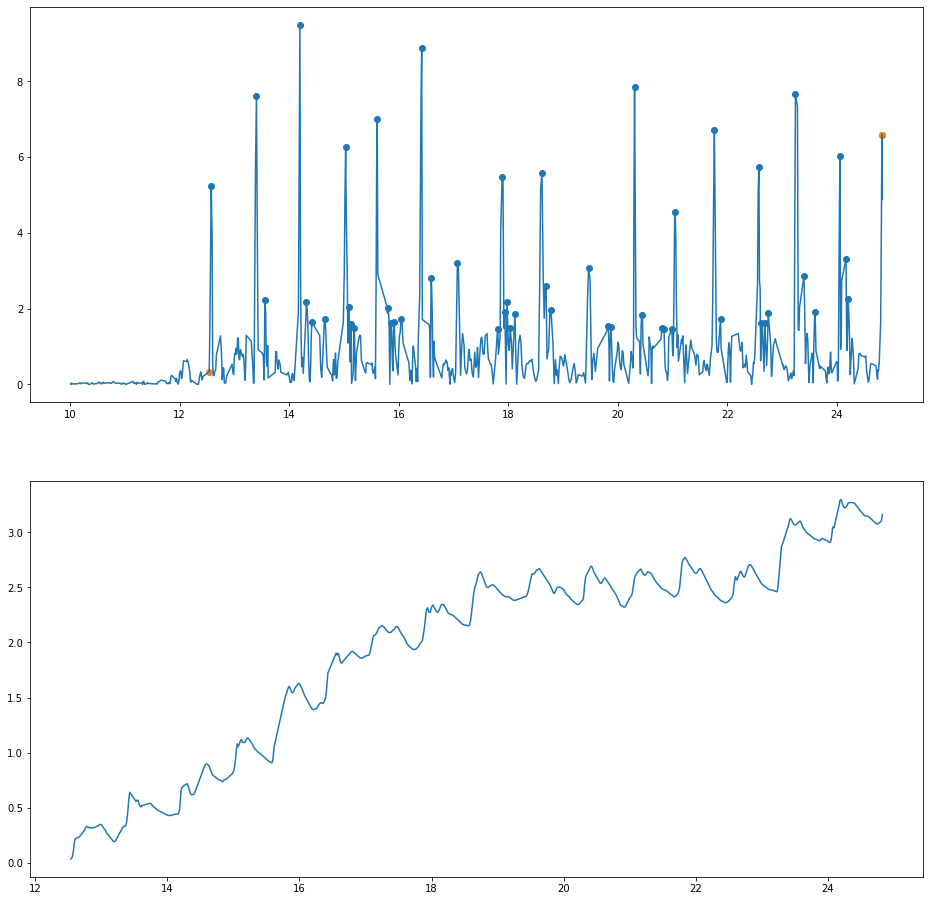

('108', 55, 'Male', 76, 64, True, 12.2865, 50, 0.2505, 124.6528, 1.9477, 24.0275, 19888.5189)
('108', 55, 'Male', 76, 64, True, 12.2865, 50, 0.2505, 124.6528, 1.9477, 24.0275, 19888.5189, 1.1411)
('108', 55, 'Male', 76, 64, True, 12.2865, 50, 0.2505, 124.6528, 1.9477, 24.0275, 19888.5189, 1.1411, -0.1221, -0.0797, -0.0647, 5, 104, 'Arterial Hypertension')


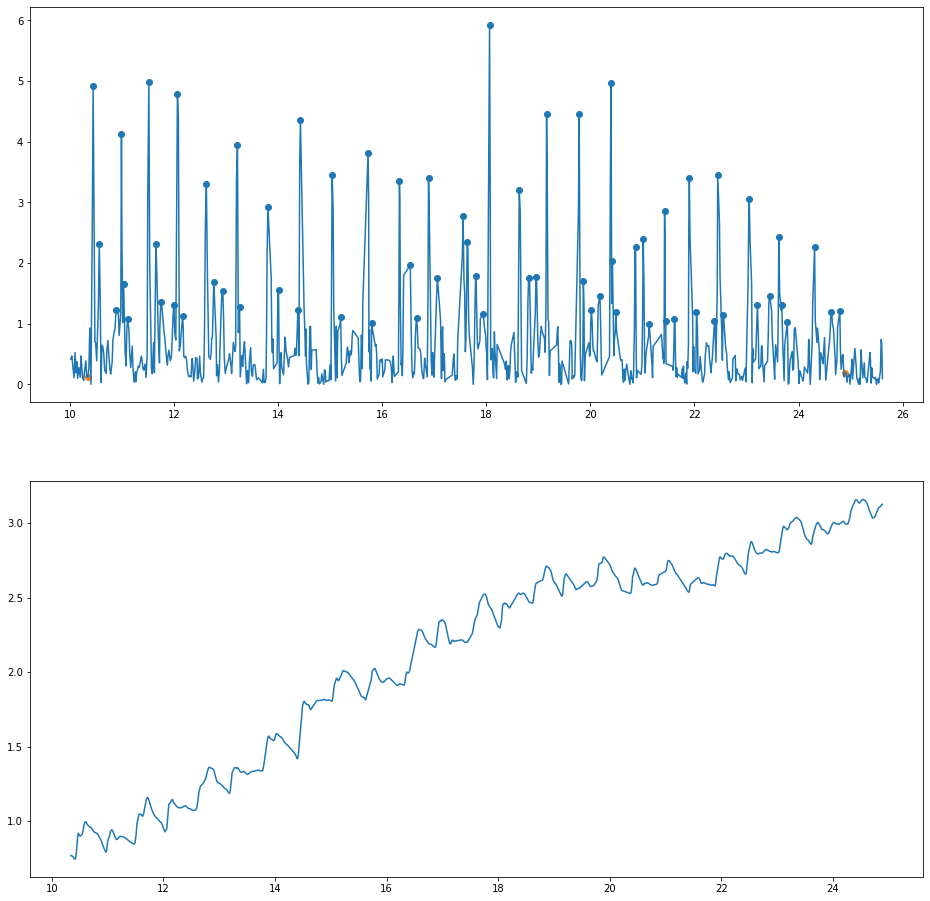

('109', 56, 'Female', 90, 45, True, 14.5455, 66, 0.2213, 96.03450000000001, 2.1341, 30.905, 11173.1225)
('109', 56, 'Female', 90, 45, True, 14.5455, 66, 0.2213, 96.03450000000001, 2.1341, 30.905, 11173.1225, 0.2234)
('109', 56, 'Female', 90, 45, True, 14.5455, 66, 0.2213, 96.03450000000001, 2.1341, 30.905, 11173.1225, 0.2234, 0.0077, -0.0144, 0.0562, 8, 234, 'None')


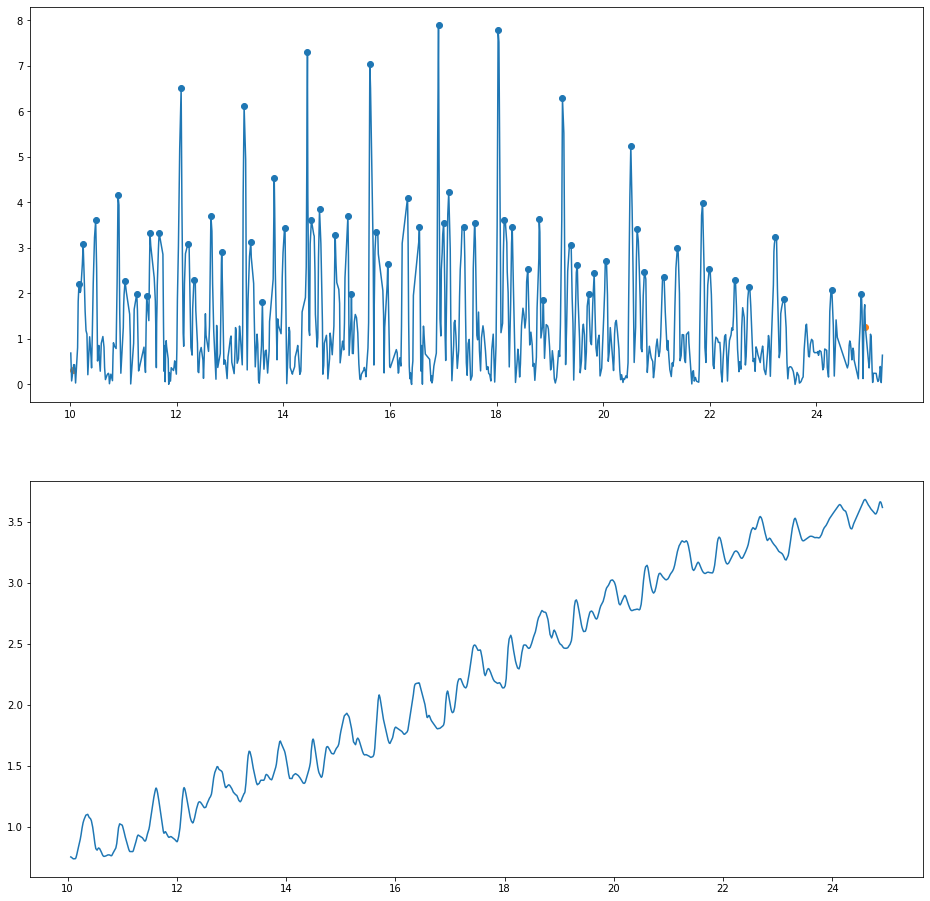

('110', 57, 'Female', 68, 94, True, 14.8595, 60, 0.2492, 210.3814, 2.2381, 33.2765, 26100.7267)
('110', 57, 'Female', 68, 94, True, 14.8595, 60, 0.2492, 210.3814, 2.2381, 33.2765, 26100.7267, 0.477)
('110', 57, 'Female', 68, 94, True, 14.8595, 60, 0.2492, 210.3814, 2.2381, 33.2765, 26100.7267, 0.477, -0.0055, 0.053, -0.0429, 8, 234, 'None')


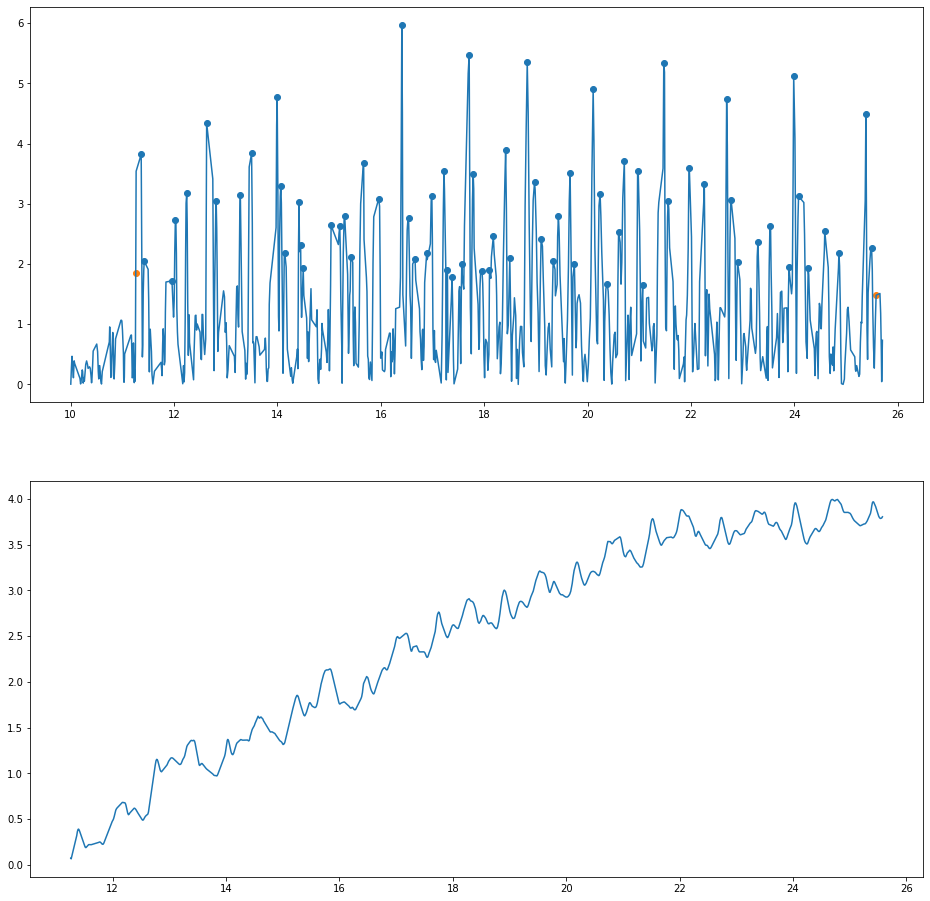

('111', 57, 'Female', 68, 94, True, 14.3205, 68, 0.2114, 234.06000000000003, 2.49, 35.448, 31645.1663)
('111', 57, 'Female', 68, 94, True, 14.3205, 68, 0.2114, 234.06000000000003, 2.49, 35.448, 31645.1663, 1.4079)
('111', 57, 'Female', 68, 94, True, 14.3205, 68, 0.2114, 234.06000000000003, 2.49, 35.448, 31645.1663, 1.4079, -0.0955, -0.1261, -0.0137, 8, 234, 'None')


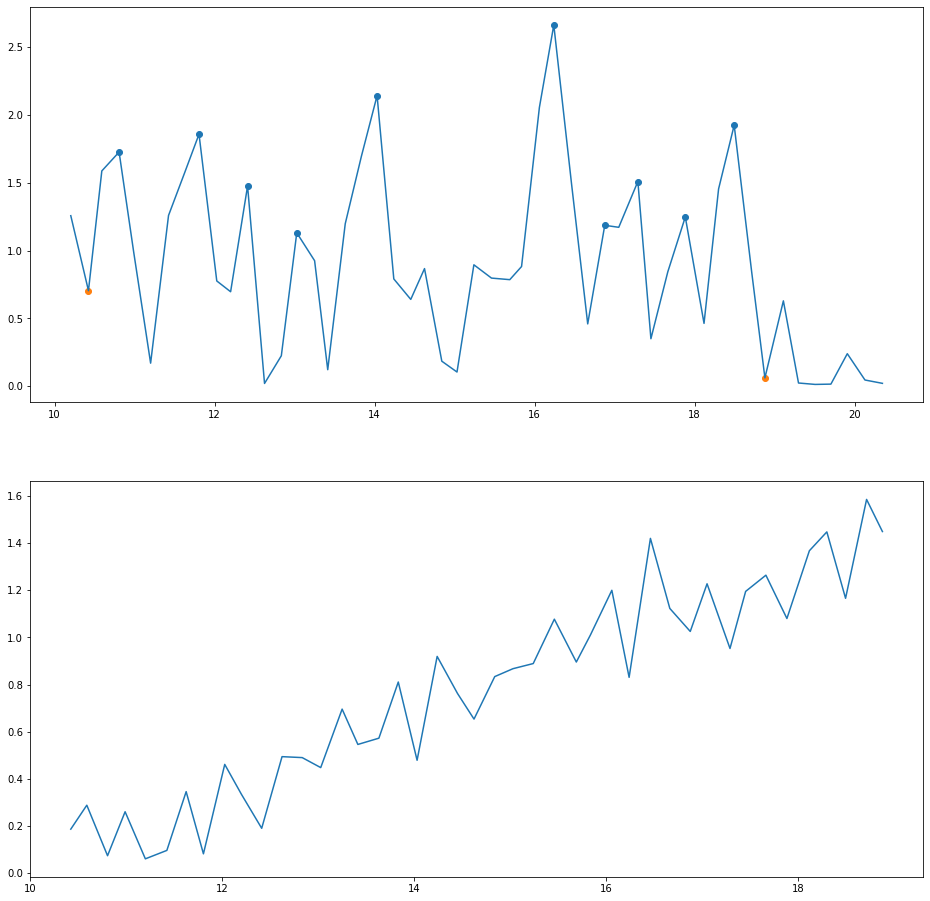

('112', 58, 'Female', 78, 53, True, 8.4565, 10, 0.8548, 40.9001, 0.7717, 6.3956, -101.839)
('112', 58, 'Female', 78, 53, True, 8.4565, 10, 0.8548, 40.9001, 0.7717, 6.3956, -101.839, 0.8237)
('112', 58, 'Female', 78, 53, True, 8.4565, 10, 0.8548, 40.9001, 0.7717, 6.3956, -101.839, 0.8237, -0.0029, 0.0145, -0.0006, 6, 234, 'None')


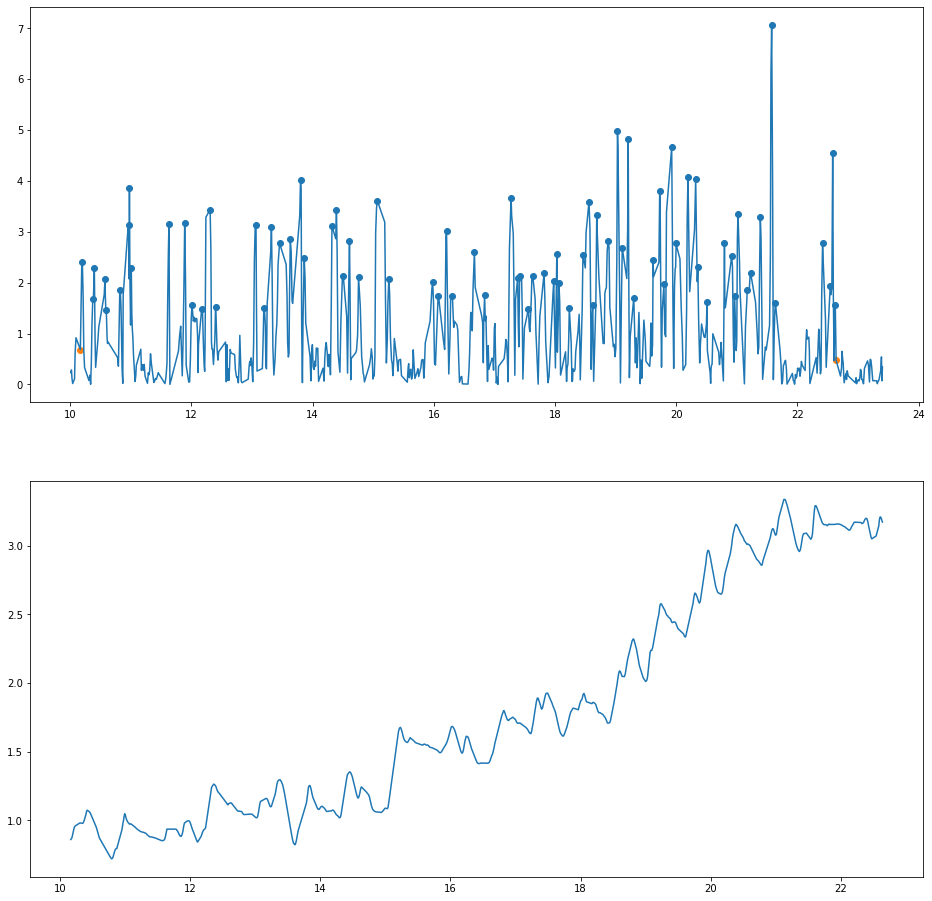

('113', 58, 'Female', 78, 53, True, 12.4745, 76, 0.1663, 95.2622, 1.7974, 22.3971, 13139.0132)
('113', 58, 'Female', 78, 53, True, 12.4745, 76, 0.1663, 95.2622, 1.7974, 22.3971, 13139.0132, 0.267)
('113', 58, 'Female', 78, 53, True, 12.4745, 76, 0.1663, 95.2622, 1.7974, 22.3971, 13139.0132, 0.267, 0.0211, 0.0221, 0.0363, 6, 234, 'None')


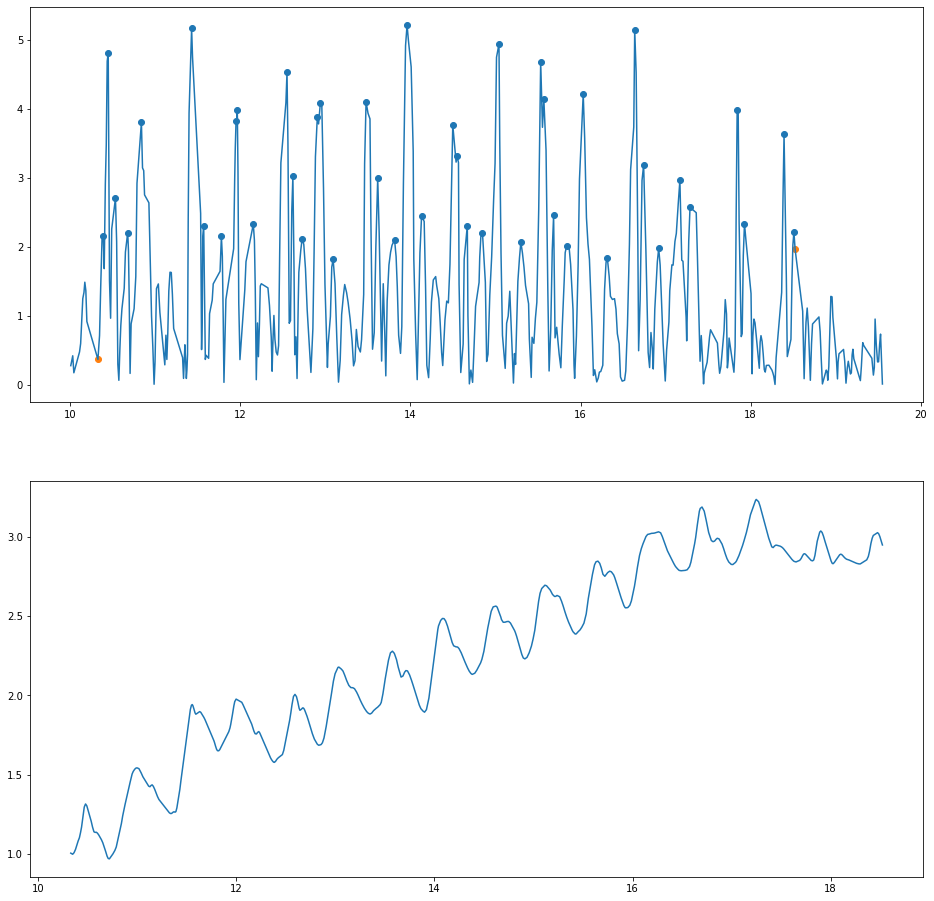

('114', 59, 'Female', 77, 70, False, 8.1935, 43, 0.1937, 157.878, 2.2554, 18.7409, 16107.7355)
('114', 59, 'Female', 77, 70, False, 8.1935, 43, 0.1937, 157.878, 2.2554, 18.7409, 16107.7355, 0.4182)
('114', 59, 'Female', 77, 70, False, 8.1935, 43, 0.1937, 157.878, 2.2554, 18.7409, 16107.7355, 0.4182, -0.0545, 0.0605, -0.003, 9, 234, 'None')


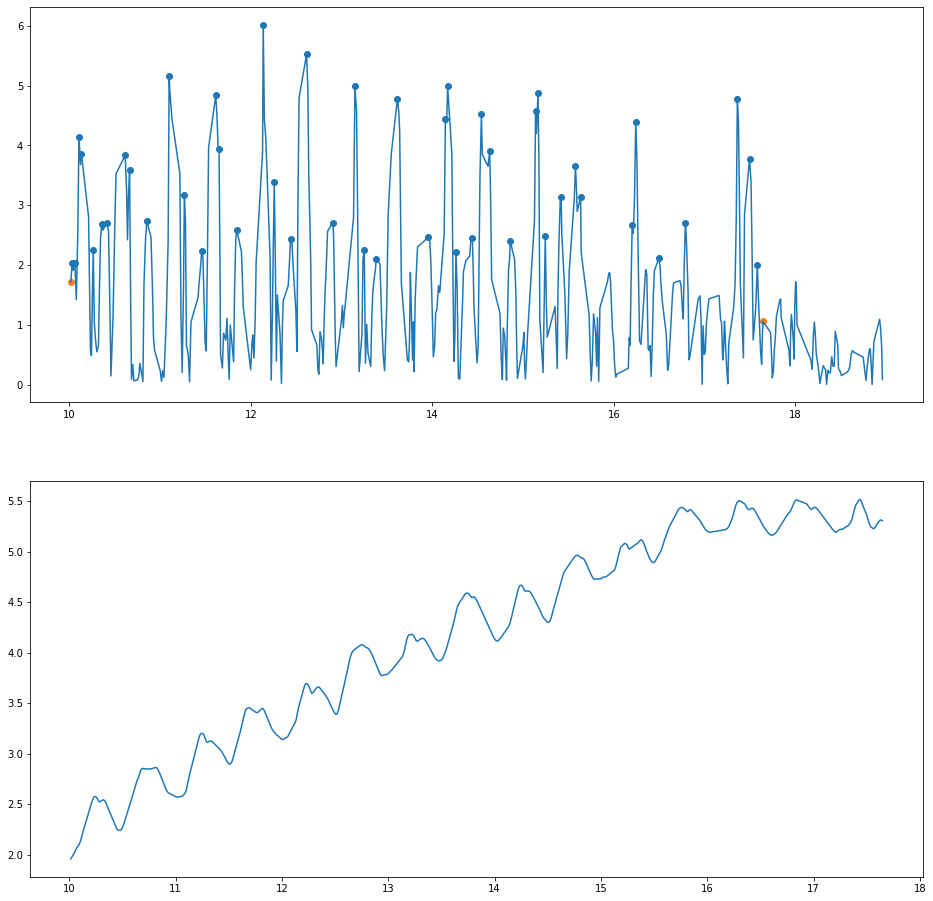

('115', 59, 'Female', 77, 70, False, 7.6315, 46, 0.1683, 293.17400000000004, 4.1882, 31.8265, 34460.2725)
('115', 59, 'Female', 77, 70, False, 7.6315, 46, 0.1683, 293.17400000000004, 4.1882, 31.8265, 34460.2725, 0.3517)
('115', 59, 'Female', 77, 70, False, 7.6315, 46, 0.1683, 293.17400000000004, 4.1882, 31.8265, 34460.2725, 0.3517, 0.0261, 0.0843, -0.0138, 9, 234, 'None')


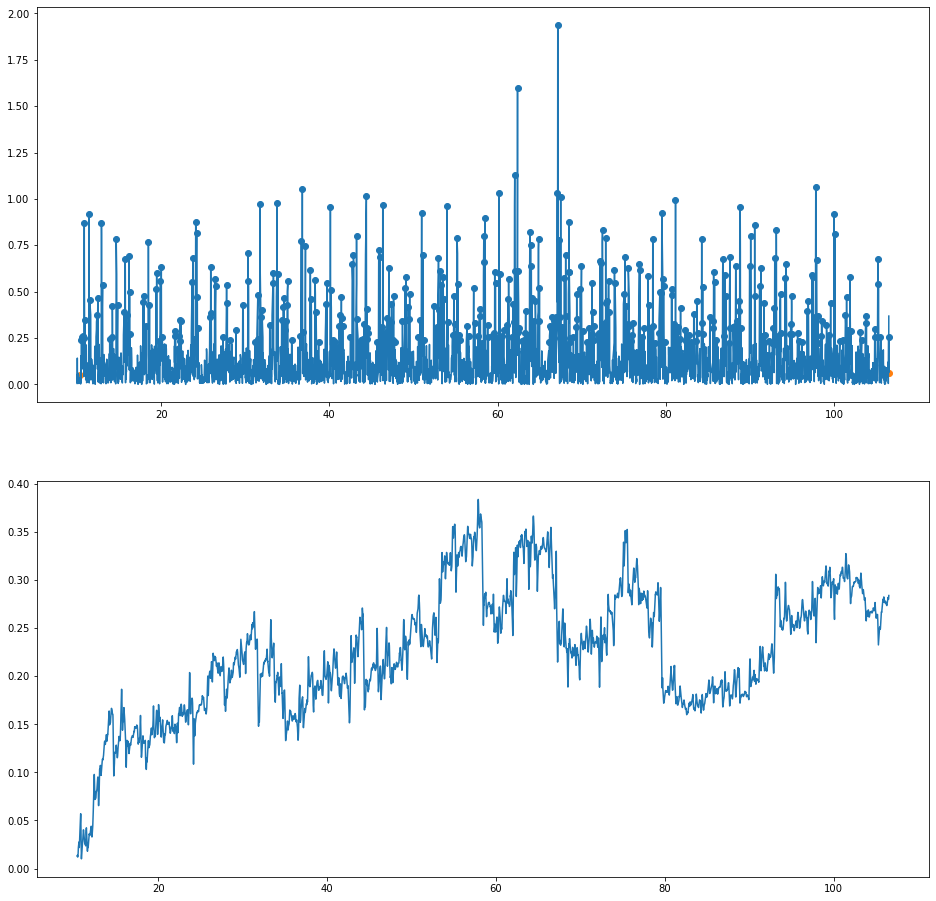

('116', 60, 'Female', 80, 50, True, 96.0965, 403, 0.2392, 11.25, 0.225, 21.574, -105.4695)
('116', 60, 'Female', 80, 50, True, 96.0965, 403, 0.2392, 11.25, 0.225, 21.574, -105.4695, 0.3649)
('116', 60, 'Female', 80, 50, True, 96.0965, 403, 0.2392, 11.25, 0.225, 21.574, -105.4695, 0.3649, -0.0074, -0.0212, 0.0668, 9, 234, 'None')


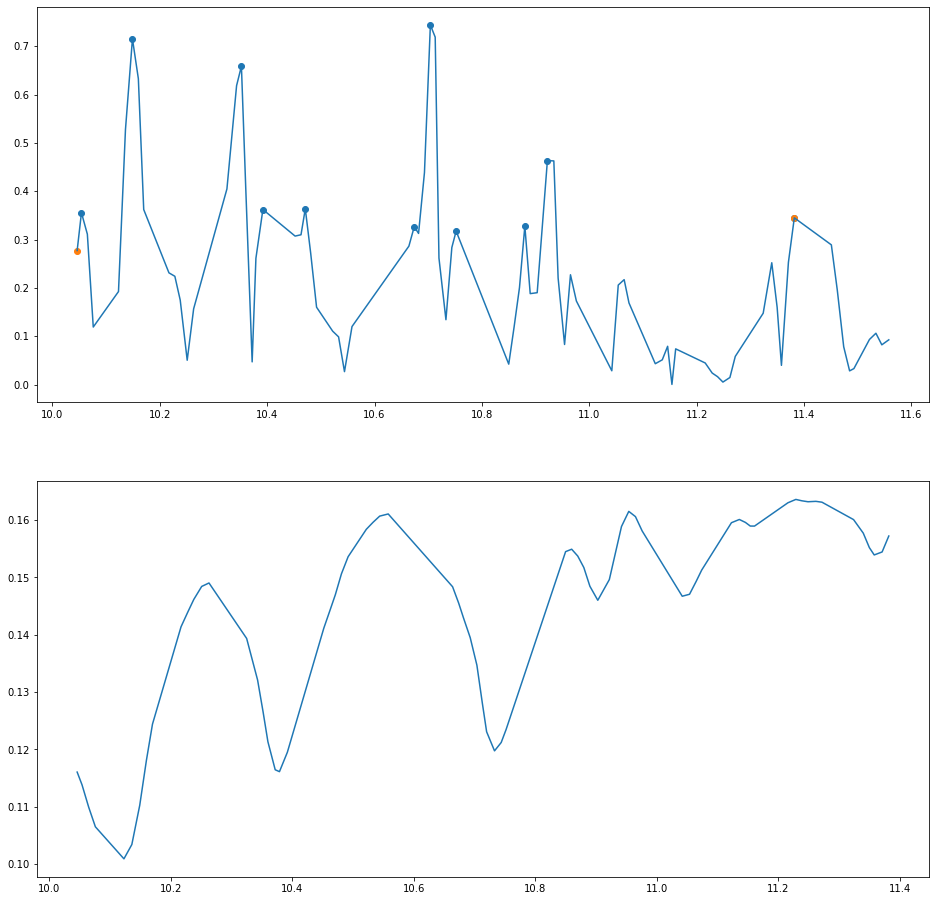

('117', 60, 'Female', 80, 50, True, 1.3365, 11, 0.1333, 7.195, 0.1439, 0.1919, 0.9855)
('117', 60, 'Female', 80, 50, True, 1.3365, 11, 0.1333, 7.195, 0.1439, 0.1919, 0.9855, 0.5723)
('117', 60, 'Female', 80, 50, True, 1.3365, 11, 0.1333, 7.195, 0.1439, 0.1919, 0.9855, 0.5723, -0.0009, -0.0011, 0.0005, 9, 234, 'None')


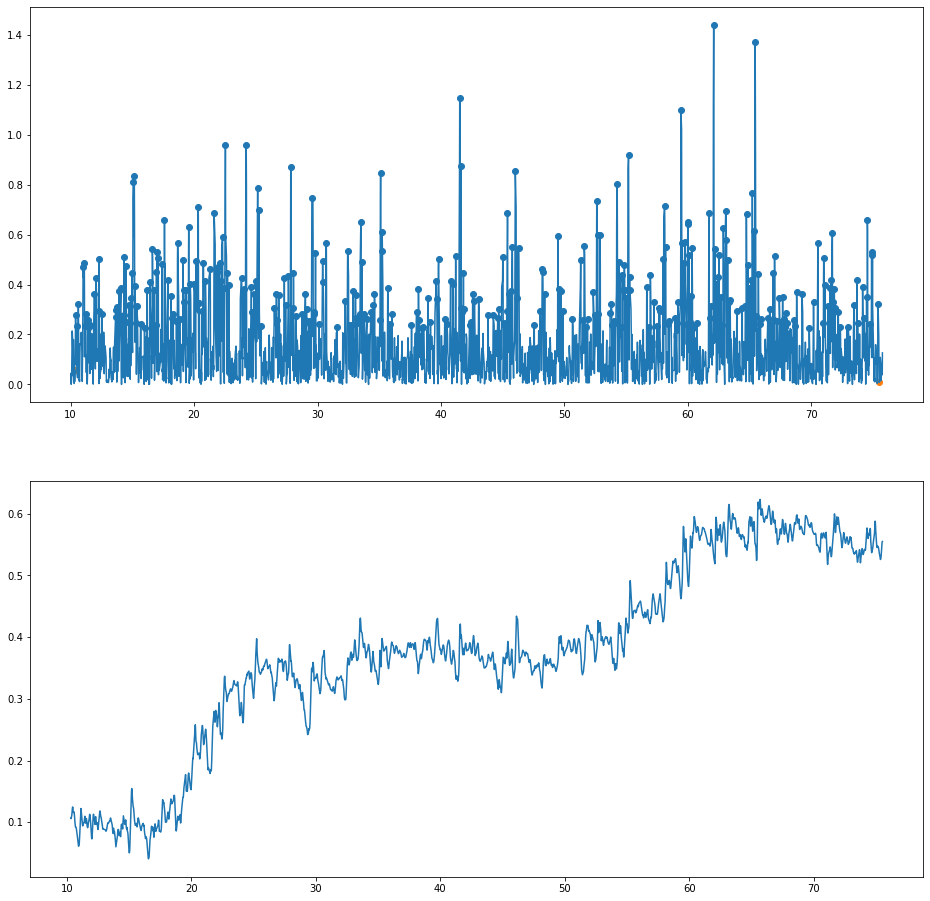

('118', 61, 'Female', 80, 40, True, 65.1955, 326, 0.2005, 14.992, 0.3748, 24.3886, 76.9525)
('118', 61, 'Female', 80, 40, True, 65.1955, 326, 0.2005, 14.992, 0.3748, 24.3886, 76.9525, 1.6816)
('118', 61, 'Female', 80, 40, True, 65.1955, 326, 0.2005, 14.992, 0.3748, 24.3886, 76.9525, 1.6816, 0.0953, -0.0347, 0.0569, 8, 234, 'None')


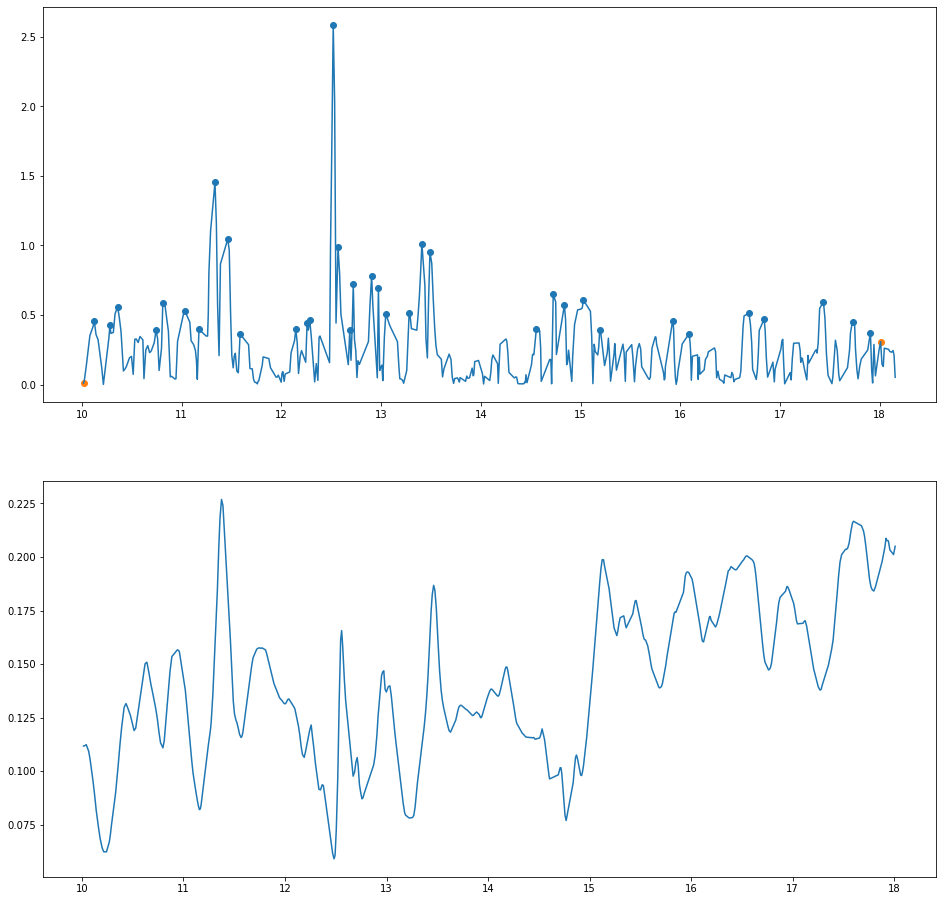

('119', 61, 'Female', 80, 40, True, 7.9935, 35, 0.2294, 5.699999999999999, 0.1425, 1.1341, 17.7005)
('119', 61, 'Female', 80, 40, True, 7.9935, 35, 0.2294, 5.699999999999999, 0.1425, 1.1341, 17.7005, 0.5365)
('119', 61, 'Female', 80, 40, True, 7.9935, 35, 0.2294, 5.699999999999999, 0.1425, 1.1341, 17.7005, 0.5365, -0.0445, 0.0206, -0.015, 8, 234, 'None')


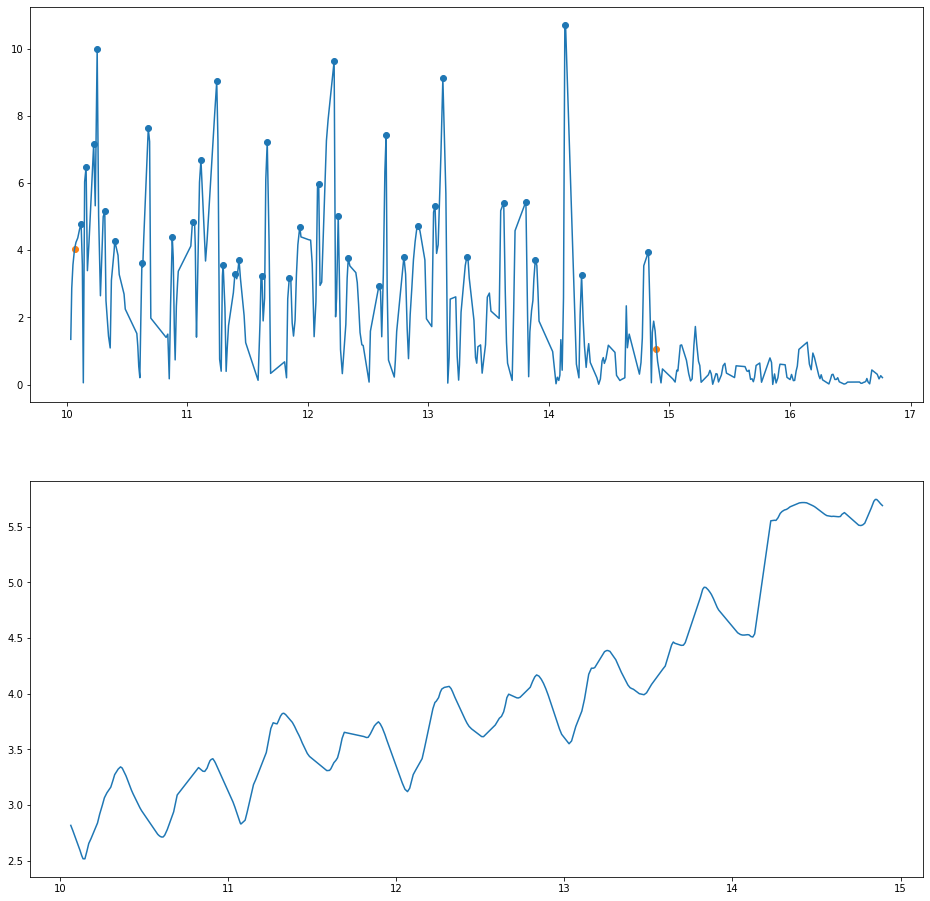

('120', 62, 'Male', 87, 61, False, 4.8285, 36, 0.135, 242.7312, 3.9792, 19.1984, 32172.6998)
('120', 62, 'Male', 87, 61, False, 4.8285, 36, 0.135, 242.7312, 3.9792, 19.1984, 32172.6998, 0.1044)
('120', 62, 'Male', 87, 61, False, 4.8285, 36, 0.135, 242.7312, 3.9792, 19.1984, 32172.6998, 0.1044, 0.0134, 0.0359, -0.0166, 10, 234, 'None')


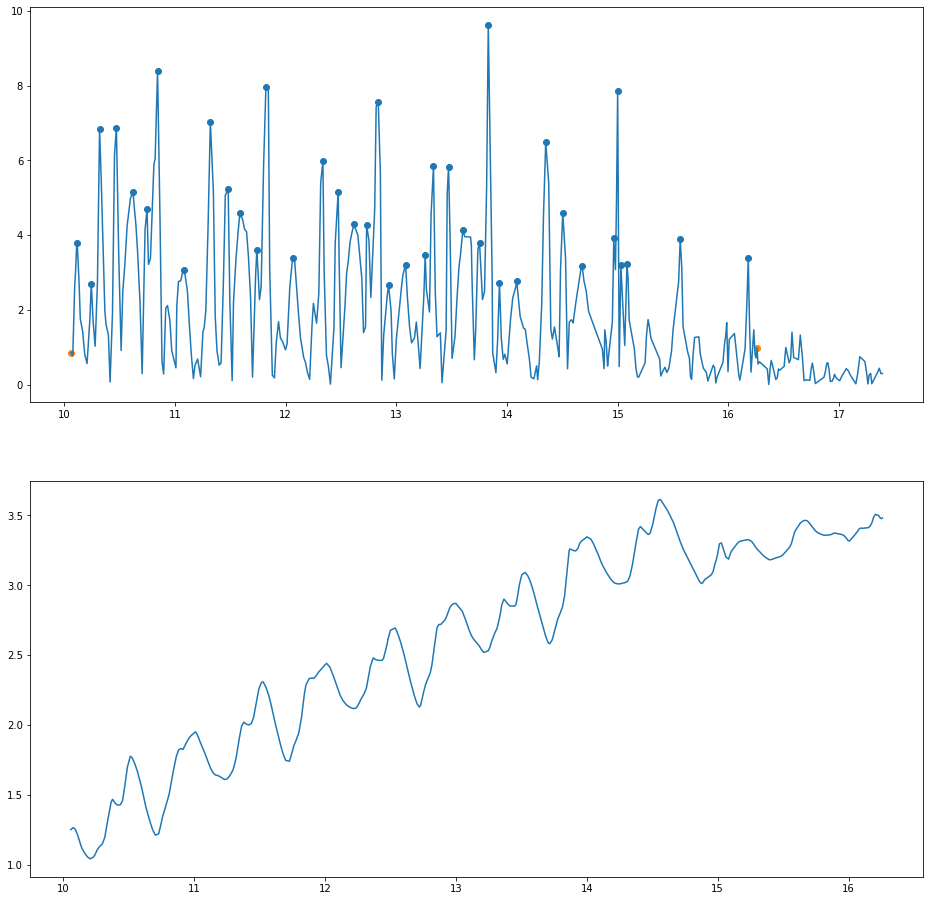

('121', 62, 'Male', 87, 61, False, 6.2005, 38, 0.1645, 156.6724, 2.5684, 16.0253, 18289.4719)
('121', 62, 'Male', 87, 61, False, 6.2005, 38, 0.1645, 156.6724, 2.5684, 16.0253, 18289.4719, 0.3371)
('121', 62, 'Male', 87, 61, False, 6.2005, 38, 0.1645, 156.6724, 2.5684, 16.0253, 18289.4719, 0.3371, -0.0266, 0.0214, 0.0485, 10, 234, 'None')


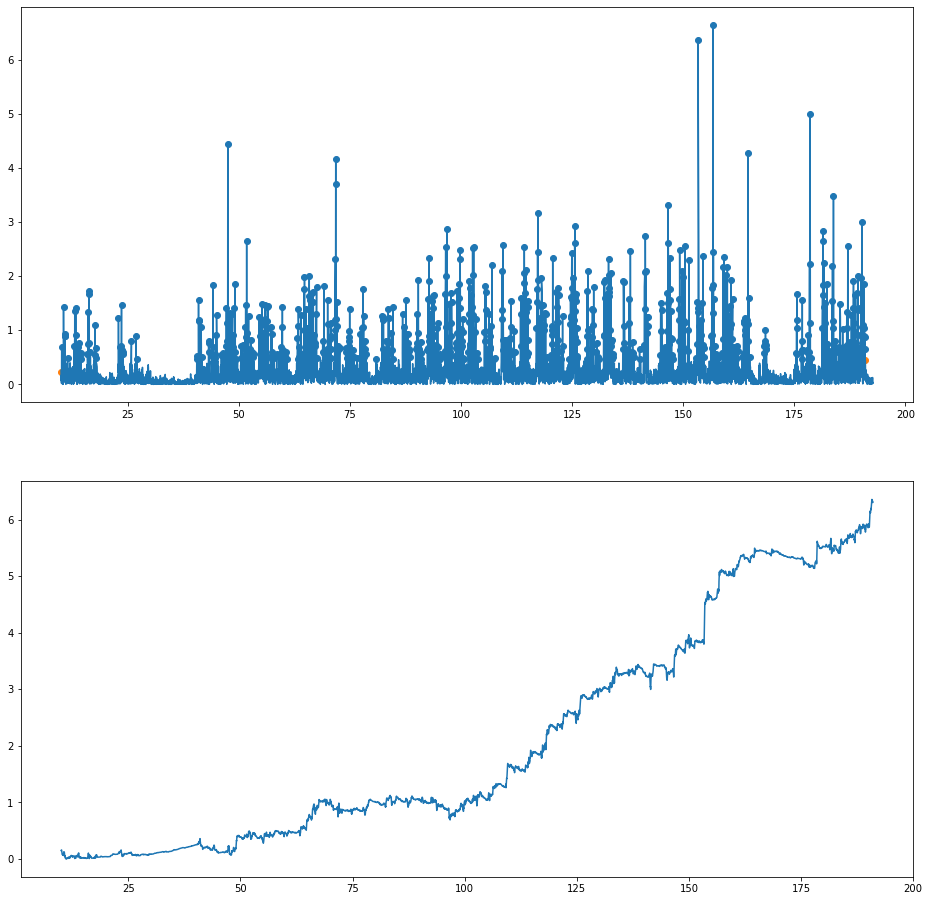

('122', 63, 'Female', 82, 45, True, 180.9205, 815, 0.2225, 95.1795, 2.1151, 382.4149, 48059.366)
('122', 63, 'Female', 82, 45, True, 180.9205, 815, 0.2225, 95.1795, 2.1151, 382.4149, 48059.366, 0.9038)
('122', 63, 'Female', 82, 45, True, 180.9205, 815, 0.2225, 95.1795, 2.1151, 382.4149, 48059.366, 0.9038, -0.11, 0.0451, -0.0446, 10, 234, 'None')


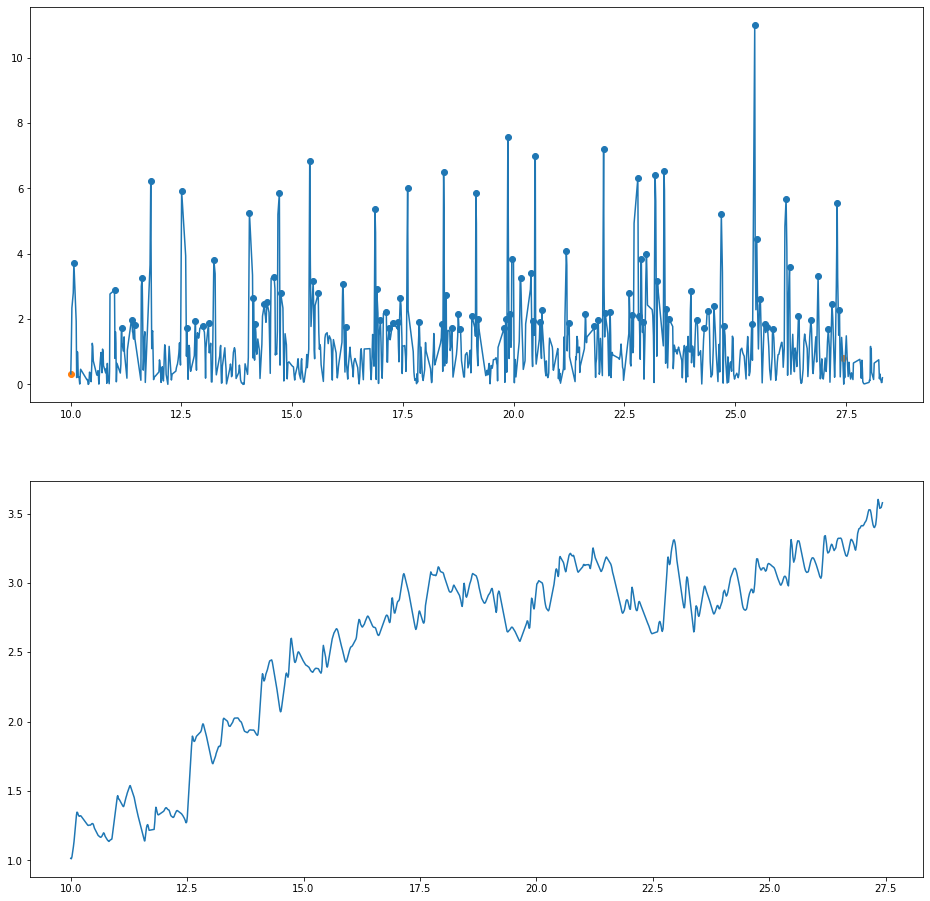

('123', 64, 'Female', 95, 55, True, 17.4245, 99, 0.1768, 141.988, 2.5816, 44.9049, 21206.323)
('123', 64, 'Female', 95, 55, True, 17.4245, 99, 0.1768, 141.988, 2.5816, 44.9049, 21206.323, 1.2529)
('123', 64, 'Female', 95, 55, True, 17.4245, 99, 0.1768, 141.988, 2.5816, 44.9049, 21206.323, 1.2529, -0.0498, 0.03, -0.0334, 9, 234, 'None')


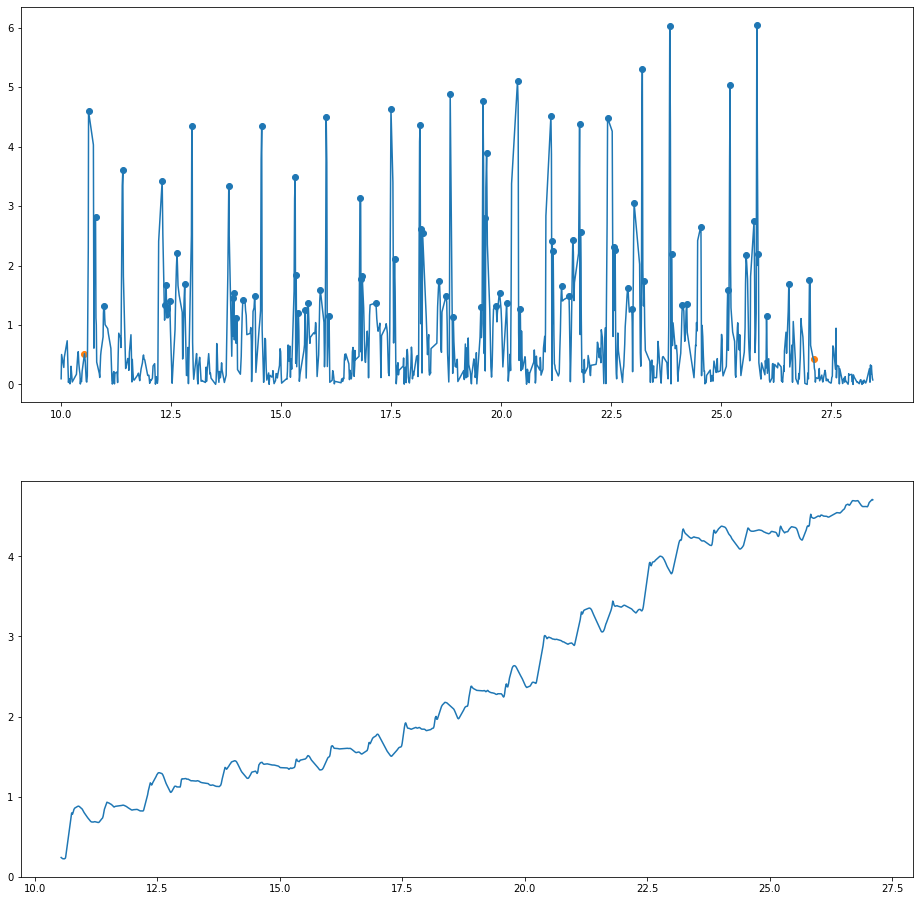

('124', 64, 'Female', 95, 55, True, 16.5615, 79, 0.2104, 137.9455, 2.5081, 41.3676, 20447.862)
('124', 64, 'Female', 95, 55, True, 16.5615, 79, 0.2104, 137.9455, 2.5081, 41.3676, 20447.862, 0.6478)
('124', 64, 'Female', 95, 55, True, 16.5615, 79, 0.2104, 137.9455, 2.5081, 41.3676, 20447.862, 0.6478, 0.0129, -0.2118, 0.0706, 9, 234, 'None')


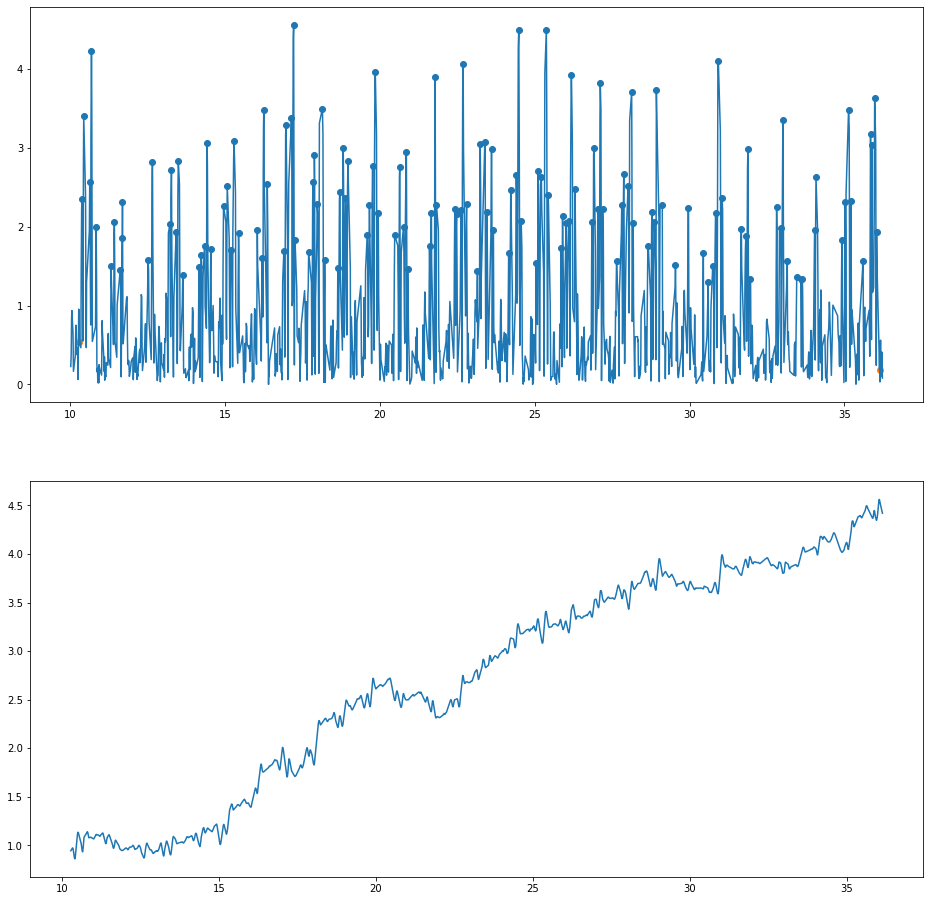

('125', 66, 'Female', 87, 70, False, 25.8515, 133, 0.1949, 190.07799999999997, 2.7154, 70.1122, 26669.6995)
('125', 66, 'Female', 87, 70, False, 25.8515, 133, 0.1949, 190.07799999999997, 2.7154, 70.1122, 26669.6995, 0.4822)
('125', 66, 'Female', 87, 70, False, 25.8515, 133, 0.1949, 190.07799999999997, 2.7154, 70.1122, 26669.6995, 0.4822, 0.0306, -0.0136, 0.0139, 9, 222, 'Anxiety')
('125', 66, 'Female', 87, 70, False, 25.8515, 133, 0.1949, 190.07799999999997, 2.7154, 70.1122, 26669.6995, 0.4822, 0.0306, -0.0136, 0.0139, 9, 104, 'Arterial Hypertension')


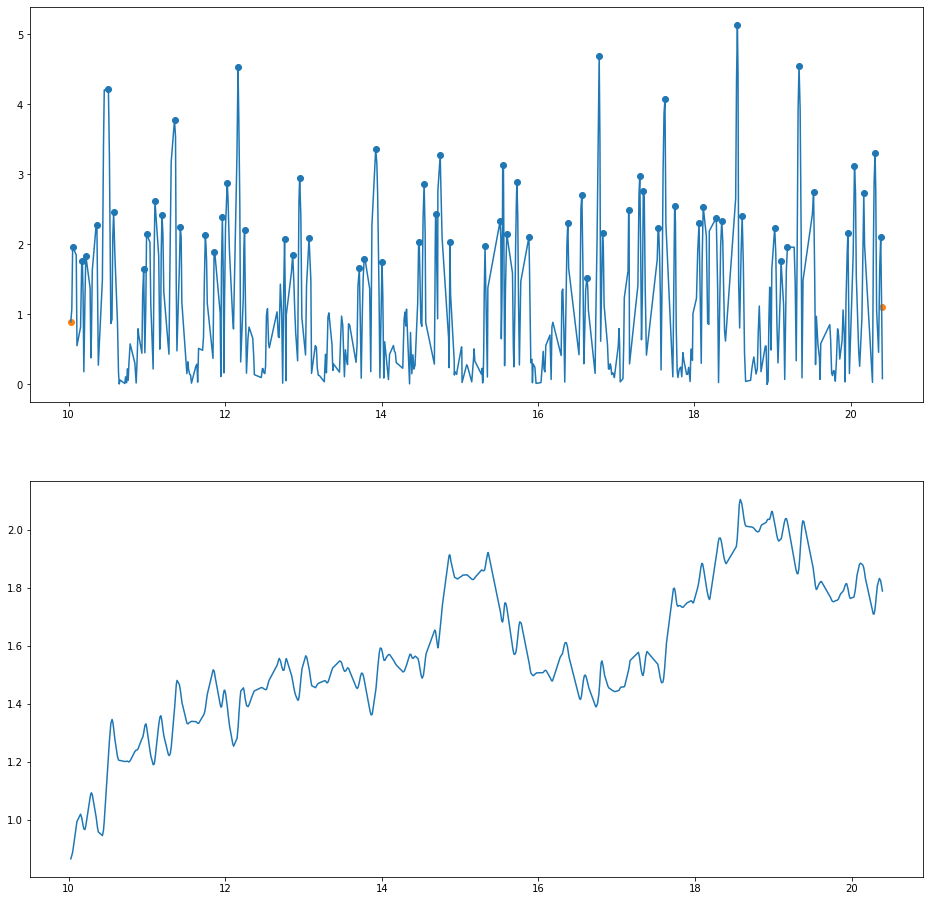

('126', 66, 'Female', 87, 70, False, 10.3665, 64, 0.1645, 110.565, 1.5795, 16.3862, 9075.2065)
('126', 66, 'Female', 87, 70, False, 10.3665, 64, 0.1645, 110.565, 1.5795, 16.3862, 9075.2065, 0.0972)
('126', 66, 'Female', 87, 70, False, 10.3665, 64, 0.1645, 110.565, 1.5795, 16.3862, 9075.2065, 0.0972, 0.0356, -0.038, 0.0043, 9, 222, 'Anxiety')
('126', 66, 'Female', 87, 70, False, 10.3665, 64, 0.1645, 110.565, 1.5795, 16.3862, 9075.2065, 0.0972, 0.0356, -0.038, 0.0043, 9, 104, 'Arterial Hypertension')


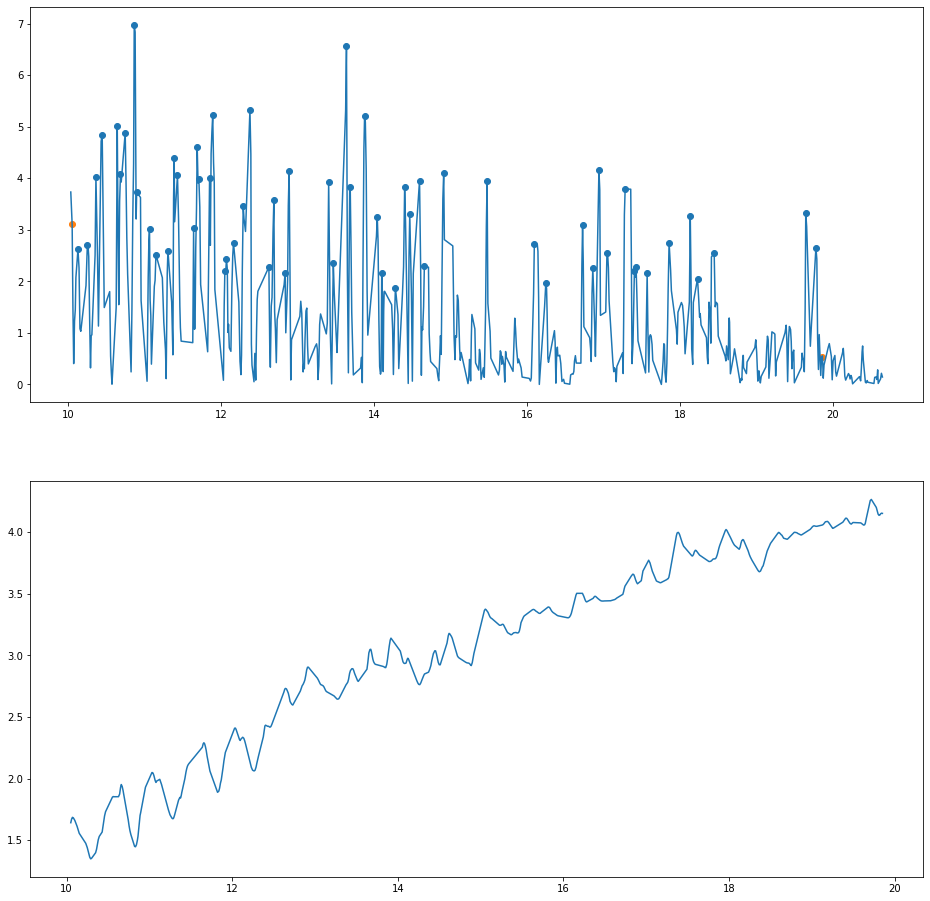

('127', 67, 'Female', 88, 69, False, 9.8055, 58, 0.1699, 210.2223, 3.0467, 29.8644, 19726.4519)
('127', 67, 'Female', 88, 69, False, 9.8055, 58, 0.1699, 210.2223, 3.0467, 29.8644, 19726.4519, 0.3066)
('127', 67, 'Female', 88, 69, False, 9.8055, 58, 0.1699, 210.2223, 3.0467, 29.8644, 19726.4519, 0.3066, -0.0615, 0.0756, 0.0474, 9, 104, 'Arterial Hypertension')
('127', 67, 'Female', 88, 69, False, 9.8055, 58, 0.1699, 210.2223, 3.0467, 29.8644, 19726.4519, 0.3066, -0.0615, 0.0756, 0.0474, 9, 142, 'Heart Failure')
('127', 67, 'Female', 88, 69, False, 9.8055, 58, 0.1699, 210.2223, 3.0467, 29.8644, 19726.4519, 0.3066, -0.0615, 0.0756, 0.0474, 9, 105, 'Schizophrenia')


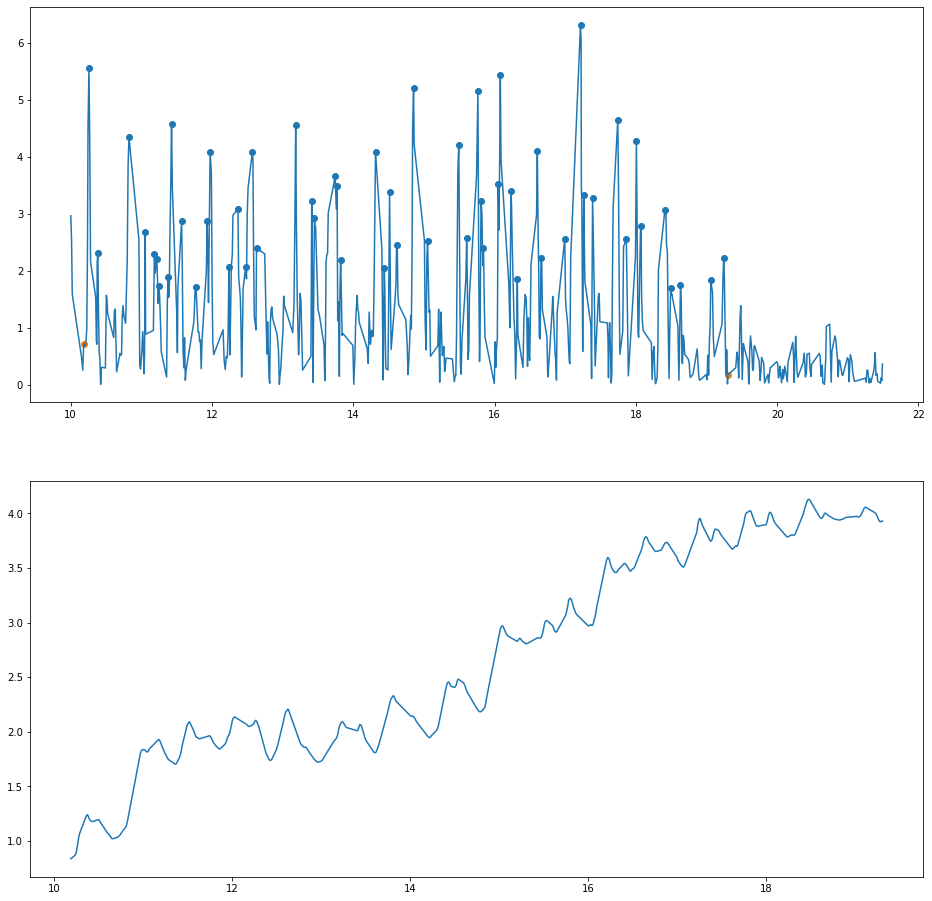

('128', 67, 'Female', 88, 69, False, 9.1165, 54, 0.17, 185.7963, 2.6927, 24.4298, 17301.4883)
('128', 67, 'Female', 88, 69, False, 9.1165, 54, 0.17, 185.7963, 2.6927, 24.4298, 17301.4883, 0.3832)
('128', 67, 'Female', 88, 69, False, 9.1165, 54, 0.17, 185.7963, 2.6927, 24.4298, 17301.4883, 0.3832, 0.0545, 0.1449, -0.1122, 9, 104, 'Arterial Hypertension')
('128', 67, 'Female', 88, 69, False, 9.1165, 54, 0.17, 185.7963, 2.6927, 24.4298, 17301.4883, 0.3832, 0.0545, 0.1449, -0.1122, 9, 142, 'Heart Failure')
('128', 67, 'Female', 88, 69, False, 9.1165, 54, 0.17, 185.7963, 2.6927, 24.4298, 17301.4883, 0.3832, 0.0545, 0.1449, -0.1122, 9, 105, 'Schizophrenia')


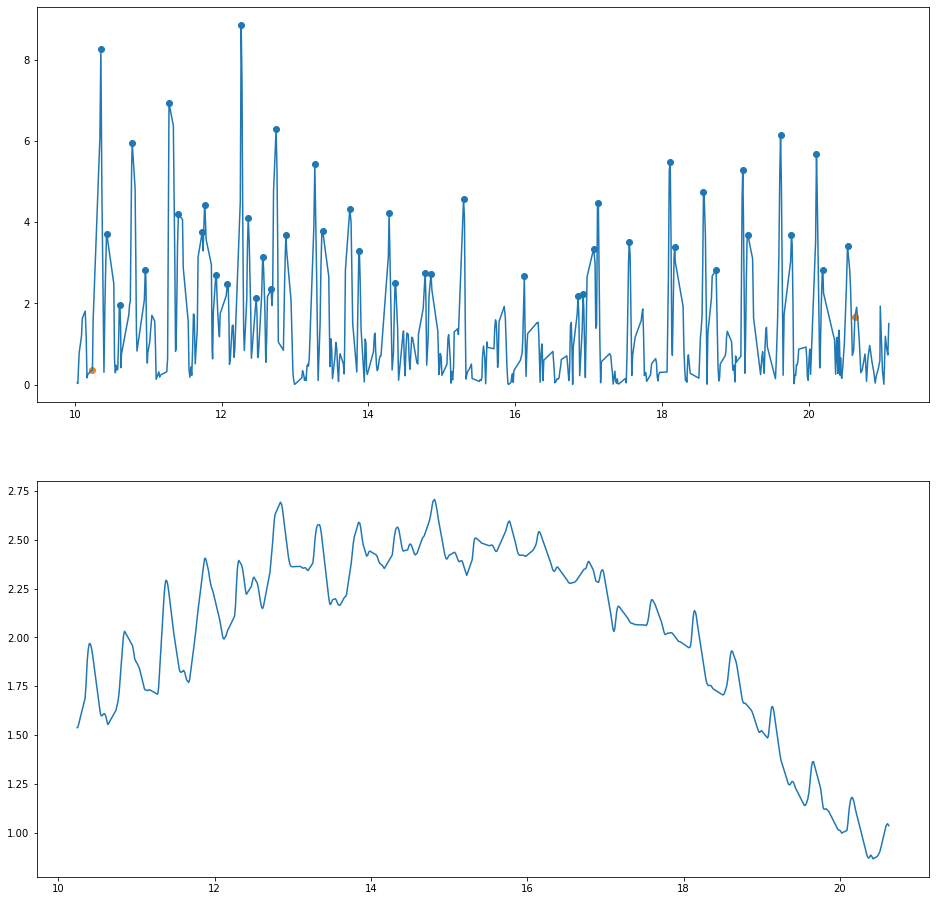

('129', 68, 'Female', 89, 60, False, 10.3855, 44, 0.237, 121.28399999999999, 2.0214, 21.1703, 10142.5385)
('129', 68, 'Female', 89, 60, False, 10.3855, 44, 0.237, 121.28399999999999, 2.0214, 21.1703, 10142.5385, 0.4776)
('129', 68, 'Female', 89, 60, False, 10.3855, 44, 0.237, 121.28399999999999, 2.0214, 21.1703, 10142.5385, 0.4776, 0.1601, -0.1369, 0.0835, 10, 213, 'Alzheimer')
('129', 68, 'Female', 89, 60, False, 10.3855, 44, 0.237, 121.28399999999999, 2.0214, 21.1703, 10142.5385, 0.4776, 0.1601, -0.1369, 0.0835, 10, 222, 'Anxiety')


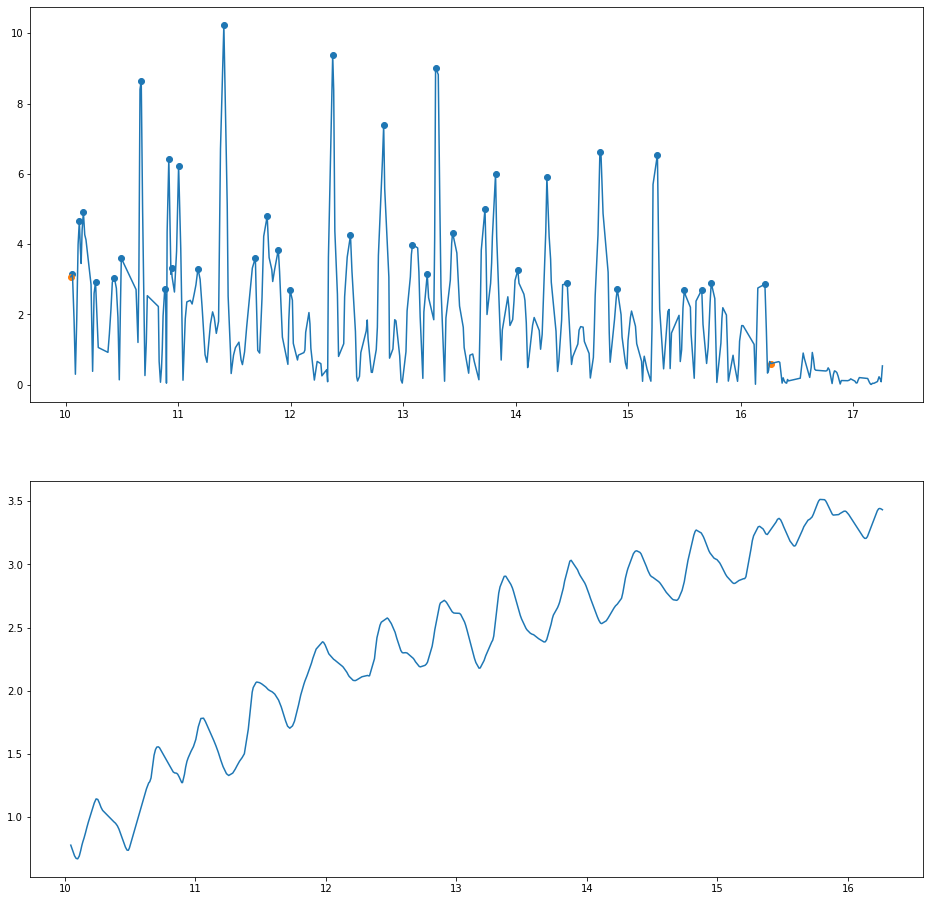

('130', 68, 'Female', 89, 60, False, 6.2195, 36, 0.1763, 140.952, 2.3492, 14.7739, 15471.4205)
('130', 68, 'Female', 89, 60, False, 6.2195, 36, 0.1763, 140.952, 2.3492, 14.7739, 15471.4205, 0.8678)
('130', 68, 'Female', 89, 60, False, 6.2195, 36, 0.1763, 140.952, 2.3492, 14.7739, 15471.4205, 0.8678, -0.0757, -0.0956, -0.1553, 10, 213, 'Alzheimer')
('130', 68, 'Female', 89, 60, False, 6.2195, 36, 0.1763, 140.952, 2.3492, 14.7739, 15471.4205, 0.8678, -0.0757, -0.0956, -0.1553, 10, 222, 'Anxiety')


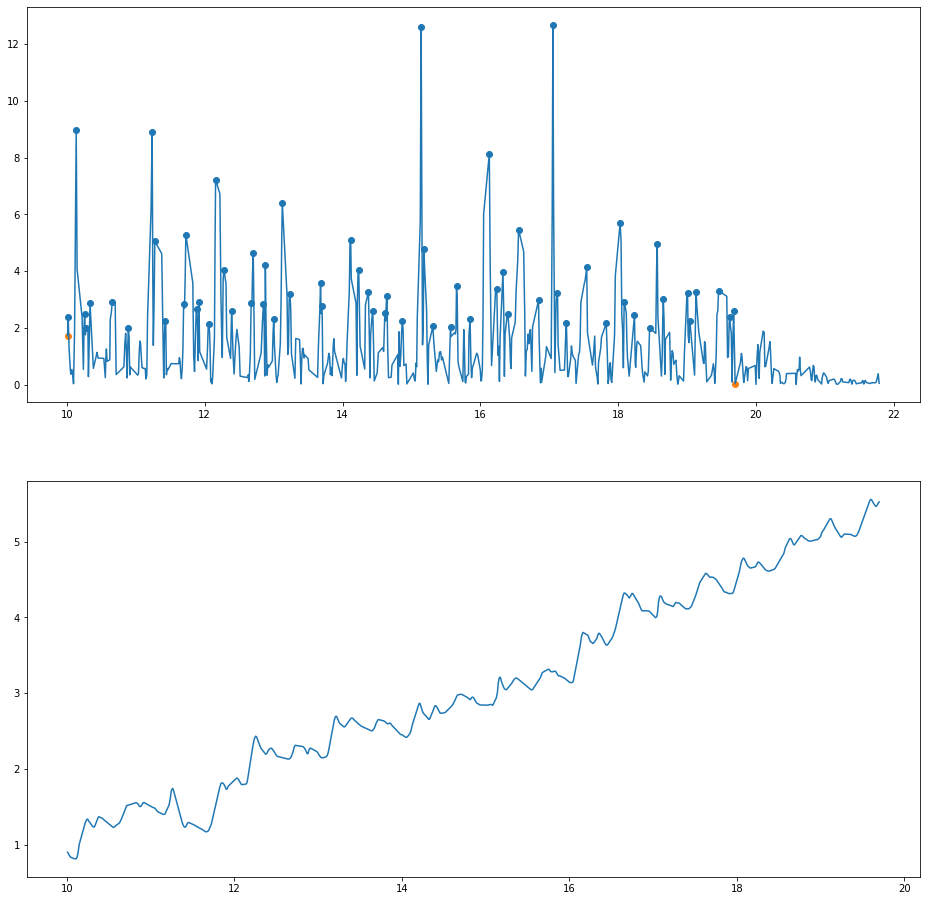

('131', 69, 'Female', 81, 73, True, 9.6895, 63, 0.1563, 225.9715, 3.0955, 29.8728, 39379.8578)
('131', 69, 'Female', 81, 73, True, 9.6895, 63, 0.1563, 225.9715, 3.0955, 29.8728, 39379.8578, 0.0728)
('131', 69, 'Female', 81, 73, True, 9.6895, 63, 0.1563, 225.9715, 3.0955, 29.8728, 39379.8578, 0.0728, 0.0674, -0.07, 0.0235, 8, 222, 'Anxiety')
('131', 69, 'Female', 81, 73, True, 9.6895, 63, 0.1563, 225.9715, 3.0955, 29.8728, 39379.8578, 0.0728, 0.0674, -0.07, 0.0235, 8, 220, 'Cholesterol')
('131', 69, 'Female', 81, 73, True, 9.6895, 63, 0.1563, 225.9715, 3.0955, 29.8728, 39379.8578, 0.0728, 0.0674, -0.07, 0.0235, 8, 235, 'Deep Vein Thrombosis')


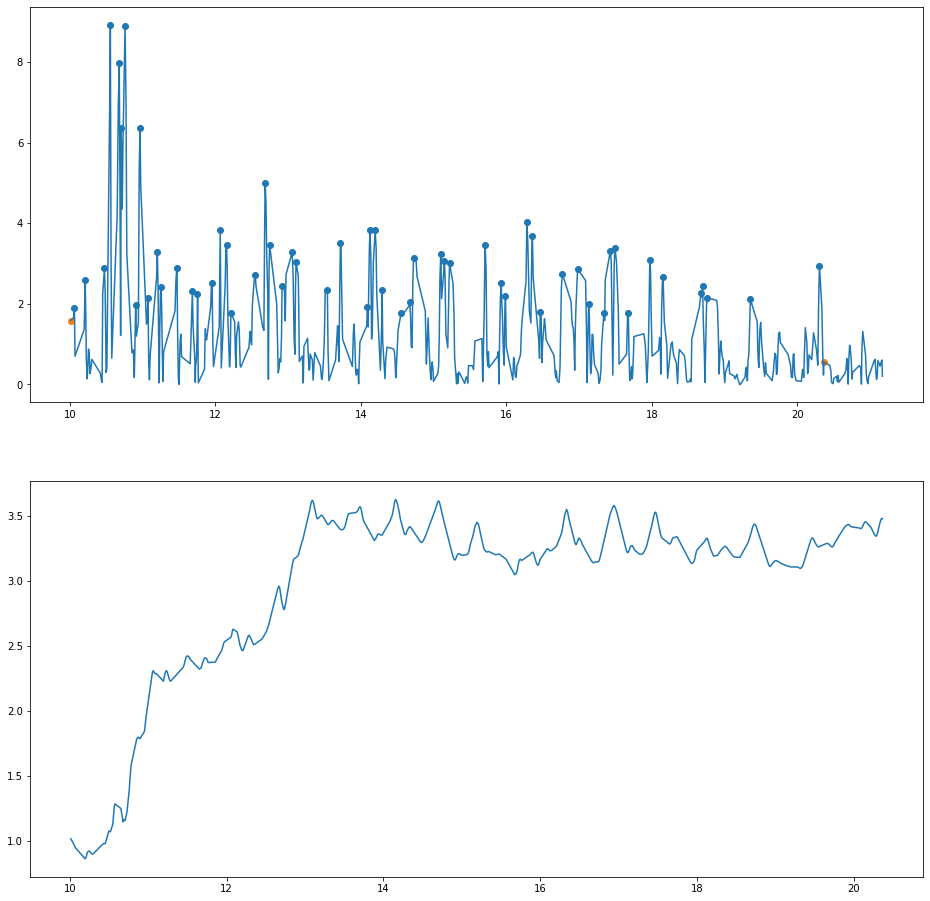

('132', 69, 'Female', 81, 73, True, 10.3515, 57, 0.1833, 217.21149999999997, 2.9755, 30.6517, 23925.5826)
('132', 69, 'Female', 81, 73, True, 10.3515, 57, 0.1833, 217.21149999999997, 2.9755, 30.6517, 23925.5826, 0.3348)
('132', 69, 'Female', 81, 73, True, 10.3515, 57, 0.1833, 217.21149999999997, 2.9755, 30.6517, 23925.5826, 0.3348, -0.0607, -0.0927, -0.101, 8, 222, 'Anxiety')
('132', 69, 'Female', 81, 73, True, 10.3515, 57, 0.1833, 217.21149999999997, 2.9755, 30.6517, 23925.5826, 0.3348, -0.0607, -0.0927, -0.101, 8, 220, 'Cholesterol')
('132', 69, 'Female', 81, 73, True, 10.3515, 57, 0.1833, 217.21149999999997, 2.9755, 30.6517, 23925.5826, 0.3348, -0.0607, -0.0927, -0.101, 8, 235, 'Deep Vein Thrombosis')


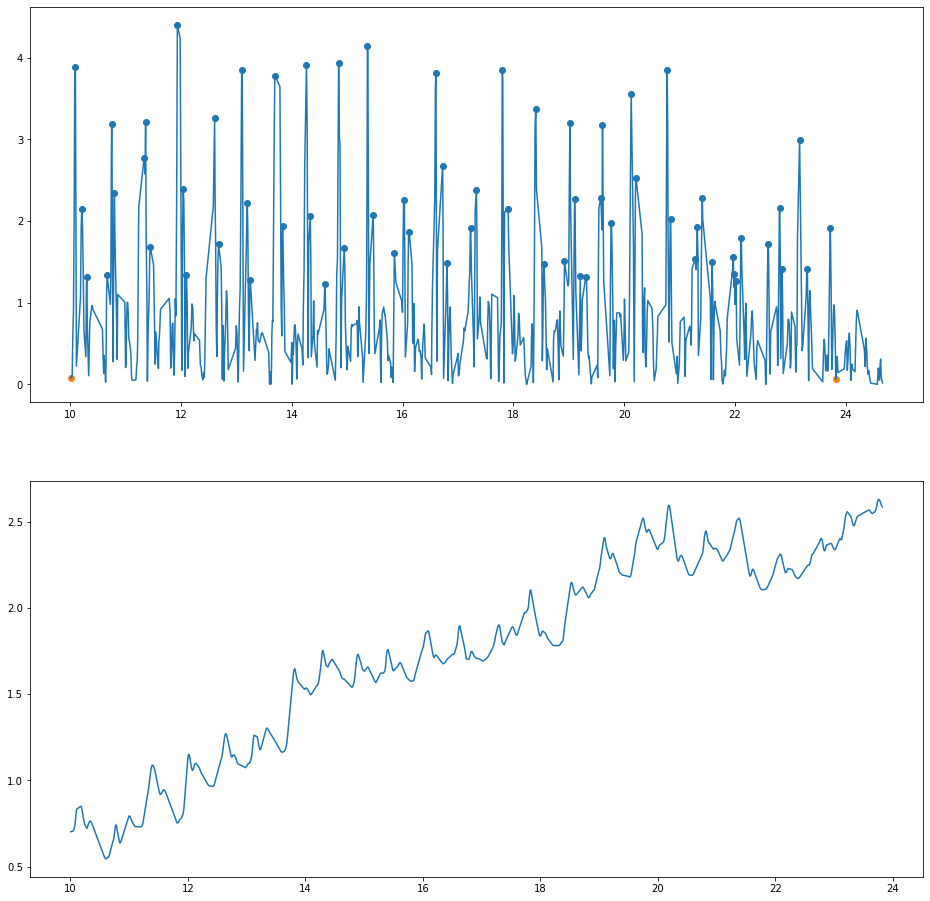

('133', 70, 'Female', 68, 85, True, 13.8135, 64, 0.2169, 148.41, 1.746, 24.0733, 16731.171)
('133', 70, 'Female', 68, 85, True, 13.8135, 64, 0.2169, 148.41, 1.746, 24.0733, 16731.171, 0.4142)
('133', 70, 'Female', 68, 85, True, 13.8135, 64, 0.2169, 148.41, 1.746, 24.0733, 16731.171, 0.4142, -0.0039, -0.0169, 0.0037, 9, 142, 'Heart Failure')
('133', 70, 'Female', 68, 85, True, 13.8135, 64, 0.2169, 148.41, 1.746, 24.0733, 16731.171, 0.4142, -0.0039, -0.0169, 0.0037, 9, 162, 'Epilepsy')
('133', 70, 'Female', 68, 85, True, 13.8135, 64, 0.2169, 148.41, 1.746, 24.0733, 16731.171, 0.4142, -0.0039, -0.0169, 0.0037, 9, 233, 'Kidney Disease')


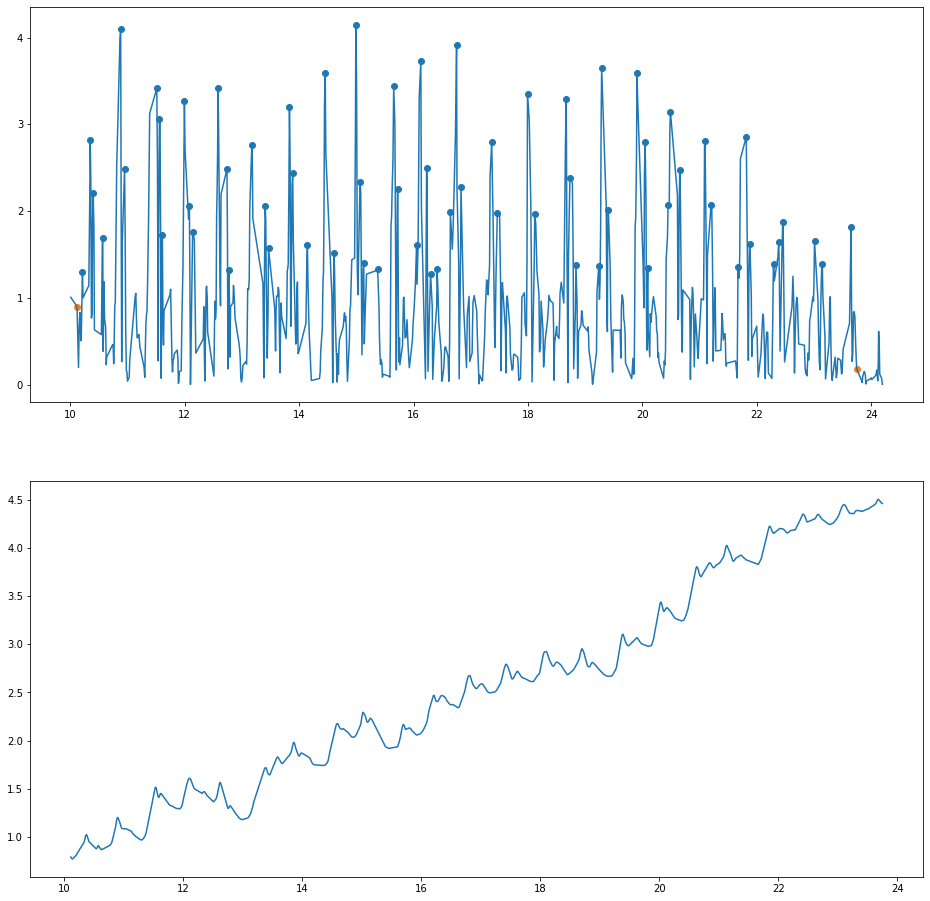

('134', 70, 'Female', 68, 85, True, 13.6295, 64, 0.2138, 217.889, 2.5634, 34.9236, 20409.5205)
('134', 70, 'Female', 68, 85, True, 13.6295, 64, 0.2138, 217.889, 2.5634, 34.9236, 20409.5205, 1.4514)
('134', 70, 'Female', 68, 85, True, 13.6295, 64, 0.2138, 217.889, 2.5634, 34.9236, 20409.5205, 1.4514, 0.0342, -0.0697, -0.0041, 9, 142, 'Heart Failure')
('134', 70, 'Female', 68, 85, True, 13.6295, 64, 0.2138, 217.889, 2.5634, 34.9236, 20409.5205, 1.4514, 0.0342, -0.0697, -0.0041, 9, 162, 'Epilepsy')
('134', 70, 'Female', 68, 85, True, 13.6295, 64, 0.2138, 217.889, 2.5634, 34.9236, 20409.5205, 1.4514, 0.0342, -0.0697, -0.0041, 9, 233, 'Kidney Disease')


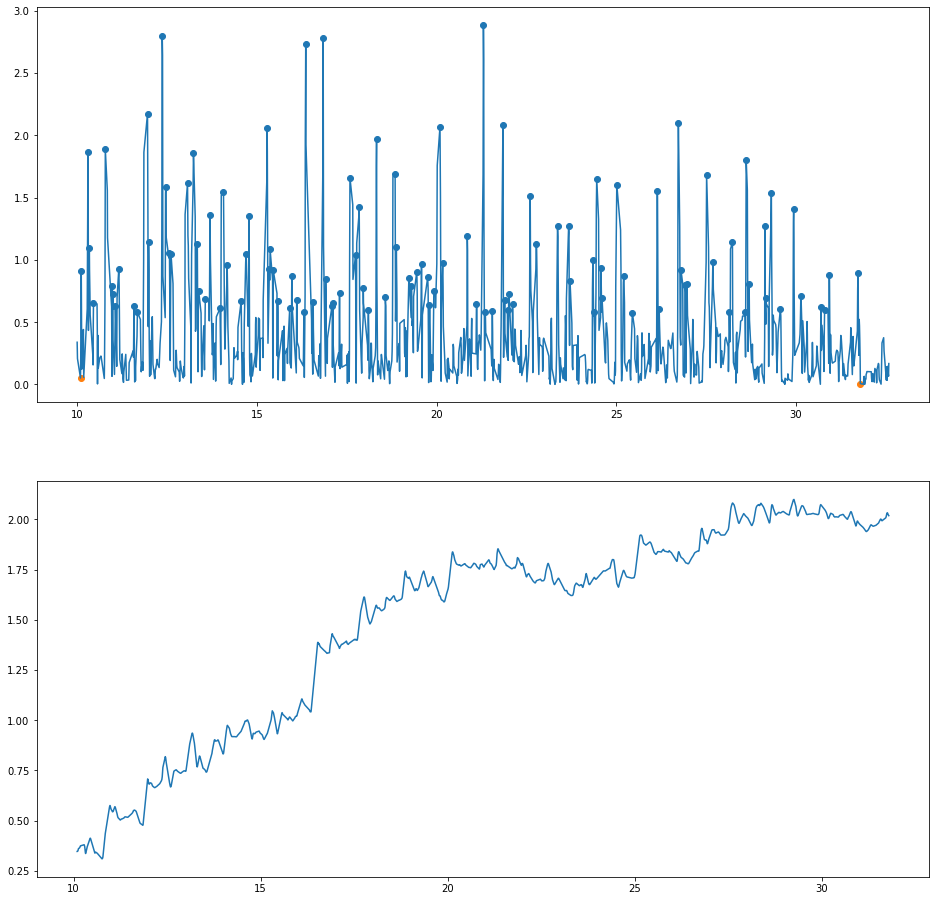

('135', 71, 'Female', 89, 57, True, 21.6895, 109, 0.2005, 84.9186, 1.4898, 32.2748, 5034.6794)
('135', 71, 'Female', 89, 57, True, 21.6895, 109, 0.2005, 84.9186, 1.4898, 32.2748, 5034.6794, 0.7899)
('135', 71, 'Female', 89, 57, True, 21.6895, 109, 0.2005, 84.9186, 1.4898, 32.2748, 5034.6794, 0.7899, 0.3731, 0.0469, 0.1378, 8, 236, 'Hyperthyroidism')
('135', 71, 'Female', 89, 57, True, 21.6895, 109, 0.2005, 84.9186, 1.4898, 32.2748, 5034.6794, 0.7899, 0.3731, 0.0469, 0.1378, 8, 222, 'Anxiety')
('135', 71, 'Female', 89, 57, True, 21.6895, 109, 0.2005, 84.9186, 1.4898, 32.2748, 5034.6794, 0.7899, 0.3731, 0.0469, 0.1378, 8, 237, 'Vertigo Syndrome')
('135', 71, 'Female', 89, 57, True, 21.6895, 109, 0.2005, 84.9186, 1.4898, 32.2748, 5034.6794, 0.7899, 0.3731, 0.0469, 0.1378, 8, 238, 'Left Atrial Dilation')


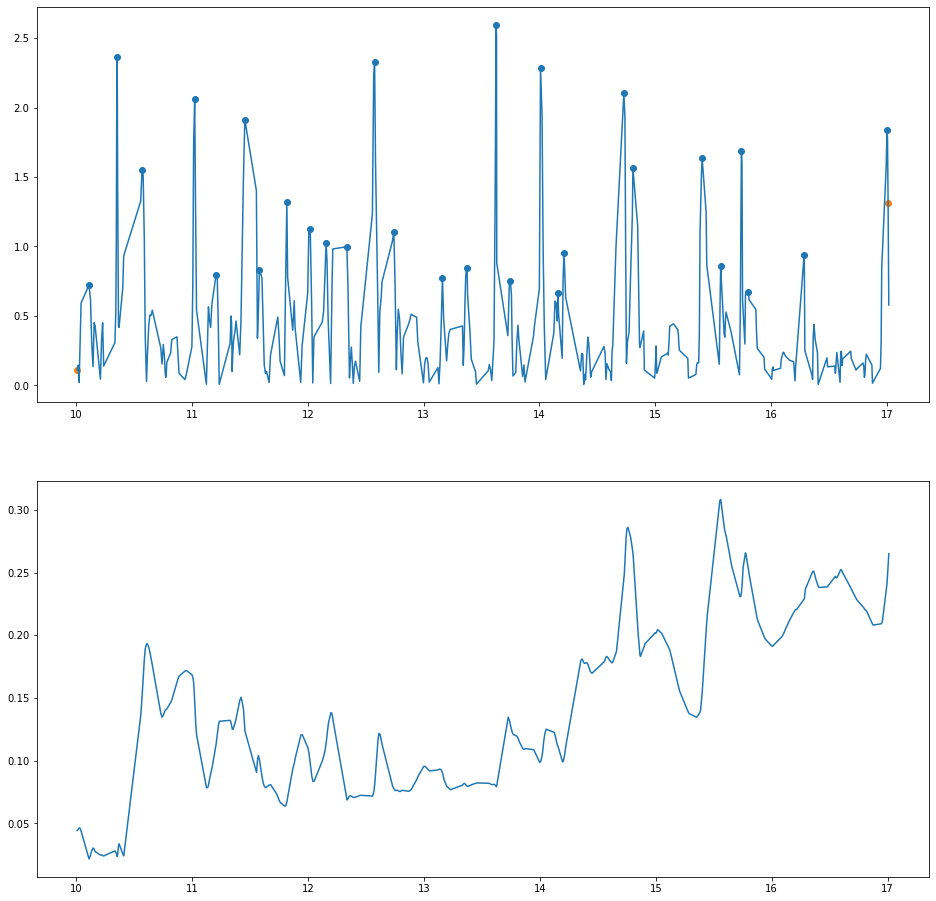

('136', 71, 'Female', 89, 57, True, 7.0045, 28, 0.2558, 8.2308, 0.1444, 0.9871, 82.4795)
('136', 71, 'Female', 89, 57, True, 7.0045, 28, 0.2558, 8.2308, 0.1444, 0.9871, 82.4795, 0.2386)
('136', 71, 'Female', 89, 57, True, 7.0045, 28, 0.2558, 8.2308, 0.1444, 0.9871, 82.4795, 0.2386, 0.0551, -0.0645, -0.0611, 8, 236, 'Hyperthyroidism')
('136', 71, 'Female', 89, 57, True, 7.0045, 28, 0.2558, 8.2308, 0.1444, 0.9871, 82.4795, 0.2386, 0.0551, -0.0645, -0.0611, 8, 222, 'Anxiety')
('136', 71, 'Female', 89, 57, True, 7.0045, 28, 0.2558, 8.2308, 0.1444, 0.9871, 82.4795, 0.2386, 0.0551, -0.0645, -0.0611, 8, 237, 'Vertigo Syndrome')
('136', 71, 'Female', 89, 57, True, 7.0045, 28, 0.2558, 8.2308, 0.1444, 0.9871, 82.4795, 0.2386, 0.0551, -0.0645, -0.0611, 8, 238, 'Left Atrial Dilation')


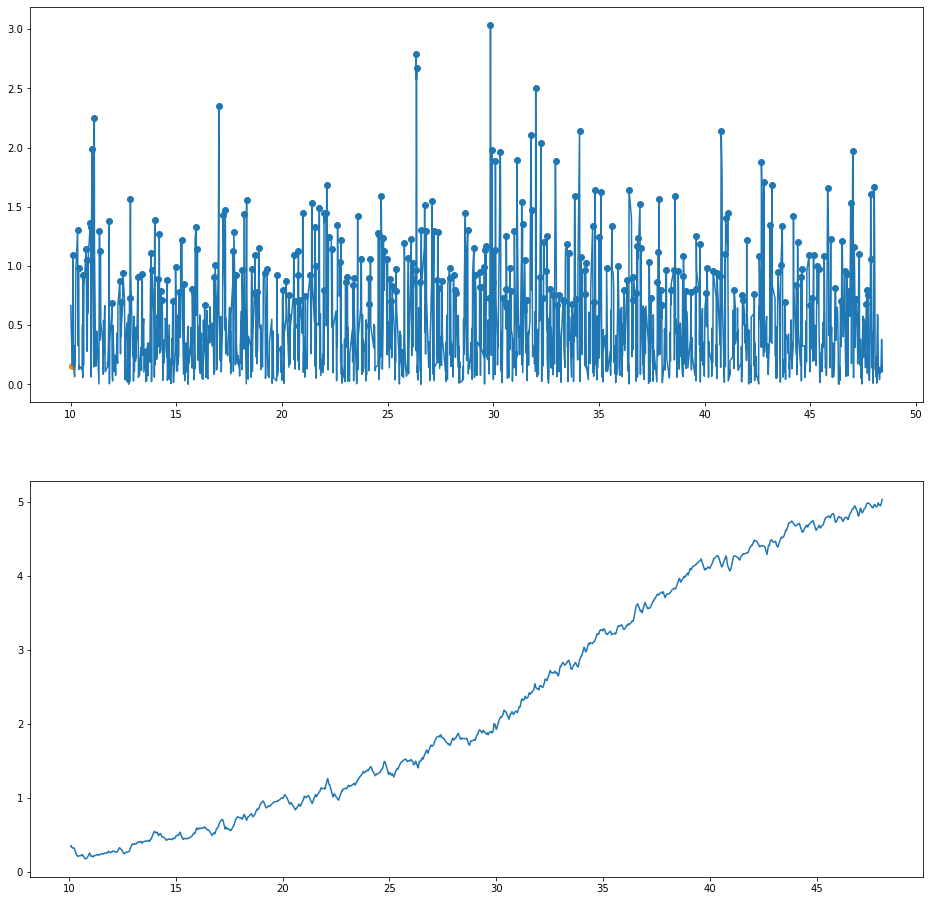

('137', 72, 'Female', 87, 50, True, 38.0025, 270, 0.1415, 115.765, 2.3153, 87.7199, 29096.1255)
('137', 72, 'Female', 87, 50, True, 38.0025, 270, 0.1415, 115.765, 2.3153, 87.7199, 29096.1255, 0.4159)
('137', 72, 'Female', 87, 50, True, 38.0025, 270, 0.1415, 115.765, 2.3153, 87.7199, 29096.1255, 0.4159, -0.0291, -0.0478, 0.163, 9, 142, 'Heart Failure')
('137', 72, 'Female', 87, 50, True, 38.0025, 270, 0.1415, 115.765, 2.3153, 87.7199, 29096.1255, 0.4159, -0.0291, -0.0478, 0.163, 9, 239, 'Venous Thrombosis')
('137', 72, 'Female', 87, 50, True, 38.0025, 270, 0.1415, 115.765, 2.3153, 87.7199, 29096.1255, 0.4159, -0.0291, -0.0478, 0.163, 9, 222, 'Anxiety')
('137', 72, 'Female', 87, 50, True, 38.0025, 270, 0.1415, 115.765, 2.3153, 87.7199, 29096.1255, 0.4159, -0.0291, -0.0478, 0.163, 9, 228, 'Benign Prostatic Hyperplasia')


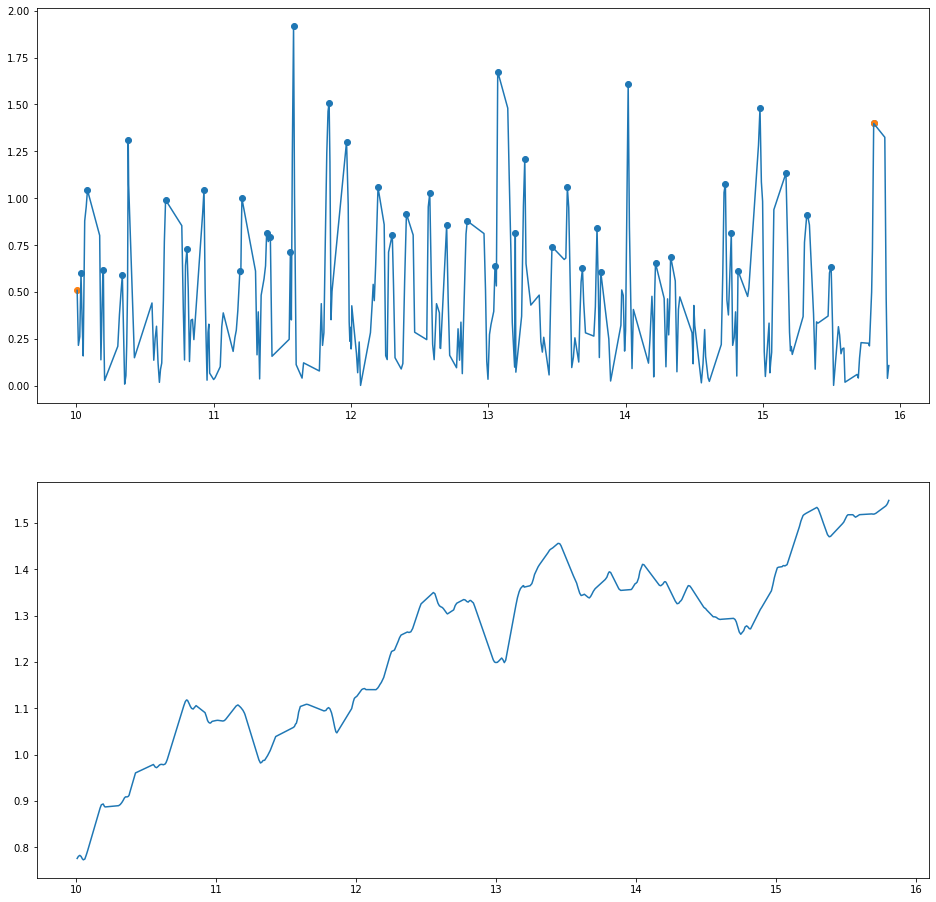

('138', 72, 'Female', 87, 50, True, 5.8015, 42, 0.1413, 61.785000000000004, 1.2357, 7.1703, 2178.9255)
('138', 72, 'Female', 87, 50, True, 5.8015, 42, 0.1413, 61.785000000000004, 1.2357, 7.1703, 2178.9255, 0.5826)
('138', 72, 'Female', 87, 50, True, 5.8015, 42, 0.1413, 61.785000000000004, 1.2357, 7.1703, 2178.9255, 0.5826, 0.0135, -0.0286, -0.0061, 9, 142, 'Heart Failure')
('138', 72, 'Female', 87, 50, True, 5.8015, 42, 0.1413, 61.785000000000004, 1.2357, 7.1703, 2178.9255, 0.5826, 0.0135, -0.0286, -0.0061, 9, 239, 'Venous Thrombosis')
('138', 72, 'Female', 87, 50, True, 5.8015, 42, 0.1413, 61.785000000000004, 1.2357, 7.1703, 2178.9255, 0.5826, 0.0135, -0.0286, -0.0061, 9, 222, 'Anxiety')
('138', 72, 'Female', 87, 50, True, 5.8015, 42, 0.1413, 61.785000000000004, 1.2357, 7.1703, 2178.9255, 0.5826, 0.0135, -0.0286, -0.0061, 9, 228, 'Benign Prostatic Hyperplasia')


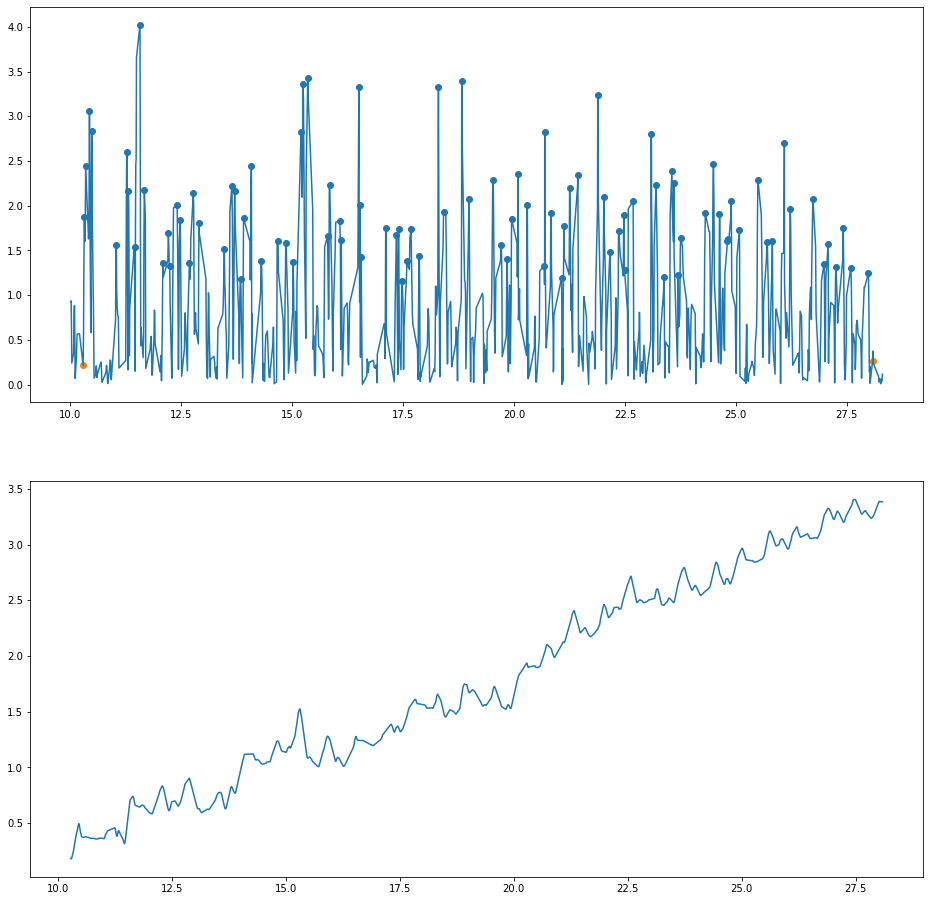

('139', 73, 'Female', 78, 72, True, 17.7965, 95, 0.1885, 128.6352, 1.7866, 31.805, 20309.5445)
('139', 73, 'Female', 78, 72, True, 17.7965, 95, 0.1885, 128.6352, 1.7866, 31.805, 20309.5445, 0.2711)
('139', 73, 'Female', 78, 72, True, 17.7965, 95, 0.1885, 128.6352, 1.7866, 31.805, 20309.5445, 0.2711, 0.3282, 0.074, 0.1438, 7, 142, 'Heart Failure')


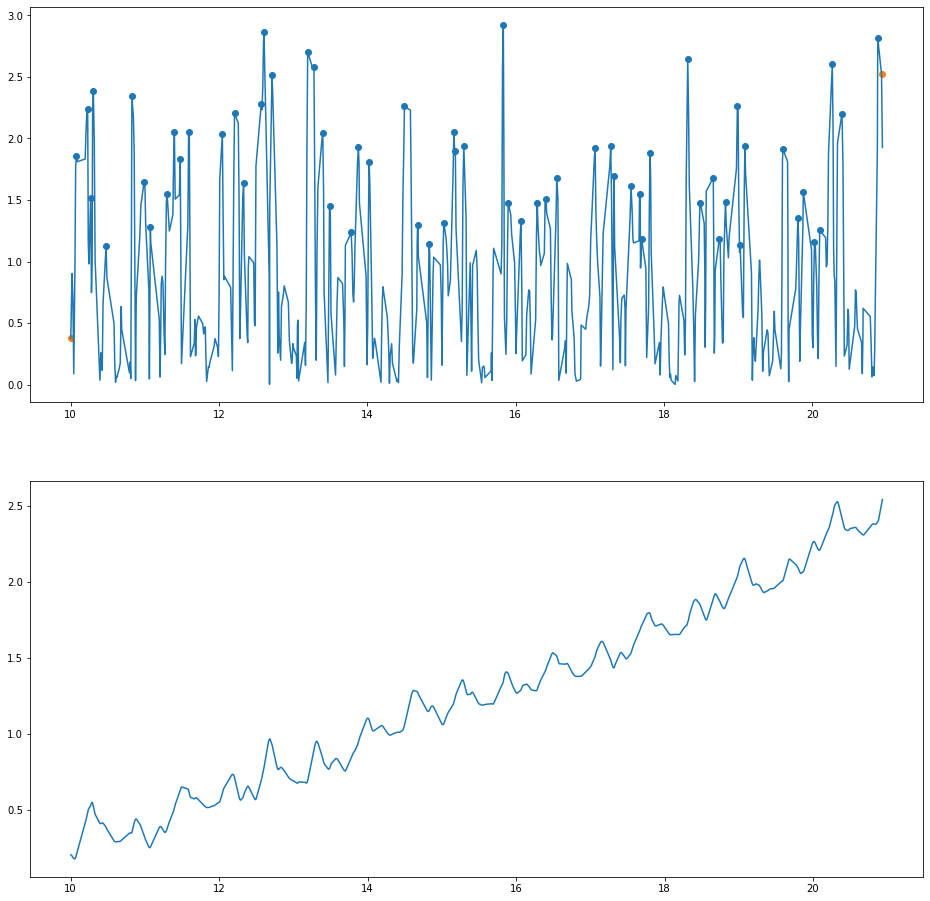

('140', 73, 'Female', 78, 72, True, 10.9335, 61, 0.1806, 90.7416, 1.2603, 13.7229, 9390.9677)
('140', 73, 'Female', 78, 72, True, 10.9335, 61, 0.1806, 90.7416, 1.2603, 13.7229, 9390.9677, 0.2201)
('140', 73, 'Female', 78, 72, True, 10.9335, 61, 0.1806, 90.7416, 1.2603, 13.7229, 9390.9677, 0.2201, 0.1023, -0.1188, -0.0483, 7, 142, 'Heart Failure')


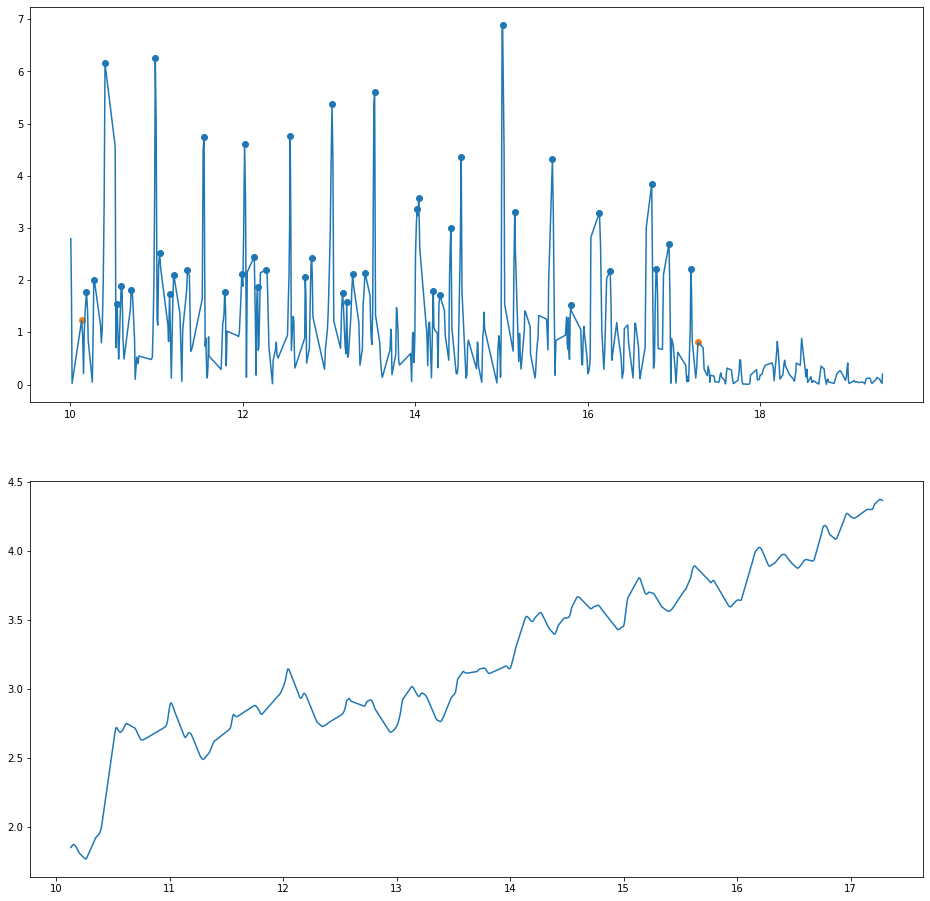

('141', 74, 'Female', 95, 56, True, 7.1495, 43, 0.1674, 180.85199999999998, 3.2295, 23.215, 26566.2717)
('141', 74, 'Female', 95, 56, True, 7.1495, 43, 0.1674, 180.85199999999998, 3.2295, 23.215, 26566.2717, 0.2389)
('141', 74, 'Female', 95, 56, True, 7.1495, 43, 0.1674, 180.85199999999998, 3.2295, 23.215, 26566.2717, 0.2389, 0.1866, -0.0026, 0.1322, 9, 104, 'Arterial Hypertension')
('141', 74, 'Female', 95, 56, True, 7.1495, 43, 0.1674, 180.85199999999998, 3.2295, 23.215, 26566.2717, 0.2389, 0.1866, -0.0026, 0.1322, 9, 106, 'Dyslipidemia')
('141', 74, 'Female', 95, 56, True, 7.1495, 43, 0.1674, 180.85199999999998, 3.2295, 23.215, 26566.2717, 0.2389, 0.1866, -0.0026, 0.1322, 9, 240, 'Glaucoma')
('141', 74, 'Female', 95, 56, True, 7.1495, 43, 0.1674, 180.85199999999998, 3.2295, 23.215, 26566.2717, 0.2389, 0.1866, -0.0026, 0.1322, 9, 241, 'Duodenal Ulcer')
('141', 74, 'Female', 95, 56, True, 7.1495, 43, 0.1674, 180.85199999999998, 3.2295, 23.215, 26566.2717, 0.2389, 0.1866, -0.0026, 0.13

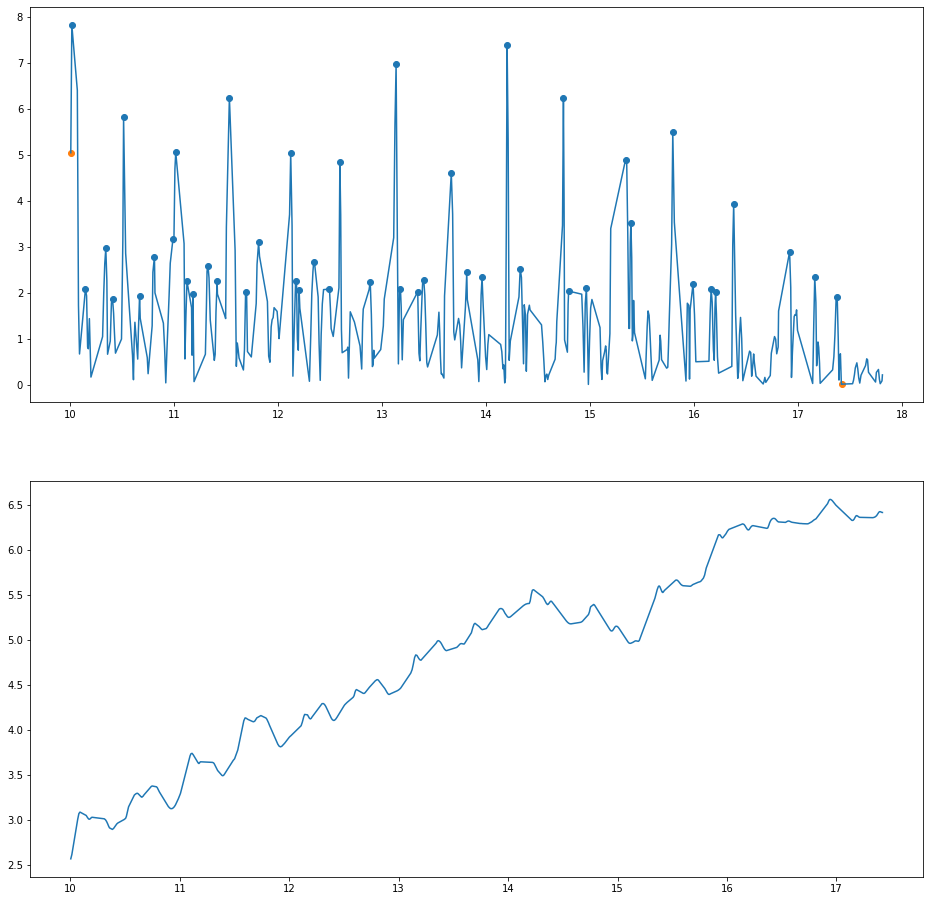

('142', 74, 'Female', 95, 56, True, 7.4175, 45, 0.1679, 272.5464, 4.8669, 35.8682, 36171.4421)
('142', 74, 'Female', 95, 56, True, 7.4175, 45, 0.1679, 272.5464, 4.8669, 35.8682, 36171.4421, 0.912)
('142', 74, 'Female', 95, 56, True, 7.4175, 45, 0.1679, 272.5464, 4.8669, 35.8682, 36171.4421, 0.912, -0.097, 0.044, 0.1817, 9, 104, 'Arterial Hypertension')
('142', 74, 'Female', 95, 56, True, 7.4175, 45, 0.1679, 272.5464, 4.8669, 35.8682, 36171.4421, 0.912, -0.097, 0.044, 0.1817, 9, 106, 'Dyslipidemia')
('142', 74, 'Female', 95, 56, True, 7.4175, 45, 0.1679, 272.5464, 4.8669, 35.8682, 36171.4421, 0.912, -0.097, 0.044, 0.1817, 9, 240, 'Glaucoma')
('142', 74, 'Female', 95, 56, True, 7.4175, 45, 0.1679, 272.5464, 4.8669, 35.8682, 36171.4421, 0.912, -0.097, 0.044, 0.1817, 9, 241, 'Duodenal Ulcer')
('142', 74, 'Female', 95, 56, True, 7.4175, 45, 0.1679, 272.5464, 4.8669, 35.8682, 36171.4421, 0.912, -0.097, 0.044, 0.1817, 9, 208, 'Depression')


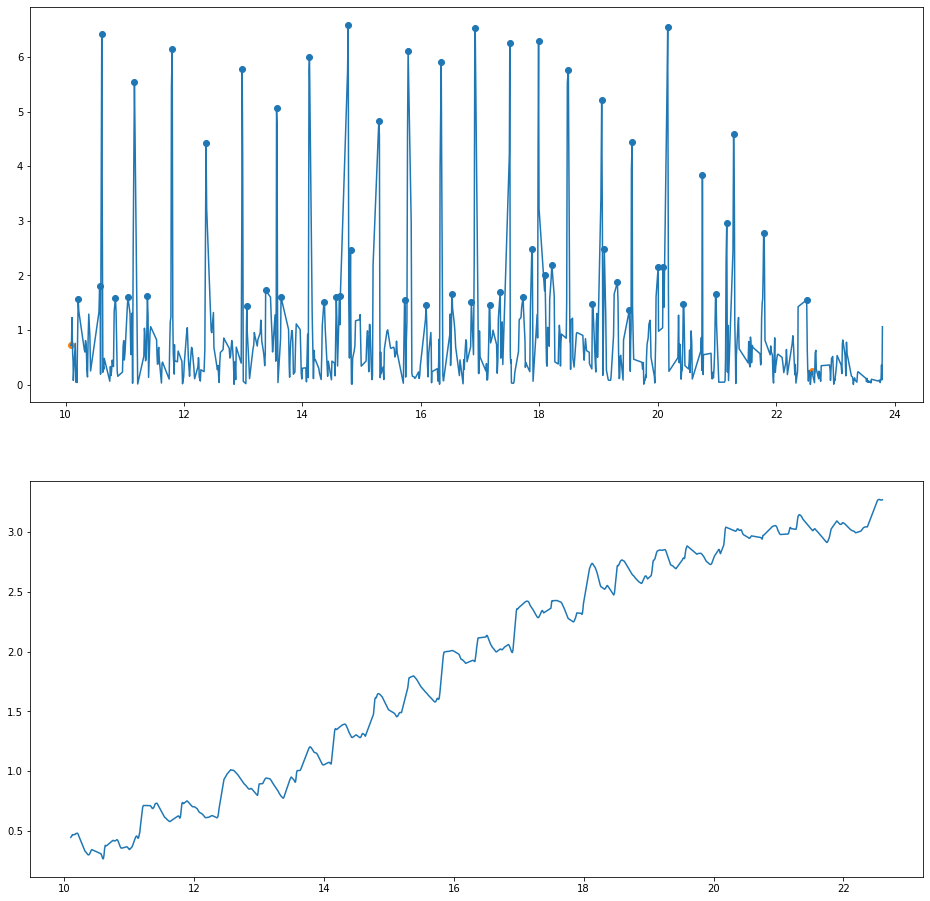

('143', 75, 'Male', 89, 69, True, 12.5035, 53, 0.2371, 129.3129, 1.8741, 23.3948, 21373.3094)
('143', 75, 'Male', 89, 69, True, 12.5035, 53, 0.2371, 129.3129, 1.8741, 23.3948, 21373.3094, 0.8778)
('143', 75, 'Male', 89, 69, True, 12.5035, 53, 0.2371, 129.3129, 1.8741, 23.3948, 21373.3094, 0.8778, 0.07, -0.0066, 0.0812, 8, 104, 'Arterial Hypertension')
('143', 75, 'Male', 89, 69, True, 12.5035, 53, 0.2371, 129.3129, 1.8741, 23.3948, 21373.3094, 0.8778, 0.07, -0.0066, 0.0812, 8, 210, 'Anemia')
('143', 75, 'Male', 89, 69, True, 12.5035, 53, 0.2371, 129.3129, 1.8741, 23.3948, 21373.3094, 0.8778, 0.07, -0.0066, 0.0812, 8, 242, 'Hyperplasia')


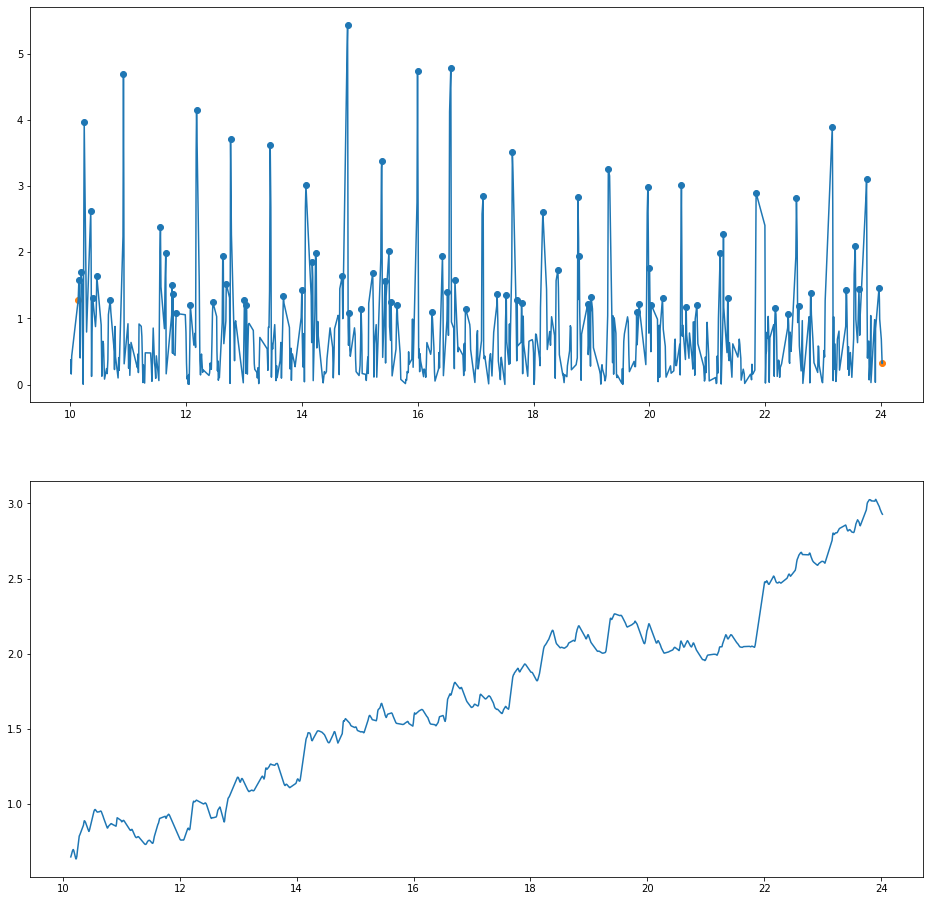

('144', 75, 'Male', 89, 69, True, 13.8885, 82, 0.1712, 118.5282, 1.7178, 23.8684, 15834.914)
('144', 75, 'Male', 89, 69, True, 13.8885, 82, 0.1712, 118.5282, 1.7178, 23.8684, 15834.914, 0.5579)
('144', 75, 'Male', 89, 69, True, 13.8885, 82, 0.1712, 118.5282, 1.7178, 23.8684, 15834.914, 0.5579, 0.0064, -0.1003, 0.1494, 8, 104, 'Arterial Hypertension')
('144', 75, 'Male', 89, 69, True, 13.8885, 82, 0.1712, 118.5282, 1.7178, 23.8684, 15834.914, 0.5579, 0.0064, -0.1003, 0.1494, 8, 210, 'Anemia')
('144', 75, 'Male', 89, 69, True, 13.8885, 82, 0.1712, 118.5282, 1.7178, 23.8684, 15834.914, 0.5579, 0.0064, -0.1003, 0.1494, 8, 242, 'Hyperplasia')


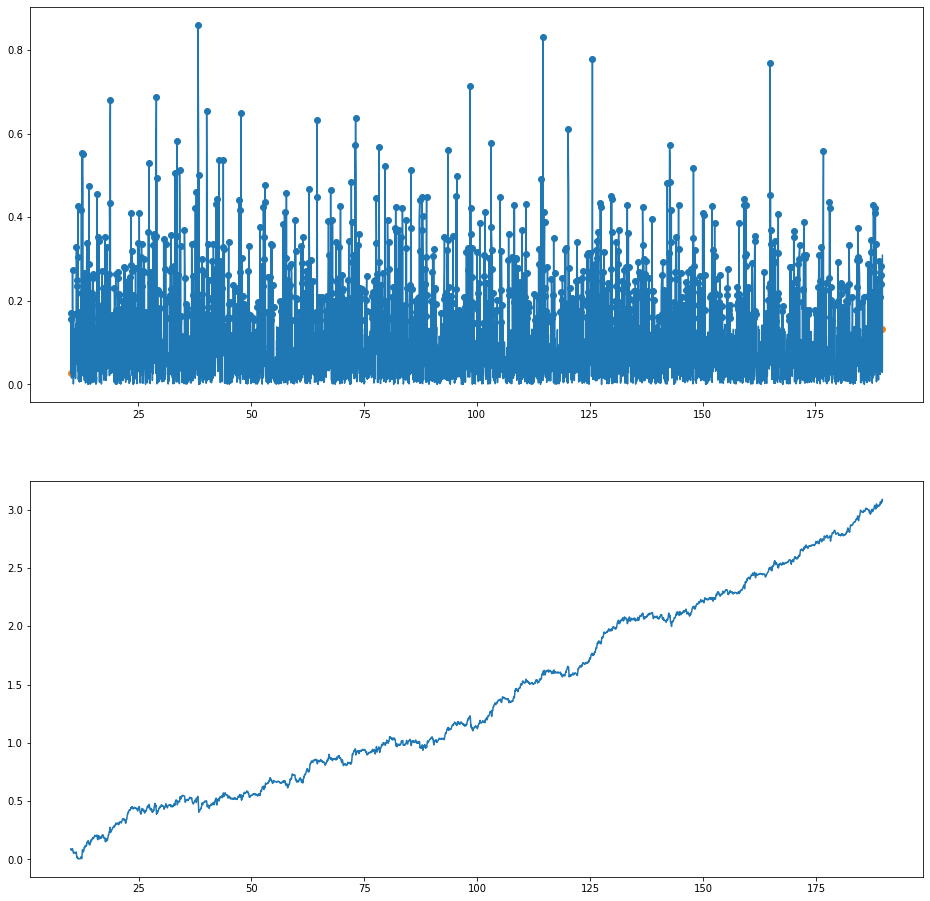

('145', 76, 'Female', 85, 84, False, 179.6775, 894, 0.2016, 117.91919999999999, 1.4038, 251.9917, 18369.3641)
('145', 76, 'Female', 85, 84, False, 179.6775, 894, 0.2016, 117.91919999999999, 1.4038, 251.9917, 18369.3641, 0.6296)
('145', 76, 'Female', 85, 84, False, 179.6775, 894, 0.2016, 117.91919999999999, 1.4038, 251.9917, 18369.3641, 0.6296, 0.0729, 0.2147, 0.0286, 8, 234, 'None')


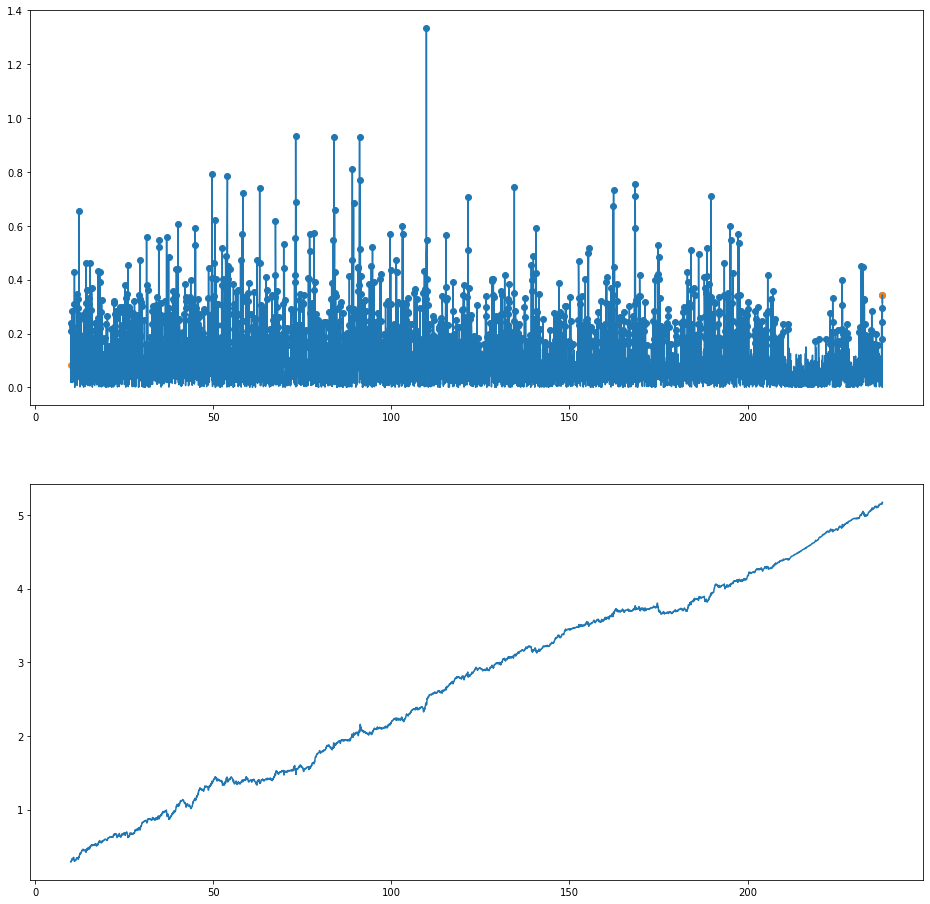

('146', 76, 'Female', 85, 84, False, 227.8455, 1133, 0.2018, 229.404, 2.731, 622.2024, 57897.7145)
('146', 76, 'Female', 85, 84, False, 227.8455, 1133, 0.2018, 229.404, 2.731, 622.2024, 57897.7145, 1.0948)
('146', 76, 'Female', 85, 84, False, 227.8455, 1133, 0.2018, 229.404, 2.731, 622.2024, 57897.7145, 1.0948, 0.2816, -0.5997, 0.0453, 8, 234, 'None')


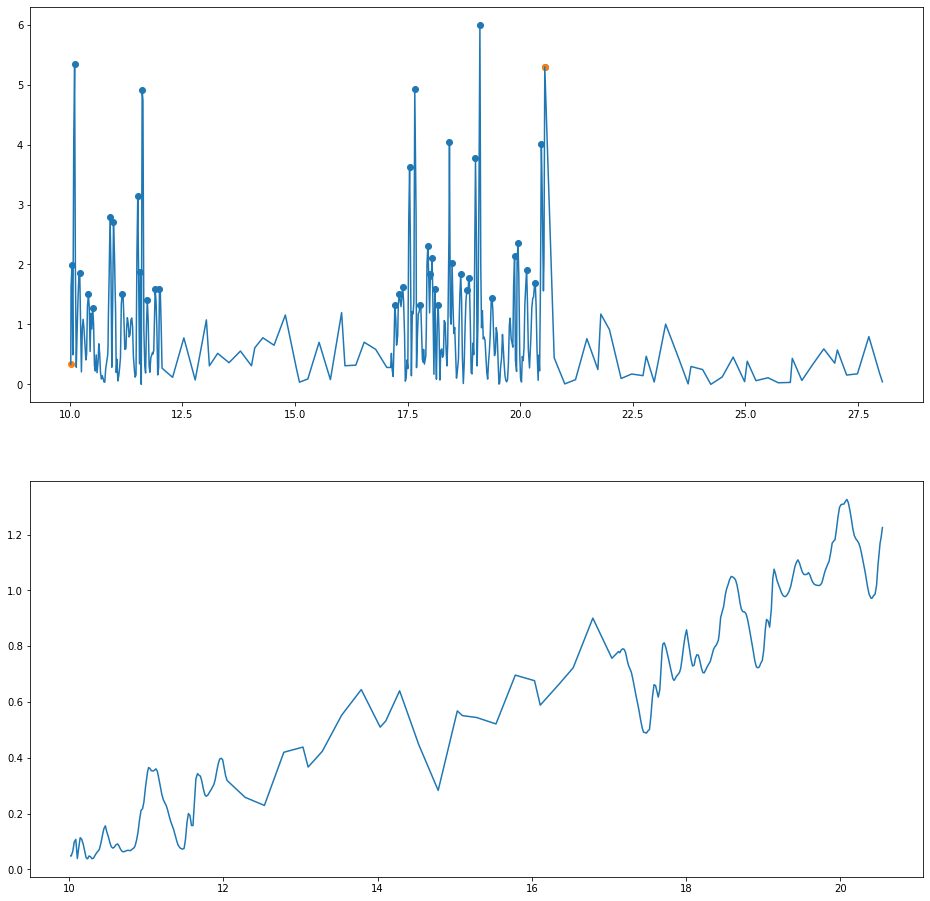

('147', 77, 'Male', 91, 67, True, 10.5225, 39, 0.2767, 42.2301, 0.6303, 6.1158, 1742.9653)
('147', 77, 'Male', 91, 67, True, 10.5225, 39, 0.2767, 42.2301, 0.6303, 6.1158, 1742.9653, 0.2619)
('147', 77, 'Male', 91, 67, True, 10.5225, 39, 0.2767, 42.2301, 0.6303, 6.1158, 1742.9653, 0.2619, -0.0237, 0.0027, 0.0515, 8, 243, 'Hip Amputation')
('147', 77, 'Male', 91, 67, True, 10.5225, 39, 0.2767, 42.2301, 0.6303, 6.1158, 1742.9653, 0.2619, -0.0237, 0.0027, 0.0515, 8, 244, 'Supraumbilical Hernia')
('147', 77, 'Male', 91, 67, True, 10.5225, 39, 0.2767, 42.2301, 0.6303, 6.1158, 1742.9653, 0.2619, -0.0237, 0.0027, 0.0515, 8, 104, 'Arterial Hypertension')


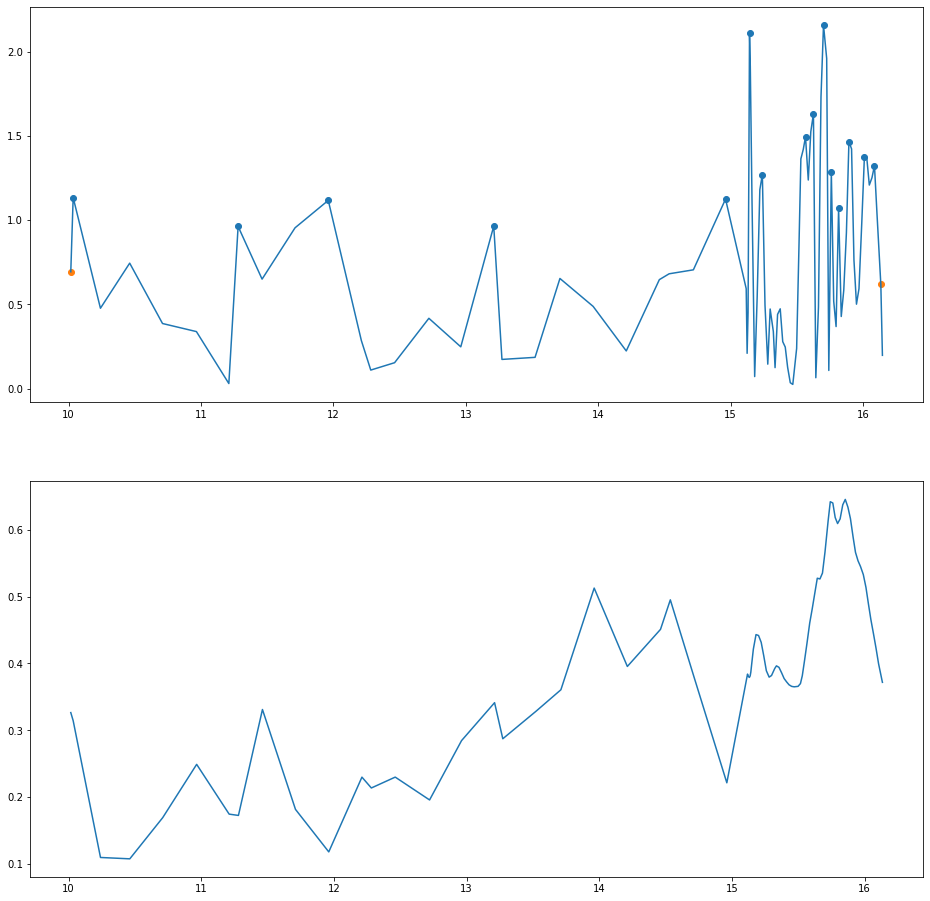

('148', 77, 'Male', 91, 67, True, 6.1195, 15, 0.4329, 27.423099999999998, 0.4093, 1.8669, -64.9426)
('148', 77, 'Male', 91, 67, True, 6.1195, 15, 0.4329, 27.423099999999998, 0.4093, 1.8669, -64.9426, 0.2294)
('148', 77, 'Male', 91, 67, True, 6.1195, 15, 0.4329, 27.423099999999998, 0.4093, 1.8669, -64.9426, 0.2294, -0.0222, 0.0405, -0.0178, 8, 243, 'Hip Amputation')
('148', 77, 'Male', 91, 67, True, 6.1195, 15, 0.4329, 27.423099999999998, 0.4093, 1.8669, -64.9426, 0.2294, -0.0222, 0.0405, -0.0178, 8, 244, 'Supraumbilical Hernia')
('148', 77, 'Male', 91, 67, True, 6.1195, 15, 0.4329, 27.423099999999998, 0.4093, 1.8669, -64.9426, 0.2294, -0.0222, 0.0405, -0.0178, 8, 104, 'Arterial Hypertension')


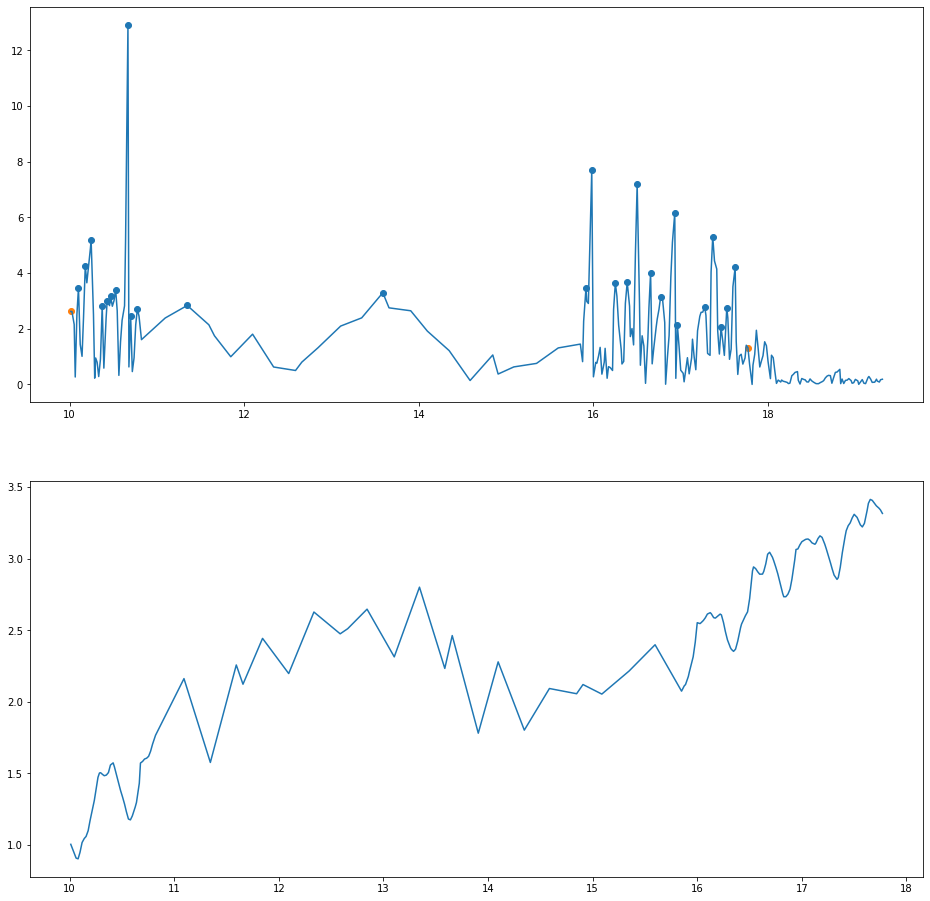

('149', 78, 'Female', 73, 58, False, 7.7585, 26, 0.3015, 138.504, 2.388, 17.753, 12817.7859)
('149', 78, 'Female', 73, 58, False, 7.7585, 26, 0.3015, 138.504, 2.388, 17.753, 12817.7859, 1.2812)
('149', 78, 'Female', 73, 58, False, 7.7585, 26, 0.3015, 138.504, 2.388, 17.753, 12817.7859, 1.2812, -0.0257, -0.0405, 0.0361, 8, 245, 'Mental Disability')
('149', 78, 'Female', 73, 58, False, 7.7585, 26, 0.3015, 138.504, 2.388, 17.753, 12817.7859, 1.2812, -0.0257, -0.0405, 0.0361, 8, 162, 'Epilepsy')


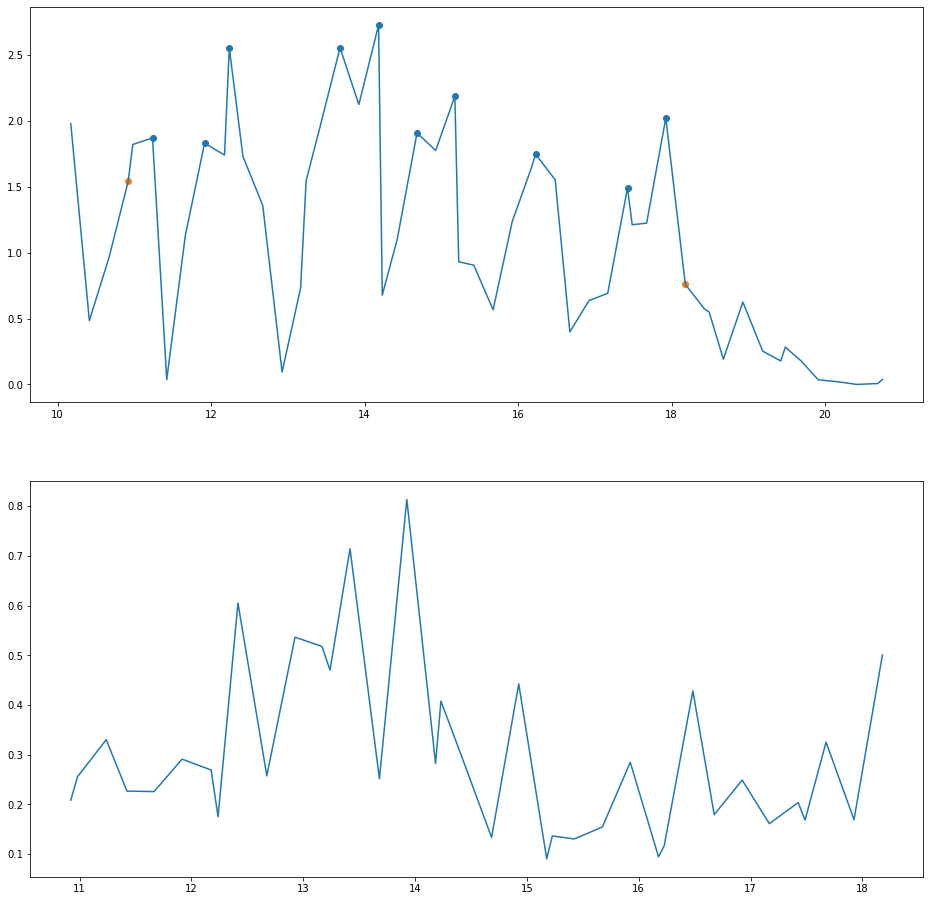

('150', 78, 'Female', 73, 58, False, 7.2585, 10, 0.7435, 17.4406, 0.3007, 2.321, -427.7147)
('150', 78, 'Female', 73, 58, False, 7.2585, 10, 0.7435, 17.4406, 0.3007, 2.321, -427.7147, 1.6758)
('150', 78, 'Female', 73, 58, False, 7.2585, 10, 0.7435, 17.4406, 0.3007, 2.321, -427.7147, 1.6758, 0.008, 0.0378, 0.0272, 8, 245, 'Mental Disability')
('150', 78, 'Female', 73, 58, False, 7.2585, 10, 0.7435, 17.4406, 0.3007, 2.321, -427.7147, 1.6758, 0.008, 0.0378, 0.0272, 8, 162, 'Epilepsy')


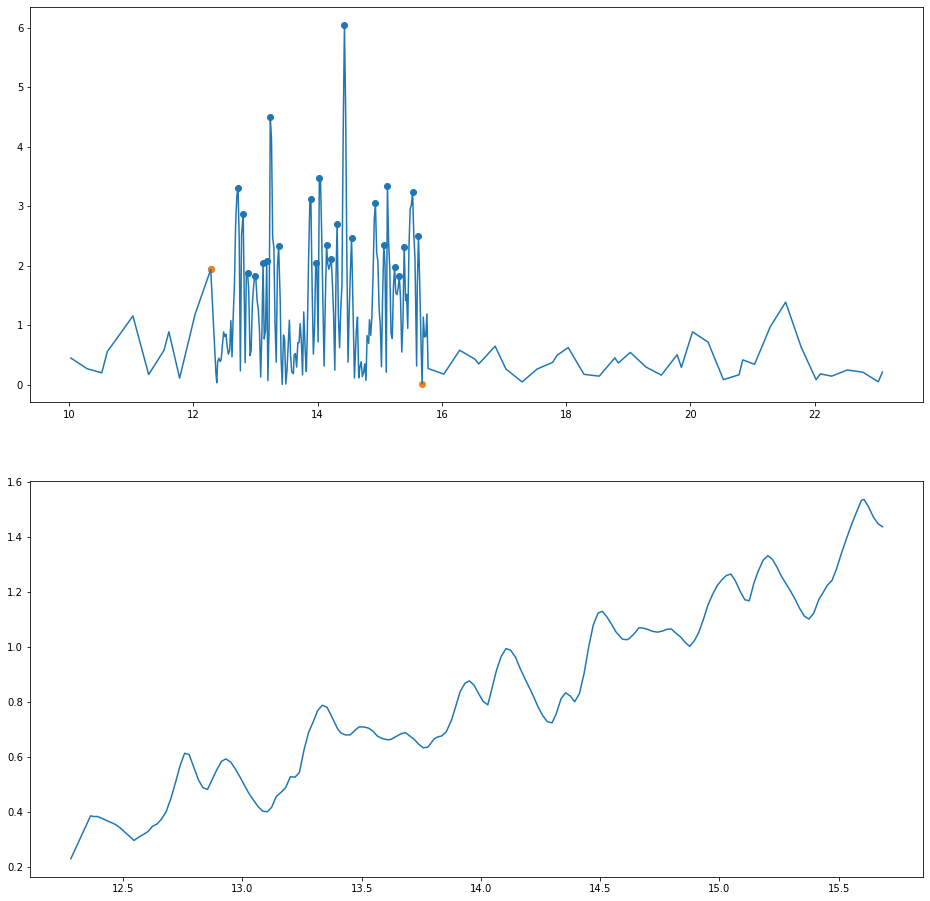

('151', 79, 'Female', 81, 56, True, 3.4025, 25, 0.1398, 46.7824, 0.8354, 2.926, 2485.7285)
('151', 79, 'Female', 81, 56, True, 3.4025, 25, 0.1398, 46.7824, 0.8354, 2.926, 2485.7285, 0.5634)
('151', 79, 'Female', 81, 56, True, 3.4025, 25, 0.1398, 46.7824, 0.8354, 2.926, 2485.7285, 0.5634, -0.0181, -0.0456, 0.043, 10, 246, 'Occlusive Peripheral Arterial Disease')
('151', 79, 'Female', 81, 56, True, 3.4025, 25, 0.1398, 46.7824, 0.8354, 2.926, 2485.7285, 0.5634, -0.0181, -0.0456, 0.043, 10, 153, 'Pulmonary Edema')
('151', 79, 'Female', 81, 56, True, 3.4025, 25, 0.1398, 46.7824, 0.8354, 2.926, 2485.7285, 0.5634, -0.0181, -0.0456, 0.043, 10, 208, 'Depression')
('151', 79, 'Female', 81, 56, True, 3.4025, 25, 0.1398, 46.7824, 0.8354, 2.926, 2485.7285, 0.5634, -0.0181, -0.0456, 0.043, 10, 247, 'Coronary Heart Disease')
('151', 79, 'Female', 81, 56, True, 3.4025, 25, 0.1398, 46.7824, 0.8354, 2.926, 2485.7285, 0.5634, -0.0181, -0.0456, 0.043, 10, 176, 'Atrial Fibrillation')
('151', 79, 'Female', 

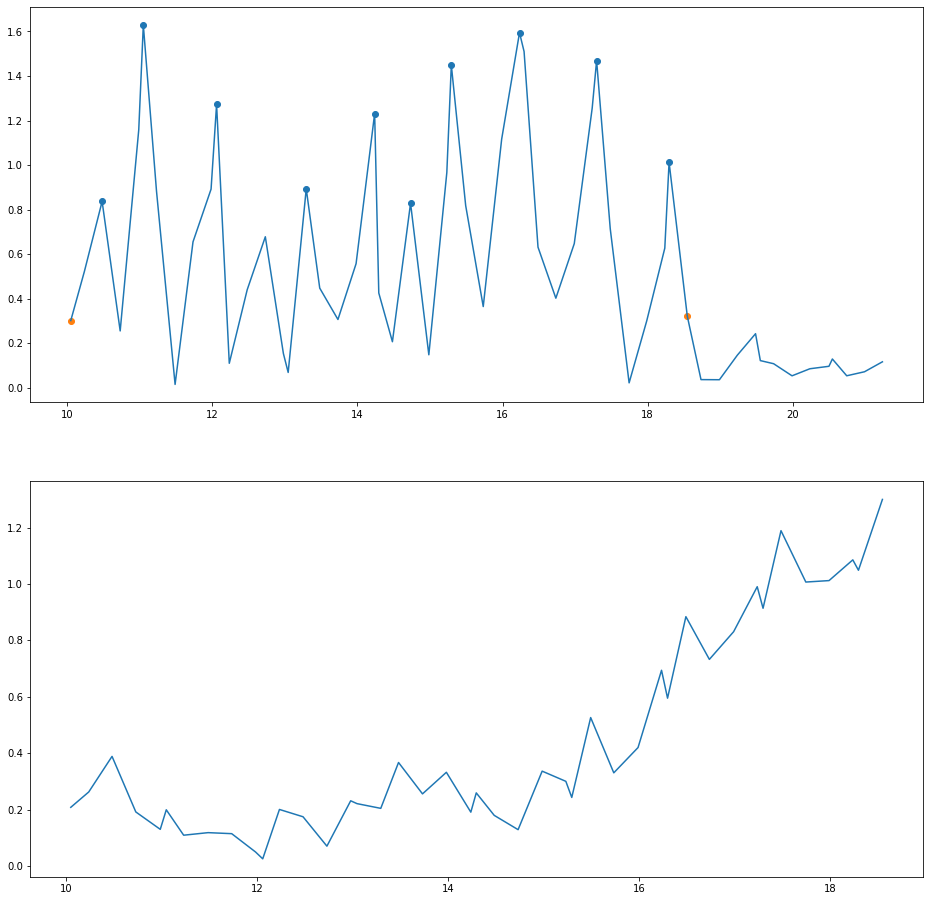

('152', 79, 'Female', 81, 56, True, 8.4995, 10, 0.8689, 24.8304, 0.4434, 3.5804, -46.2387)
('152', 79, 'Female', 81, 56, True, 8.4995, 10, 0.8689, 24.8304, 0.4434, 3.5804, -46.2387, 0.3914)
('152', 79, 'Female', 81, 56, True, 8.4995, 10, 0.8689, 24.8304, 0.4434, 3.5804, -46.2387, 0.3914, -0.0291, -0.0189, -0.039, 10, 246, 'Occlusive Peripheral Arterial Disease')
('152', 79, 'Female', 81, 56, True, 8.4995, 10, 0.8689, 24.8304, 0.4434, 3.5804, -46.2387, 0.3914, -0.0291, -0.0189, -0.039, 10, 153, 'Pulmonary Edema')
('152', 79, 'Female', 81, 56, True, 8.4995, 10, 0.8689, 24.8304, 0.4434, 3.5804, -46.2387, 0.3914, -0.0291, -0.0189, -0.039, 10, 208, 'Depression')
('152', 79, 'Female', 81, 56, True, 8.4995, 10, 0.8689, 24.8304, 0.4434, 3.5804, -46.2387, 0.3914, -0.0291, -0.0189, -0.039, 10, 247, 'Coronary Heart Disease')
('152', 79, 'Female', 81, 56, True, 8.4995, 10, 0.8689, 24.8304, 0.4434, 3.5804, -46.2387, 0.3914, -0.0291, -0.0189, -0.039, 10, 176, 'Atrial Fibrillation')
('152', 79, 'Fema

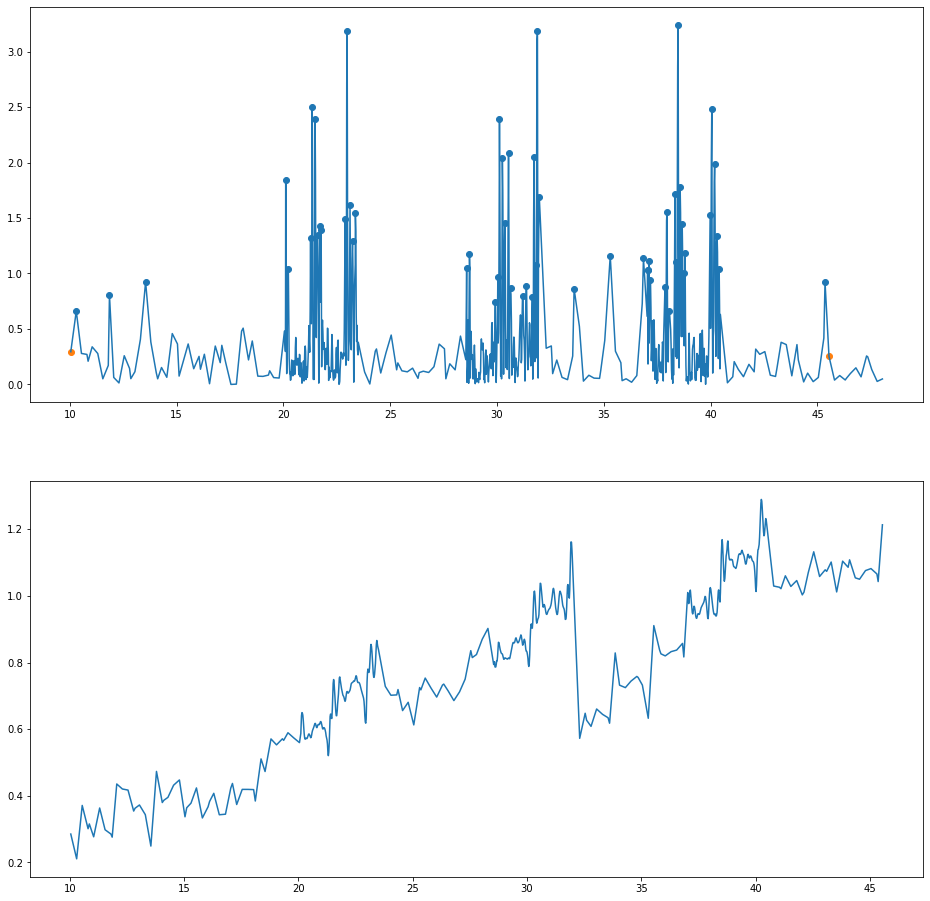

('153', 80, 'Male', 86, 59, True, 35.4975, 55, 0.6496, 49.9435, 0.8465, 26.1129, 2063.0712)
('153', 80, 'Male', 86, 59, True, 35.4975, 55, 0.6496, 49.9435, 0.8465, 26.1129, 2063.0712, 0.1694)
('153', 80, 'Male', 86, 59, True, 35.4975, 55, 0.6496, 49.9435, 0.8465, 26.1129, 2063.0712, 0.1694, -0.0365, -0.0318, 0.0821, 8, 103, 'Diabetes')
('153', 80, 'Male', 86, 59, True, 35.4975, 55, 0.6496, 49.9435, 0.8465, 26.1129, 2063.0712, 0.1694, -0.0365, -0.0318, 0.0821, 8, 104, 'Arterial Hypertension')
('153', 80, 'Male', 86, 59, True, 35.4975, 55, 0.6496, 49.9435, 0.8465, 26.1129, 2063.0712, 0.1694, -0.0365, -0.0318, 0.0821, 8, 106, 'Dyslipidemia')
('153', 80, 'Male', 86, 59, True, 35.4975, 55, 0.6496, 49.9435, 0.8465, 26.1129, 2063.0712, 0.1694, -0.0365, -0.0318, 0.0821, 8, 208, 'Depression')


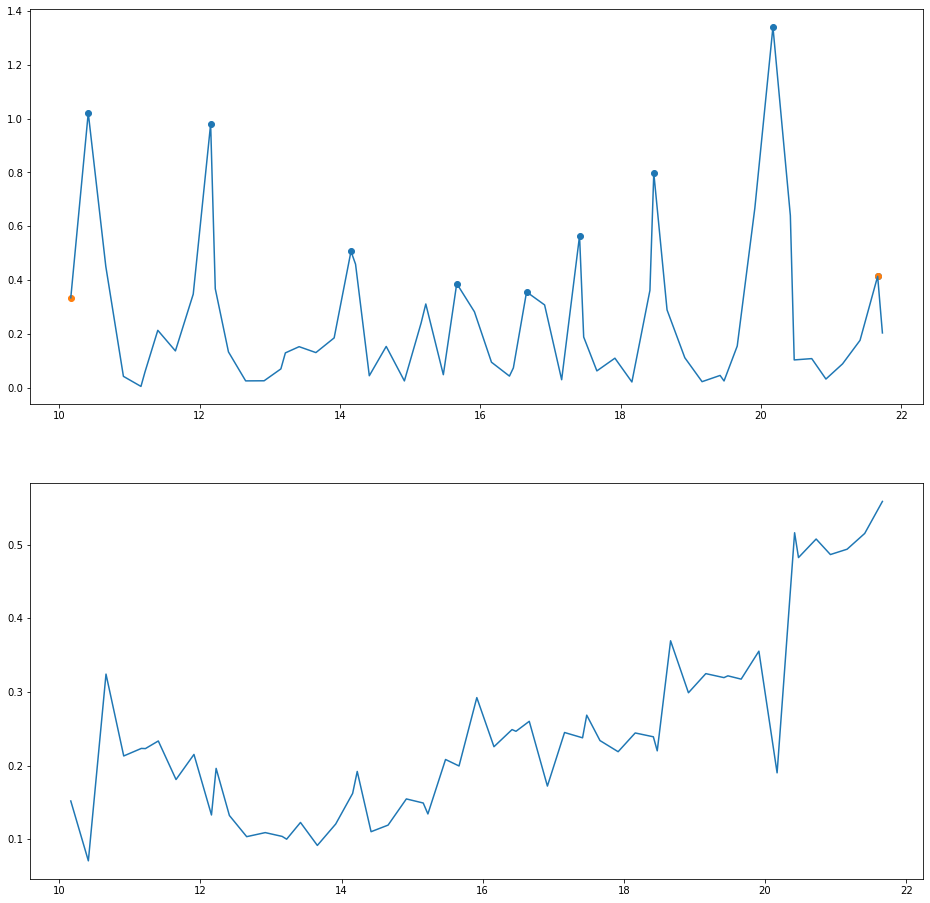

('154', 80, 'Male', 86, 59, True, 11.4985, 9, 1.4066, 14.4078, 0.2442, 2.7397, -24.868)
('154', 80, 'Male', 86, 59, True, 11.4985, 9, 1.4066, 14.4078, 0.2442, 2.7397, -24.868, 0.4802)
('154', 80, 'Male', 86, 59, True, 11.4985, 9, 1.4066, 14.4078, 0.2442, 2.7397, -24.868, 0.4802, -0.0087, -0.0311, -0.0155, 8, 103, 'Diabetes')
('154', 80, 'Male', 86, 59, True, 11.4985, 9, 1.4066, 14.4078, 0.2442, 2.7397, -24.868, 0.4802, -0.0087, -0.0311, -0.0155, 8, 104, 'Arterial Hypertension')
('154', 80, 'Male', 86, 59, True, 11.4985, 9, 1.4066, 14.4078, 0.2442, 2.7397, -24.868, 0.4802, -0.0087, -0.0311, -0.0155, 8, 106, 'Dyslipidemia')
('154', 80, 'Male', 86, 59, True, 11.4985, 9, 1.4066, 14.4078, 0.2442, 2.7397, -24.868, 0.4802, -0.0087, -0.0311, -0.0155, 8, 208, 'Depression')


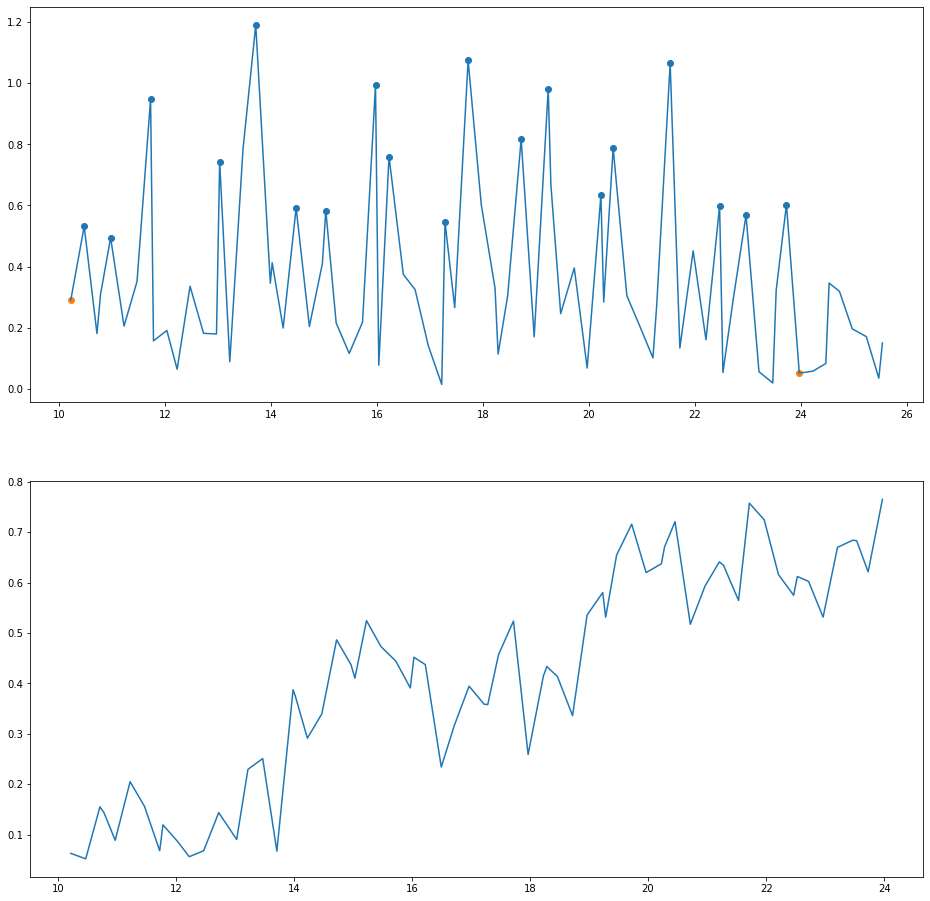

('155', 81, 'Female', 87, 51, True, 13.7495, 19, 0.7368, 21.1344, 0.4144, 5.5911, 14.3723)
('155', 81, 'Female', 87, 51, True, 13.7495, 19, 0.7368, 21.1344, 0.4144, 5.5911, 14.3723, 0.1451)
('155', 81, 'Female', 87, 51, True, 13.7495, 19, 0.7368, 21.1344, 0.4144, 5.5911, 14.3723, 0.1451, -0.0012, 0.0167, 0.0089, 10, 104, 'Arterial Hypertension')


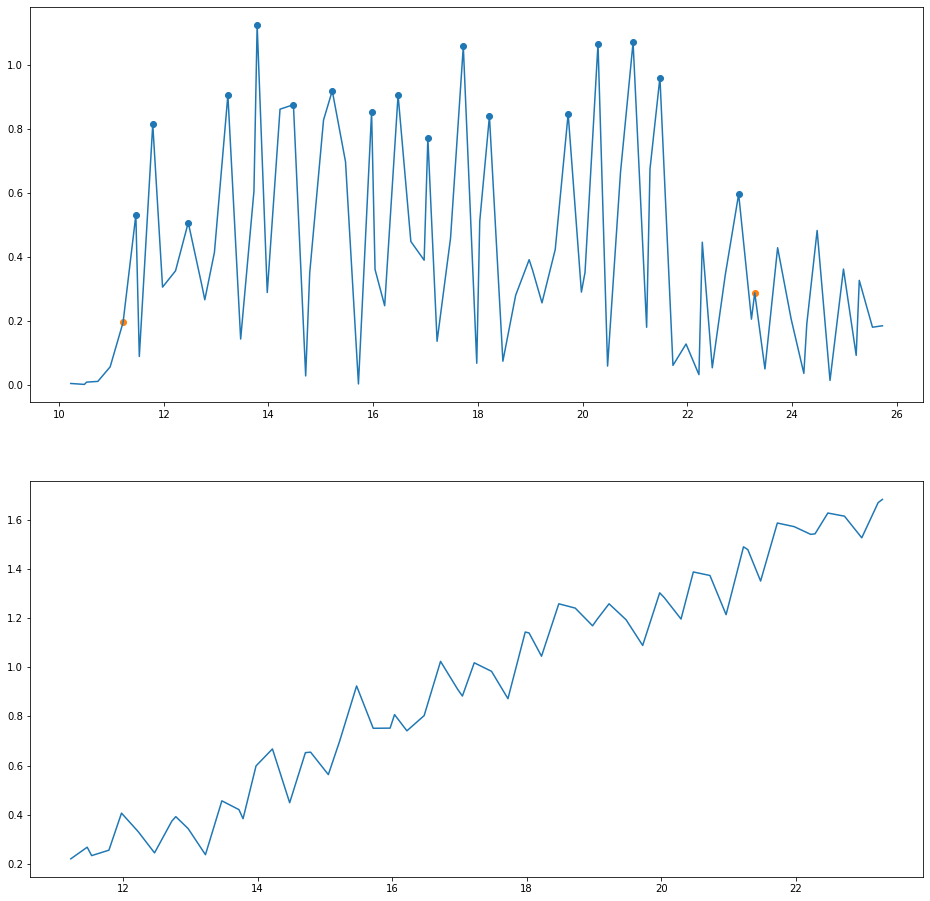

('156', 81, 'Female', 87, 51, True, 12.0665, 17, 0.7202, 48.0726, 0.9426, 11.2047, 197.3654)
('156', 81, 'Female', 87, 51, True, 12.0665, 17, 0.7202, 48.0726, 0.9426, 11.2047, 197.3654, 0.9796)
('156', 81, 'Female', 87, 51, True, 12.0665, 17, 0.7202, 48.0726, 0.9426, 11.2047, 197.3654, 0.9796, -0.105, 0.0262, -0.0781, 10, 104, 'Arterial Hypertension')


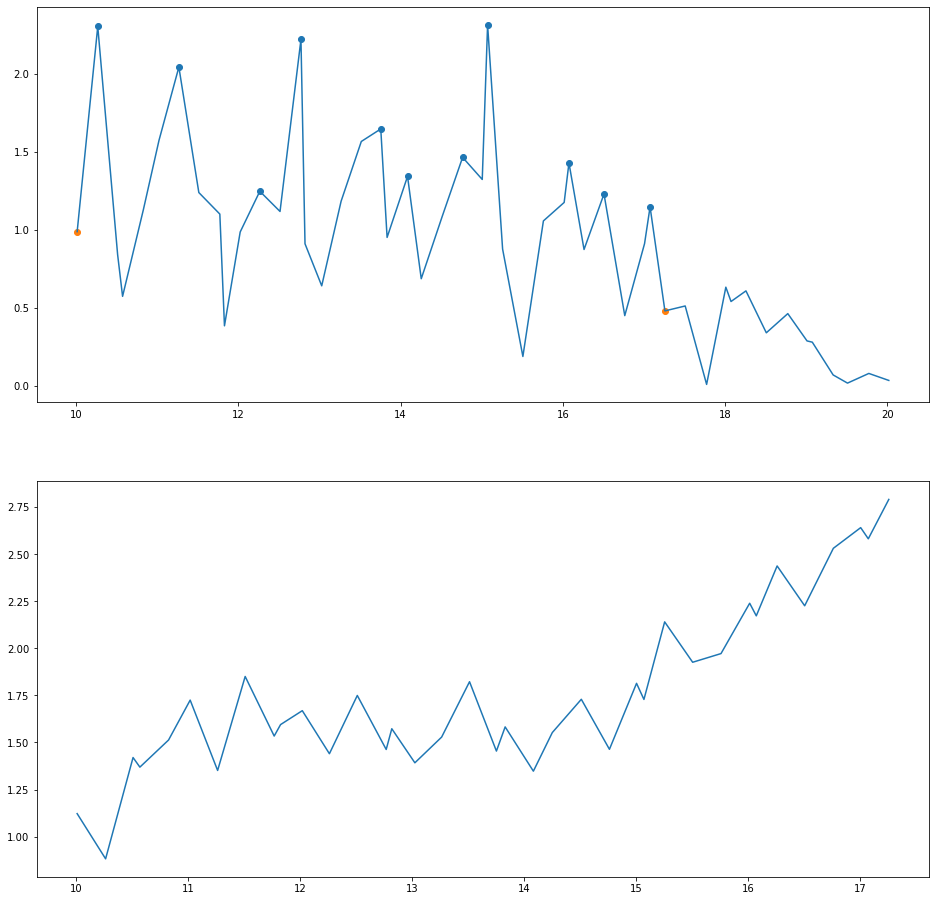

('157', 82, 'Female', 65, 97, False, 7.2465, 11, 0.6814, 171.35049999999998, 1.7665, 12.4982, 911.0536)
('157', 82, 'Female', 65, 97, False, 7.2465, 11, 0.6814, 171.35049999999998, 1.7665, 12.4982, 911.0536, 0.5713)
('157', 82, 'Female', 65, 97, False, 7.2465, 11, 0.6814, 171.35049999999998, 1.7665, 12.4982, 911.0536, 0.5713, -0.0127, -0.0339, 0.0395, 10, 103, 'Diabetes')
('157', 82, 'Female', 65, 97, False, 7.2465, 11, 0.6814, 171.35049999999998, 1.7665, 12.4982, 911.0536, 0.5713, -0.0127, -0.0339, 0.0395, 10, 104, 'Arterial Hypertension')
('157', 82, 'Female', 65, 97, False, 7.2465, 11, 0.6814, 171.35049999999998, 1.7665, 12.4982, 911.0536, 0.5713, -0.0127, -0.0339, 0.0395, 10, 248, 'Hypothyroidism')
('157', 82, 'Female', 65, 97, False, 7.2465, 11, 0.6814, 171.35049999999998, 1.7665, 12.4982, 911.0536, 0.5713, -0.0127, -0.0339, 0.0395, 10, 249, 'Transient Ischemic Attacks')
('157', 82, 'Female', 65, 97, False, 7.2465, 11, 0.6814, 171.35049999999998, 1.7665, 12.4982, 911.0536, 0.5713,

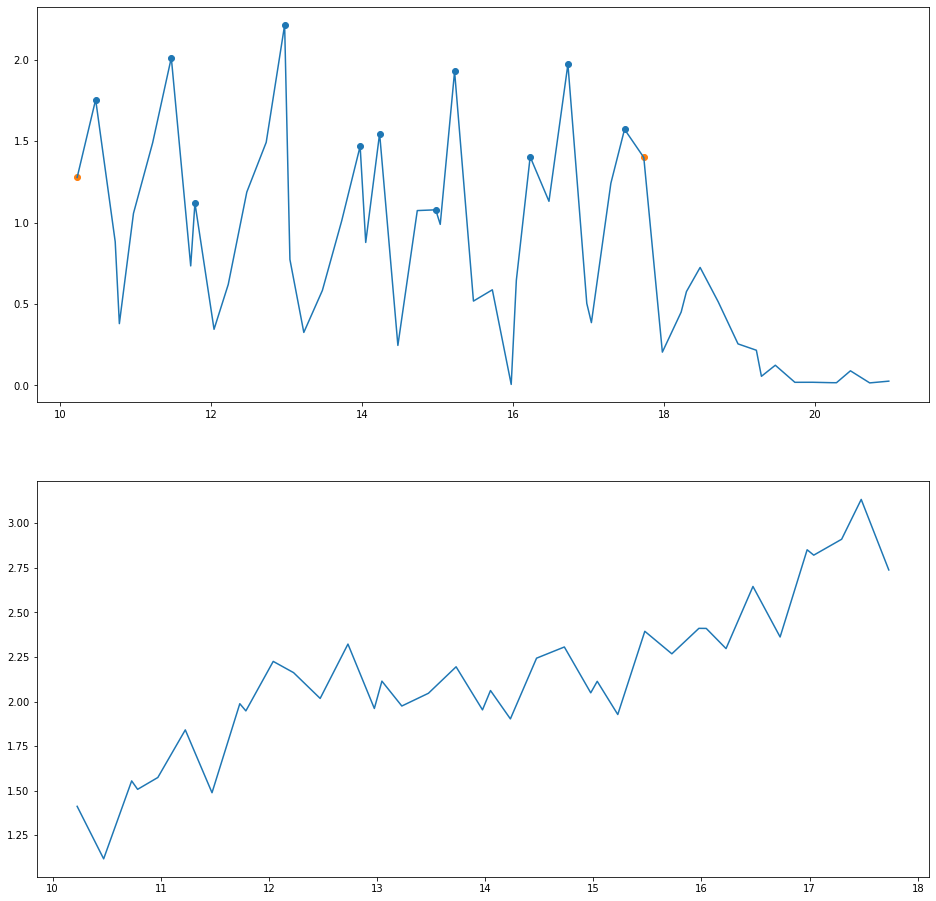

('158', 82, 'Female', 65, 97, False, 7.5055, 11, 0.701, 207.4442, 2.1386, 15.9059, 1176.2904)
('158', 82, 'Female', 65, 97, False, 7.5055, 11, 0.701, 207.4442, 2.1386, 15.9059, 1176.2904, 0.6355)
('158', 82, 'Female', 65, 97, False, 7.5055, 11, 0.701, 207.4442, 2.1386, 15.9059, 1176.2904, 0.6355, -0.0213, 0.0281, -0.0125, 10, 103, 'Diabetes')
('158', 82, 'Female', 65, 97, False, 7.5055, 11, 0.701, 207.4442, 2.1386, 15.9059, 1176.2904, 0.6355, -0.0213, 0.0281, -0.0125, 10, 104, 'Arterial Hypertension')
('158', 82, 'Female', 65, 97, False, 7.5055, 11, 0.701, 207.4442, 2.1386, 15.9059, 1176.2904, 0.6355, -0.0213, 0.0281, -0.0125, 10, 248, 'Hypothyroidism')
('158', 82, 'Female', 65, 97, False, 7.5055, 11, 0.701, 207.4442, 2.1386, 15.9059, 1176.2904, 0.6355, -0.0213, 0.0281, -0.0125, 10, 249, 'Transient Ischemic Attacks')
('158', 82, 'Female', 65, 97, False, 7.5055, 11, 0.701, 207.4442, 2.1386, 15.9059, 1176.2904, 0.6355, -0.0213, 0.0281, -0.0125, 10, 208, 'Depression')
('158', 82, 'Female'

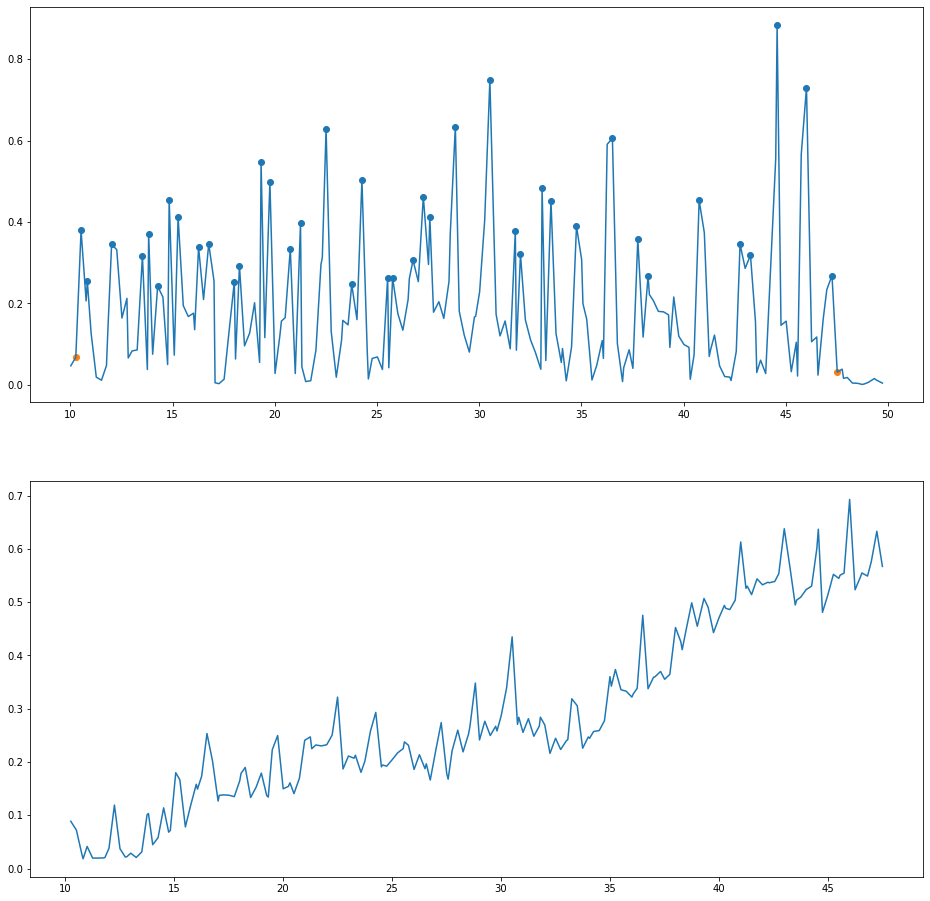

('159', 83, 'Female', 91, 54, True, 37.2575, 40, 0.9426, 15.633, 0.2895, 10.7989, -5.1241)
('159', 83, 'Female', 91, 54, True, 37.2575, 40, 0.9426, 15.633, 0.2895, 10.7989, -5.1241, 1.1563)
('159', 83, 'Female', 91, 54, True, 37.2575, 40, 0.9426, 15.633, 0.2895, 10.7989, -5.1241, 1.1563, -0.015, -0.153, -0.0344, 7, 142, 'Heart Failure')
('159', 83, 'Female', 91, 54, True, 37.2575, 40, 0.9426, 15.633, 0.2895, 10.7989, -5.1241, 1.1563, -0.015, -0.153, -0.0344, 7, 104, 'Arterial Hypertension')
('159', 83, 'Female', 91, 54, True, 37.2575, 40, 0.9426, 15.633, 0.2895, 10.7989, -5.1241, 1.1563, -0.015, -0.153, -0.0344, 7, 251, 'Chronic Arterial Disease')
('159', 83, 'Female', 91, 54, True, 37.2575, 40, 0.9426, 15.633, 0.2895, 10.7989, -5.1241, 1.1563, -0.015, -0.153, -0.0344, 7, 135, 'Bilateral Gonarthrosis')
('159', 83, 'Female', 91, 54, True, 37.2575, 40, 0.9426, 15.633, 0.2895, 10.7989, -5.1241, 1.1563, -0.015, -0.153, -0.0344, 7, 136, 'Stroke')


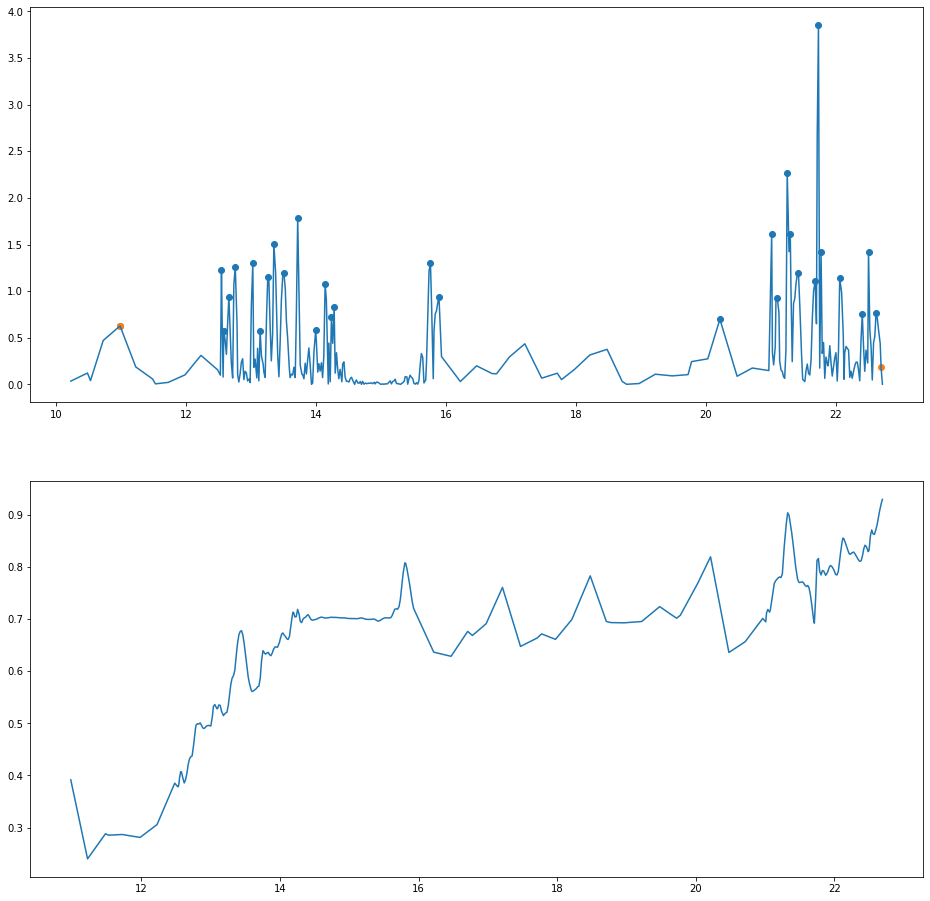

('160', 83, 'Female', 91, 54, True, 11.7115, 30, 0.4017, 36.8658, 0.6827, 7.6083, 1022.3123)
('160', 83, 'Female', 91, 54, True, 11.7115, 30, 0.4017, 36.8658, 0.6827, 7.6083, 1022.3123, 0.7553)
('160', 83, 'Female', 91, 54, True, 11.7115, 30, 0.4017, 36.8658, 0.6827, 7.6083, 1022.3123, 0.7553, 0.0562, 0.0773, 0.0617, 7, 142, 'Heart Failure')
('160', 83, 'Female', 91, 54, True, 11.7115, 30, 0.4017, 36.8658, 0.6827, 7.6083, 1022.3123, 0.7553, 0.0562, 0.0773, 0.0617, 7, 104, 'Arterial Hypertension')
('160', 83, 'Female', 91, 54, True, 11.7115, 30, 0.4017, 36.8658, 0.6827, 7.6083, 1022.3123, 0.7553, 0.0562, 0.0773, 0.0617, 7, 251, 'Chronic Arterial Disease')
('160', 83, 'Female', 91, 54, True, 11.7115, 30, 0.4017, 36.8658, 0.6827, 7.6083, 1022.3123, 0.7553, 0.0562, 0.0773, 0.0617, 7, 135, 'Bilateral Gonarthrosis')
('160', 83, 'Female', 91, 54, True, 11.7115, 30, 0.4017, 36.8658, 0.6827, 7.6083, 1022.3123, 0.7553, 0.0562, 0.0773, 0.0617, 7, 136, 'Stroke')


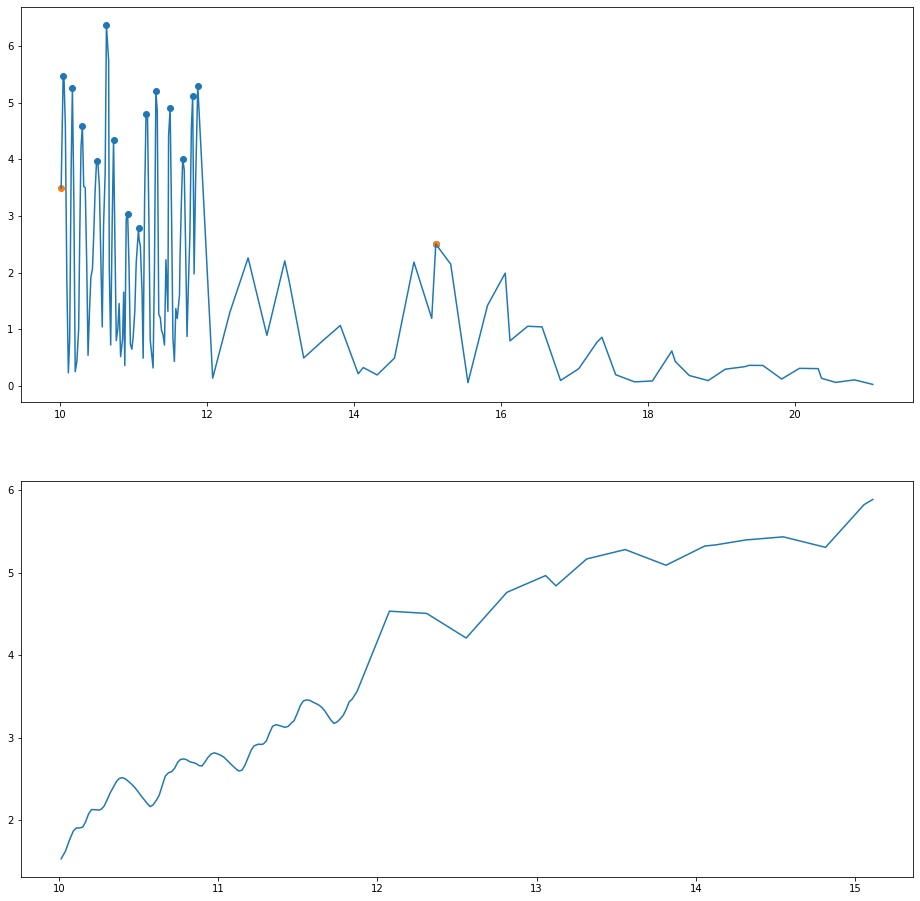

('161', 84, 'Female', 89, 70, False, 5.0985, 15, 0.3627, 213.087, 3.0441, 20.9399, 19931.7795)
('161', 84, 'Female', 89, 70, False, 5.0985, 15, 0.3627, 213.087, 3.0441, 20.9399, 19931.7795, 0.1672)
('161', 84, 'Female', 89, 70, False, 5.0985, 15, 0.3627, 213.087, 3.0441, 20.9399, 19931.7795, 0.1672, -0.0361, -0.0536, 0.0084, 10, 252, 'Lumbar Hernia')
('161', 84, 'Female', 89, 70, False, 5.0985, 15, 0.3627, 213.087, 3.0441, 20.9399, 19931.7795, 0.1672, -0.0361, -0.0536, 0.0084, 10, 122, 'Osteoporosis')
('161', 84, 'Female', 89, 70, False, 5.0985, 15, 0.3627, 213.087, 3.0441, 20.9399, 19931.7795, 0.1672, -0.0361, -0.0536, 0.0084, 10, 104, 'Arterial Hypertension')
('161', 84, 'Female', 89, 70, False, 5.0985, 15, 0.3627, 213.087, 3.0441, 20.9399, 19931.7795, 0.1672, -0.0361, -0.0536, 0.0084, 10, 106, 'Dyslipidemia')
('161', 84, 'Female', 89, 70, False, 5.0985, 15, 0.3627, 213.087, 3.0441, 20.9399, 19931.7795, 0.1672, -0.0361, -0.0536, 0.0084, 10, 253, 'Tuberculosis')
('161', 84, 'Female', 

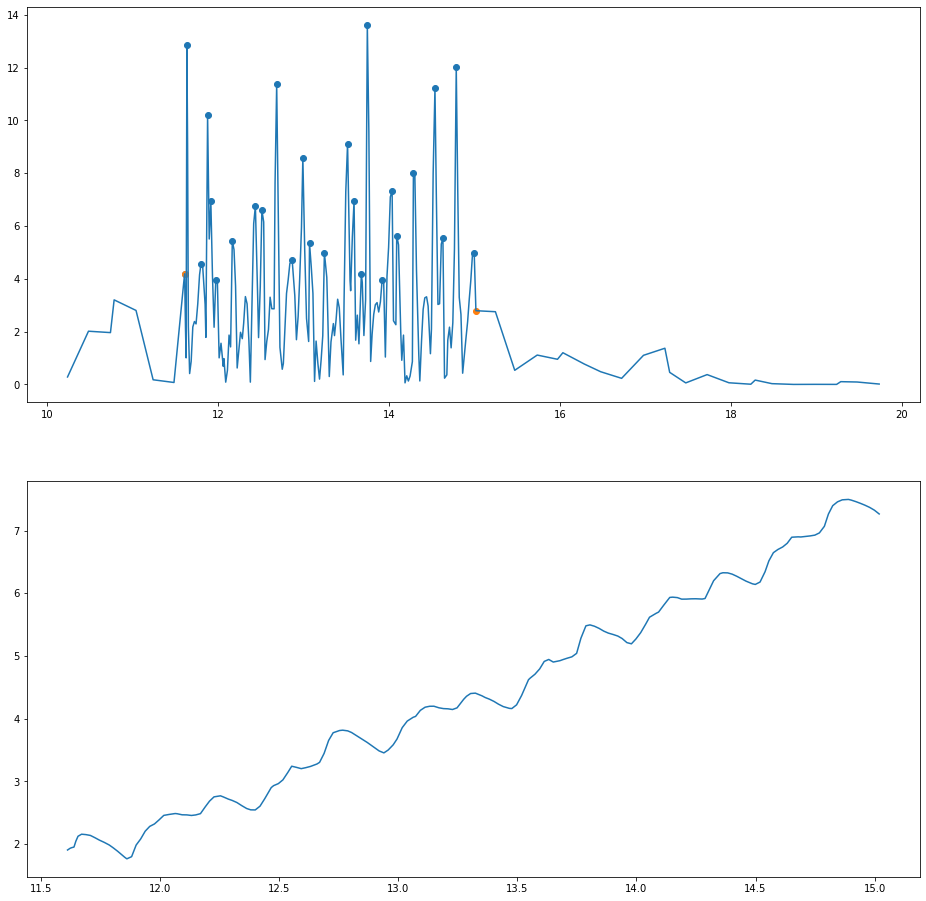

('162', 84, 'Female', 89, 70, False, 3.4075, 26, 0.136, 307.615, 4.3945, 15.2893, 86891.7425)
('162', 84, 'Female', 89, 70, False, 3.4075, 26, 0.136, 307.615, 4.3945, 15.2893, 86891.7425, 1.4002)
('162', 84, 'Female', 89, 70, False, 3.4075, 26, 0.136, 307.615, 4.3945, 15.2893, 86891.7425, 1.4002, 0.0058, 0.0035, 0.0166, 10, 252, 'Lumbar Hernia')
('162', 84, 'Female', 89, 70, False, 3.4075, 26, 0.136, 307.615, 4.3945, 15.2893, 86891.7425, 1.4002, 0.0058, 0.0035, 0.0166, 10, 122, 'Osteoporosis')
('162', 84, 'Female', 89, 70, False, 3.4075, 26, 0.136, 307.615, 4.3945, 15.2893, 86891.7425, 1.4002, 0.0058, 0.0035, 0.0166, 10, 104, 'Arterial Hypertension')
('162', 84, 'Female', 89, 70, False, 3.4075, 26, 0.136, 307.615, 4.3945, 15.2893, 86891.7425, 1.4002, 0.0058, 0.0035, 0.0166, 10, 106, 'Dyslipidemia')
('162', 84, 'Female', 89, 70, False, 3.4075, 26, 0.136, 307.615, 4.3945, 15.2893, 86891.7425, 1.4002, 0.0058, 0.0035, 0.0166, 10, 253, 'Tuberculosis')
('162', 84, 'Female', 89, 70, False, 3.

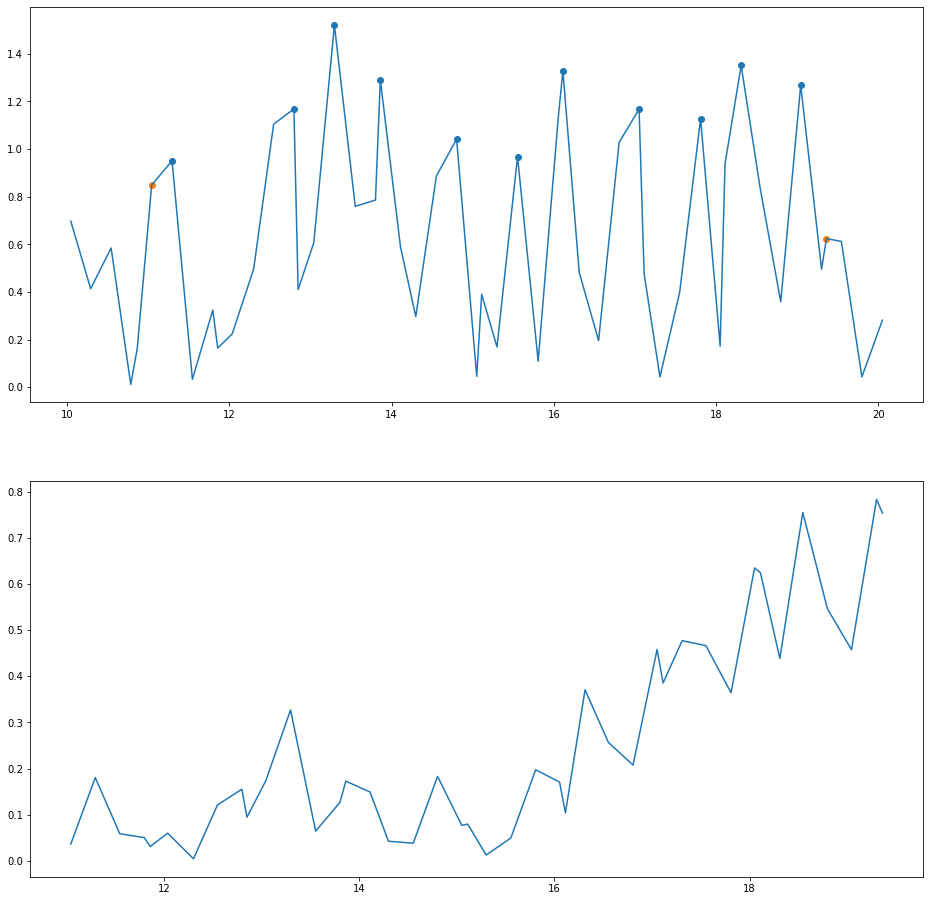

('163', 85, 'Female', 86, 69, False, 8.3165, 11, 0.7753, 17.6847, 0.2563, 1.9472, -200.9758)
('163', 85, 'Female', 86, 69, False, 8.3165, 11, 0.7753, 17.6847, 0.2563, 1.9472, -200.9758, 0.3685)
('163', 85, 'Female', 86, 69, False, 8.3165, 11, 0.7753, 17.6847, 0.2563, 1.9472, -200.9758, 0.3685, -0.0163, 0.119, 0.0411, 9, 252, 'Lumbar Hernia')
('163', 85, 'Female', 86, 69, False, 8.3165, 11, 0.7753, 17.6847, 0.2563, 1.9472, -200.9758, 0.3685, -0.0163, 0.119, 0.0411, 9, 106, 'Dyslipidemia')
('163', 85, 'Female', 86, 69, False, 8.3165, 11, 0.7753, 17.6847, 0.2563, 1.9472, -200.9758, 0.3685, -0.0163, 0.119, 0.0411, 9, 103, 'Diabetes')


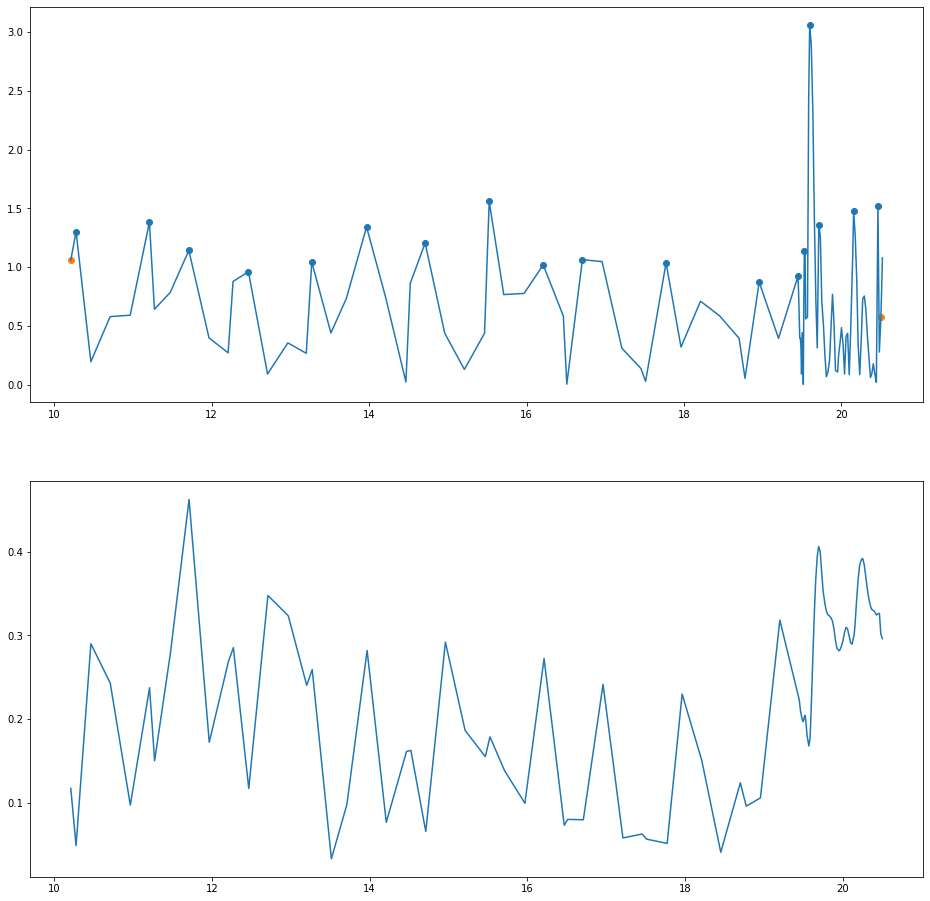

('164', 85, 'Female', 86, 69, False, 10.2935, 18, 0.5998, 16.8153, 0.2437, 1.9614, -168.739)
('164', 85, 'Female', 86, 69, False, 10.2935, 18, 0.5998, 16.8153, 0.2437, 1.9614, -168.739, 0.471)
('164', 85, 'Female', 86, 69, False, 10.2935, 18, 0.5998, 16.8153, 0.2437, 1.9614, -168.739, 0.471, -0.0163, 0.0757, -0.0219, 9, 252, 'Lumbar Hernia')
('164', 85, 'Female', 86, 69, False, 10.2935, 18, 0.5998, 16.8153, 0.2437, 1.9614, -168.739, 0.471, -0.0163, 0.0757, -0.0219, 9, 106, 'Dyslipidemia')
('164', 85, 'Female', 86, 69, False, 10.2935, 18, 0.5998, 16.8153, 0.2437, 1.9614, -168.739, 0.471, -0.0163, 0.0757, -0.0219, 9, 103, 'Diabetes')


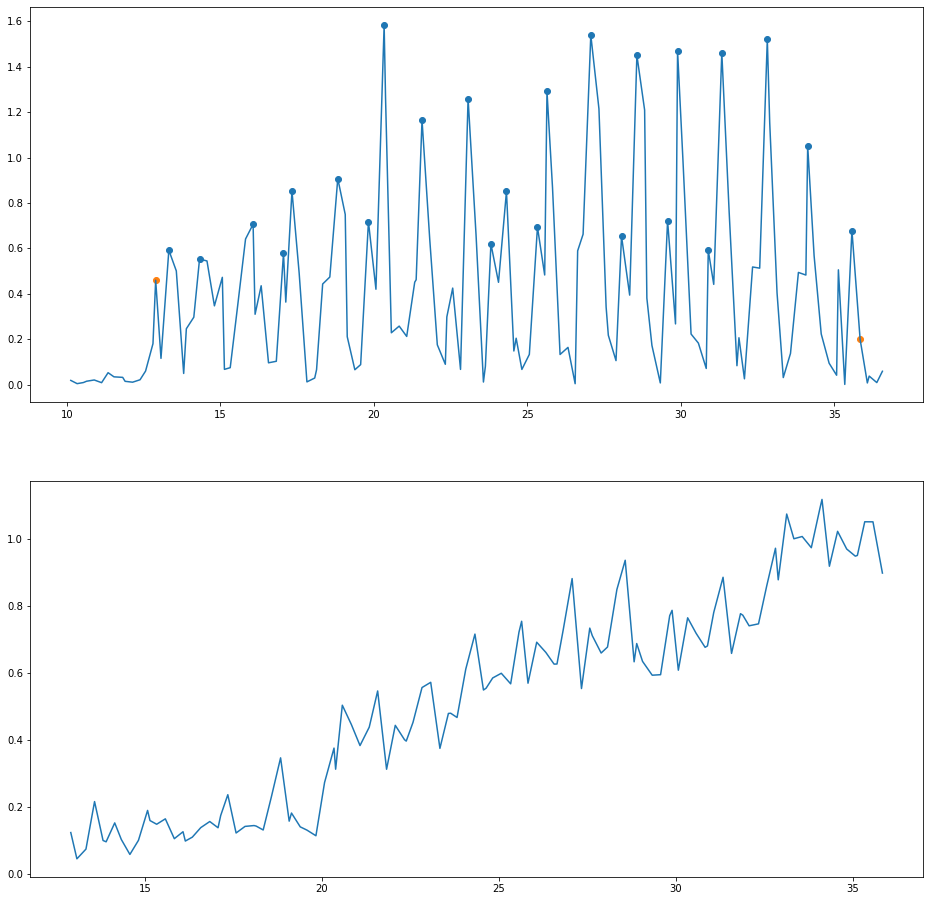

('165', 86, 'Female', 87, 73, True, 22.9445, 24, 0.9678, 38.1644, 0.5228, 11.9167, -197.8733)
('165', 86, 'Female', 87, 73, True, 22.9445, 24, 0.9678, 38.1644, 0.5228, 11.9167, -197.8733, 1.1715)
('165', 86, 'Female', 87, 73, True, 22.9445, 24, 0.9678, 38.1644, 0.5228, 11.9167, -197.8733, 1.1715, 0.0857, 0.2427, -0.1365, 8, 234, 'None')


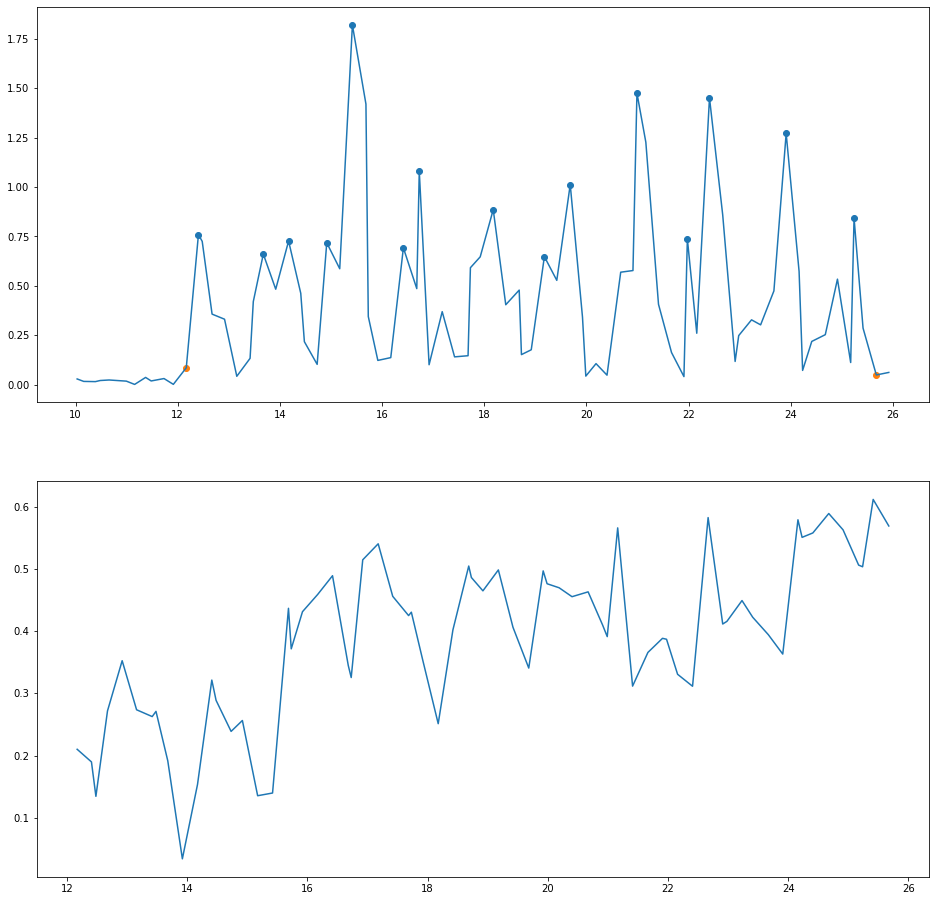

('166', 86, 'Female', 87, 73, True, 13.5085, 15, 0.9172, 28.535700000000002, 0.3909, 5.2444, -232.2417)
('166', 86, 'Female', 87, 73, True, 13.5085, 15, 0.9172, 28.535700000000002, 0.3909, 5.2444, -232.2417, 0.4162)
('166', 86, 'Female', 87, 73, True, 13.5085, 15, 0.9172, 28.535700000000002, 0.3909, 5.2444, -232.2417, 0.4162, -0.0719, 0.1751, 0.0093, 8, 234, 'None')


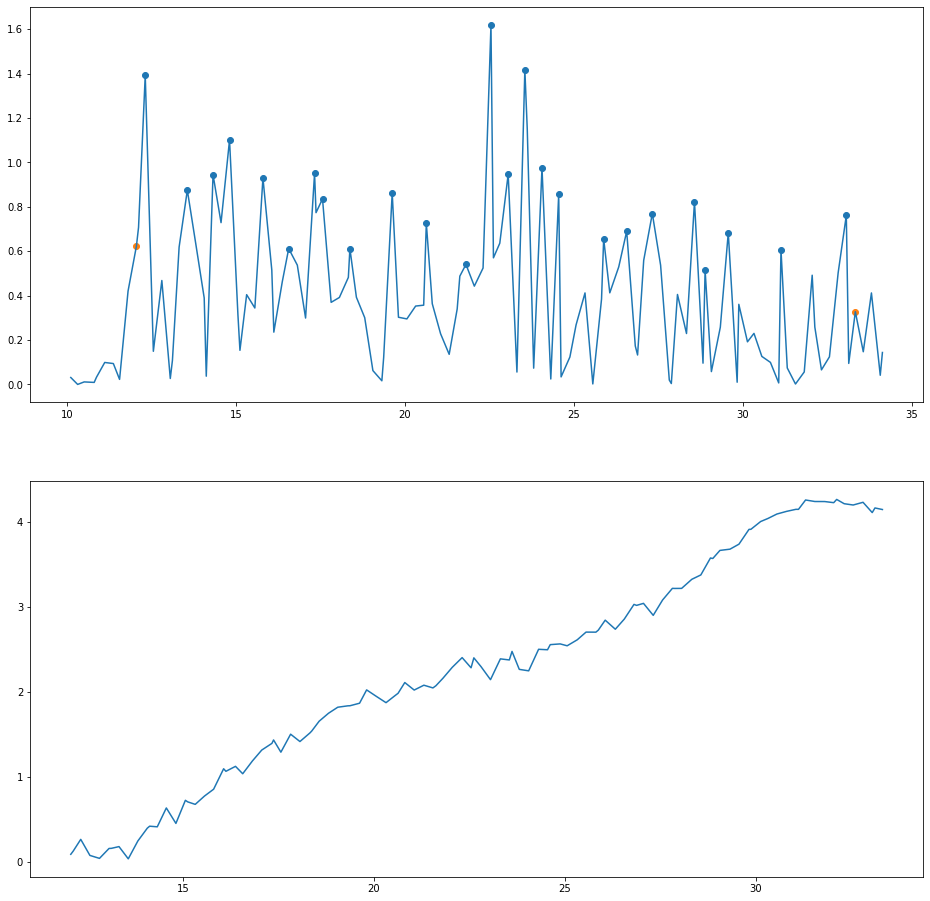

('167', 87, 'Female', 72, 65, True, 21.2625, 25, 0.8644, 147.6605, 2.2717, 47.9292, 2844.641)
('167', 87, 'Female', 72, 65, True, 21.2625, 25, 0.8644, 147.6605, 2.2717, 47.9292, 2844.641, 0.2026)
('167', 87, 'Female', 72, 65, True, 21.2625, 25, 0.8644, 147.6605, 2.2717, 47.9292, 2844.641, 0.2026, -0.0346, -0.0704, 0.0609, 9, 254, 'Cardiac Arrhythmia')
('167', 87, 'Female', 72, 65, True, 21.2625, 25, 0.8644, 147.6605, 2.2717, 47.9292, 2844.641, 0.2026, -0.0346, -0.0704, 0.0609, 9, 136, 'Stroke')
('167', 87, 'Female', 72, 65, True, 21.2625, 25, 0.8644, 147.6605, 2.2717, 47.9292, 2844.641, 0.2026, -0.0346, -0.0704, 0.0609, 9, 176, 'Atrial Fibrillation')
('167', 87, 'Female', 72, 65, True, 21.2625, 25, 0.8644, 147.6605, 2.2717, 47.9292, 2844.641, 0.2026, -0.0346, -0.0704, 0.0609, 9, 142, 'Heart Failure')
('167', 87, 'Female', 72, 65, True, 21.2625, 25, 0.8644, 147.6605, 2.2717, 47.9292, 2844.641, 0.2026, -0.0346, -0.0704, 0.0609, 9, 146, 'Obesity')
('167', 87, 'Female', 72, 65, True, 21.26

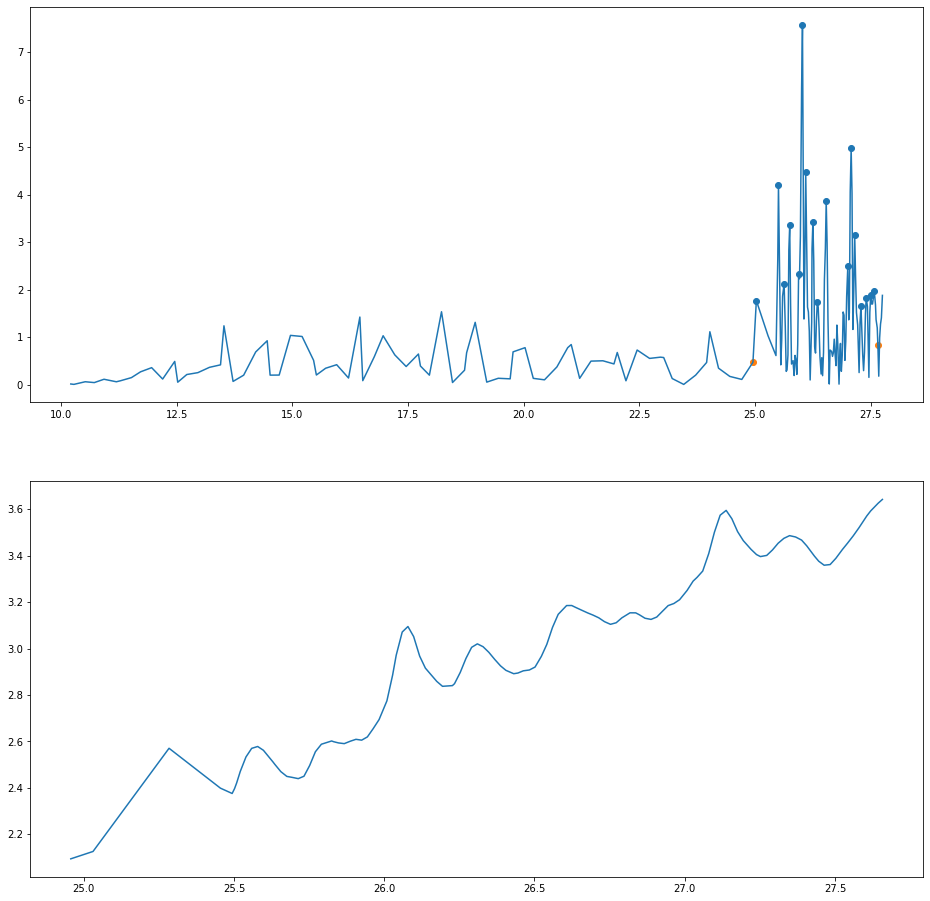

('168', 87, 'Female', 72, 65, True, 2.7015, 17, 0.1598, 195.9165, 3.0141, 8.3069, 13710.925)
('168', 87, 'Female', 72, 65, True, 2.7015, 17, 0.1598, 195.9165, 3.0141, 8.3069, 13710.925, 0.3331)
('168', 87, 'Female', 72, 65, True, 2.7015, 17, 0.1598, 195.9165, 3.0141, 8.3069, 13710.925, 0.3331, -0.0076, -0.0865, -0.0235, 9, 254, 'Cardiac Arrhythmia')
('168', 87, 'Female', 72, 65, True, 2.7015, 17, 0.1598, 195.9165, 3.0141, 8.3069, 13710.925, 0.3331, -0.0076, -0.0865, -0.0235, 9, 136, 'Stroke')
('168', 87, 'Female', 72, 65, True, 2.7015, 17, 0.1598, 195.9165, 3.0141, 8.3069, 13710.925, 0.3331, -0.0076, -0.0865, -0.0235, 9, 176, 'Atrial Fibrillation')
('168', 87, 'Female', 72, 65, True, 2.7015, 17, 0.1598, 195.9165, 3.0141, 8.3069, 13710.925, 0.3331, -0.0076, -0.0865, -0.0235, 9, 142, 'Heart Failure')
('168', 87, 'Female', 72, 65, True, 2.7015, 17, 0.1598, 195.9165, 3.0141, 8.3069, 13710.925, 0.3331, -0.0076, -0.0865, -0.0235, 9, 146, 'Obesity')
('168', 87, 'Female', 72, 65, True, 2.7015,

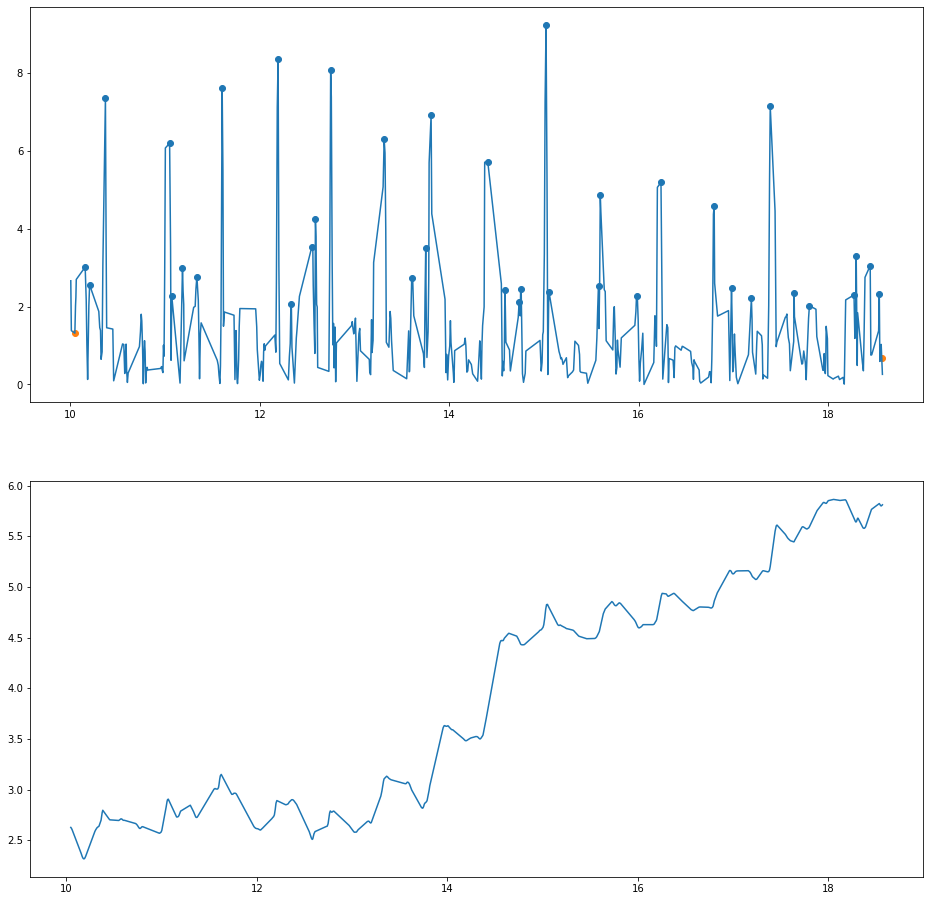

('169', 92, 'Male', 62, 64, False, 8.5235, 37, 0.2335, 250.0032, 3.9063, 33.3002, 46184.8005)
('169', 92, 'Male', 62, 64, False, 8.5235, 37, 0.2335, 250.0032, 3.9063, 33.3002, 46184.8005, 0.2778)
('169', 92, 'Male', 62, 64, False, 8.5235, 37, 0.2335, 250.0032, 3.9063, 33.3002, 46184.8005, 0.2778, 0.0033, -0.0639, -0.0195, 9, 255, "Down'S Syndrome")
('169', 92, 'Male', 62, 64, False, 8.5235, 37, 0.2335, 250.0032, 3.9063, 33.3002, 46184.8005, 0.2778, 0.0033, -0.0639, -0.0195, 9, 256, 'Deficit Of Verbal Expression')
('169', 92, 'Male', 62, 64, False, 8.5235, 37, 0.2335, 250.0032, 3.9063, 33.3002, 46184.8005, 0.2778, 0.0033, -0.0639, -0.0195, 9, 257, 'Dermatitis')
('169', 92, 'Male', 62, 64, False, 8.5235, 37, 0.2335, 250.0032, 3.9063, 33.3002, 46184.8005, 0.2778, 0.0033, -0.0639, -0.0195, 9, 258, 'Cervical Spondylosis')


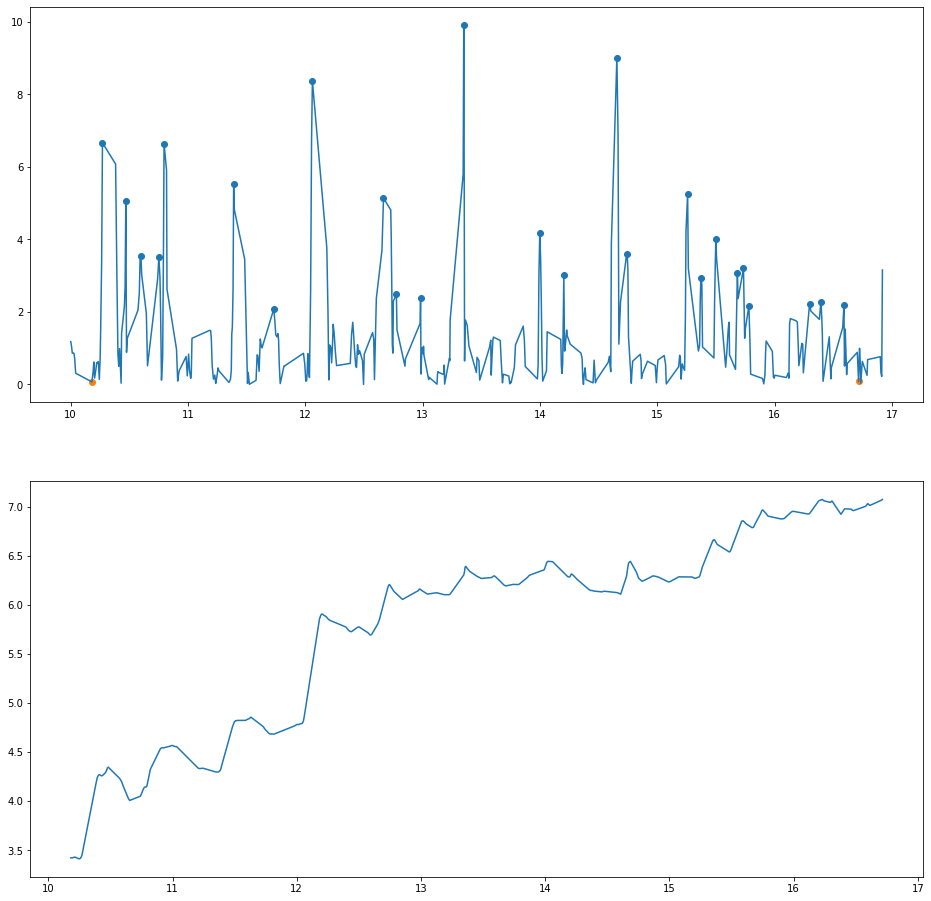

('170', 92, 'Male', 62, 64, False, 6.5345, 25, 0.2638, 368.3008, 5.7547, 38.2151, 52706.2981)
('170', 92, 'Male', 62, 64, False, 6.5345, 25, 0.2638, 368.3008, 5.7547, 38.2151, 52706.2981, 0.6857)
('170', 92, 'Male', 62, 64, False, 6.5345, 25, 0.2638, 368.3008, 5.7547, 38.2151, 52706.2981, 0.6857, 0.0004, 0.0387, 0.0009, 9, 255, "Down'S Syndrome")
('170', 92, 'Male', 62, 64, False, 6.5345, 25, 0.2638, 368.3008, 5.7547, 38.2151, 52706.2981, 0.6857, 0.0004, 0.0387, 0.0009, 9, 256, 'Deficit Of Verbal Expression')
('170', 92, 'Male', 62, 64, False, 6.5345, 25, 0.2638, 368.3008, 5.7547, 38.2151, 52706.2981, 0.6857, 0.0004, 0.0387, 0.0009, 9, 257, 'Dermatitis')
('170', 92, 'Male', 62, 64, False, 6.5345, 25, 0.2638, 368.3008, 5.7547, 38.2151, 52706.2981, 0.6857, 0.0004, 0.0387, 0.0009, 9, 258, 'Cervical Spondylosis')


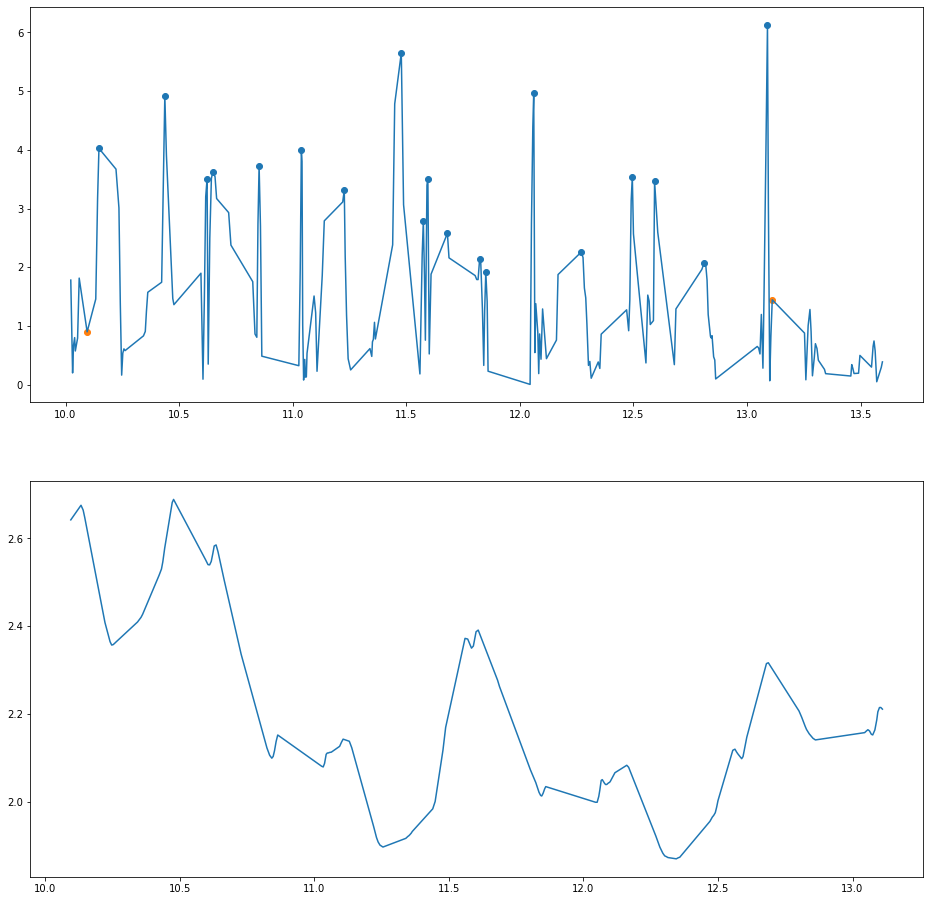

('171', 93, 'Male', 84, 85, False, 3.0165, 19, 0.164, 185.04500000000002, 2.177, 6.7227, 4842.4675)
('171', 93, 'Male', 84, 85, False, 3.0165, 19, 0.164, 185.04500000000002, 2.177, 6.7227, 4842.4675, 0.3779)
('171', 93, 'Male', 84, 85, False, 3.0165, 19, 0.164, 185.04500000000002, 2.177, 6.7227, 4842.4675, 0.3779, 0.0109, 0.0183, -0.0092, 9, 259, 'Ephatic Gnosis')
('171', 93, 'Male', 84, 85, False, 3.0165, 19, 0.164, 185.04500000000002, 2.177, 6.7227, 4842.4675, 0.3779, 0.0109, 0.0183, -0.0092, 9, 260, 'Chronic Anemia')
('171', 93, 'Male', 84, 85, False, 3.0165, 19, 0.164, 185.04500000000002, 2.177, 6.7227, 4842.4675, 0.3779, 0.0109, 0.0183, -0.0092, 9, 261, 'Chronic Kidney Disease')
('171', 93, 'Male', 84, 85, False, 3.0165, 19, 0.164, 185.04500000000002, 2.177, 6.7227, 4842.4675, 0.3779, 0.0109, 0.0183, -0.0092, 9, 262, 'Cervical Hernia')
('171', 93, 'Male', 84, 85, False, 3.0165, 19, 0.164, 185.04500000000002, 2.177, 6.7227, 4842.4675, 0.3779, 0.0109, 0.0183, -0.0092, 9, 103, 'Diabe

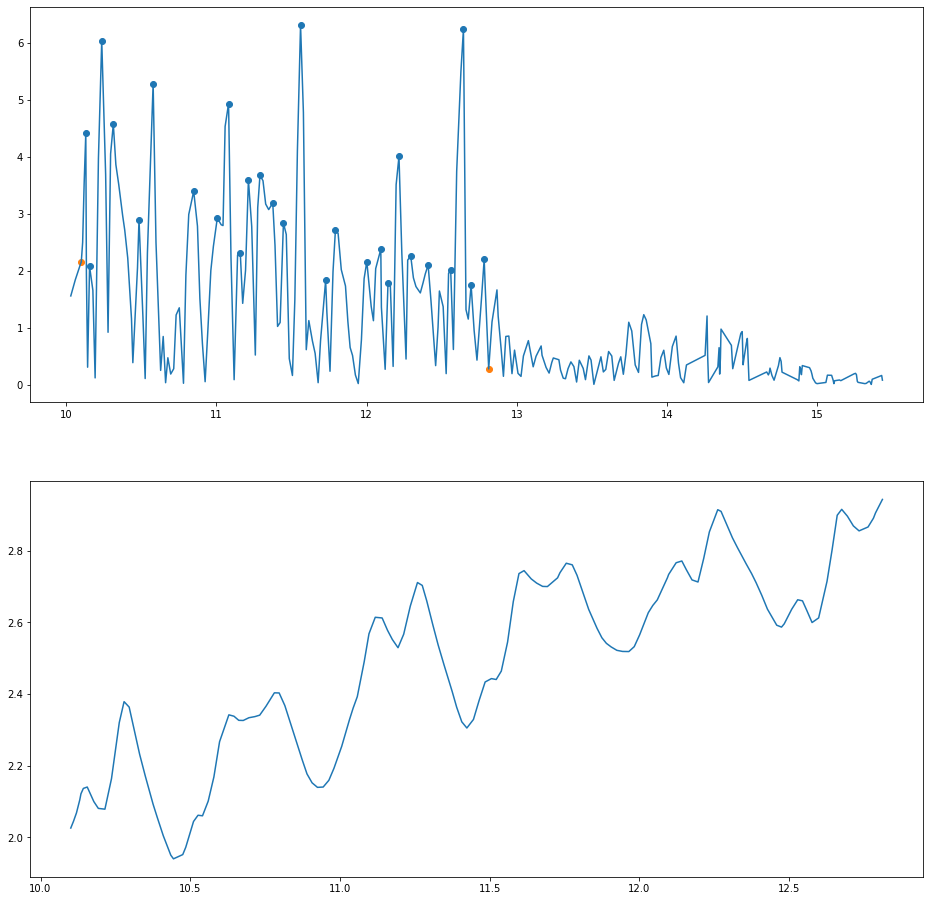

('172', 93, 'Male', 84, 85, False, 2.7115, 27, 0.1025, 211.29299999999998, 2.4858, 6.8281, 9271.214)
('172', 93, 'Male', 84, 85, False, 2.7115, 27, 0.1025, 211.29299999999998, 2.4858, 6.8281, 9271.214, 0.1756)
('172', 93, 'Male', 84, 85, False, 2.7115, 27, 0.1025, 211.29299999999998, 2.4858, 6.8281, 9271.214, 0.1756, 0.0385, -0.0167, 0.0524, 9, 259, 'Ephatic Gnosis')
('172', 93, 'Male', 84, 85, False, 2.7115, 27, 0.1025, 211.29299999999998, 2.4858, 6.8281, 9271.214, 0.1756, 0.0385, -0.0167, 0.0524, 9, 260, 'Chronic Anemia')
('172', 93, 'Male', 84, 85, False, 2.7115, 27, 0.1025, 211.29299999999998, 2.4858, 6.8281, 9271.214, 0.1756, 0.0385, -0.0167, 0.0524, 9, 261, 'Chronic Kidney Disease')
('172', 93, 'Male', 84, 85, False, 2.7115, 27, 0.1025, 211.29299999999998, 2.4858, 6.8281, 9271.214, 0.1756, 0.0385, -0.0167, 0.0524, 9, 262, 'Cervical Hernia')
('172', 93, 'Male', 84, 85, False, 2.7115, 27, 0.1025, 211.29299999999998, 2.4858, 6.8281, 9271.214, 0.1756, 0.0385, -0.0167, 0.0524, 9, 103,

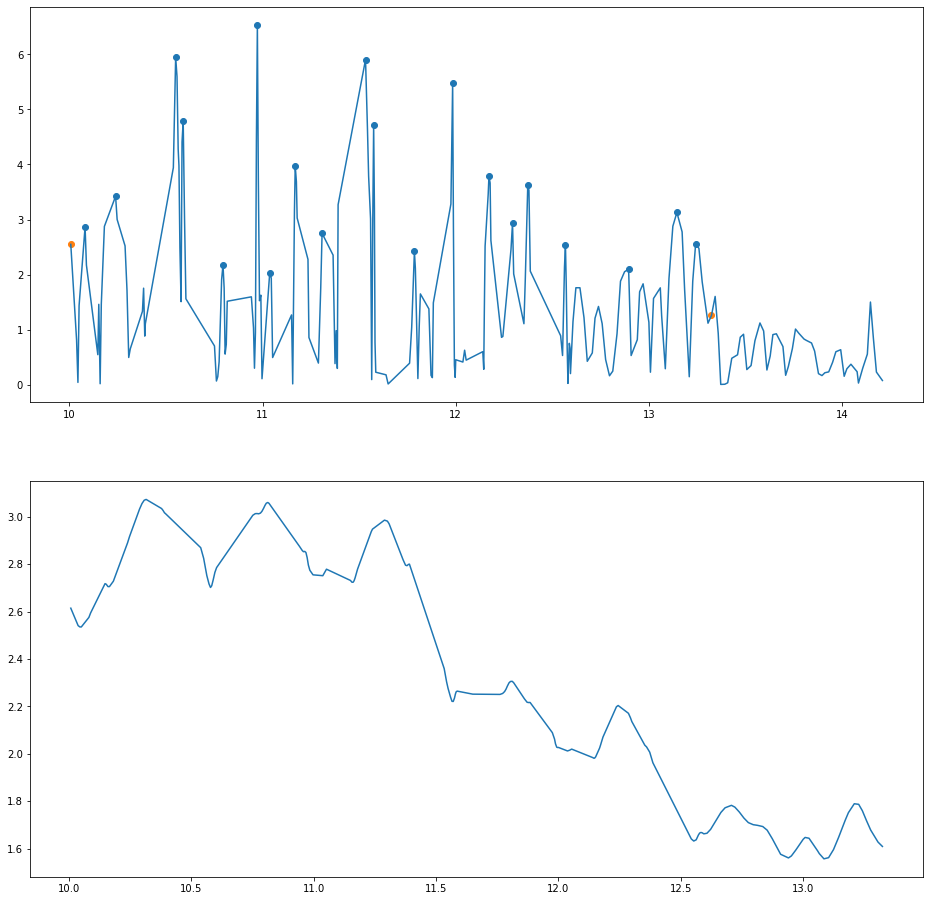

('173', 94, 'Male', 69, 74, False, 3.3175, 20, 0.1669, 170.57000000000002, 2.305, 7.8176, -3972.4823)
('173', 94, 'Male', 69, 74, False, 3.3175, 20, 0.1669, 170.57000000000002, 2.305, 7.8176, -3972.4823, 0.2234)
('173', 94, 'Male', 69, 74, False, 3.3175, 20, 0.1669, 170.57000000000002, 2.305, 7.8176, -3972.4823, 0.2234, 0.034, -0.0231, -0.017, 8, 264, 'Cognitive Deficit')
('173', 94, 'Male', 69, 74, False, 3.3175, 20, 0.1669, 170.57000000000002, 2.305, 7.8176, -3972.4823, 0.2234, 0.034, -0.0231, -0.017, 8, 265, 'Right Nephrectomy')
('173', 94, 'Male', 69, 74, False, 3.3175, 20, 0.1669, 170.57000000000002, 2.305, 7.8176, -3972.4823, 0.2234, 0.034, -0.0231, -0.017, 8, 266, 'Right Hemicolectomy')


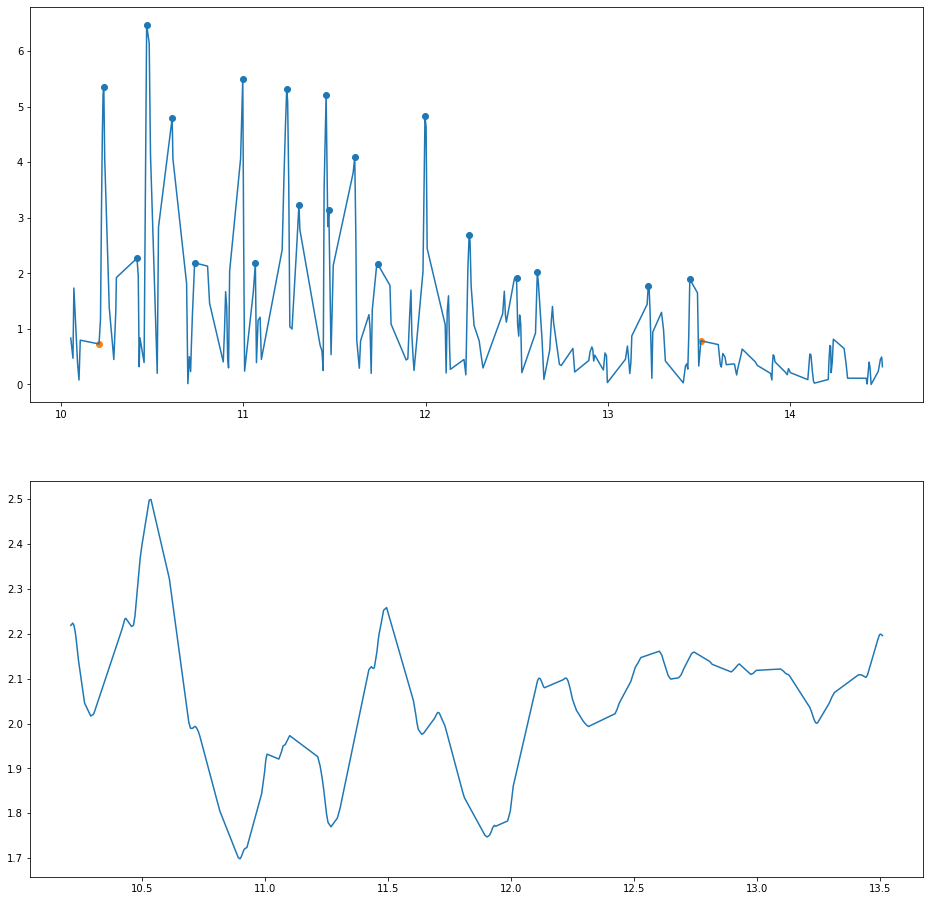

('174', 94, 'Male', 69, 74, False, 3.3005, 19, 0.179, 151.18200000000002, 2.043, 6.9528, 1745.8825)
('174', 94, 'Male', 69, 74, False, 3.3005, 19, 0.179, 151.18200000000002, 2.043, 6.9528, 1745.8825, 0.225)
('174', 94, 'Male', 69, 74, False, 3.3005, 19, 0.179, 151.18200000000002, 2.043, 6.9528, 1745.8825, 0.225, 0.0012, -0.0102, -0.0018, 8, 264, 'Cognitive Deficit')
('174', 94, 'Male', 69, 74, False, 3.3005, 19, 0.179, 151.18200000000002, 2.043, 6.9528, 1745.8825, 0.225, 0.0012, -0.0102, -0.0018, 8, 265, 'Right Nephrectomy')
('174', 94, 'Male', 69, 74, False, 3.3005, 19, 0.179, 151.18200000000002, 2.043, 6.9528, 1745.8825, 0.225, 0.0012, -0.0102, -0.0018, 8, 266, 'Right Hemicolectomy')


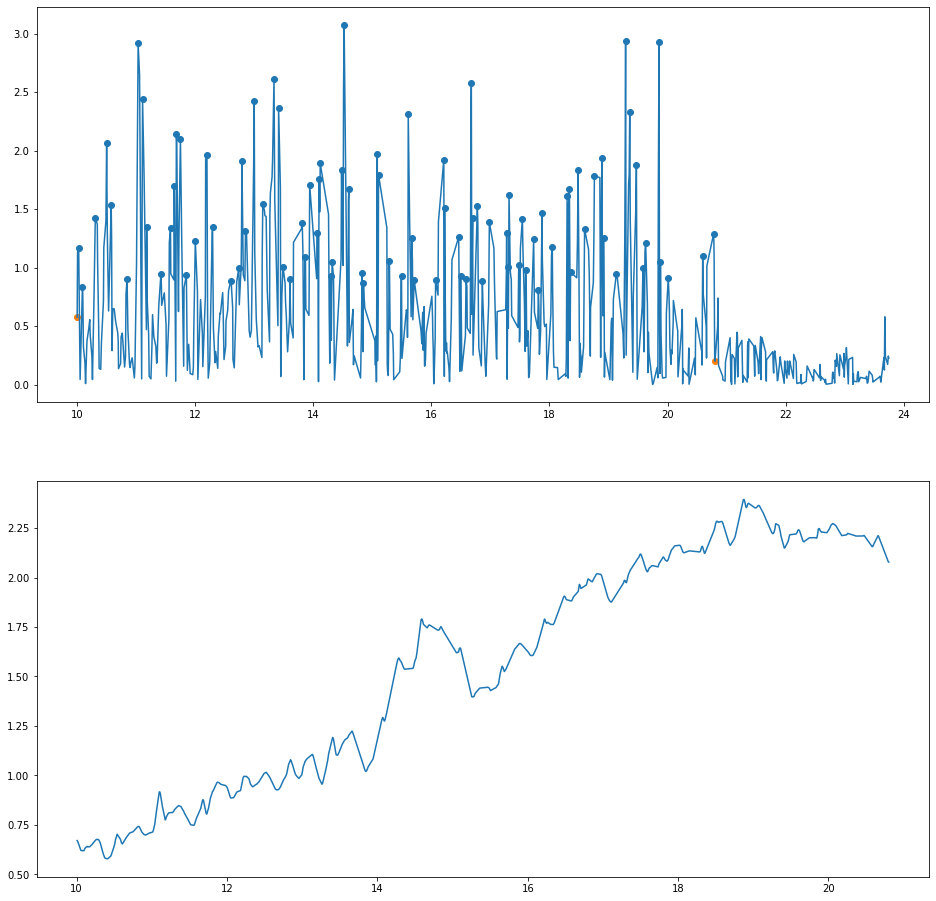

('175', 95, 'Male', 85, 56, True, 10.7965, 88, 0.124, 87.4608, 1.5618, 16.7764, 6030.4053)
('175', 95, 'Male', 85, 56, True, 10.7965, 88, 0.124, 87.4608, 1.5618, 16.7764, 6030.4053, 0.3717)
('175', 95, 'Male', 85, 56, True, 10.7965, 88, 0.124, 87.4608, 1.5618, 16.7764, 6030.4053, 0.3717, 0.0152, -0.0209, 0.0043, 9, 163, 'Vascular Dementia')
('175', 95, 'Male', 85, 56, True, 10.7965, 88, 0.124, 87.4608, 1.5618, 16.7764, 6030.4053, 0.3717, 0.0152, -0.0209, 0.0043, 9, 228, 'Benign Prostatic Hyperplasia')
('175', 95, 'Male', 85, 56, True, 10.7965, 88, 0.124, 87.4608, 1.5618, 16.7764, 6030.4053, 0.3717, 0.0152, -0.0209, 0.0043, 9, 122, 'Osteoporosis')
('175', 95, 'Male', 85, 56, True, 10.7965, 88, 0.124, 87.4608, 1.5618, 16.7764, 6030.4053, 0.3717, 0.0152, -0.0209, 0.0043, 9, 267, 'Ischemic Stroke')
('175', 95, 'Male', 85, 56, True, 10.7965, 88, 0.124, 87.4608, 1.5618, 16.7764, 6030.4053, 0.3717, 0.0152, -0.0209, 0.0043, 9, 103, 'Diabetes')
('175', 95, 'Male', 85, 56, True, 10.7965, 88, 0.1

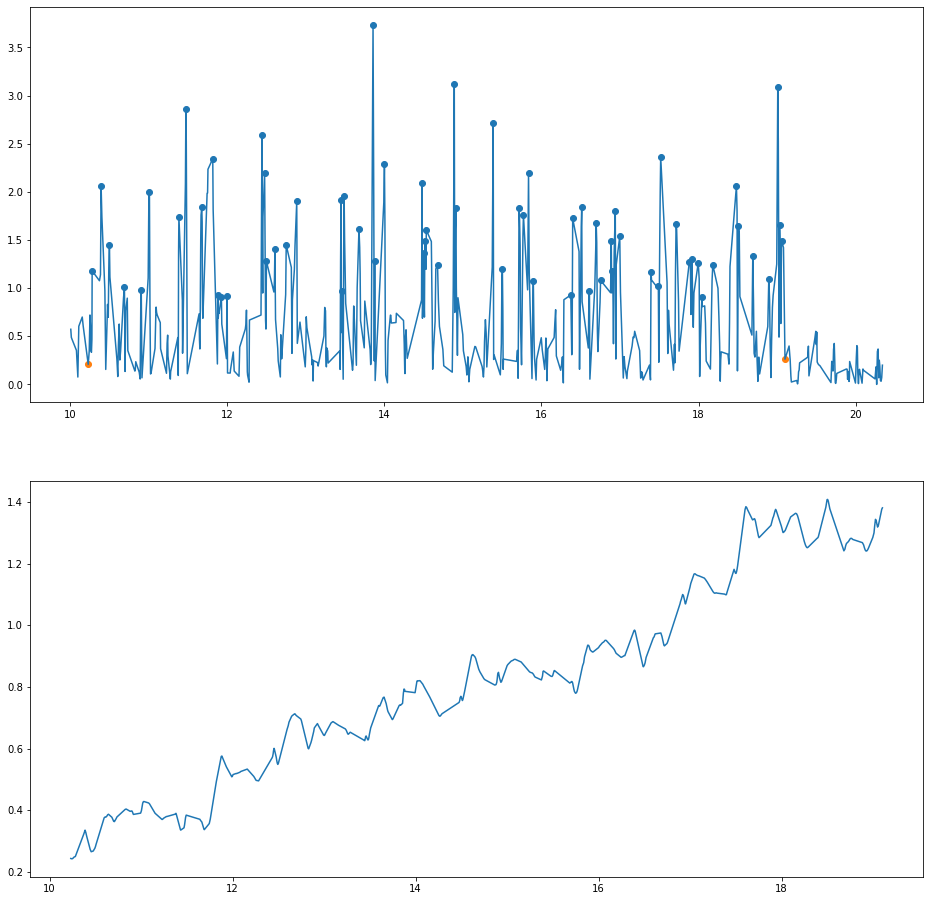

('176', 95, 'Male', 85, 56, True, 8.8685, 65, 0.1376, 45.808, 0.818, 7.2236, 2832.5757)
('176', 95, 'Male', 85, 56, True, 8.8685, 65, 0.1376, 45.808, 0.818, 7.2236, 2832.5757, 0.7587)
('176', 95, 'Male', 85, 56, True, 8.8685, 65, 0.1376, 45.808, 0.818, 7.2236, 2832.5757, 0.7587, -0.0147, -0.0417, 0.0196, 9, 163, 'Vascular Dementia')
('176', 95, 'Male', 85, 56, True, 8.8685, 65, 0.1376, 45.808, 0.818, 7.2236, 2832.5757, 0.7587, -0.0147, -0.0417, 0.0196, 9, 228, 'Benign Prostatic Hyperplasia')
('176', 95, 'Male', 85, 56, True, 8.8685, 65, 0.1376, 45.808, 0.818, 7.2236, 2832.5757, 0.7587, -0.0147, -0.0417, 0.0196, 9, 122, 'Osteoporosis')
('176', 95, 'Male', 85, 56, True, 8.8685, 65, 0.1376, 45.808, 0.818, 7.2236, 2832.5757, 0.7587, -0.0147, -0.0417, 0.0196, 9, 267, 'Ischemic Stroke')
('176', 95, 'Male', 85, 56, True, 8.8685, 65, 0.1376, 45.808, 0.818, 7.2236, 2832.5757, 0.7587, -0.0147, -0.0417, 0.0196, 9, 103, 'Diabetes')
('176', 95, 'Male', 85, 56, True, 8.8685, 65, 0.1376, 45.808, 0.81

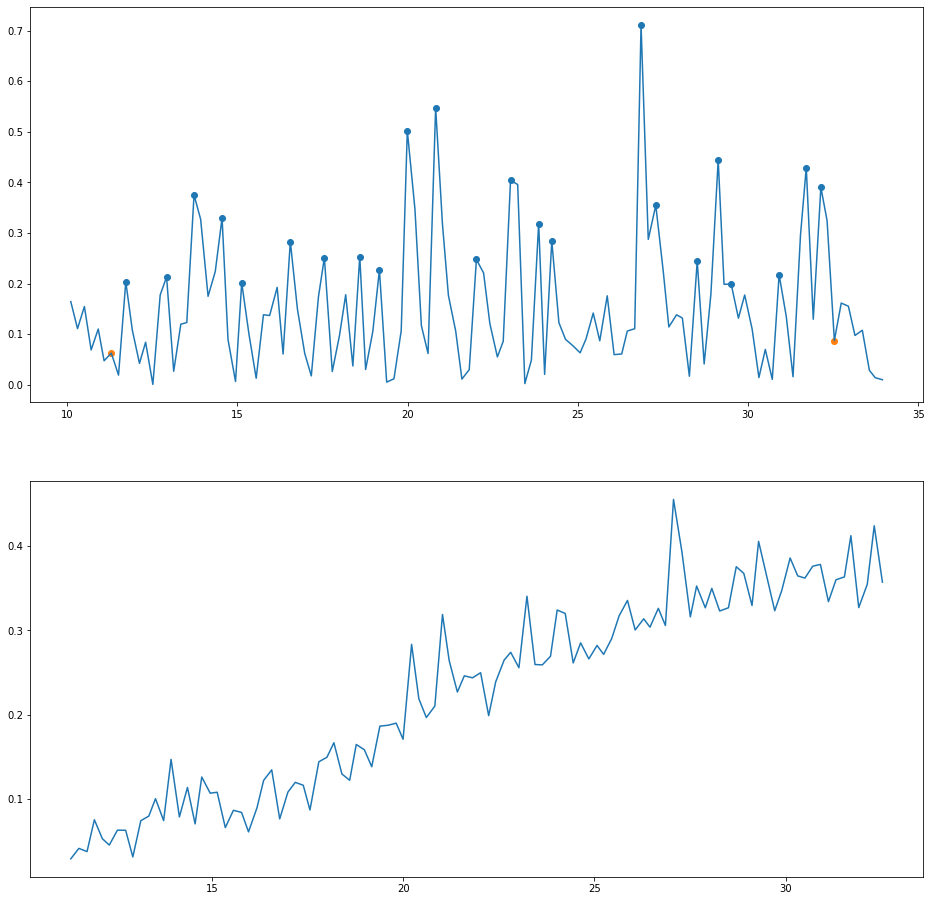

('177', 96, 'Female', 84, 51, True, 21.2305, 23, 0.9282, 11.602500000000001, 0.2275, 4.8058, -4.0795)
('177', 96, 'Female', 84, 51, True, 21.2305, 23, 0.9282, 11.602500000000001, 0.2275, 4.8058, -4.0795, 0.0771)
('177', 96, 'Female', 84, 51, True, 21.2305, 23, 0.9282, 11.602500000000001, 0.2275, 4.8058, -4.0795, 0.0771, -0.031, 0.0488, -0.0045, 8, 104, 'Arterial Hypertension')
('177', 96, 'Female', 84, 51, True, 21.2305, 23, 0.9282, 11.602500000000001, 0.2275, 4.8058, -4.0795, 0.0771, -0.031, 0.0488, -0.0045, 8, 113, 'Psychosis')
('177', 96, 'Female', 84, 51, True, 21.2305, 23, 0.9282, 11.602500000000001, 0.2275, 4.8058, -4.0795, 0.0771, -0.031, 0.0488, -0.0045, 8, 235, 'Deep Vein Thrombosis')


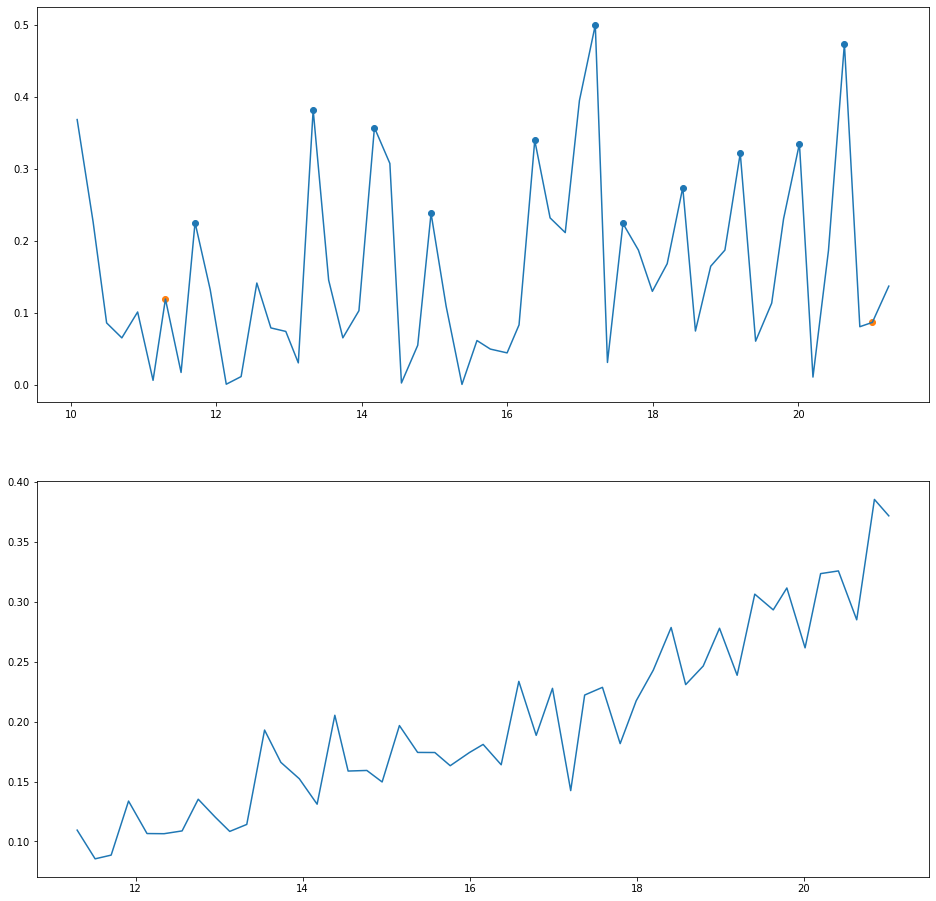

('178', 96, 'Female', 84, 51, True, 9.7145, 11, 0.8928, 10.2051, 0.2001, 1.9198, 4.3253)
('178', 96, 'Female', 84, 51, True, 9.7145, 11, 0.8928, 10.2051, 0.2001, 1.9198, 4.3253, 1.088)
('178', 96, 'Female', 84, 51, True, 9.7145, 11, 0.8928, 10.2051, 0.2001, 1.9198, 4.3253, 1.088, -0.0518, -0.0199, -0.0351, 8, 104, 'Arterial Hypertension')
('178', 96, 'Female', 84, 51, True, 9.7145, 11, 0.8928, 10.2051, 0.2001, 1.9198, 4.3253, 1.088, -0.0518, -0.0199, -0.0351, 8, 113, 'Psychosis')
('178', 96, 'Female', 84, 51, True, 9.7145, 11, 0.8928, 10.2051, 0.2001, 1.9198, 4.3253, 1.088, -0.0518, -0.0199, -0.0351, 8, 235, 'Deep Vein Thrombosis')


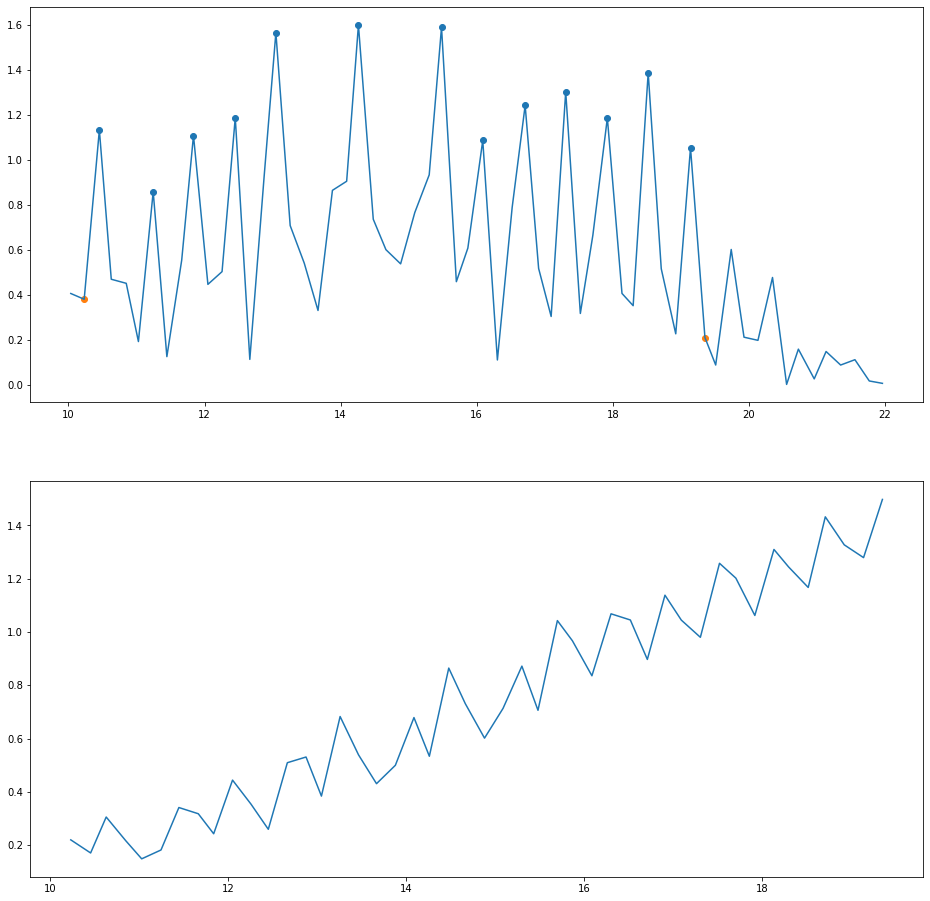

('179', 97, 'Female', 84, 50, True, 9.1225, 13, 0.7244, 37.285000000000004, 0.7457, 6.6876, 56.8205)
('179', 97, 'Female', 84, 50, True, 9.1225, 13, 0.7244, 37.285000000000004, 0.7457, 6.6876, 56.8205, 0.48)
('179', 97, 'Female', 84, 50, True, 9.1225, 13, 0.7244, 37.285000000000004, 0.7457, 6.6876, 56.8205, 0.48, -0.006, 0.0348, 0.0741, 8, 104, 'Arterial Hypertension')
('179', 97, 'Female', 84, 50, True, 9.1225, 13, 0.7244, 37.285000000000004, 0.7457, 6.6876, 56.8205, 0.48, -0.006, 0.0348, 0.0741, 8, 122, 'Osteoporosis')
('179', 97, 'Female', 84, 50, True, 9.1225, 13, 0.7244, 37.285000000000004, 0.7457, 6.6876, 56.8205, 0.48, -0.006, 0.0348, 0.0741, 8, 106, 'Dyslipidemia')
('179', 97, 'Female', 84, 50, True, 9.1225, 13, 0.7244, 37.285000000000004, 0.7457, 6.6876, 56.8205, 0.48, -0.006, 0.0348, 0.0741, 8, 179, "Parkinson'S Disease")
('179', 97, 'Female', 84, 50, True, 9.1225, 13, 0.7244, 37.285000000000004, 0.7457, 6.6876, 56.8205, 0.48, -0.006, 0.0348, 0.0741, 8, 269, 'Fracture')
('179

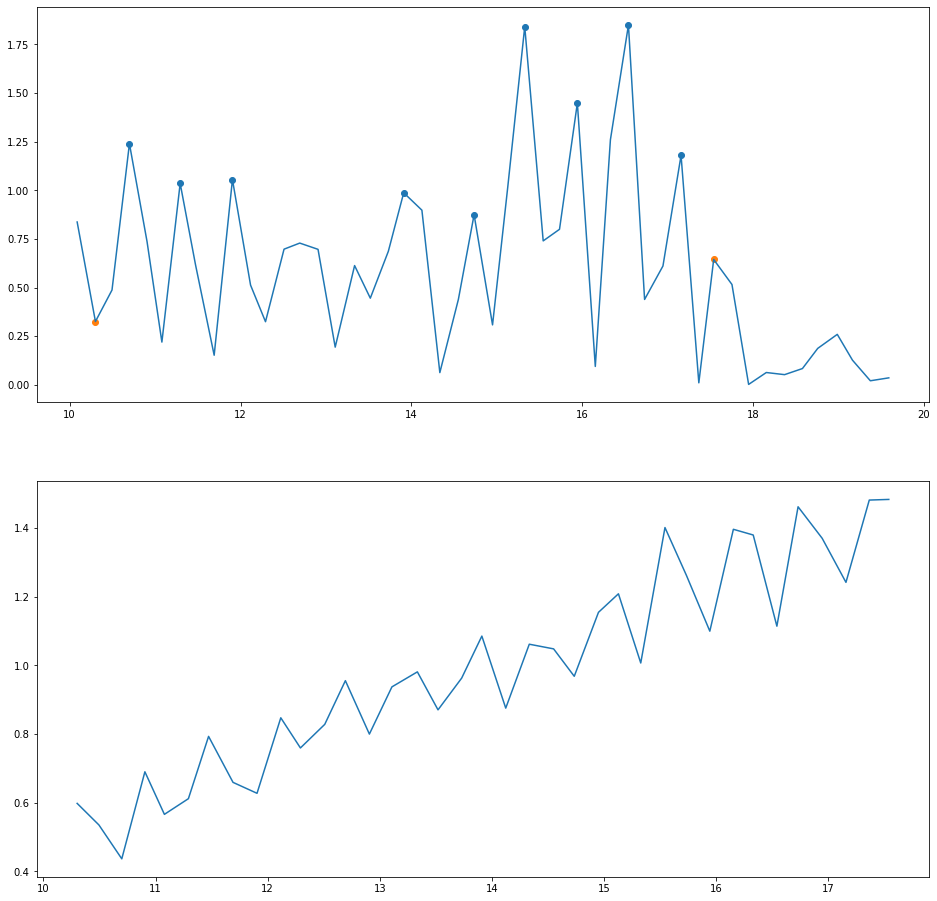

('180', 97, 'Female', 84, 50, True, 7.2385, 9, 0.8077, 49.43, 0.9886, 7.129, 47.7905)
('180', 97, 'Female', 84, 50, True, 7.2385, 9, 0.8077, 49.43, 0.9886, 7.129, 47.7905, 2.6112)
('180', 97, 'Female', 84, 50, True, 7.2385, 9, 0.8077, 49.43, 0.9886, 7.129, 47.7905, 2.6112, -0.012, -0.0321, 0.0235, 8, 104, 'Arterial Hypertension')
('180', 97, 'Female', 84, 50, True, 7.2385, 9, 0.8077, 49.43, 0.9886, 7.129, 47.7905, 2.6112, -0.012, -0.0321, 0.0235, 8, 122, 'Osteoporosis')
('180', 97, 'Female', 84, 50, True, 7.2385, 9, 0.8077, 49.43, 0.9886, 7.129, 47.7905, 2.6112, -0.012, -0.0321, 0.0235, 8, 106, 'Dyslipidemia')
('180', 97, 'Female', 84, 50, True, 7.2385, 9, 0.8077, 49.43, 0.9886, 7.129, 47.7905, 2.6112, -0.012, -0.0321, 0.0235, 8, 179, "Parkinson'S Disease")
('180', 97, 'Female', 84, 50, True, 7.2385, 9, 0.8077, 49.43, 0.9886, 7.129, 47.7905, 2.6112, -0.012, -0.0321, 0.0235, 8, 269, 'Fracture')
('180', 97, 'Female', 84, 50, True, 7.2385, 9, 0.8077, 49.43, 0.9886, 7.129, 47.7905, 2.6112,

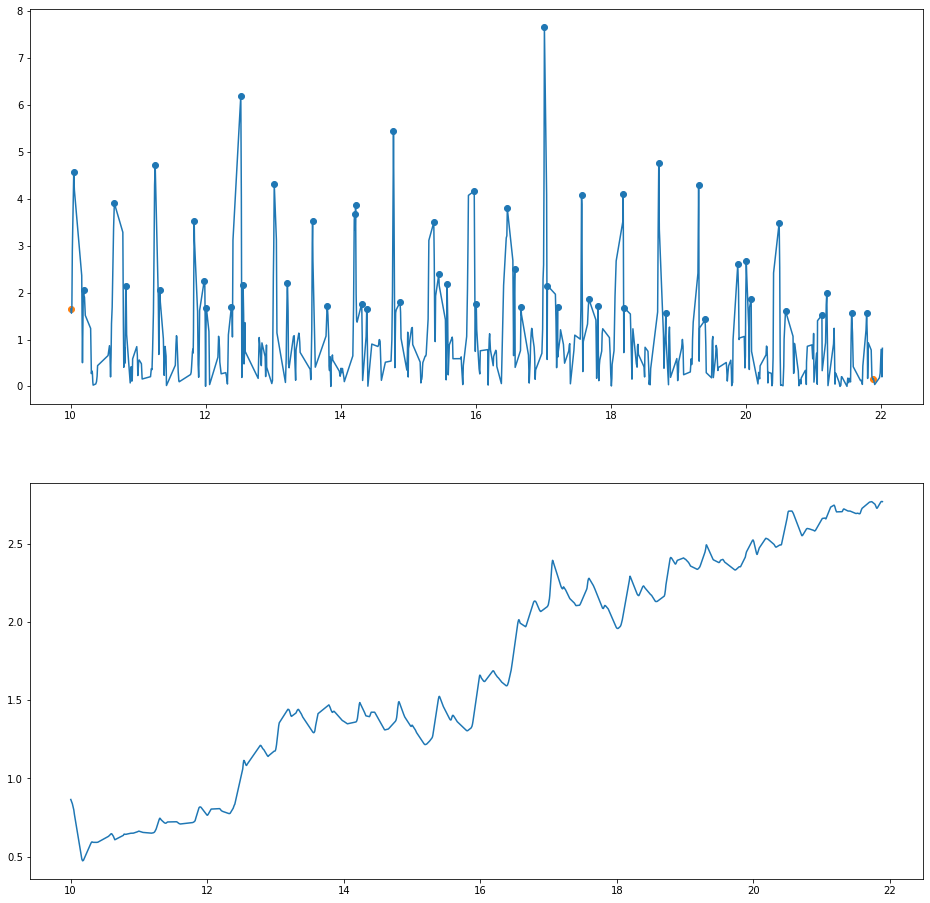

('181', 98, 'Female', 82, 75, False, 11.8865, 51, 0.2353, 127.02, 1.6936, 20.0228, 12368.2955)
('181', 98, 'Female', 82, 75, False, 11.8865, 51, 0.2353, 127.02, 1.6936, 20.0228, 12368.2955, 0.2592)
('181', 98, 'Female', 82, 75, False, 11.8865, 51, 0.2353, 127.02, 1.6936, 20.0228, 12368.2955, 0.2592, 0.0023, -0.002, 0.03, 8, 136, 'Stroke')
('181', 98, 'Female', 82, 75, False, 11.8865, 51, 0.2353, 127.02, 1.6936, 20.0228, 12368.2955, 0.2592, 0.0023, -0.002, 0.03, 8, 108, 'Obstructive Sleep Apnea Syndrome')
('181', 98, 'Female', 82, 75, False, 11.8865, 51, 0.2353, 127.02, 1.6936, 20.0228, 12368.2955, 0.2592, 0.0023, -0.002, 0.03, 8, 142, 'Heart Failure')
('181', 98, 'Female', 82, 75, False, 11.8865, 51, 0.2353, 127.02, 1.6936, 20.0228, 12368.2955, 0.2592, 0.0023, -0.002, 0.03, 8, 106, 'Dyslipidemia')
('181', 98, 'Female', 82, 75, False, 11.8865, 51, 0.2353, 127.02, 1.6936, 20.0228, 12368.2955, 0.2592, 0.0023, -0.002, 0.03, 8, 213, 'Alzheimer')
('181', 98, 'Female', 82, 75, False, 11.8865,

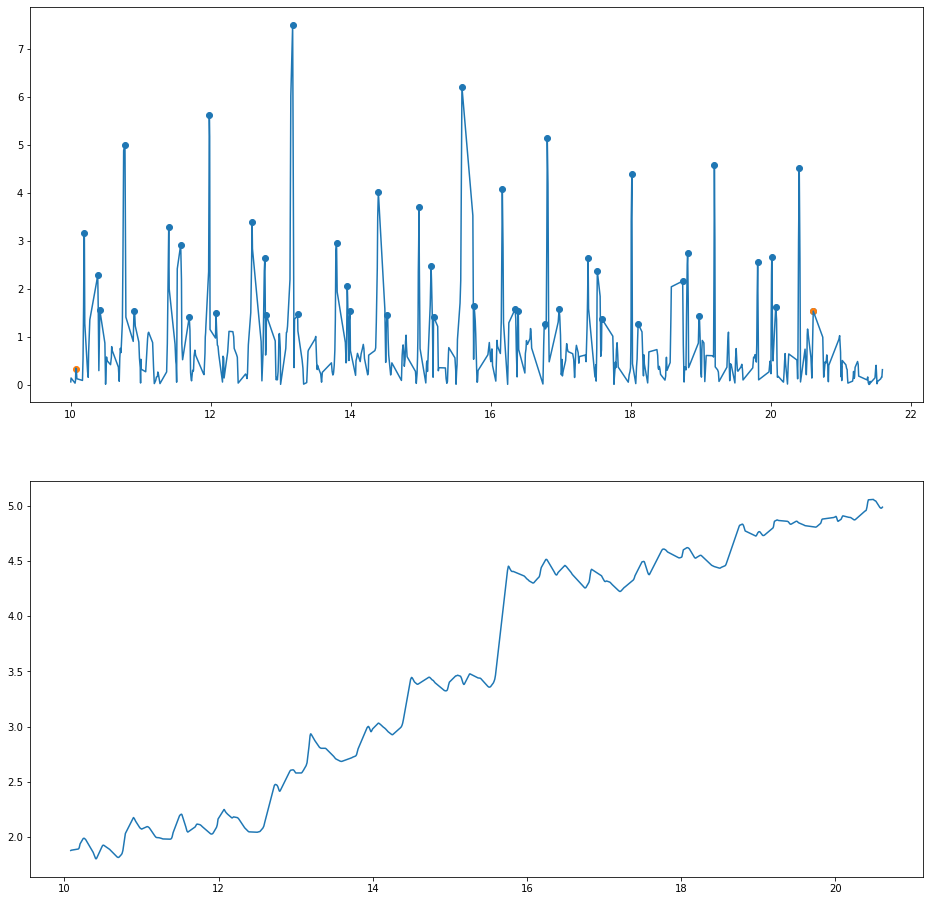

('182', 98, 'Female', 82, 75, False, 10.5265, 45, 0.2371, 265.0875, 3.5345, 36.9197, 25182.7805)
('182', 98, 'Female', 82, 75, False, 10.5265, 45, 0.2371, 265.0875, 3.5345, 36.9197, 25182.7805, 0.2148)
('182', 98, 'Female', 82, 75, False, 10.5265, 45, 0.2371, 265.0875, 3.5345, 36.9197, 25182.7805, 0.2148, -0.0498, -0.0529, -0.0035, 8, 136, 'Stroke')
('182', 98, 'Female', 82, 75, False, 10.5265, 45, 0.2371, 265.0875, 3.5345, 36.9197, 25182.7805, 0.2148, -0.0498, -0.0529, -0.0035, 8, 108, 'Obstructive Sleep Apnea Syndrome')
('182', 98, 'Female', 82, 75, False, 10.5265, 45, 0.2371, 265.0875, 3.5345, 36.9197, 25182.7805, 0.2148, -0.0498, -0.0529, -0.0035, 8, 142, 'Heart Failure')
('182', 98, 'Female', 82, 75, False, 10.5265, 45, 0.2371, 265.0875, 3.5345, 36.9197, 25182.7805, 0.2148, -0.0498, -0.0529, -0.0035, 8, 106, 'Dyslipidemia')
('182', 98, 'Female', 82, 75, False, 10.5265, 45, 0.2371, 265.0875, 3.5345, 36.9197, 25182.7805, 0.2148, -0.0498, -0.0529, -0.0035, 8, 213, 'Alzheimer')
('182'

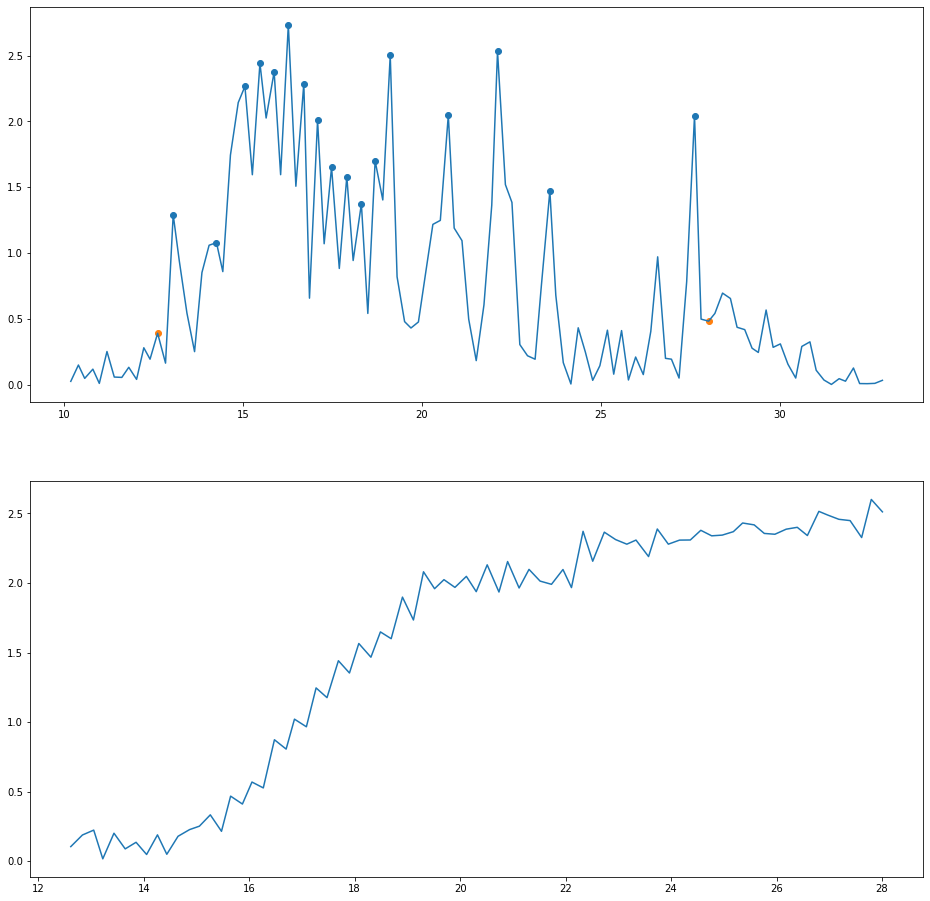

('183', 99, 'Female', 64, 82, False, 15.3925, 17, 0.9107, 130.339, 1.5895, 24.2951, 421.3985)
('183', 99, 'Female', 64, 82, False, 15.3925, 17, 0.9107, 130.339, 1.5895, 24.2951, 421.3985, 0.3852)
('183', 99, 'Female', 64, 82, False, 15.3925, 17, 0.9107, 130.339, 1.5895, 24.2951, 421.3985, 0.3852, -0.0277, 0.0631, -0.1204, 8, 108, 'Obstructive Sleep Apnea Syndrome')
('183', 99, 'Female', 64, 82, False, 15.3925, 17, 0.9107, 130.339, 1.5895, 24.2951, 421.3985, 0.3852, -0.0277, 0.0631, -0.1204, 8, 146, 'Obesity')
('183', 99, 'Female', 64, 82, False, 15.3925, 17, 0.9107, 130.339, 1.5895, 24.2951, 421.3985, 0.3852, -0.0277, 0.0631, -0.1204, 8, 272, 'Bipolar Disorder')
('183', 99, 'Female', 64, 82, False, 15.3925, 17, 0.9107, 130.339, 1.5895, 24.2951, 421.3985, 0.3852, -0.0277, 0.0631, -0.1204, 8, 104, 'Arterial Hypertension')
('183', 99, 'Female', 64, 82, False, 15.3925, 17, 0.9107, 130.339, 1.5895, 24.2951, 421.3985, 0.3852, -0.0277, 0.0631, -0.1204, 8, 148, 'Allergic Rhinitis')


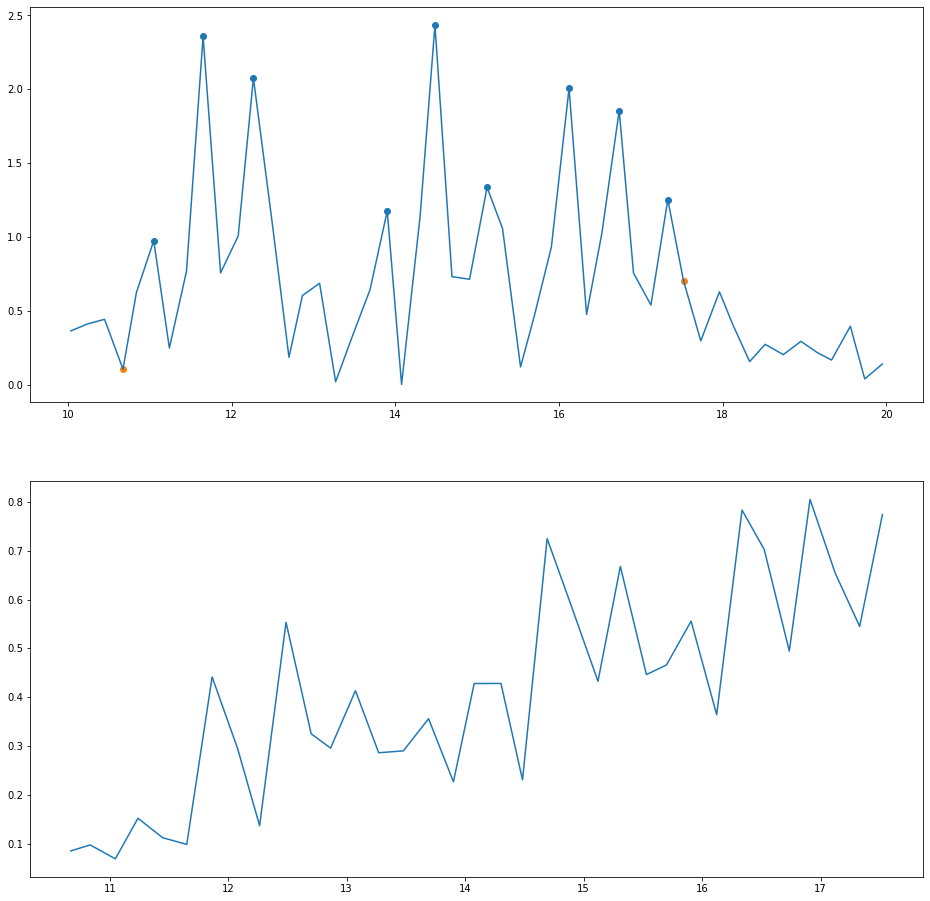

('184', 99, 'Female', 64, 82, False, 6.8515, 9, 0.7859, 33.5708, 0.4094, 2.761, -246.2947)
('184', 99, 'Female', 64, 82, False, 6.8515, 9, 0.7859, 33.5708, 0.4094, 2.761, -246.2947, 0.0763)
('184', 99, 'Female', 64, 82, False, 6.8515, 9, 0.7859, 33.5708, 0.4094, 2.761, -246.2947, 0.0763, -0.029, -0.0381, 0.0057, 8, 108, 'Obstructive Sleep Apnea Syndrome')
('184', 99, 'Female', 64, 82, False, 6.8515, 9, 0.7859, 33.5708, 0.4094, 2.761, -246.2947, 0.0763, -0.029, -0.0381, 0.0057, 8, 146, 'Obesity')
('184', 99, 'Female', 64, 82, False, 6.8515, 9, 0.7859, 33.5708, 0.4094, 2.761, -246.2947, 0.0763, -0.029, -0.0381, 0.0057, 8, 272, 'Bipolar Disorder')
('184', 99, 'Female', 64, 82, False, 6.8515, 9, 0.7859, 33.5708, 0.4094, 2.761, -246.2947, 0.0763, -0.029, -0.0381, 0.0057, 8, 104, 'Arterial Hypertension')
('184', 99, 'Female', 64, 82, False, 6.8515, 9, 0.7859, 33.5708, 0.4094, 2.761, -246.2947, 0.0763, -0.029, -0.0381, 0.0057, 8, 148, 'Allergic Rhinitis')


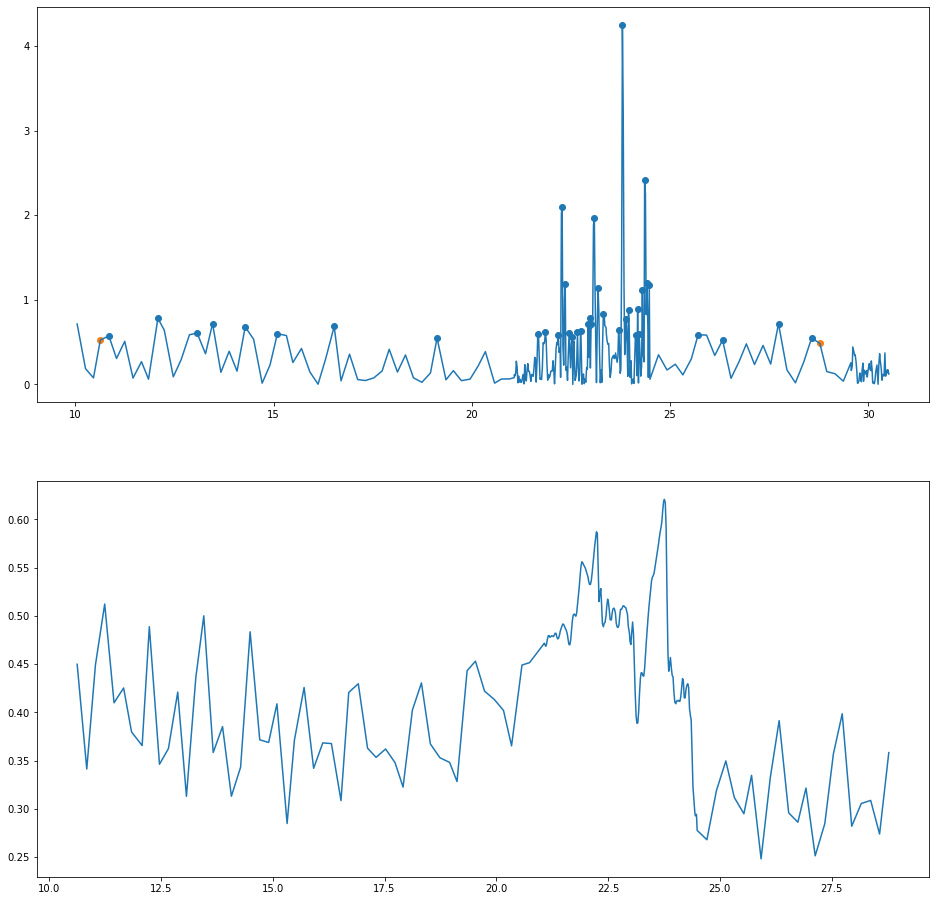

('185', 100, 'Female', 90, 33, True, 18.1505, 38, 0.4797, 14.9391, 0.4527, 7.1655, -174.7642)
('185', 100, 'Female', 90, 33, True, 18.1505, 38, 0.4797, 14.9391, 0.4527, 7.1655, -174.7642, 0.4391)
('185', 100, 'Female', 90, 33, True, 18.1505, 38, 0.4797, 14.9391, 0.4527, 7.1655, -174.7642, 0.4391, -0.0817, 0.1644, -0.1772, 8, 273, 'Thyroid Follicular Tumor')
('185', 100, 'Female', 90, 33, True, 18.1505, 38, 0.4797, 14.9391, 0.4527, 7.1655, -174.7642, 0.4391, -0.0817, 0.1644, -0.1772, 8, 274, 'Wrist Osteoarthritis')
('185', 100, 'Female', 90, 33, True, 18.1505, 38, 0.4797, 14.9391, 0.4527, 7.1655, -174.7642, 0.4391, -0.0817, 0.1644, -0.1772, 8, 275, 'Constipation')


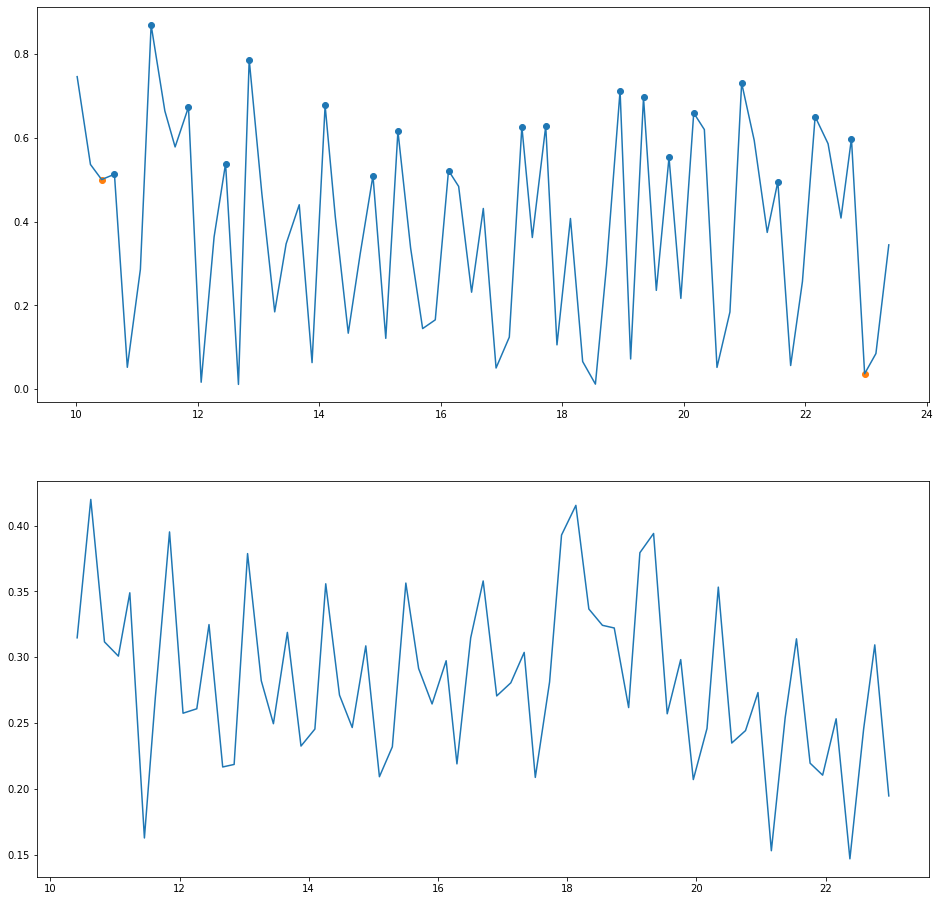

('186', 100, 'Female', 90, 33, True, 12.5645, 19, 0.6747, 9.3489, 0.2833, 3.6238, -41.3749)
('186', 100, 'Female', 90, 33, True, 12.5645, 19, 0.6747, 9.3489, 0.2833, 3.6238, -41.3749, 0.3782)
('186', 100, 'Female', 90, 33, True, 12.5645, 19, 0.6747, 9.3489, 0.2833, 3.6238, -41.3749, 0.3782, -0.0057, -0.0475, 0.0173, 8, 273, 'Thyroid Follicular Tumor')
('186', 100, 'Female', 90, 33, True, 12.5645, 19, 0.6747, 9.3489, 0.2833, 3.6238, -41.3749, 0.3782, -0.0057, -0.0475, 0.0173, 8, 274, 'Wrist Osteoarthritis')
('186', 100, 'Female', 90, 33, True, 12.5645, 19, 0.6747, 9.3489, 0.2833, 3.6238, -41.3749, 0.3782, -0.0057, -0.0475, 0.0173, 8, 275, 'Constipation')


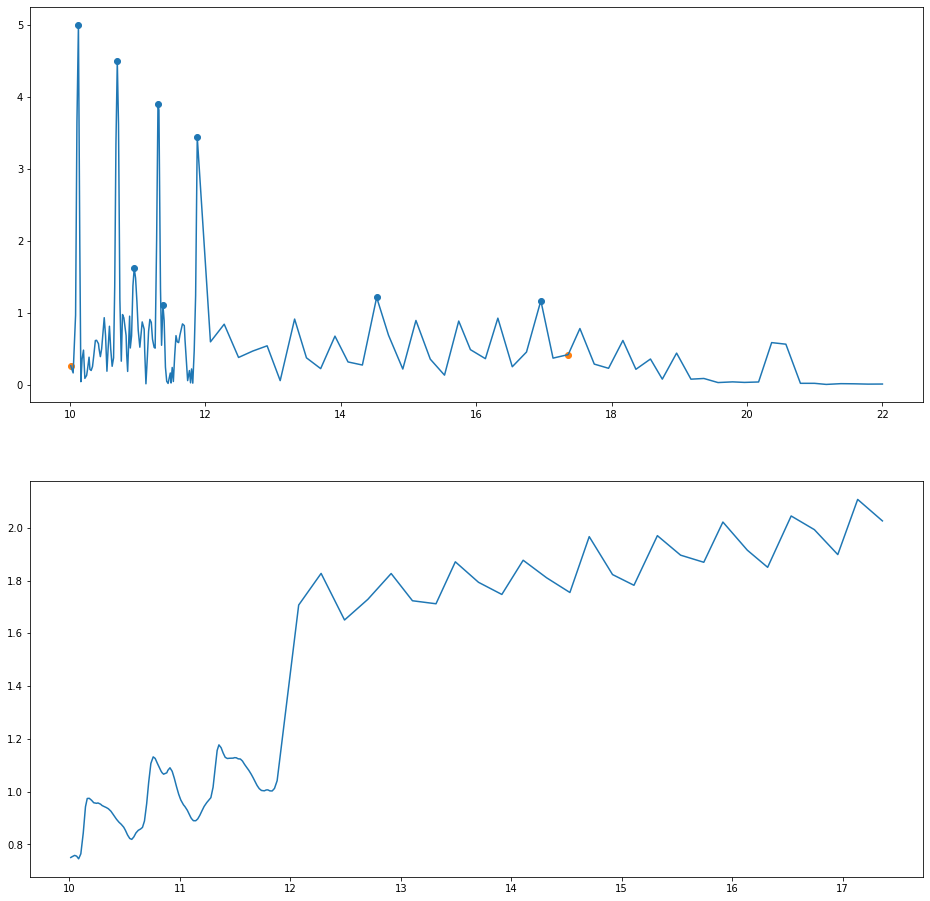

('187', 101, 'Female', 84, 52, False, 7.3475, 8, 0.9762, 60.819199999999995, 1.1696, 11.8353, 953.1969)
('187', 101, 'Female', 84, 52, False, 7.3475, 8, 0.9762, 60.819199999999995, 1.1696, 11.8353, 953.1969, 0.8517)
('187', 101, 'Female', 84, 52, False, 7.3475, 8, 0.9762, 60.819199999999995, 1.1696, 11.8353, 953.1969, 0.8517, 0.0126, -0.0249, -0.0124, 10, 276, 'Lymphoma')
('187', 101, 'Female', 84, 52, False, 7.3475, 8, 0.9762, 60.819199999999995, 1.1696, 11.8353, 953.1969, 0.8517, 0.0126, -0.0249, -0.0124, 10, 104, 'Arterial Hypertension')
('187', 101, 'Female', 84, 52, False, 7.3475, 8, 0.9762, 60.819199999999995, 1.1696, 11.8353, 953.1969, 0.8517, 0.0126, -0.0249, -0.0124, 10, 169, 'Neurotic Depression')
('187', 101, 'Female', 84, 52, False, 7.3475, 8, 0.9762, 60.819199999999995, 1.1696, 11.8353, 953.1969, 0.8517, 0.0126, -0.0249, -0.0124, 10, 236, 'Hyperthyroidism')
('187', 101, 'Female', 84, 52, False, 7.3475, 8, 0.9762, 60.819199999999995, 1.1696, 11.8353, 953.1969, 0.8517, 0.012

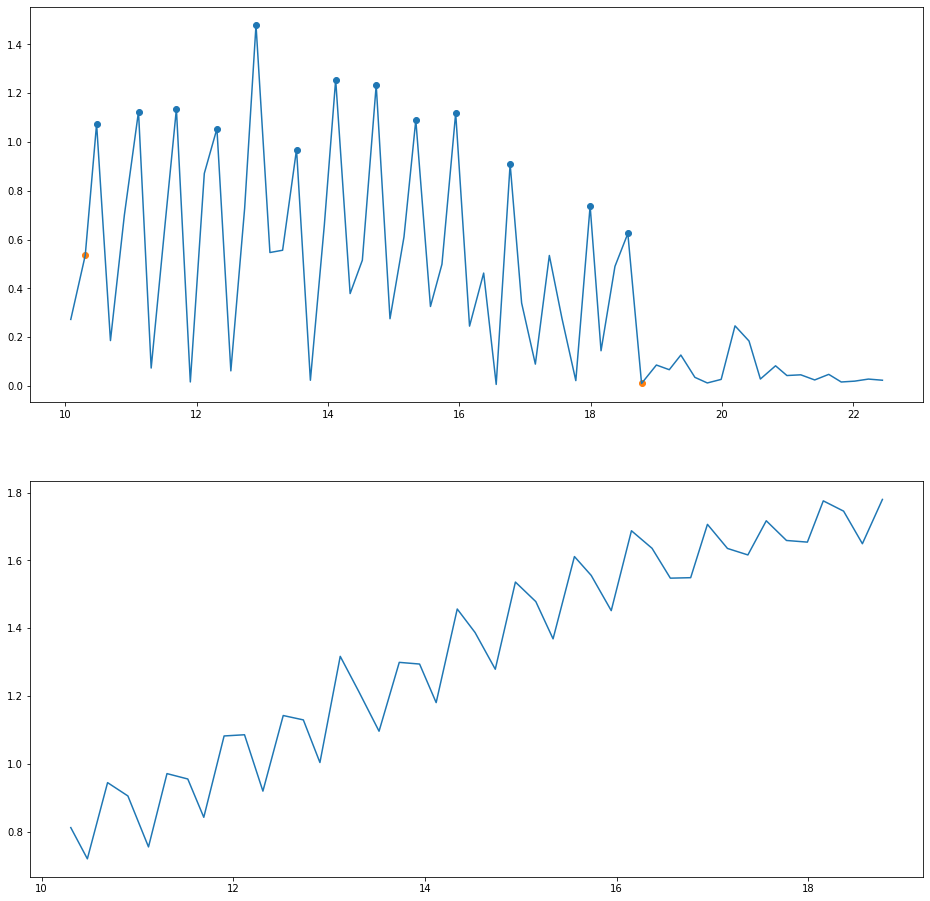

('188', 101, 'Female', 84, 52, False, 8.4705, 13, 0.6745, 69.13919999999999, 1.3296, 11.3535, 171.0493)
('188', 101, 'Female', 84, 52, False, 8.4705, 13, 0.6745, 69.13919999999999, 1.3296, 11.3535, 171.0493, 0.1566)
('188', 101, 'Female', 84, 52, False, 8.4705, 13, 0.6745, 69.13919999999999, 1.3296, 11.3535, 171.0493, 0.1566, -0.0023, -0.0261, 0.0434, 10, 276, 'Lymphoma')
('188', 101, 'Female', 84, 52, False, 8.4705, 13, 0.6745, 69.13919999999999, 1.3296, 11.3535, 171.0493, 0.1566, -0.0023, -0.0261, 0.0434, 10, 104, 'Arterial Hypertension')
('188', 101, 'Female', 84, 52, False, 8.4705, 13, 0.6745, 69.13919999999999, 1.3296, 11.3535, 171.0493, 0.1566, -0.0023, -0.0261, 0.0434, 10, 169, 'Neurotic Depression')
('188', 101, 'Female', 84, 52, False, 8.4705, 13, 0.6745, 69.13919999999999, 1.3296, 11.3535, 171.0493, 0.1566, -0.0023, -0.0261, 0.0434, 10, 236, 'Hyperthyroidism')
('188', 101, 'Female', 84, 52, False, 8.4705, 13, 0.6745, 69.13919999999999, 1.3296, 11.3535, 171.0493, 0.1566, -0.00

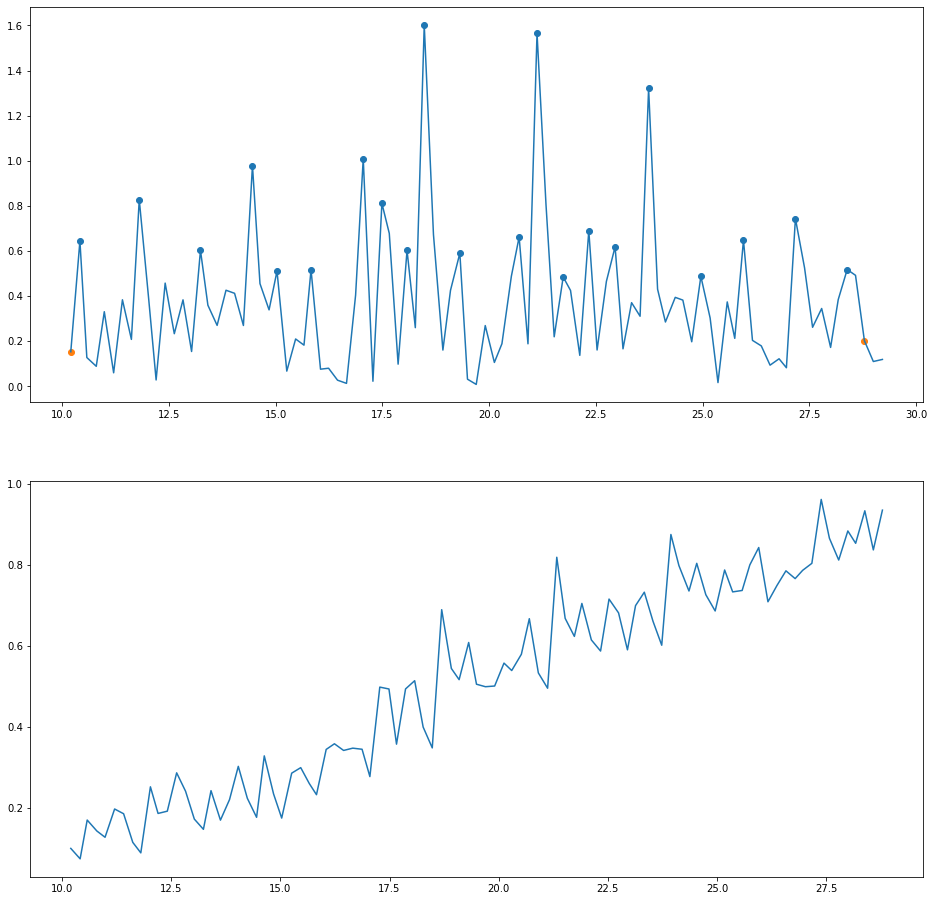

('189', 102, 'Female', 60, 77, True, 18.5915, 21, 0.8992, 39.039, 0.507, 9.3211, -40.1319)
('189', 102, 'Female', 60, 77, True, 18.5915, 21, 0.8992, 39.039, 0.507, 9.3211, -40.1319, 0.3683)
('189', 102, 'Female', 60, 77, True, 18.5915, 21, 0.8992, 39.039, 0.507, 9.3211, -40.1319, 0.3683, 0.0003, -0.0033, 0.0397, 7, 222, 'Anxiety')
('189', 102, 'Female', 60, 77, True, 18.5915, 21, 0.8992, 39.039, 0.507, 9.3211, -40.1319, 0.3683, 0.0003, -0.0033, 0.0397, 7, 103, 'Diabetes')
('189', 102, 'Female', 60, 77, True, 18.5915, 21, 0.8992, 39.039, 0.507, 9.3211, -40.1319, 0.3683, 0.0003, -0.0033, 0.0397, 7, 277, 'Smoking')
('189', 102, 'Female', 60, 77, True, 18.5915, 21, 0.8992, 39.039, 0.507, 9.3211, -40.1319, 0.3683, 0.0003, -0.0033, 0.0397, 7, 278, 'Bipolar Affective Disorder')


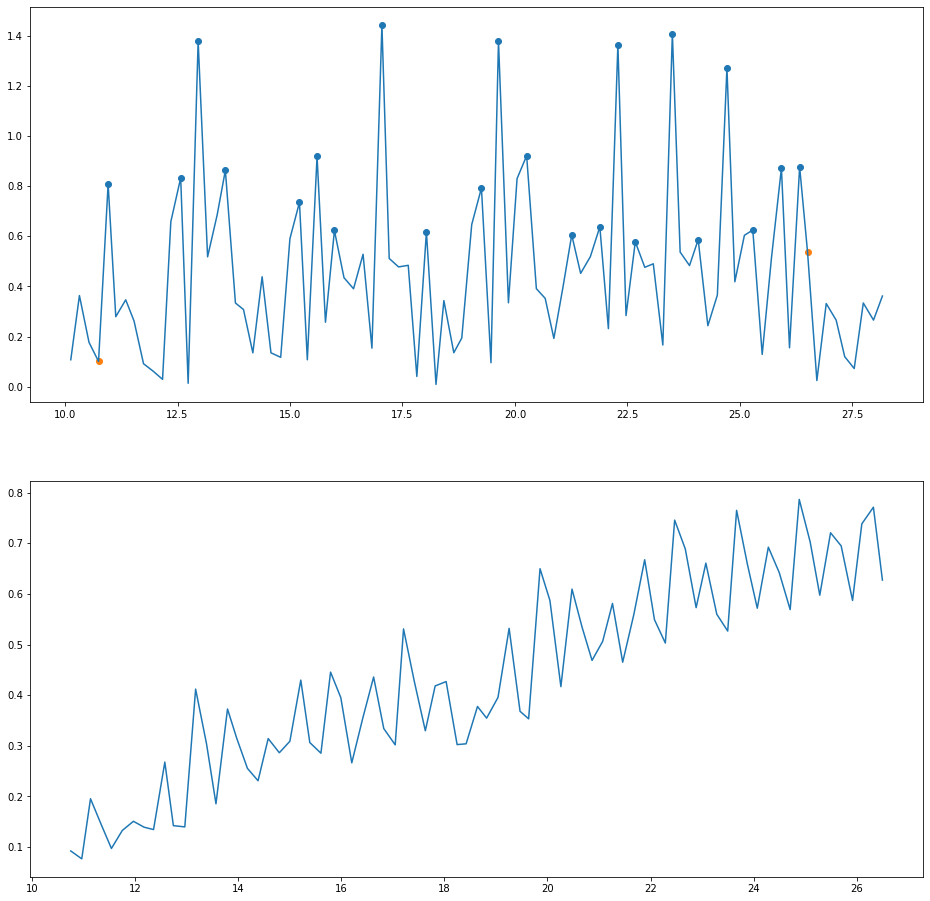

('190', 102, 'Female', 60, 77, True, 15.7595, 22, 0.7325, 33.518100000000004, 0.4353, 6.8372, -99.2371)
('190', 102, 'Female', 60, 77, True, 15.7595, 22, 0.7325, 33.518100000000004, 0.4353, 6.8372, -99.2371, 1.1805)
('190', 102, 'Female', 60, 77, True, 15.7595, 22, 0.7325, 33.518100000000004, 0.4353, 6.8372, -99.2371, 1.1805, -0.0227, -0.0225, -0.013, 7, 222, 'Anxiety')
('190', 102, 'Female', 60, 77, True, 15.7595, 22, 0.7325, 33.518100000000004, 0.4353, 6.8372, -99.2371, 1.1805, -0.0227, -0.0225, -0.013, 7, 103, 'Diabetes')
('190', 102, 'Female', 60, 77, True, 15.7595, 22, 0.7325, 33.518100000000004, 0.4353, 6.8372, -99.2371, 1.1805, -0.0227, -0.0225, -0.013, 7, 277, 'Smoking')
('190', 102, 'Female', 60, 77, True, 15.7595, 22, 0.7325, 33.518100000000004, 0.4353, 6.8372, -99.2371, 1.1805, -0.0227, -0.0225, -0.013, 7, 278, 'Bipolar Affective Disorder')


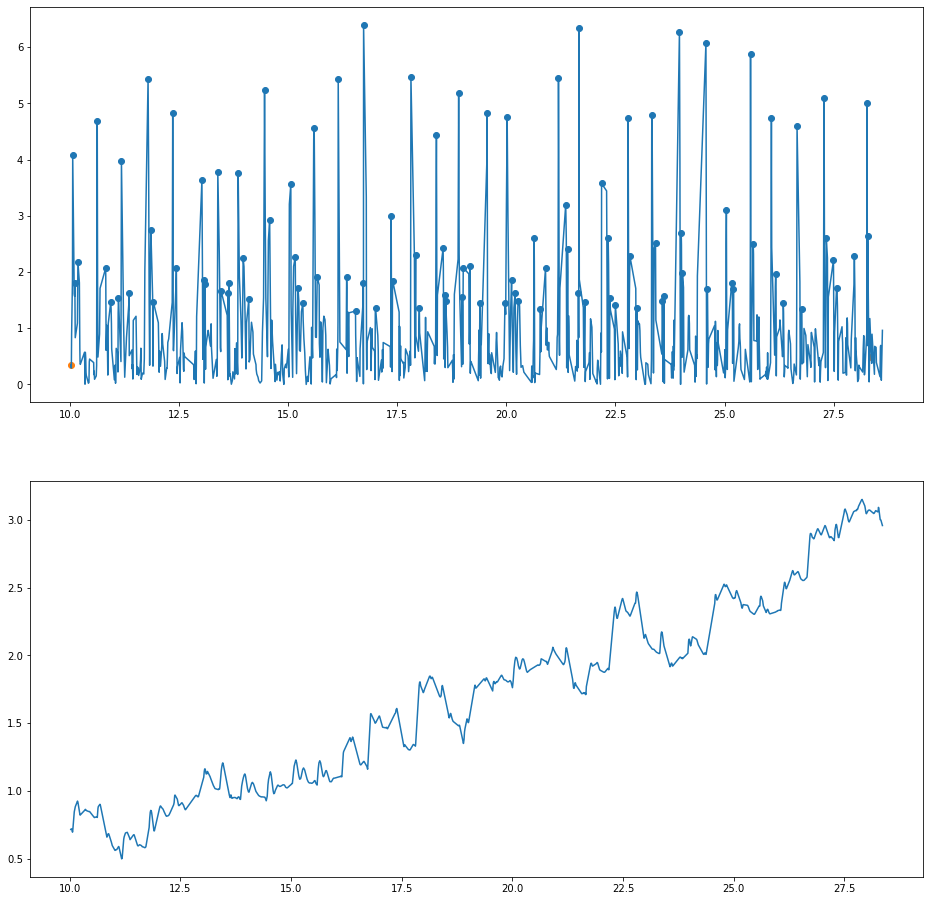

('191', 103, 'Male', 93, 44, True, 18.3325, 100, 0.1844, 74.7164, 1.6981, 31.086, 7267.6829)
('191', 103, 'Male', 93, 44, True, 18.3325, 100, 0.1844, 74.7164, 1.6981, 31.086, 7267.6829, 1.4602)
('191', 103, 'Male', 93, 44, True, 18.3325, 100, 0.1844, 74.7164, 1.6981, 31.086, 7267.6829, 1.4602, -0.0314, 0.0407, 0.005, 8, 104, 'Arterial Hypertension')
('191', 103, 'Male', 93, 44, True, 18.3325, 100, 0.1844, 74.7164, 1.6981, 31.086, 7267.6829, 1.4602, -0.0314, 0.0407, 0.005, 8, 176, 'Atrial Fibrillation')
('191', 103, 'Male', 93, 44, True, 18.3325, 100, 0.1844, 74.7164, 1.6981, 31.086, 7267.6829, 1.4602, -0.0314, 0.0407, 0.005, 8, 279, 'Silicosis')
('191', 103, 'Male', 93, 44, True, 18.3325, 100, 0.1844, 74.7164, 1.6981, 31.086, 7267.6829, 1.4602, -0.0314, 0.0407, 0.005, 8, 280, 'Cholecystectomy')


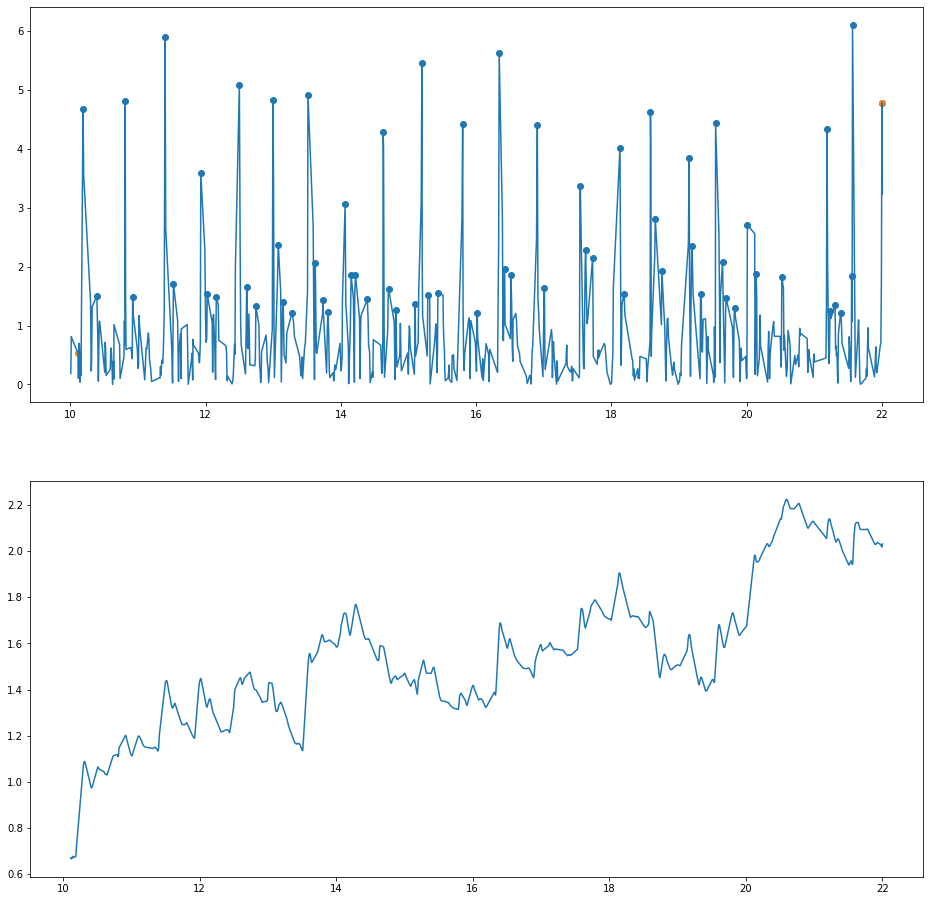

('192', 103, 'Male', 93, 44, True, 11.8885, 63, 0.191, 68.0064, 1.5456, 18.4222, 4476.3273)
('192', 103, 'Male', 93, 44, True, 11.8885, 63, 0.191, 68.0064, 1.5456, 18.4222, 4476.3273, 1.4864)
('192', 103, 'Male', 93, 44, True, 11.8885, 63, 0.191, 68.0064, 1.5456, 18.4222, 4476.3273, 1.4864, 0.0116, -0.011, -0.0877, 8, 104, 'Arterial Hypertension')
('192', 103, 'Male', 93, 44, True, 11.8885, 63, 0.191, 68.0064, 1.5456, 18.4222, 4476.3273, 1.4864, 0.0116, -0.011, -0.0877, 8, 176, 'Atrial Fibrillation')
('192', 103, 'Male', 93, 44, True, 11.8885, 63, 0.191, 68.0064, 1.5456, 18.4222, 4476.3273, 1.4864, 0.0116, -0.011, -0.0877, 8, 279, 'Silicosis')
('192', 103, 'Male', 93, 44, True, 11.8885, 63, 0.191, 68.0064, 1.5456, 18.4222, 4476.3273, 1.4864, 0.0116, -0.011, -0.0877, 8, 280, 'Cholecystectomy')


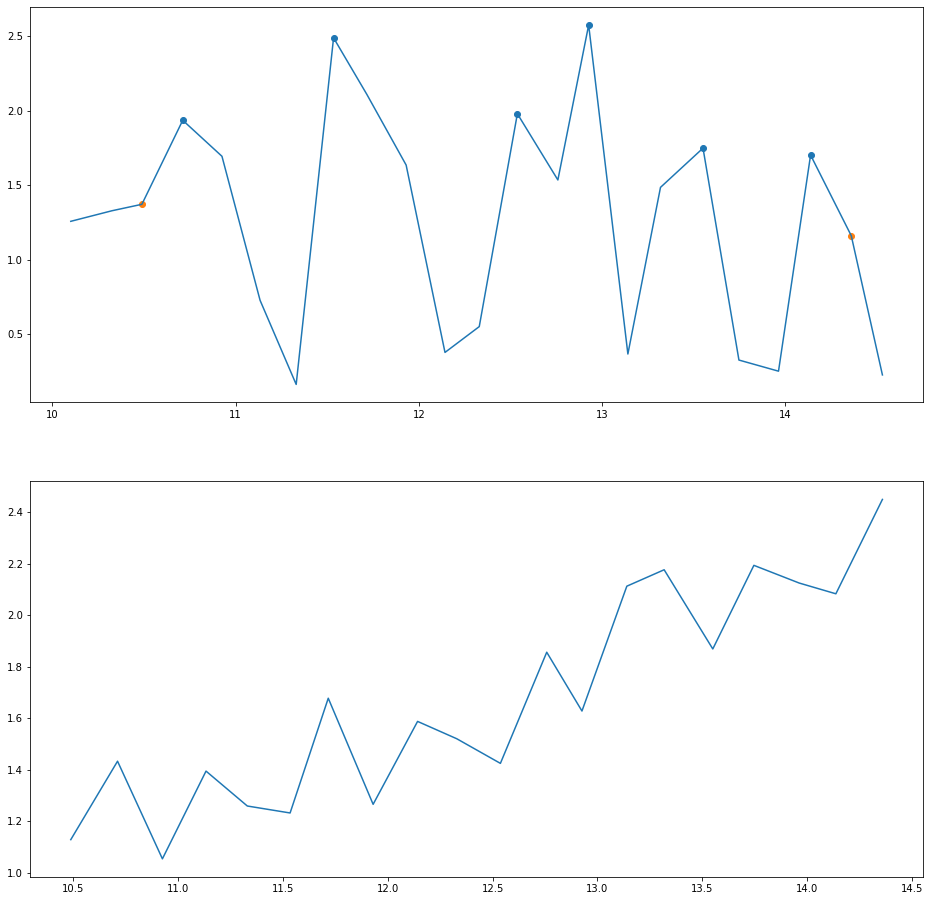

('193', 104, 'Male', 61, 66, False, 3.8715, 6, 0.6857, 110.451, 1.6735, 6.4569, 254.4635)
('193', 104, 'Male', 61, 66, False, 3.8715, 6, 0.6857, 110.451, 1.6735, 6.4569, 254.4635, 0.1671)
('193', 104, 'Male', 61, 66, False, 3.8715, 6, 0.6857, 110.451, 1.6735, 6.4569, 254.4635, 0.1671, 0.0265, -0.0306, -0.0217, 8, 105, 'Schizophrenia')
('193', 104, 'Male', 61, 66, False, 3.8715, 6, 0.6857, 110.451, 1.6735, 6.4569, 254.4635, 0.1671, 0.0265, -0.0306, -0.0217, 8, 281, 'Alcoholism')


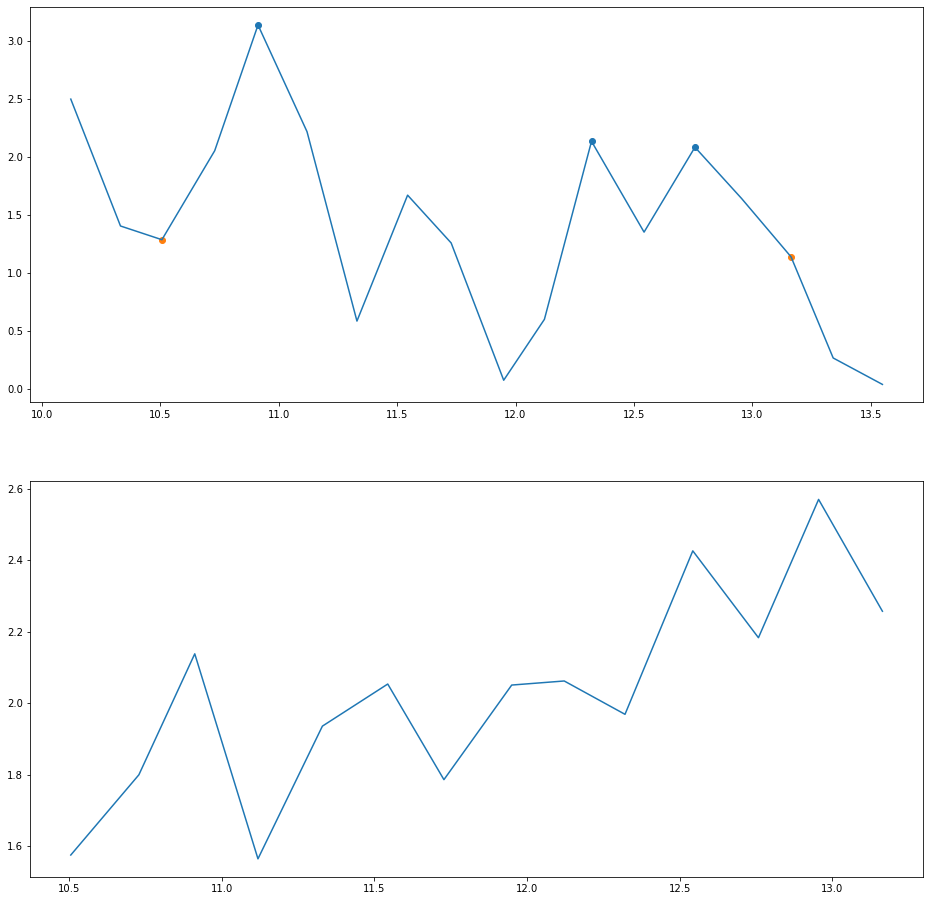

('194', 104, 'Male', 61, 66, False, 2.6585, 3, 0.9235, 133.7688, 2.0268, 5.6411, 284.3087)
('194', 104, 'Male', 61, 66, False, 2.6585, 3, 0.9235, 133.7688, 2.0268, 5.6411, 284.3087, 0.1903)
('194', 104, 'Male', 61, 66, False, 2.6585, 3, 0.9235, 133.7688, 2.0268, 5.6411, 284.3087, 0.1903, 0.0233, 0.0301, 0.0105, 8, 105, 'Schizophrenia')
('194', 104, 'Male', 61, 66, False, 2.6585, 3, 0.9235, 133.7688, 2.0268, 5.6411, 284.3087, 0.1903, 0.0233, 0.0301, 0.0105, 8, 281, 'Alcoholism')


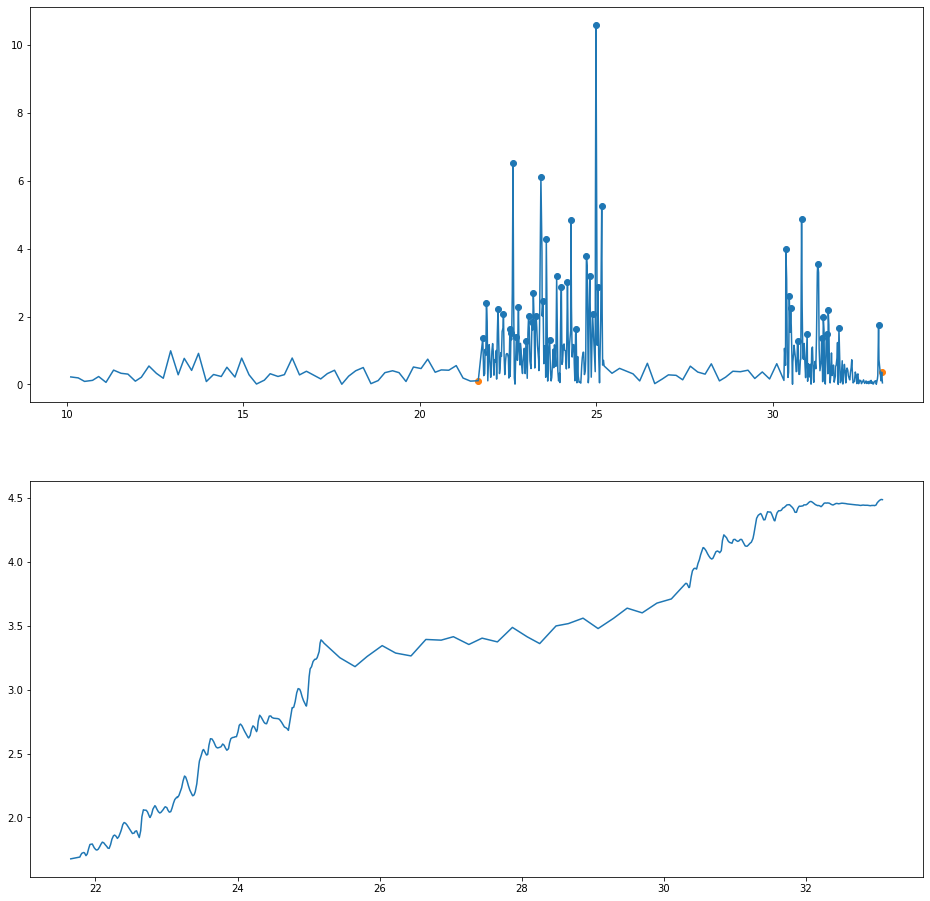

('195', 105, 'Female', 95, 45, False, 11.4245, 42, 0.2739, 146.205, 3.249, 38.14, 17168.0045)
('195', 105, 'Female', 95, 45, False, 11.4245, 42, 0.2739, 146.205, 3.249, 38.14, 17168.0045, 1.6459)
('195', 105, 'Female', 95, 45, False, 11.4245, 42, 0.2739, 146.205, 3.249, 38.14, 17168.0045, 1.6459, -0.0017, -0.0, 0.0125, 9, 104, 'Arterial Hypertension')
('195', 105, 'Female', 95, 45, False, 11.4245, 42, 0.2739, 146.205, 3.249, 38.14, 17168.0045, 1.6459, -0.0017, -0.0, 0.0125, 9, 106, 'Dyslipidemia')
('195', 105, 'Female', 95, 45, False, 11.4245, 42, 0.2739, 146.205, 3.249, 38.14, 17168.0045, 1.6459, -0.0017, -0.0, 0.0125, 9, 136, 'Stroke')
('195', 105, 'Female', 95, 45, False, 11.4245, 42, 0.2739, 146.205, 3.249, 38.14, 17168.0045, 1.6459, -0.0017, -0.0, 0.0125, 9, 282, 'Vitamin D Deficiency')


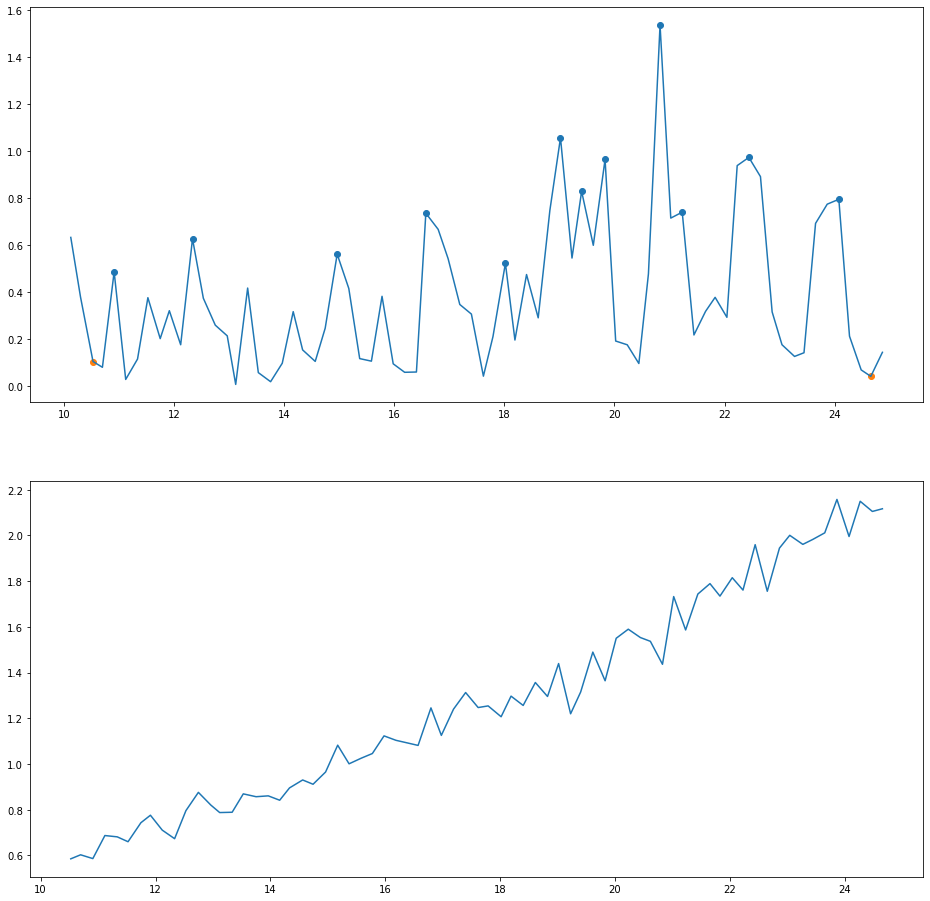

('196', 105, 'Female', 95, 45, False, 14.1345, 12, 1.1977, 57.74850000000001, 1.2833, 18.1166, 394.4795)
('196', 105, 'Female', 95, 45, False, 14.1345, 12, 1.1977, 57.74850000000001, 1.2833, 18.1166, 394.4795, 0.4901)
('196', 105, 'Female', 95, 45, False, 14.1345, 12, 1.1977, 57.74850000000001, 1.2833, 18.1166, 394.4795, 0.4901, -0.0407, -0.0538, 0.0142, 9, 104, 'Arterial Hypertension')
('196', 105, 'Female', 95, 45, False, 14.1345, 12, 1.1977, 57.74850000000001, 1.2833, 18.1166, 394.4795, 0.4901, -0.0407, -0.0538, 0.0142, 9, 106, 'Dyslipidemia')
('196', 105, 'Female', 95, 45, False, 14.1345, 12, 1.1977, 57.74850000000001, 1.2833, 18.1166, 394.4795, 0.4901, -0.0407, -0.0538, 0.0142, 9, 136, 'Stroke')
('196', 105, 'Female', 95, 45, False, 14.1345, 12, 1.1977, 57.74850000000001, 1.2833, 18.1166, 394.4795, 0.4901, -0.0407, -0.0538, 0.0142, 9, 282, 'Vitamin D Deficiency')


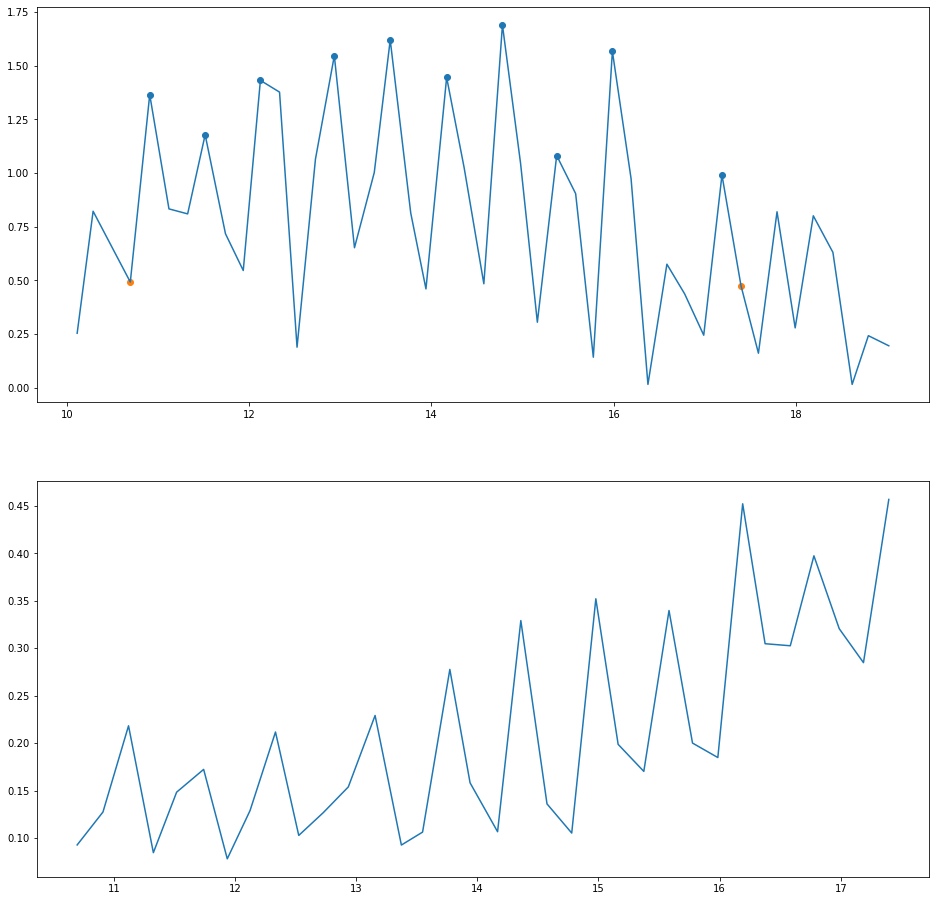

('197', 106, 'Female', 64, 57, False, 6.6995, 10, 0.6979, 12.0156, 0.2108, 1.3805, -176.329)
('197', 106, 'Female', 64, 57, False, 6.6995, 10, 0.6979, 12.0156, 0.2108, 1.3805, -176.329, 0.4429)
('197', 106, 'Female', 64, 57, False, 6.6995, 10, 0.6979, 12.0156, 0.2108, 1.3805, -176.329, 0.4429, 0.021, -0.0274, -0.0098, 8, 283, 'Dementia')
('197', 106, 'Female', 64, 57, False, 6.6995, 10, 0.6979, 12.0156, 0.2108, 1.3805, -176.329, 0.4429, 0.021, -0.0274, -0.0098, 8, 245, 'Mental Disability')
('197', 106, 'Female', 64, 57, False, 6.6995, 10, 0.6979, 12.0156, 0.2108, 1.3805, -176.329, 0.4429, 0.021, -0.0274, -0.0098, 8, 104, 'Arterial Hypertension')


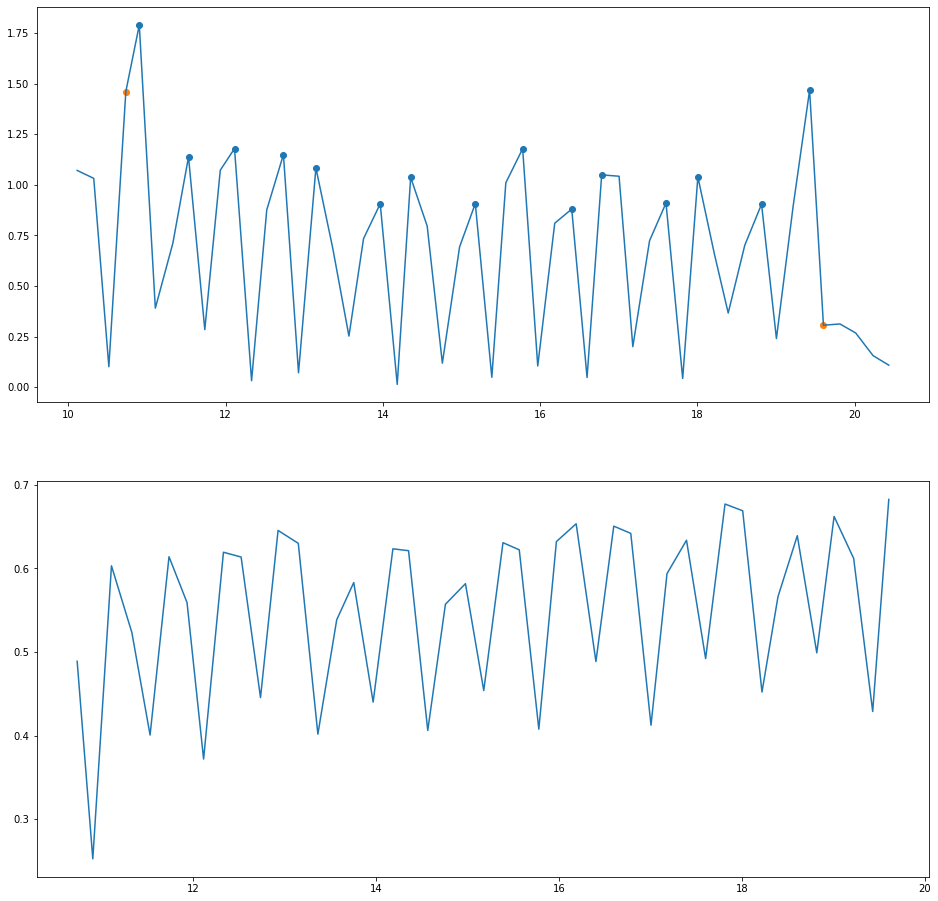

('198', 106, 'Female', 64, 57, False, 8.8715, 15, 0.6094, 31.344300000000004, 0.5499, 4.9651, -138.4867)
('198', 106, 'Female', 64, 57, False, 8.8715, 15, 0.6094, 31.344300000000004, 0.5499, 4.9651, -138.4867, 0.4545)
('198', 106, 'Female', 64, 57, False, 8.8715, 15, 0.6094, 31.344300000000004, 0.5499, 4.9651, -138.4867, 0.4545, -0.0051, -0.0112, 0.0039, 8, 283, 'Dementia')
('198', 106, 'Female', 64, 57, False, 8.8715, 15, 0.6094, 31.344300000000004, 0.5499, 4.9651, -138.4867, 0.4545, -0.0051, -0.0112, 0.0039, 8, 245, 'Mental Disability')
('198', 106, 'Female', 64, 57, False, 8.8715, 15, 0.6094, 31.344300000000004, 0.5499, 4.9651, -138.4867, 0.4545, -0.0051, -0.0112, 0.0039, 8, 104, 'Arterial Hypertension')


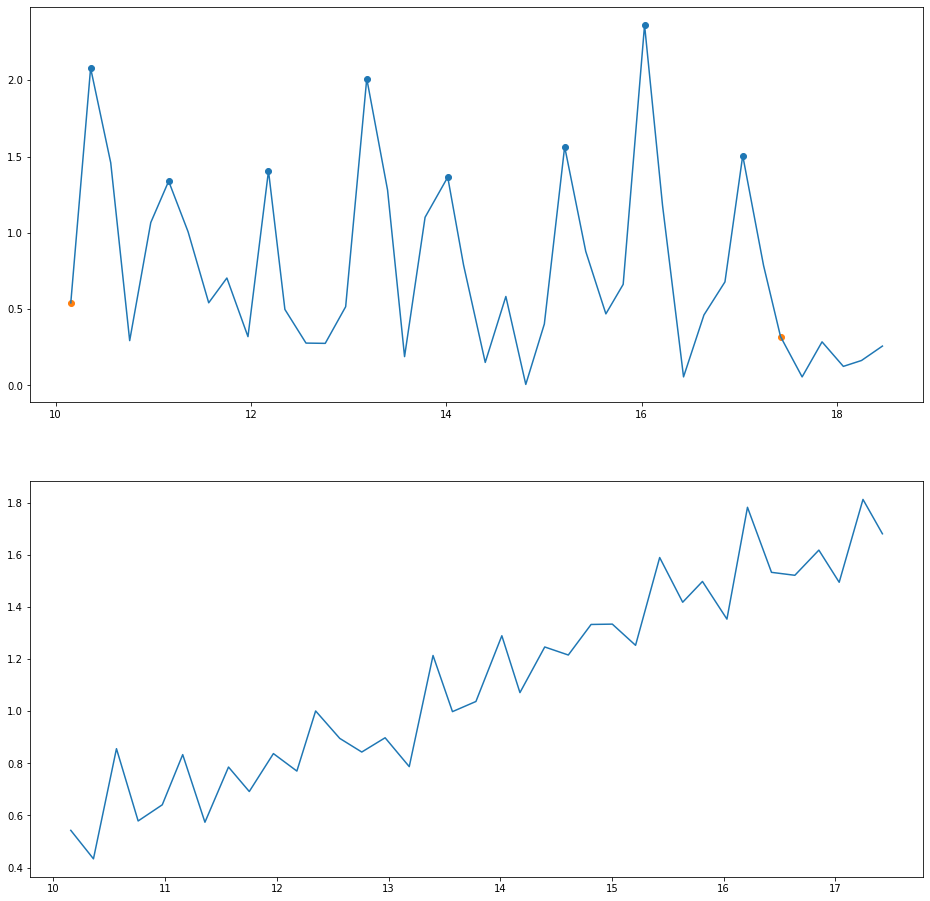

('199', 107, 'Female', 70, 71, False, 7.2665, 8, 0.9542, 79.22179999999999, 1.1158, 7.962, 158.8488)
('199', 107, 'Female', 70, 71, False, 7.2665, 8, 0.9542, 79.22179999999999, 1.1158, 7.962, 158.8488, 0.1161)
('199', 107, 'Female', 70, 71, False, 7.2665, 8, 0.9542, 79.22179999999999, 1.1158, 7.962, 158.8488, 0.1161, -0.0055, 0.0004, -0.0603, 9, 104, 'Arterial Hypertension')
('199', 107, 'Female', 70, 71, False, 7.2665, 8, 0.9542, 79.22179999999999, 1.1158, 7.962, 158.8488, 0.1161, -0.0055, 0.0004, -0.0603, 9, 106, 'Dyslipidemia')
('199', 107, 'Female', 70, 71, False, 7.2665, 8, 0.9542, 79.22179999999999, 1.1158, 7.962, 158.8488, 0.1161, -0.0055, 0.0004, -0.0603, 9, 163, 'Vascular Dementia')
('199', 107, 'Female', 70, 71, False, 7.2665, 8, 0.9542, 79.22179999999999, 1.1158, 7.962, 158.8488, 0.1161, -0.0055, 0.0004, -0.0603, 9, 208, 'Depression')
('199', 107, 'Female', 70, 71, False, 7.2665, 8, 0.9542, 79.22179999999999, 1.1158, 7.962, 158.8488, 0.1161, -0.0055, 0.0004, -0.0603, 9, 209,

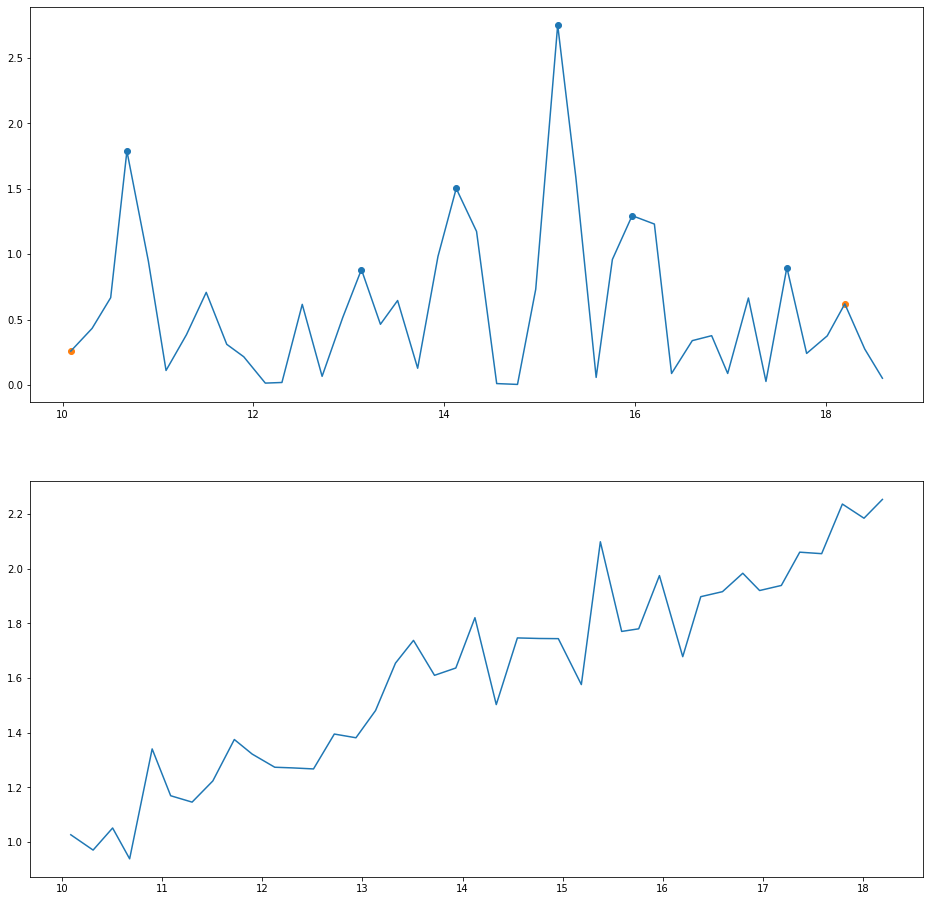

('200', 107, 'Female', 70, 71, False, 8.1095, 6, 1.3833, 114.6153, 1.6143, 12.9611, 475.7289)
('200', 107, 'Female', 70, 71, False, 8.1095, 6, 1.3833, 114.6153, 1.6143, 12.9611, 475.7289, 0.2094)
('200', 107, 'Female', 70, 71, False, 8.1095, 6, 1.3833, 114.6153, 1.6143, 12.9611, 475.7289, 0.2094, 0.0228, -0.0376, 0.0832, 9, 104, 'Arterial Hypertension')
('200', 107, 'Female', 70, 71, False, 8.1095, 6, 1.3833, 114.6153, 1.6143, 12.9611, 475.7289, 0.2094, 0.0228, -0.0376, 0.0832, 9, 106, 'Dyslipidemia')
('200', 107, 'Female', 70, 71, False, 8.1095, 6, 1.3833, 114.6153, 1.6143, 12.9611, 475.7289, 0.2094, 0.0228, -0.0376, 0.0832, 9, 163, 'Vascular Dementia')
('200', 107, 'Female', 70, 71, False, 8.1095, 6, 1.3833, 114.6153, 1.6143, 12.9611, 475.7289, 0.2094, 0.0228, -0.0376, 0.0832, 9, 208, 'Depression')
('200', 107, 'Female', 70, 71, False, 8.1095, 6, 1.3833, 114.6153, 1.6143, 12.9611, 475.7289, 0.2094, 0.0228, -0.0376, 0.0832, 9, 209, 'Gonarthrosis')
('200', 107, 'Female', 70, 71, False,

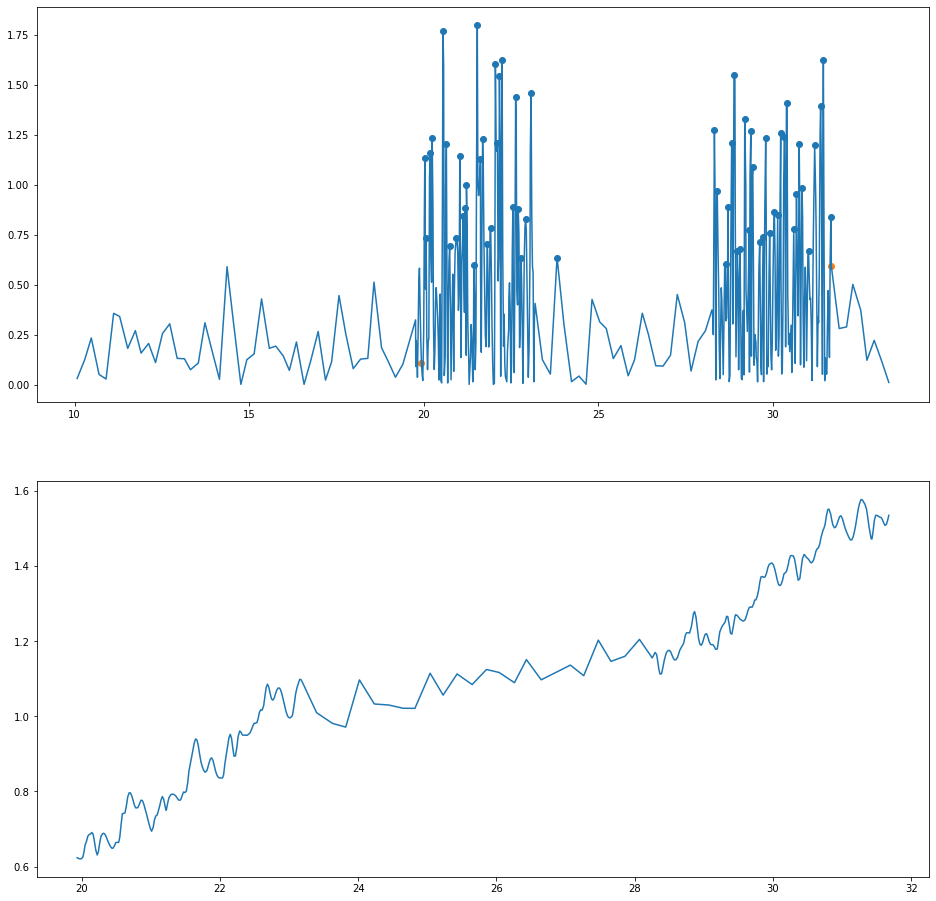

('201', 108, 'Female', 78, 50, True, 11.7415, 59, 0.201, 55.225, 1.1045, 12.9014, 2502.3555)
('201', 108, 'Female', 78, 50, True, 11.7415, 59, 0.201, 55.225, 1.1045, 12.9014, 2502.3555, 1.2196)
('201', 108, 'Female', 78, 50, True, 11.7415, 59, 0.201, 55.225, 1.1045, 12.9014, 2502.3555, 1.2196, -0.0084, 0.0185, 0.0008, 8, 213, 'Alzheimer')
('201', 108, 'Female', 78, 50, True, 11.7415, 59, 0.201, 55.225, 1.1045, 12.9014, 2502.3555, 1.2196, -0.0084, 0.0185, 0.0008, 8, 104, 'Arterial Hypertension')
('201', 108, 'Female', 78, 50, True, 11.7415, 59, 0.201, 55.225, 1.1045, 12.9014, 2502.3555, 1.2196, -0.0084, 0.0185, 0.0008, 8, 287, 'Rheumatoid Arthritis')


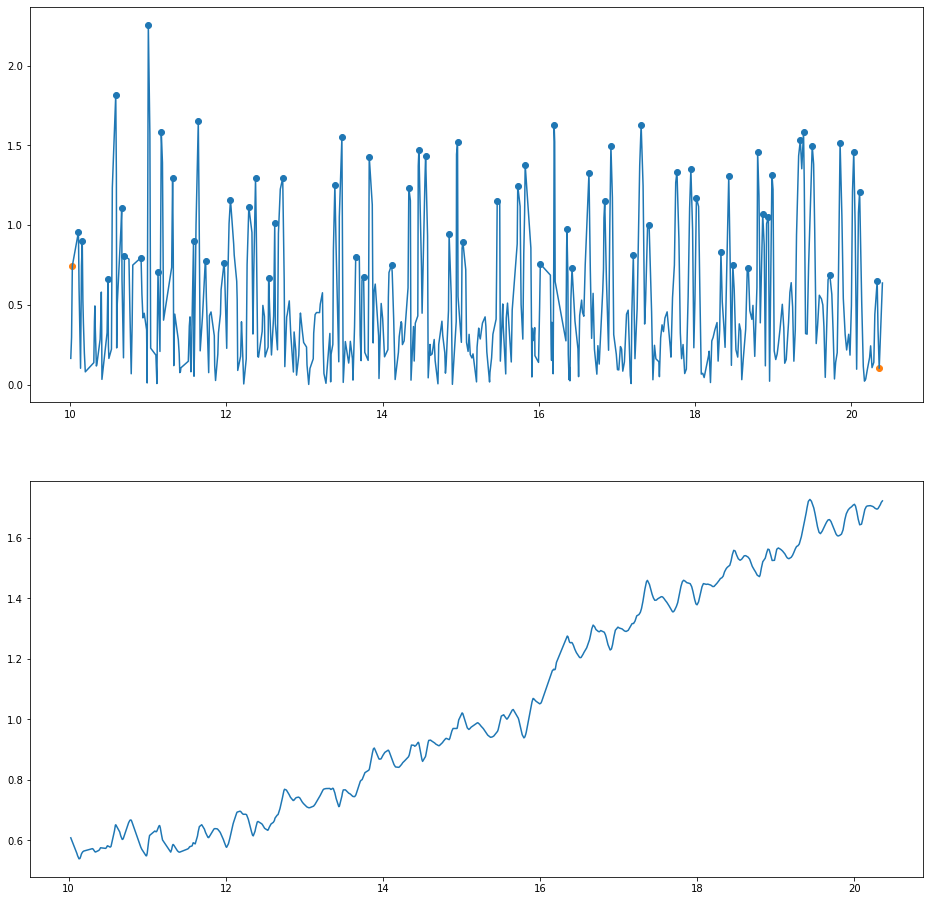

('202', 108, 'Female', 78, 50, True, 10.3335, 65, 0.1603, 52.73, 1.0546, 10.8645, 3147.8655)
('202', 108, 'Female', 78, 50, True, 10.3335, 65, 0.1603, 52.73, 1.0546, 10.8645, 3147.8655, 0.4912)
('202', 108, 'Female', 78, 50, True, 10.3335, 65, 0.1603, 52.73, 1.0546, 10.8645, 3147.8655, 0.4912, -0.0351, -0.0031, -0.0488, 8, 213, 'Alzheimer')
('202', 108, 'Female', 78, 50, True, 10.3335, 65, 0.1603, 52.73, 1.0546, 10.8645, 3147.8655, 0.4912, -0.0351, -0.0031, -0.0488, 8, 104, 'Arterial Hypertension')
('202', 108, 'Female', 78, 50, True, 10.3335, 65, 0.1603, 52.73, 1.0546, 10.8645, 3147.8655, 0.4912, -0.0351, -0.0031, -0.0488, 8, 287, 'Rheumatoid Arthritis')


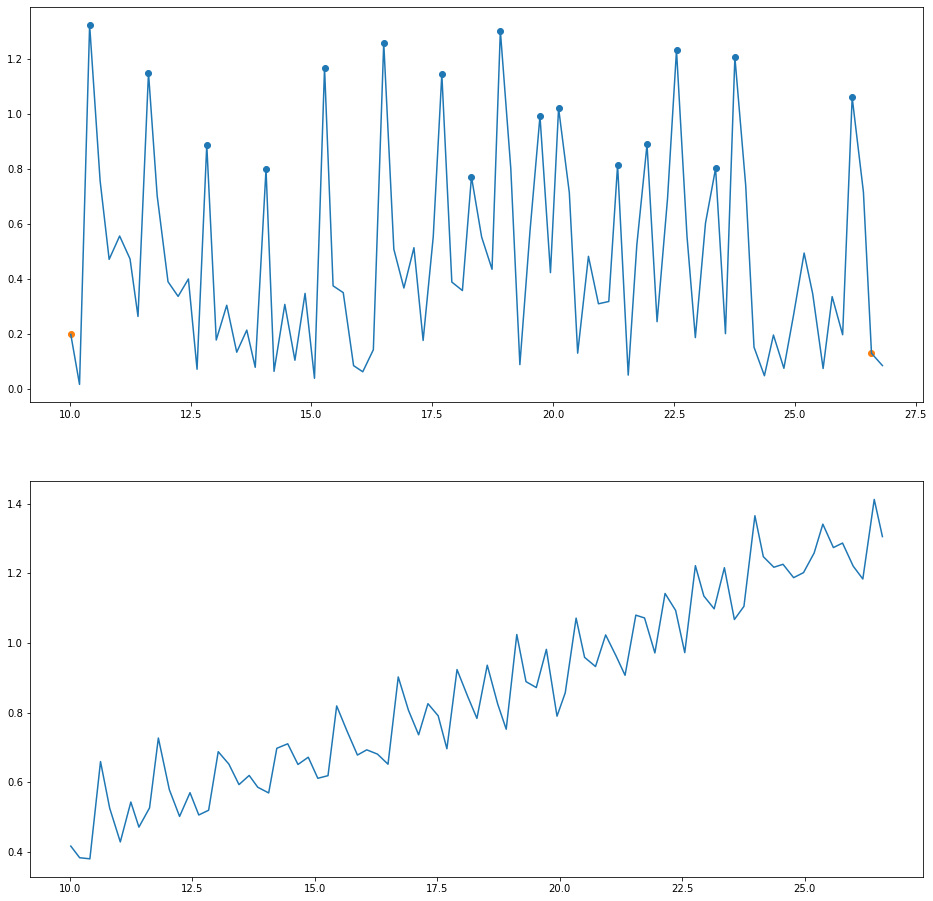

('203', 109, 'Female', 85, 89, True, 16.5695, 17, 0.9867, 76.8693, 0.8637, 14.1981, 2.3323)
('203', 109, 'Female', 85, 89, True, 16.5695, 17, 0.9867, 76.8693, 0.8637, 14.1981, 2.3323, 2.63)
('203', 109, 'Female', 85, 89, True, 16.5695, 17, 0.9867, 76.8693, 0.8637, 14.1981, 2.3323, 2.63, -0.0317, 0.0554, 0.0247, 8, 104, 'Arterial Hypertension')
('203', 109, 'Female', 85, 89, True, 16.5695, 17, 0.9867, 76.8693, 0.8637, 14.1981, 2.3323, 2.63, -0.0317, 0.0554, 0.0247, 8, 249, 'Transient Ischemic Attacks')
('203', 109, 'Female', 85, 89, True, 16.5695, 17, 0.9867, 76.8693, 0.8637, 14.1981, 2.3323, 2.63, -0.0317, 0.0554, 0.0247, 8, 136, 'Stroke')
('203', 109, 'Female', 85, 89, True, 16.5695, 17, 0.9867, 76.8693, 0.8637, 14.1981, 2.3323, 2.63, -0.0317, 0.0554, 0.0247, 8, 165, 'Ischemic Leukoencephalopathy')
('203', 109, 'Female', 85, 89, True, 16.5695, 17, 0.9867, 76.8693, 0.8637, 14.1981, 2.3323, 2.63, -0.0317, 0.0554, 0.0247, 8, 162, 'Epilepsy')


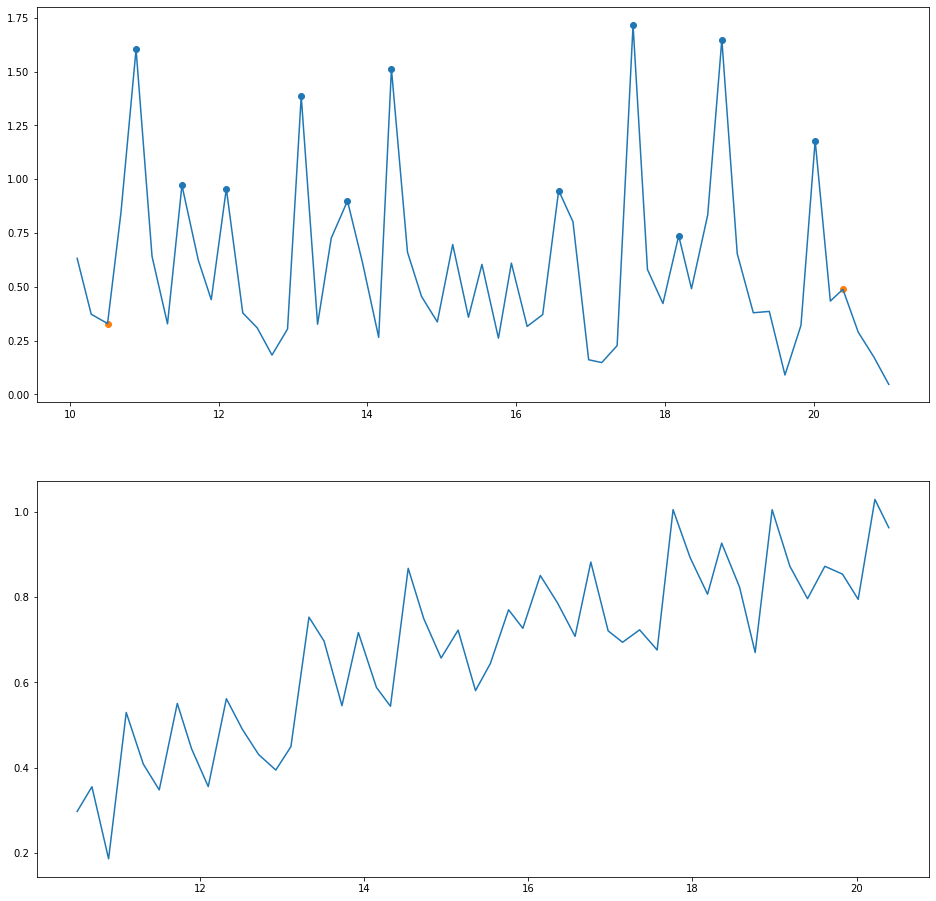

('204', 109, 'Female', 85, 89, True, 9.8885, 11, 0.9137, 60.075, 0.675, 6.6568, -113.3232)
('204', 109, 'Female', 85, 89, True, 9.8885, 11, 0.9137, 60.075, 0.675, 6.6568, -113.3232, 0.1531)
('204', 109, 'Female', 85, 89, True, 9.8885, 11, 0.9137, 60.075, 0.675, 6.6568, -113.3232, 0.1531, -0.0186, -0.0021, -0.0952, 8, 104, 'Arterial Hypertension')
('204', 109, 'Female', 85, 89, True, 9.8885, 11, 0.9137, 60.075, 0.675, 6.6568, -113.3232, 0.1531, -0.0186, -0.0021, -0.0952, 8, 249, 'Transient Ischemic Attacks')
('204', 109, 'Female', 85, 89, True, 9.8885, 11, 0.9137, 60.075, 0.675, 6.6568, -113.3232, 0.1531, -0.0186, -0.0021, -0.0952, 8, 136, 'Stroke')
('204', 109, 'Female', 85, 89, True, 9.8885, 11, 0.9137, 60.075, 0.675, 6.6568, -113.3232, 0.1531, -0.0186, -0.0021, -0.0952, 8, 165, 'Ischemic Leukoencephalopathy')
('204', 109, 'Female', 85, 89, True, 9.8885, 11, 0.9137, 60.075, 0.675, 6.6568, -113.3232, 0.1531, -0.0186, -0.0021, -0.0952, 8, 162, 'Epilepsy')


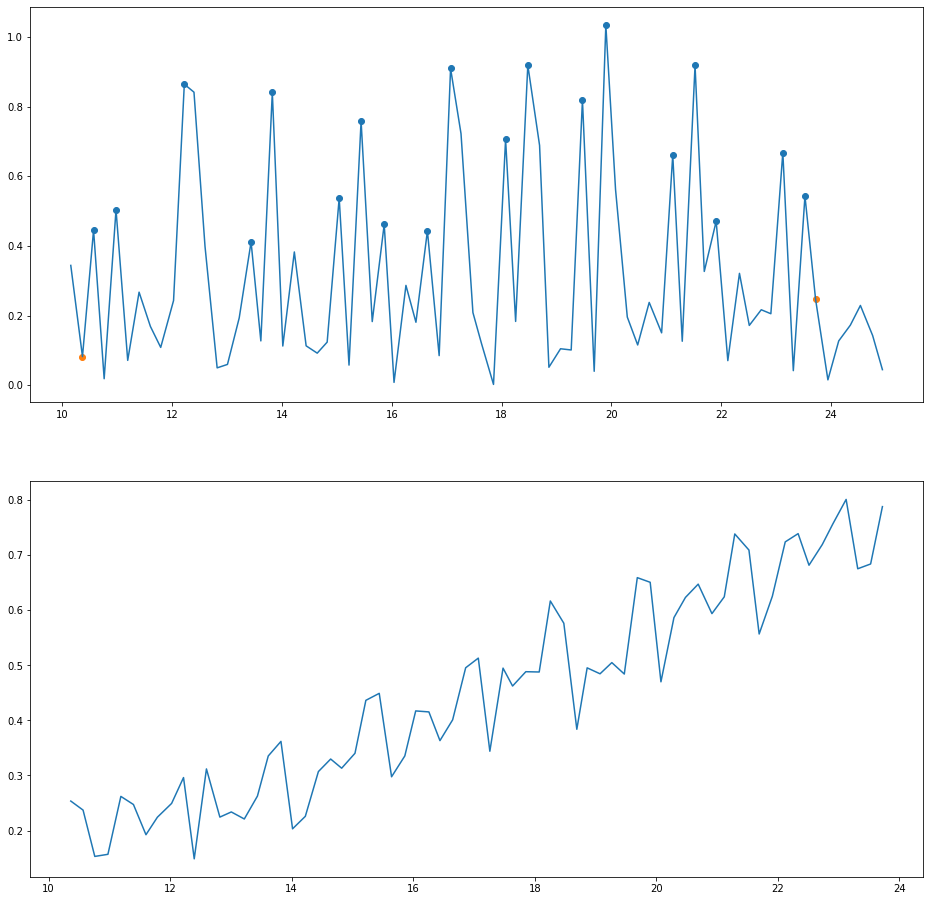

('205', 110, 'Female', 83, 47, True, 13.3545, 19, 0.7204, 21.1359, 0.4497, 5.9581, -9.9541)
('205', 110, 'Female', 83, 47, True, 13.3545, 19, 0.7204, 21.1359, 0.4497, 5.9581, -9.9541, 0.4581)
('205', 110, 'Female', 83, 47, True, 13.3545, 19, 0.7204, 21.1359, 0.4497, 5.9581, -9.9541, 0.4581, -0.0095, -0.0061, 0.0526, 9, 104, 'Arterial Hypertension')
('205', 110, 'Female', 83, 47, True, 13.3545, 19, 0.7204, 21.1359, 0.4497, 5.9581, -9.9541, 0.4581, -0.0095, -0.0061, 0.0526, 9, 113, 'Psychosis')
('205', 110, 'Female', 83, 47, True, 13.3545, 19, 0.7204, 21.1359, 0.4497, 5.9581, -9.9541, 0.4581, -0.0095, -0.0061, 0.0526, 9, 283, 'Dementia')
('205', 110, 'Female', 83, 47, True, 13.3545, 19, 0.7204, 21.1359, 0.4497, 5.9581, -9.9541, 0.4581, -0.0095, -0.0061, 0.0526, 9, 103, 'Diabetes')
('205', 110, 'Female', 83, 47, True, 13.3545, 19, 0.7204, 21.1359, 0.4497, 5.9581, -9.9541, 0.4581, -0.0095, -0.0061, 0.0526, 9, 142, 'Heart Failure')
('205', 110, 'Female', 83, 47, True, 13.3545, 19, 0.7204, 2

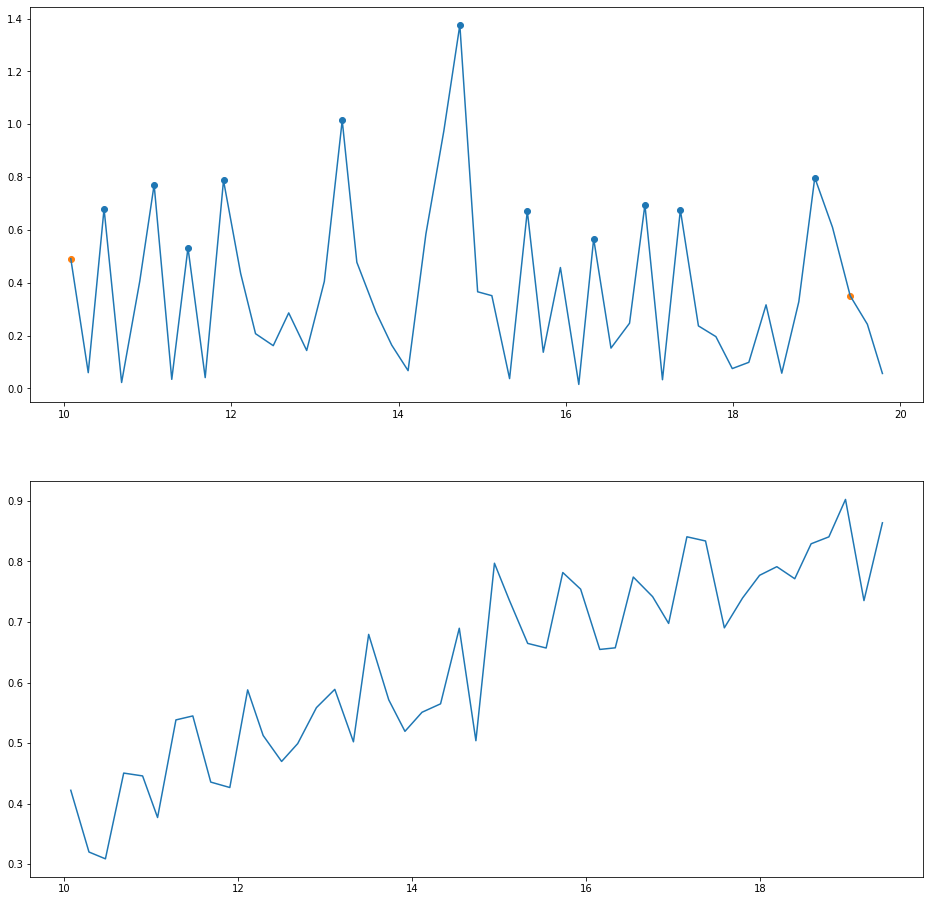

('206', 110, 'Female', 83, 47, True, 9.3245, 11, 0.8507, 29.6241, 0.6303, 5.8291, 0.2026)
('206', 110, 'Female', 83, 47, True, 9.3245, 11, 0.8507, 29.6241, 0.6303, 5.8291, 0.2026, 0.2882)
('206', 110, 'Female', 83, 47, True, 9.3245, 11, 0.8507, 29.6241, 0.6303, 5.8291, 0.2026, 0.2882, 0.0007, -0.0056, 0.0115, 9, 104, 'Arterial Hypertension')
('206', 110, 'Female', 83, 47, True, 9.3245, 11, 0.8507, 29.6241, 0.6303, 5.8291, 0.2026, 0.2882, 0.0007, -0.0056, 0.0115, 9, 113, 'Psychosis')
('206', 110, 'Female', 83, 47, True, 9.3245, 11, 0.8507, 29.6241, 0.6303, 5.8291, 0.2026, 0.2882, 0.0007, -0.0056, 0.0115, 9, 283, 'Dementia')
('206', 110, 'Female', 83, 47, True, 9.3245, 11, 0.8507, 29.6241, 0.6303, 5.8291, 0.2026, 0.2882, 0.0007, -0.0056, 0.0115, 9, 103, 'Diabetes')
('206', 110, 'Female', 83, 47, True, 9.3245, 11, 0.8507, 29.6241, 0.6303, 5.8291, 0.2026, 0.2882, 0.0007, -0.0056, 0.0115, 9, 142, 'Heart Failure')
('206', 110, 'Female', 83, 47, True, 9.3245, 11, 0.8507, 29.6241, 0.6303, 5.82

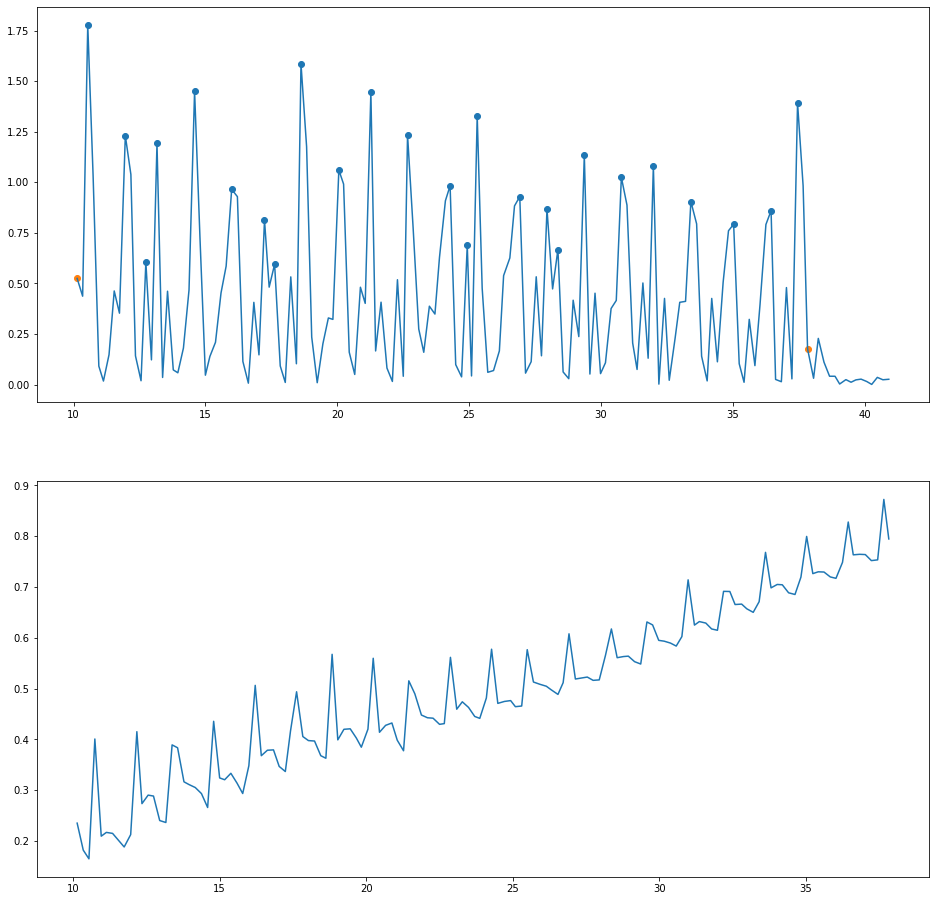

('207', 111, 'Female', 87, 58, True, 27.7055, 25, 1.1223, 28.942, 0.499, 13.743, -218.7813)
('207', 111, 'Female', 87, 58, True, 27.7055, 25, 1.1223, 28.942, 0.499, 13.743, -218.7813, 0.3627)
('207', 111, 'Female', 87, 58, True, 27.7055, 25, 1.1223, 28.942, 0.499, 13.743, -218.7813, 0.3627, -0.0035, -0.007, 0.0309, 8, 104, 'Arterial Hypertension')
('207', 111, 'Female', 87, 58, True, 27.7055, 25, 1.1223, 28.942, 0.499, 13.743, -218.7813, 0.3627, -0.0035, -0.007, 0.0309, 8, 132, 'Coxarthrosis')
('207', 111, 'Female', 87, 58, True, 27.7055, 25, 1.1223, 28.942, 0.499, 13.743, -218.7813, 0.3627, -0.0035, -0.007, 0.0309, 8, 179, "Parkinson'S Disease")
('207', 111, 'Female', 87, 58, True, 27.7055, 25, 1.1223, 28.942, 0.499, 13.743, -218.7813, 0.3627, -0.0035, -0.007, 0.0309, 8, 288, 'Fracture Of The Ischiopubic Rami')
('207', 111, 'Female', 87, 58, True, 27.7055, 25, 1.1223, 28.942, 0.499, 13.743, -218.7813, 0.3627, -0.0035, -0.007, 0.0309, 8, 106, 'Dyslipidemia')


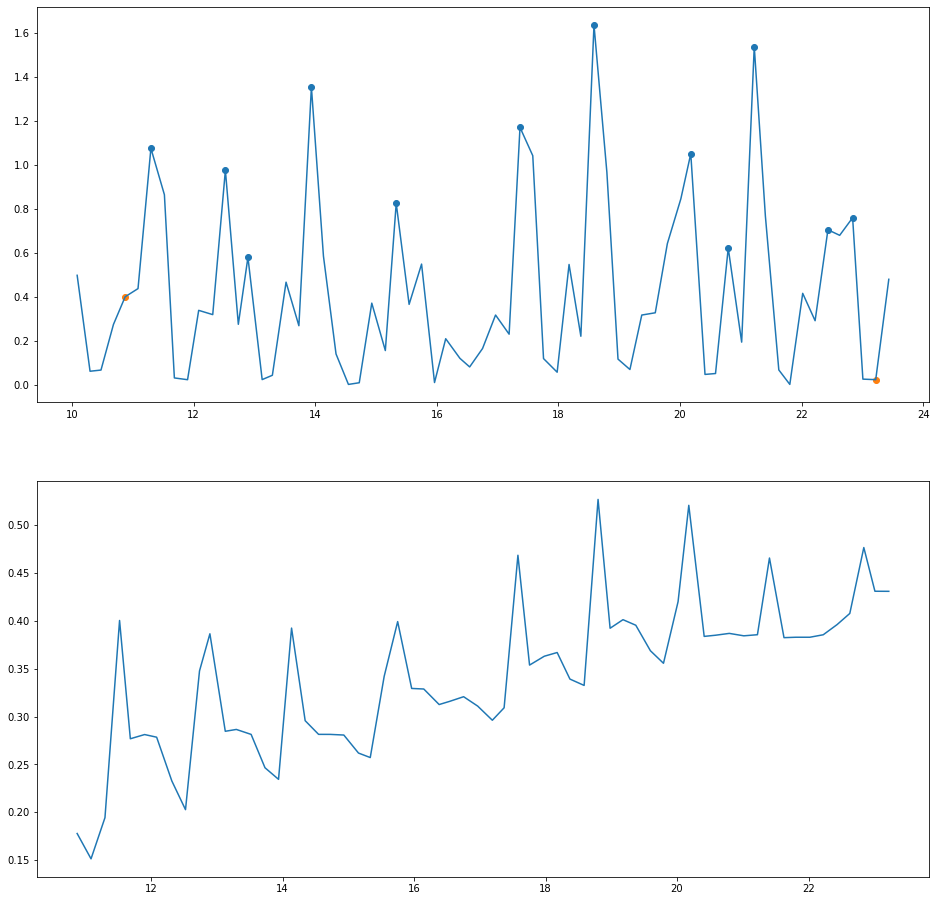

('208', 111, 'Female', 87, 58, True, 12.3455, 12, 1.0498, 19.9114, 0.3433, 4.2414, -106.7601)
('208', 111, 'Female', 87, 58, True, 12.3455, 12, 1.0498, 19.9114, 0.3433, 4.2414, -106.7601, 0.7025)
('208', 111, 'Female', 87, 58, True, 12.3455, 12, 1.0498, 19.9114, 0.3433, 4.2414, -106.7601, 0.7025, 0.0211, -0.0261, 0.0676, 8, 104, 'Arterial Hypertension')
('208', 111, 'Female', 87, 58, True, 12.3455, 12, 1.0498, 19.9114, 0.3433, 4.2414, -106.7601, 0.7025, 0.0211, -0.0261, 0.0676, 8, 132, 'Coxarthrosis')
('208', 111, 'Female', 87, 58, True, 12.3455, 12, 1.0498, 19.9114, 0.3433, 4.2414, -106.7601, 0.7025, 0.0211, -0.0261, 0.0676, 8, 179, "Parkinson'S Disease")
('208', 111, 'Female', 87, 58, True, 12.3455, 12, 1.0498, 19.9114, 0.3433, 4.2414, -106.7601, 0.7025, 0.0211, -0.0261, 0.0676, 8, 288, 'Fracture Of The Ischiopubic Rami')
('208', 111, 'Female', 87, 58, True, 12.3455, 12, 1.0498, 19.9114, 0.3433, 4.2414, -106.7601, 0.7025, 0.0211, -0.0261, 0.0676, 8, 106, 'Dyslipidemia')


In [5]:
with open(output_file_name, 'w', newline='', encoding='utf-8') as output_file, \
     open(error_file_name, 'w', newline='', encoding='utf-8') as error_file:
    
    writer = csv.writer(output_file)
    dump = csv.writer(error_file)
    
    writer.writerow(header_file)
    dump.writerow(header_file)


    for diretoria in range(1,number_samples + 1):
#    for diretoria in range(1,6):
               
        sample_path = data_path + '/' + str(diretoria)

        if os.path.isdir(sample_path):

            file_list = os.listdir(sample_path)

            json_file = sample_path + '/' + [file for file in file_list if '.json' in file][0]

            record_row = ()

            with open(json_file, 'r') as f:

                info_data =  json.load(f)

                record_row = record_row + (str(diretoria),)

                for name in range(1,6):
                    record_row = record_row + (info_data[json_keys[name]],)

            #print(record_row)

            data_values={}

            accel_file = sample_path + '/' + [file for file in file_list if 'accelerometer' in file][0]

            with open(accel_file, 'r') as f:

                accel_data = f.readlines()

                data_values['accelerometer'] = []

                for time_instant in accel_data[1:]:

                    time_instant = time_instant.split()

                    data_values['accelerometer'] = \
                        data_values['accelerometer'] + \
                            [[eval(time_instant[0]), [eval(component) for component in time_instant[1:]]]]

                ### Acelerómetro

                AccelResults = [[diretoria] + accelerometer(data_values)]

                #print('Accelerometer')
                #print(AccelResults)

            # Total Time# Number of Steps# Mean Stepping Time# Mean Speed# Total Distance#\ # Mean Power', 'Mean Inclination', 'Main Direction'
                                       #AccelResults[1], AccelResults[1], AccelResults[1], )
            if not(isinstance(AccelResults[0][3], str)):
                record_row = record_row + (AccelResults[0][1], \
                                       AccelResults[0][2], \
                                       AccelResults[0][3], \
                                       info_data['weight_kg'] * AccelResults[0][5], \
                                       AccelResults[0][6], \
                                       AccelResults[0][7], \
                                       RoundFloat([info_data['weight_kg']*AccelResults[0][8]])[0], )
            else:
                record_row = record_row + (AccelResults[0][1], \
                                       AccelResults[0][2], \
                                       '#N/A', \
                                       '#N/A', \
                                       '#N/A', \
                                       '#N/A', \
                                       '#N/A', )
                
                print(record_row)
                dump.writerow(record_row)
                continue
            print(record_row)

            Study_Interval = AccelResults[-1]

            data_values={}

            gyro_file = sample_path + '/' + [file for file in file_list if 'gyroscope' in file][0]

            with open(gyro_file, 'r') as f:

                gyro_file = f.readlines()

                data_values['gyroscope'] = []

                for time_instant in gyro_file[1:]:

                    time_instant = time_instant.split()

                    data_values['gyroscope'] = \
                        data_values['gyroscope'] + \
                            [[eval(time_instant[0]), [eval(component) for component in time_instant[1:]]]]

                ### Acelerómetro

                GyroResults = [[diretoria] + gyroscope(data_values, Study_Interval)]

                #print('Gyroscope')
                #print(GyroResults)

            record_row = record_row + (GyroResults[0][1], )
            print(record_row)
            data_values={}

            mag_file = sample_path + '/' + [file for file in file_list if 'magnetometer' in file][0]

            with open(mag_file, 'r') as f:

                mag_file = f.readlines()

                data_values['magnetometer'] = []

                for time_instant in mag_file[1:]:

                    time_instant = time_instant.split()

                    data_values['magnetometer'] = \
                        data_values['magnetometer'] + \
                            [[eval(time_instant[0]), [eval(component) for component in time_instant[1:]]]]

                ### Magnetometer

                MagResults = [[diretoria] + magnetometer(data_values, Study_Interval)]

                #print('Magnetometer')
                #print(MagResults)

            record_row = record_row + (MagResults[0][1], MagResults[0][2], MagResults[0][3], \
                                       info_data["sleeping_time_hours"],)
            List_Diseases = info_data["diseases"][0].split("; ")
            for item in range(len(List_Diseases)):
                List_Diseases[item]=List_Diseases[item].title()
                if List_Diseases[item] == "N/A":
                    List_Diseases[item] = "None"
                if not(List_Diseases[item] in Dict_Diseases.keys()):
                    if Dict_Diseases == {}:
                        Codice = 100
                    Dict_Diseases[List_Diseases[item]] = Codice + 1
                    Codice = Codice + 1
                print(record_row + (Dict_Diseases[List_Diseases[item]], List_Diseases[item],))
                writer.writerow(record_row + (Dict_Diseases[List_Diseases[item]], List_Diseases[item],))
            #writer.writerow(record_row)
            #break
        else:
            print("End of the routine")
            #break
    